# Lending Club Case Study

This company is the largest online loan marketplace, facilitating personal loans, business loans, and financing of medical procedures. Borrowers can easily access lower interest rate loans through a fast online interface.

---
When a person applies for a loan, there are two types of decisions that could be taken by the company:
> - **Loan accepted**: If the company approves the loan, there are 3 possible scenarios described below:
>> - Fully paid: Applicant has fully paid the loan (the principal and the interest rate)
>> - Current: Applicant is in the process of paying the instalments, i.e. the tenure of the loan is not yet completed. These candidates are not labelled as 'defaulted'.
>> - Charged-off: Applicant has not paid the instalments in due time for a long period of time, i.e. he/she has defaulted on the loan.
> - **Loan rejected**: The company had rejected the loan (because the candidate does not meet their requirements etc.). Since the loan was rejected, there is no transactional history of those applicants with the company and so this data is not available with the company (and thus in this dataset)

---
Lending loans to ‘risky’ applicants is the largest source of financial loss (called credit loss). There are two types of risks associated with the bank’s decision:
> - If the applicant is likely to repay the loan, then not approving the loan results in a loss of business to the company
> - If the applicant is not likely to repay the loan, i.e. he/she is likely to default, then approving the loan may lead to a financial loss for the company.

_Borrowers who default cause the largest amount of loss to the lenders._

---
### Objective:
- The aim is to understand the **driving factors (or driver variables) behind loan default**, i.e. the variables which are strong indicators of default.

---
---

## Import the needed libraries

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick

In [2]:
#Setting pandas display options
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

---
---

## Data Sourcing

#### Load the data from the given files

In [3]:
# Termed the variable as raw_loan_data since there will be modifications on the dataser as we start analysing 
# and keeping one copy as raw
raw_loan_data = pd.read_csv('loan.csv')

C:\Users\sea\AppData\Local\Temp\ipykernel_8664\3185014544.py:3: DtypeWarning: Columns (47) have mixed types. Specify dtype option on import or set low_memory=False.
  raw_loan_data = pd.read_csv('loan.csv')


Let us take a quick check on the above warning

In [4]:
raw_loan_data.iloc[:,47]

0           NaN
1           NaN
2           NaN
3           NaN
4        Jun-16
          ...  
39712       NaN
39713       NaN
39714       NaN
39715       NaN
39716       NaN
Name: next_pymnt_d, Length: 39717, dtype: object

The *47 th column* is 'next_pymnt_d'(next scheduled payment date) and as we see above it is of type date and NaN. Pandas might be facing some issue in understanding these mixed data type. Hence specifying the data type on import like below

In [5]:
# Mention the 47th column as 'object' data type and reload into same variable
raw_loan_data = pd.read_csv('loan.csv', dtype={47:'object'})

In [6]:
# Termed the variable as it is data_dict and load the meaning of columns
data_dict = pd.read_excel('Data_Dictionary.xlsx')

---
---

## Data understanding

#### Get a basic understanding of the dataset like the meaning of each column

In [7]:
# Just printing the column names from the loan dataset for understanding
print(raw_loan_data.dtypes)

id                                  int64
member_id                           int64
loan_amnt                           int64
funded_amnt                         int64
funded_amnt_inv                   float64
term                               object
int_rate                           object
installment                       float64
grade                              object
sub_grade                          object
emp_title                          object
emp_length                         object
home_ownership                     object
annual_inc                        float64
verification_status                object
issue_d                            object
loan_status                        object
pymnt_plan                         object
url                                object
desc                               object
purpose                            object
title                              object
zip_code                           object
addr_state                        

In [8]:
# Just printing the explanation from the data dictionary dataset for understanding
for index, row in data_dict.iterrows():
    print(str(row['LoanStatNew'])+ " : " + str(row['Description']))

acc_now_delinq : The number of accounts on which the borrower is now delinquent.
acc_open_past_24mths : Number of trades opened in past 24 months.
addr_state : The state provided by the borrower in the loan application
all_util : Balance to credit limit on all trades
annual_inc : The self-reported annual income provided by the borrower during registration.
annual_inc_joint : The combined self-reported annual income provided by the co-borrowers during registration
application_type : Indicates whether the loan is an individual application or a joint application with two co-borrowers
avg_cur_bal : Average current balance of all accounts
bc_open_to_buy : Total open to buy on revolving bankcards.
bc_util : Ratio of total current balance to high credit/credit limit for all bankcard accounts.
chargeoff_within_12_mths : Number of charge-offs within 12 months
collection_recovery_fee : post charge off collection fee
collections_12_mths_ex_med : Number of collections in 12 months excluding medica

In [9]:
# Let us understand the dimensions of each dataset.
print(raw_loan_data.shape)
print(data_dict.shape)

(39717, 111)
(117, 2)


From above we can see observe the following.
- The raw_loan_data has **39717 rows** meaning almost there are **~40k** records of loan applicants.
- The raw_loan_data has **111 columns** whereas the explanation in the data_dict is **115 rows** (actually 117 as it is printed above, but ignoring the last two rows as it is just 'nan'. It can be cross checked from the above data explanation printing) . This means that there are **4** additional columnns explained in data_dict which are not in raw_loan_data. Let us find out the missing columns in raw_loan_data.

In [10]:
# Termed it as missing_columns_from_loan_data since this will contain the data of columns which
# are not used in raw_loan_data
missing_columns_from_loan_data = []
for index, row in data_dict.iterrows():
    if row['LoanStatNew'] not in (raw_loan_data.columns) and not pd.isna(row['LoanStatNew']): # Checking for 'nan' as the last two rows are 'nan'
        missing_columns_from_loan_data.append(row['LoanStatNew'])
print(missing_columns_from_loan_data)

['fico_range_high', 'fico_range_low', 'last_fico_range_high', 'last_fico_range_low', 'total_rev_hi_lim \xa0', 'verified_status_joint']


The above *6 columns* are not present in raw_loan_data. But we can see that from above dimension analysis, there are just *4 columns* which are additionally present in data_dict. Let us try to understand the columns in raw_loan_data which does not have a meaning in data_dict by mapping the meaning of each column in raw_loan_data from data_dict.

> Before proceeding ahead, an insert function is written to insert a new row into a pandas dataframe

In [11]:
# df (pandas dataframe) - Dataframe to which a new row to be added.
# row (a list)          - new row to be added.
# Note :
# 1) The rows will be stacked when using this function.
# 2) The index is by default a sequential number.
def df_insert_row(df, row):
    df.loc[-1] = row
    df.index = df.index + 1
    df = df.sort_index()
    return df

In [12]:
# Termed the variable name as col_meaning_df as it will hold the meaning of each column of raw_loan_data in dataframe format
col_meaning_df = pd.DataFrame(columns = ['LoanStatNew', 'Description'])

# Mapping the meaning of each column in raw_loan_data from the data_dict
for index, row in data_dict.iterrows():
    if row['LoanStatNew'] in raw_loan_data.columns:
        col_meaning_df = df_insert_row(col_meaning_df, [row['LoanStatNew'],row['Description']])
col_meaning_df.shape

(109, 2)

In [13]:
col_meaning_df

,LoanStatNew,Description
0,zip_code,The first 3 numbers of the zip code provided b...
1,verification_status,"Indicates if income was verified by LC, not ve..."
2,url,URL for the LC page with listing data.
3,total_rec_prncp,Principal received to date
4,total_rec_late_fee,Late fees received to date
5,total_rec_int,Interest received to date
6,total_pymnt_inv,Payments received to date for portion of total...
7,total_pymnt,Payments received to date for total amount funded
8,total_il_high_credit_limit,Total installment high credit/credit limit
9,total_cu_tl,Number of finance trades


> We can see that there are **109 columns** of raw_loan_data has a meaning mapped. Let us figure out the meaning of the mising **2 columns.**

In [14]:
# Finding out the missing two columns which do not have a meaning in raw_loan_data
print("Columns in raw_loan_data which do not have a meaning mapped:")
for item in raw_loan_data.columns:
    if item not in list(col_meaning_df['LoanStatNew']):
        print(item)
print("\nData of columns which are not used in raw_loan_data:")
print(missing_columns_from_loan_data)

Columns in raw_loan_data which do not have a meaning mapped:
verification_status_joint
total_rev_hi_lim

Data of columns which are not used in raw_loan_data:
['fico_range_high', 'fico_range_low', 'last_fico_range_high', 'last_fico_range_low', 'total_rev_hi_lim \xa0', 'verified_status_joint']


> **Assumption**:
> We can assume that :
> - **'verification_status_joint'** can be mapped as similar to **'verified_status_joint'**. This might be a _simple entry mistake._
> -  **'total_rev_hi_lim'** can be mapped to **'total_rev_hi_lim \xa0'**. This might be due to _pandas parsing mistake._

In [15]:
if 'verification_status_joint' not in list(col_meaning_df['LoanStatNew']):
    # Based on the above assumption, adding 'verification_status_joint':
    col_meaning_df = df_insert_row(col_meaning_df, ['verification_status_joint' , data_dict.at[data_dict.loc[data_dict['LoanStatNew'] == 'verified_status_joint'].index[0],'Description']])

if 'total_rev_hi_lim' not in list(col_meaning_df['LoanStatNew']):
    # Based on the above assumption, adding 'total_rev_hi_lim':
    col_meaning_df = df_insert_row(col_meaning_df, ['total_rev_hi_lim' , data_dict.at[data_dict.loc[data_dict['LoanStatNew'] == 'total_rev_hi_lim \xa0'].index[0],'Description']])

In [16]:
col_meaning_df

,LoanStatNew,Description
0,total_rev_hi_lim,Total revolving high credit/credit limit
1,verification_status_joint,Indicates if the co-borrowers' joint income wa...
2,zip_code,The first 3 numbers of the zip code provided b...
3,verification_status,"Indicates if income was verified by LC, not ve..."
4,url,URL for the LC page with listing data.
5,total_rec_prncp,Principal received to date
6,total_rec_late_fee,Late fees received to date
7,total_rec_int,Interest received to date
8,total_pymnt_inv,Payments received to date for portion of total...
9,total_pymnt,Payments received to date for total amount funded


In [17]:
col_meaning_df.shape

(111, 2)

After adding the two missing columns, we can see that in *'col_meaning_df'* dataframe, we have mapped the meaning (111 columns) of each column in raw_loan_data to data_dict.

> Now, we have understood the meaning of each column. Next step is to clean the data.

---
---

## Data Cleaning and Manipulation

#### - As a first step, let us analyse the presence of 'NaN' in the raw_loan_data

In [18]:
# A function which prints number of columns having 1 or more NaN values in df in percentage of max_value
def print_na_perc_nozero(df, max_value):
    print(df.isna().sum()[df.isna().sum() > 0].apply(lambda x : (x/max_value)*100))

In [19]:
raw_loan_data.isna().sum()

id                                    0
member_id                             0
loan_amnt                             0
funded_amnt                           0
funded_amnt_inv                       0
term                                  0
int_rate                              0
installment                           0
grade                                 0
sub_grade                             0
emp_title                          2459
emp_length                         1075
home_ownership                        0
annual_inc                            0
verification_status                   0
issue_d                               0
loan_status                           0
pymnt_plan                            0
url                                   0
desc                              12940
purpose                               0
title                                11
zip_code                              0
addr_state                            0
dti                                   0


- We can observe that there are columns with no NaN's and with 1 or more NaN's

> Let us focus on columns with **1 or more NaN's**

In [20]:
raw_loan_data.isna().sum().value_counts()

39717    54
0        43
56        2
2459      1
1075      1
12940     1
11        1
25682     1
36931     1
50        1
71        1
38577     1
2         1
697       1
39        1
dtype: int64

First column denotes the columns having 'n' number of NaN values and second column denotes how many such columns.

We can see that there are **43 columns** which are completely filled, **54 columns** (these are columns which have _39717 number of NaN values_ which is same as the number of rows in raw_loan_data) having completely no data and **14 columns** having more than 1 NaN value.

> It makes sense to remove **54 columns** which do not have any data.

In [21]:
# Termed the variable as loan_data_no_NaN has loan data with columns having atleast 1 or more NaN value
loan_data_no_NaN = raw_loan_data.loc[:,raw_loan_data.isna().sum() != raw_loan_data.shape[0]]

In [22]:
print_na_perc_nozero(loan_data_no_NaN, raw_loan_data.shape[0])

emp_title                      6.191303
emp_length                     2.706650
desc                          32.580507
title                          0.027696
mths_since_last_delinq        64.662487
mths_since_last_record        92.985372
revol_util                     0.125891
last_pymnt_d                   0.178765
next_pymnt_d                  97.129693
last_credit_pull_d             0.005036
collections_12_mths_ex_med     0.140998
chargeoff_within_12_mths       0.140998
pub_rec_bankruptcies           1.754916
tax_liens                      0.098195
dtype: float64


We can see from above, there are columns with more than 30% of data empty

| Column | Description | Empty Data (%) |
|:-------|:------------|:---------------|
|next_pymnt_d |Next scheduled payment date |97 |
|mths_since_last_record |Number of months since the last public record. This provides how frequent thed data is updated|93 |
|mths_since_last_delinq |Number of months since the borrower's last delinquency |65 |
|desc |This column deals with loan description provided by the borrower. This column contains a statement from borrower regarding his/her plan on using the loan money |33|

> These columns will not be helpful as significant amount of data is missing and we cannot assume values to be filled as well. So, we will drop these columns for further analysis.

'emp_title' describes the job title supplied by the Borrower when applying for the loan and it does not add any value for analysis since it is a personal data.

> 'emp_title' can also be dropped safely.

In [23]:
loan_data_no_NaN = loan_data_no_NaN.drop(columns=['next_pymnt_d','mths_since_last_record','mths_since_last_delinq','desc','emp_title'])

In [24]:
# Print the na values count
print_na_perc_nozero(loan_data_no_NaN, raw_loan_data.shape[0])

emp_length                    2.706650
title                         0.027696
revol_util                    0.125891
last_pymnt_d                  0.178765
last_credit_pull_d            0.005036
collections_12_mths_ex_med    0.140998
chargeoff_within_12_mths      0.140998
pub_rec_bankruptcies          1.754916
tax_liens                     0.098195
dtype: float64


'last_pymnt_d' and 'last_credit_pull_d' are date information about last payment and last credit pulled. These columns do not add any value to our analysis as this is just behavioural data. So, it is safe to remove these rows.

In [25]:
loan_data_no_NaN = loan_data_no_NaN.drop(columns=['last_pymnt_d','last_credit_pull_d'])

In [26]:
# Print the na values count
print_na_perc_nozero(loan_data_no_NaN, raw_loan_data.shape[0])

emp_length                    2.706650
title                         0.027696
revol_util                    0.125891
collections_12_mths_ex_med    0.140998
chargeoff_within_12_mths      0.140998
pub_rec_bankruptcies          1.754916
tax_liens                     0.098195
dtype: float64


The amount of data missing in these columns are very less (< 3%). Hence it is safe to **remove rows** whose values are empty in these columns rather than imputing them with any assumptions.

In [27]:
# Removing the aforementioned rows
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.emp_length.isna()]
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.title.isna()]
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.revol_util.isna()]
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.collections_12_mths_ex_med.isna()]
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.chargeoff_within_12_mths.isna()]
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.pub_rec_bankruptcies.isna()]
loan_data_no_NaN = loan_data_no_NaN[~loan_data_no_NaN.tax_liens.isna()]

In [28]:
# Print the na values count
print_na_perc_nozero(loan_data_no_NaN, raw_loan_data.shape[0])

Series([], dtype: int64)


In [29]:
# Print the shape of the dataset
print("NaN addressed data : " , loan_data_no_NaN.shape)
print("Raw data : " , raw_loan_data.shape)

NaN addressed data :  (37886, 50)
Raw data :  (39717, 111)


Just by addressing the 'NaN' data, we have significantly removed **61 columns (55%)** and removed **1832 rows (5%)** of data.

> Now we do not have any 'NaN' in the dataset

---

#### - Next, let us analyse the data uniqueness of each column.

In [30]:
# Print columns which have just '1' unique value
loan_data_no_NaN.loc[:,loan_data_no_NaN.nunique() == 1].nunique()

pymnt_plan                    1
initial_list_status           1
collections_12_mths_ex_med    1
policy_code                   1
application_type              1
acc_now_delinq                1
chargeoff_within_12_mths      1
delinq_amnt                   1
tax_liens                     1
dtype: int64

> We can remove these columns as it has just 1 value and we cannot derive anything from such data.

In [31]:
# Termed the variable as loan_data_clean as we will start cleaning the data based on other attributes
loan_data_clean = loan_data_no_NaN.drop(columns=['pymnt_plan','initial_list_status','collections_12_mths_ex_med','policy_code','application_type','acc_now_delinq','chargeoff_within_12_mths','delinq_amnt','tax_liens'])

In [32]:
# Print columns which have more than or equal to 75% of unique data

# Tune slab variable to filter data with more than or equal to slab% of uniqueness
slab = 0.75
# r_cols contains the list of columns which has uniqueness more than or equal to slab%
r_cols = (loan_data_clean.nunique()/loan_data_clean.count()) >= slab

(loan_data_clean.loc[:,r_cols].nunique() / loan_data_clean.loc[:,r_cols].count()).apply(lambda x: x*100)

id                 100.000000
member_id          100.000000
url                100.000000
total_pymnt         95.404635
total_pymnt_inv     94.589030
total_rec_int       88.834926
last_pymnt_amnt     88.544581
dtype: float64

These columns do not give anyinsight as it has majority of them as unique values. We can use columns which are **100%** unique values as **key**.
> - So, we are safe to remove the columns 'member_id', 'url', 'total_pymnt', 'total_pymnt_inv', 'total_rec_int', 'last_pymnt_amnt'
> - We are keeping **'id'** column as **key** column

In [33]:
loan_data_clean = loan_data_clean.drop(columns=['member_id', 'url', 'total_pymnt', 'total_pymnt_inv', 'total_rec_int', 'last_pymnt_amnt'])

In [34]:
# Print the shape of the dataset
print("Uniqueness addressed data : " , loan_data_clean.shape)
print("NaN addressed data : " , loan_data_no_NaN.shape)

Uniqueness addressed data :  (37886, 35)
NaN addressed data :  (37886, 50)


 By addressing the 'uniqueness' in data, we have removed **15 columns**. Now, we have 35 columns.

---

#### - Let us go through each column meaning and see if it will help in analysis

In [35]:
# Print the column information
loan_data_clean.dtypes

id                           int64
loan_amnt                    int64
funded_amnt                  int64
funded_amnt_inv            float64
term                        object
int_rate                    object
installment                float64
grade                       object
sub_grade                   object
emp_length                  object
home_ownership              object
annual_inc                 float64
verification_status         object
issue_d                     object
loan_status                 object
purpose                     object
title                       object
zip_code                    object
addr_state                  object
dti                        float64
delinq_2yrs                  int64
earliest_cr_line            object
inq_last_6mths               int64
open_acc                     int64
pub_rec                      int64
revol_bal                    int64
revol_util                  object
total_acc                    int64
out_prncp           

It makes sense to remove the below list of columns as it does not add much value to our analysis. These are just detailed information of the loan like principal collected, outstanding principal and post charge off fees which do not influence the analysis.

- recoveries : post charge off gross recovery
- collection_recovery_fee : post charge off collection fee
- total_rec_prncp : Principal received to date
- total_rec_late_fee : Late fees received to date
- out_prncp_inv : Remaining outstanding principal for portion of total amount funded by investors
- out_prncp : Remaining outstanding principal for total amount funded

In [36]:
loan_data_clean = loan_data_clean.drop(columns=['recoveries','collection_recovery_fee','total_rec_prncp','total_rec_late_fee','out_prncp_inv','out_prncp'])

In [37]:
loan_data_clean.shape

(37886, 29)

 By looking the 'meaning' of columns in data, we have removed **6 columns**. Now, we have 29 columns.

---

#### - Let us look at the data of columns and make corrections if needed

In [38]:
loan_data_clean.dtypes

id                        int64
loan_amnt                 int64
funded_amnt               int64
funded_amnt_inv         float64
term                     object
int_rate                 object
installment             float64
grade                    object
sub_grade                object
emp_length               object
home_ownership           object
annual_inc              float64
verification_status      object
issue_d                  object
loan_status              object
purpose                  object
title                    object
zip_code                 object
addr_state               object
dti                     float64
delinq_2yrs               int64
earliest_cr_line         object
inq_last_6mths            int64
open_acc                  int64
pub_rec                   int64
revol_bal                 int64
revol_util               object
total_acc                 int64
pub_rec_bankruptcies    float64
dtype: object

- **Analyse Term column:**

In [39]:
loan_data_clean.term.unique()

array([' 36 months', ' 60 months'], dtype=object)

Here, we can see an unwanted space before the term value. Let's remove them and replace the column.

In [40]:
# Use strip method to remove the blanks before and after the valid string
loan_data_clean.term = loan_data_clean.term.apply(lambda x : x.strip())

In [41]:
loan_data_clean.term.unique()

array(['36 months', '60 months'], dtype=object)

- **Analyse Interest Rate and Revolving line utilization rate**

In [42]:
# Interest rate
loan_data_clean.int_rate

0        10.65%
1        15.27%
2        15.96%
3        13.49%
4        12.69%
          ...  
39475     9.01%
39551    10.91%
39562    10.28%
39573    10.59%
39623    12.49%
Name: int_rate, Length: 37886, dtype: object

In [43]:
# Revolving line utilization rate
loan_data_clean.revol_util

0        83.70%
1         9.40%
2        98.50%
3           21%
4        53.90%
          ...  
39475    18.60%
39551    96.50%
39562    68.70%
39573       79%
39623    62.90%
Name: revol_util, Length: 37886, dtype: object

We can that "%" symbol is at the end for each value. It is not necessary. Let's remove them and make the value float and replace the column.

In [44]:
# Use replace method to over write % symbol with null and astype method to cast it to float
loan_data_clean.int_rate = loan_data_clean.int_rate.apply(lambda x : x.replace('%','')).astype(float)
loan_data_clean.revol_util = loan_data_clean.revol_util.apply(lambda x : x.replace('%','')).astype(float)

In [45]:
# Interest rate
loan_data_clean.int_rate

0        10.65
1        15.27
2        15.96
3        13.49
4        12.69
         ...  
39475     9.01
39551    10.91
39562    10.28
39573    10.59
39623    12.49
Name: int_rate, Length: 37886, dtype: float64

In [46]:
# Revolving line utilization rate
loan_data_clean.revol_util

0        83.7
1         9.4
2        98.5
3        21.0
4        53.9
         ... 
39475    18.6
39551    96.5
39562    68.7
39573    79.0
39623    62.9
Name: revol_util, Length: 37886, dtype: float64

- **Analyse issue date and earliest_cr_line**

In [47]:
# Issue Date
loan_data_clean.issue_d

0        Dec-11
1        Dec-11
2        Dec-11
3        Dec-11
4        Dec-11
          ...  
39475    Dec-07
39551    Dec-07
39562    Nov-07
39573    Nov-07
39623    Oct-07
Name: issue_d, Length: 37886, dtype: object

In [48]:
# earliest_cr_line
loan_data_clean.earliest_cr_line

0        Jan-85
1        Apr-99
2        Nov-01
3        Feb-96
4        Jan-96
          ...  
39475    Oct-79
39551    Dec-00
39562    Mar-00
39573    Feb-89
39623    Aug-97
Name: earliest_cr_line, Length: 37886, dtype: object

These two columns convey month and date information, but it is not in the pandas date format. Let us make make it into date format.

In [49]:
# Use pandas to_datetime method with specified format to convert into pandas datetime format

# %b denotes Month as locale’s abbreviated name [Jan, Feb, …, Dec (en_US)]
# %y denotes Year without century as a zero-padded decimal number [00, 01, …, 99]
# For reference, check the link https://docs.python.org/3/library/datetime.html#strftime-and-strptime-behavior

loan_data_clean.issue_d = pd.to_datetime(loan_data_clean.issue_d, format="%b-%y")
# We offset the years after 2020 by 100
loan_data_clean.earliest_cr_line = pd.to_datetime(loan_data_clean.earliest_cr_line, format="%b-%y").apply(lambda x : x-pd.DateOffset(years=100) if x.year > 2020 else x)

In [50]:
# Issue Date
loan_data_clean.issue_d

0       2011-12-01
1       2011-12-01
2       2011-12-01
3       2011-12-01
4       2011-12-01
           ...    
39475   2007-12-01
39551   2007-12-01
39562   2007-11-01
39573   2007-11-01
39623   2007-10-01
Name: issue_d, Length: 37886, dtype: datetime64[ns]

In [51]:
# earliest_cr_line
loan_data_clean.earliest_cr_line

0       1985-01-01
1       1999-04-01
2       2001-11-01
3       1996-02-01
4       1996-01-01
           ...    
39475   1979-10-01
39551   2000-12-01
39562   2000-03-01
39573   1989-02-01
39623   1997-08-01
Name: earliest_cr_line, Length: 37886, dtype: datetime64[ns]

#### Now, we have understood, cleaned and manipulated the data
*Note: Outliers will be considered in the upcoming analysis.*

Next we will try to derive new data.

---
---

## Derived data

In [52]:
# Renaming the variable to a simple loan_data as we will not be doing cleanup anymore
loan_data = loan_data_clean

In [53]:
# Print the data for reference
loan_data.head()

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies
0,1077501,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,24000.0,Verified,2011-12-01,Fully Paid,credit_card,Computer,860xx,AZ,27.65,0,1985-01-01,1,3,0,13648,83.7,9,0.0
1,1077430,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,30000.0,Source Verified,2011-12-01,Charged Off,car,bike,309xx,GA,1.00,0,1999-04-01,5,3,0,1687,9.4,4,0.0
2,1077175,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,12252.0,Not Verified,2011-12-01,Fully Paid,small_business,real estate business,606xx,IL,8.72,0,2001-11-01,2,2,0,2956,98.5,10,0.0
3,1076863,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,49200.0,Source Verified,2011-12-01,Fully Paid,other,personel,917xx,CA,20.00,0,1996-02-01,1,10,0,5598,21.0,37,0.0
4,1075358,3000,3000,3000.0,60 months,12.69,67.79,B,B5,1 year,RENT,80000.0,Source Verified,2011-12-01,Current,other,Personal,972xx,OR,17.94,0,1996-01-01,0,15,0,27783,53.9,38,0.0


- We can see that issue_d and earliest_cr_line are in date format. Deriving month and year from these data will be of better use. We will not derive day since it was not present even in the raw data.

In [54]:
# Deriving month and year of issue_d
loan_data['issue_d_year'] = loan_data.issue_d.dt.year
loan_data['issue_d_month'] = loan_data.issue_d.dt.month

# Deriving month and year of earliest_cr_line
loan_data['earliest_cr_line_year'] = loan_data.earliest_cr_line.dt.year
loan_data['earliest_cr_line_month'] = loan_data.earliest_cr_line.dt.month

- We can easily find in the first record, that the loan_amt is 5000 and funded_amnt_inv is 4975. So there is a difference in amount funded from the requested loan amount. With this we can derive a data, **approved_loan_amt** meaning the percentage of loan amount which was funded by investors.

In [55]:
loan_data['approved_loan_amt'] = round((loan_data['funded_amnt_inv']/loan_data['loan_amnt'])*100,2)

- We can see that there are records of loans which are fully paid, charged off and current.
- We are not interested in current as the loan is still running actively.
- We will analyze with loans which are fully paid and charged off.

In [56]:
loan_data = loan_data[~(loan_data.loan_status == 'Current')]

In [57]:
# Print the data for reference
loan_data.head()

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,issue_d_year,issue_d_month,earliest_cr_line_year,earliest_cr_line_month,approved_loan_amt
0,1077501,5000,5000,4975.0,36 months,10.65,162.87,B,B2,10+ years,RENT,24000.0,Verified,2011-12-01,Fully Paid,credit_card,Computer,860xx,AZ,27.65,0,1985-01-01,1,3,0,13648,83.7,9,0.0,2011,12,1985,1,99.5
1,1077430,2500,2500,2500.0,60 months,15.27,59.83,C,C4,< 1 year,RENT,30000.0,Source Verified,2011-12-01,Charged Off,car,bike,309xx,GA,1.00,0,1999-04-01,5,3,0,1687,9.4,4,0.0,2011,12,1999,4,100.0
2,1077175,2400,2400,2400.0,36 months,15.96,84.33,C,C5,10+ years,RENT,12252.0,Not Verified,2011-12-01,Fully Paid,small_business,real estate business,606xx,IL,8.72,0,2001-11-01,2,2,0,2956,98.5,10,0.0,2011,12,2001,11,100.0
3,1076863,10000,10000,10000.0,36 months,13.49,339.31,C,C1,10+ years,RENT,49200.0,Source Verified,2011-12-01,Fully Paid,other,personel,917xx,CA,20.00,0,1996-02-01,1,10,0,5598,21.0,37,0.0,2011,12,1996,2,100.0
5,1075269,5000,5000,5000.0,36 months,7.90,156.46,A,A4,3 years,RENT,36000.0,Source Verified,2011-12-01,Fully Paid,wedding,My wedding loan I promise to pay back,852xx,AZ,11.20,0,2004-11-01,3,9,0,7963,28.3,12,0.0,2011,12,2004,11,100.0


**With the above, we have performed data-driven metrics.**

Next, we will start with analysing the data.

---
---

## Univariate Analysis

In [58]:
# Print the columns for reference
loan_data.dtypes

id                                 int64
loan_amnt                          int64
funded_amnt                        int64
funded_amnt_inv                  float64
term                              object
int_rate                         float64
installment                      float64
grade                             object
sub_grade                         object
emp_length                        object
home_ownership                    object
annual_inc                       float64
verification_status               object
issue_d                   datetime64[ns]
loan_status                       object
purpose                           object
title                             object
zip_code                          object
addr_state                        object
dti                              float64
delinq_2yrs                        int64
earliest_cr_line          datetime64[ns]
inq_last_6mths                     int64
open_acc                           int64
pub_rec         

---

#### Plot functions

In [59]:
# As we are doing univariate analysis in all columns, let us define common plot functions.

# The below function creates histogram and box plot of data in a single plot object
# data  - Input - Data to be plotted, should be numeric value
# title - Input - Title of the overall plot
def plt_hist_box(data="", title=""):
    # Print the distribution
    print(data.describe())
    
    # Set the figure size to a standard so that it will be easy for viewing
    plt.figure(figsize=(15,5))
    # Set the subplot index
    plt.subplot(1,2,1)
    # Calling histogram plot
    sns.histplot(data)
    # Set the subplot index
    plt.subplot(1,2,2)
    # Calling box plot
    sns.boxplot(data)
    # Set the title for the overall plot
    plt.suptitle(title)
    plt.show()

# The below function creates bar plot based on the proportion of each category
# data  - Input - Dataframe having the data to be plotted, should be categorical variable
# col   - Input - Column to be plotted
# title - Input - Title of the overall plot
# xrotate - Input - Angle of rotation for xticks
def plt_bar_prop(data="", col="", title="",xrotate=0):
    # Set the figure size to a standard so that it will be easy for viewing
    plt.figure(figsize=(15,5))
    
    # We will understand the distribution with respect to proportions than frequencies
    data_p = data[col].value_counts(normalize=True).reset_index()

    # Print the proportions
    print(data_p)

    # Bar plot the terms
    ax = sns.barplot(x='index', y=col, data=data_p)
    # Set X Label
    plt.xlabel(col[0].upper() + col[1:])
    # Rotate the X ticks
    plt.xticks(rotation=xrotate)
    # Set Y Label
    plt.ylabel("Proportion")
    # Set the title for the plot
    plt.title(title)
    # Set the proportions in y axis from 0.xx -> xx.yy% format
    ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
    plt.show()

count    3.678800e+04
mean     6.834557e+05
std      2.013807e+05
min      5.473400e+04
25%      5.172522e+05
50%      6.601915e+05
75%      8.311025e+05
max      1.077501e+06
Name: id, dtype: float64


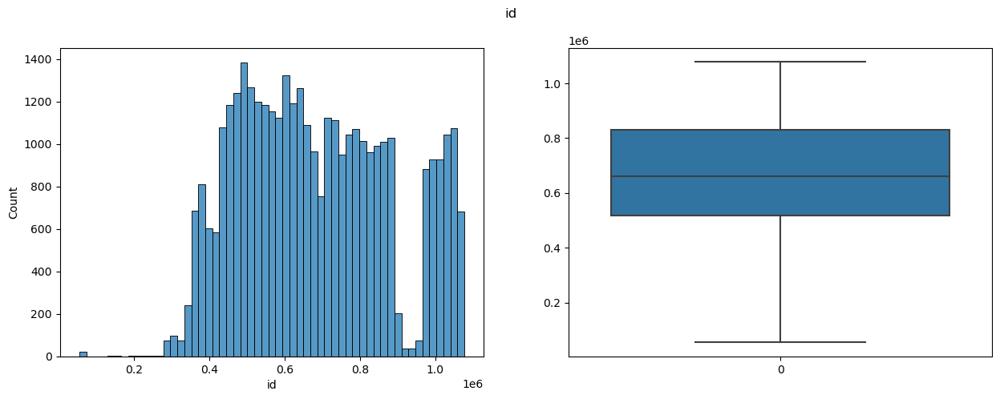

count    36788.000000
mean     11150.067957
std       7369.932662
min        500.000000
25%       5500.000000
50%      10000.000000
75%      15000.000000
max      35000.000000
Name: loan_amnt, dtype: float64


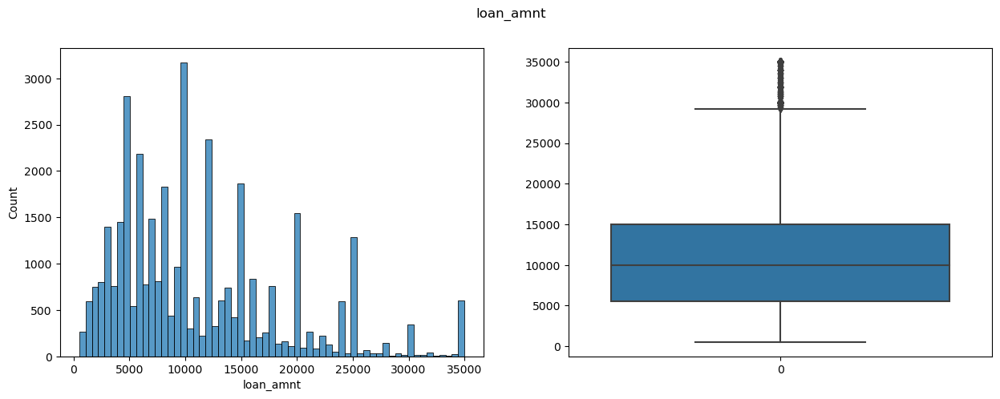

count    36788.000000
mean     10881.473578
std       7109.462401
min        500.000000
25%       5400.000000
50%       9600.000000
75%      15000.000000
max      35000.000000
Name: funded_amnt, dtype: float64


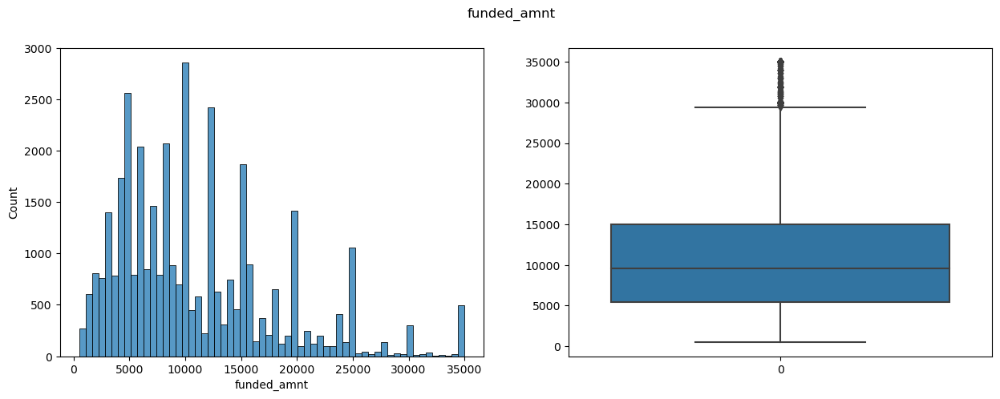

count    36788.00000
mean     10440.39945
std       7008.53588
min          0.00000
25%       5000.00000
50%       9000.00000
75%      14350.00000
max      35000.00000
Name: funded_amnt_inv, dtype: float64


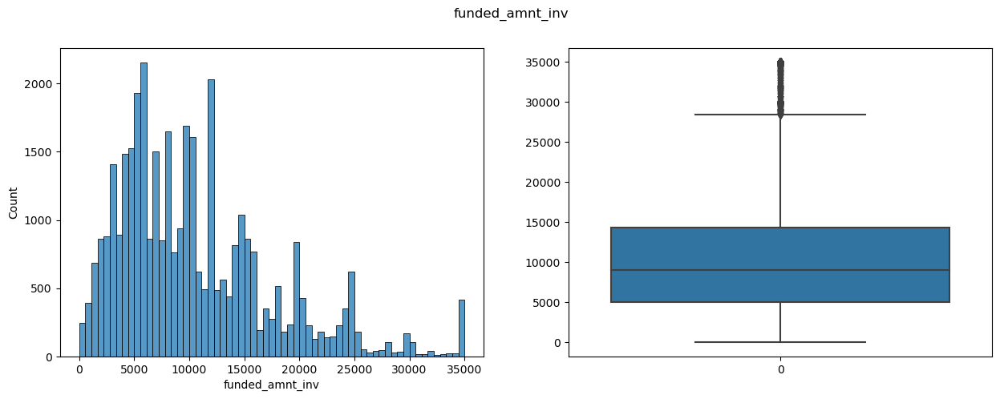

count    36788.000000
mean        11.983248
std          3.701190
min          5.420000
25%          8.940000
50%         11.830000
75%         14.460000
max         24.400000
Name: int_rate, dtype: float64


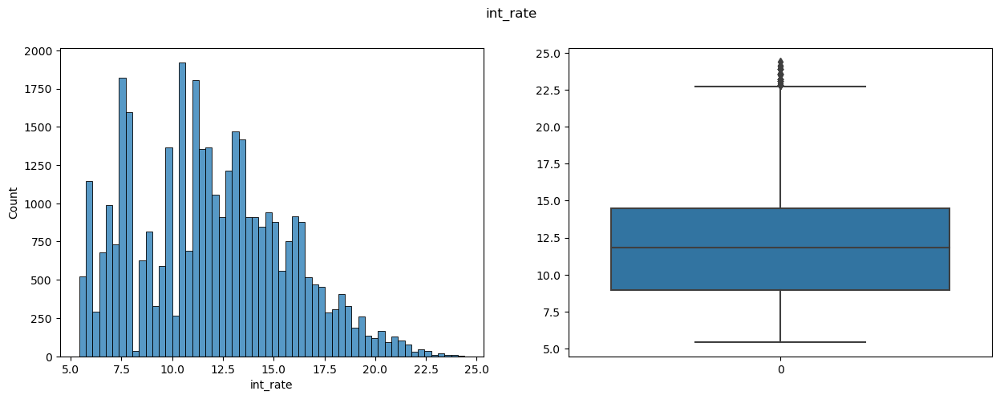

count    36788.000000
mean       324.928507
std        208.905795
min         16.080000
25%        167.730000
50%        280.175000
75%        429.420000
max       1305.190000
Name: installment, dtype: float64


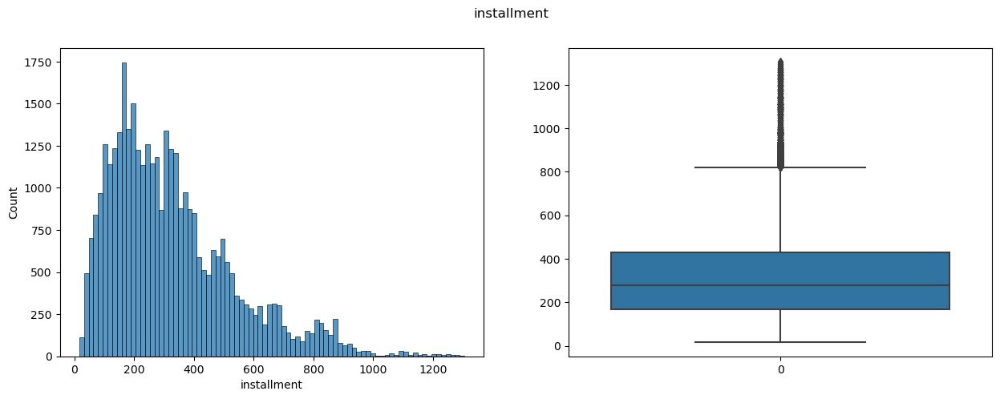

count    3.678800e+04
mean     6.944088e+04
std      6.402996e+04
min      4.000000e+03
25%      4.119600e+04
50%      6.000000e+04
75%      8.300000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64


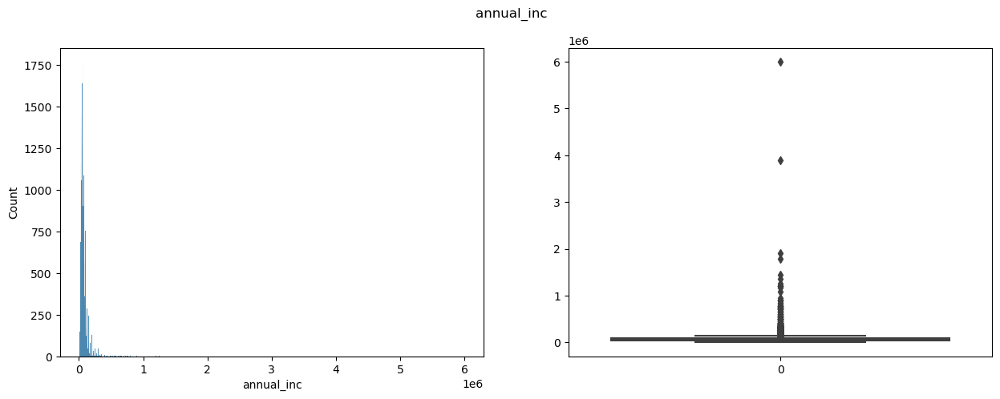

count    36788.000000
mean        13.335330
std          6.650077
min          0.000000
25%          8.220000
50%         13.430000
75%         18.590000
max         29.990000
Name: dti, dtype: float64


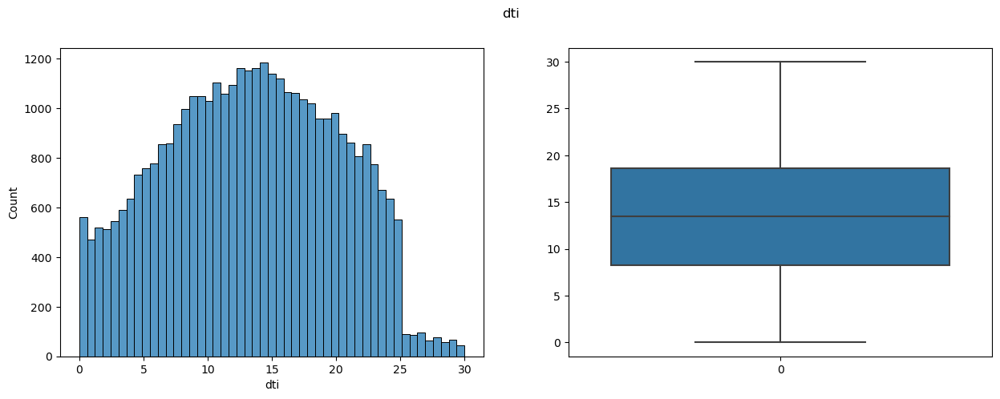

count    36788.000000
mean         0.146135
std          0.491878
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         11.000000
Name: delinq_2yrs, dtype: float64


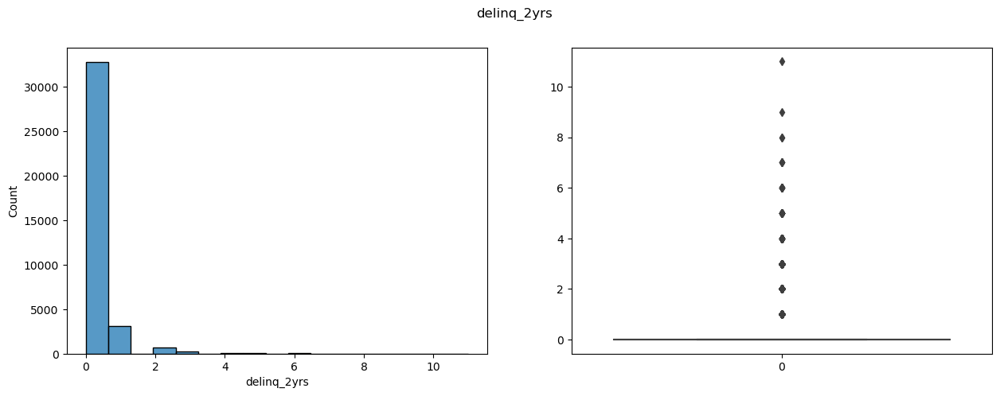

count    36788.000000
mean         0.869577
std          1.068078
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          8.000000
Name: inq_last_6mths, dtype: float64


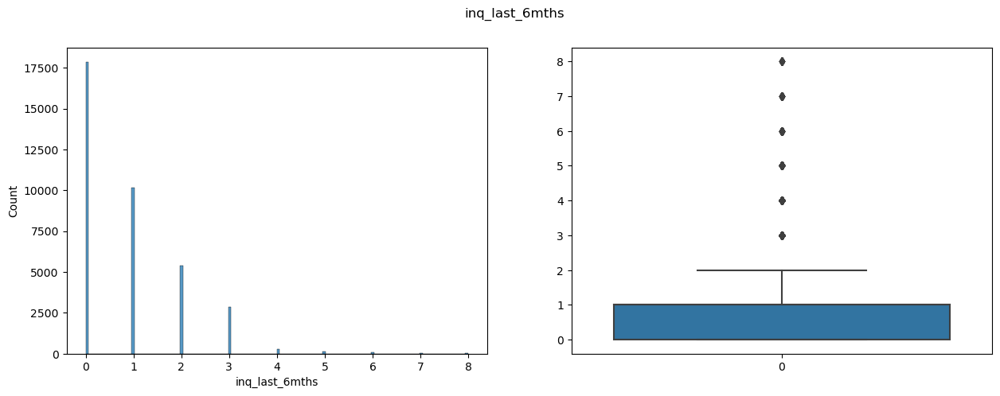

count    36788.000000
mean         9.302680
std          4.375511
min          2.000000
25%          6.000000
50%          9.000000
75%         12.000000
max         44.000000
Name: open_acc, dtype: float64


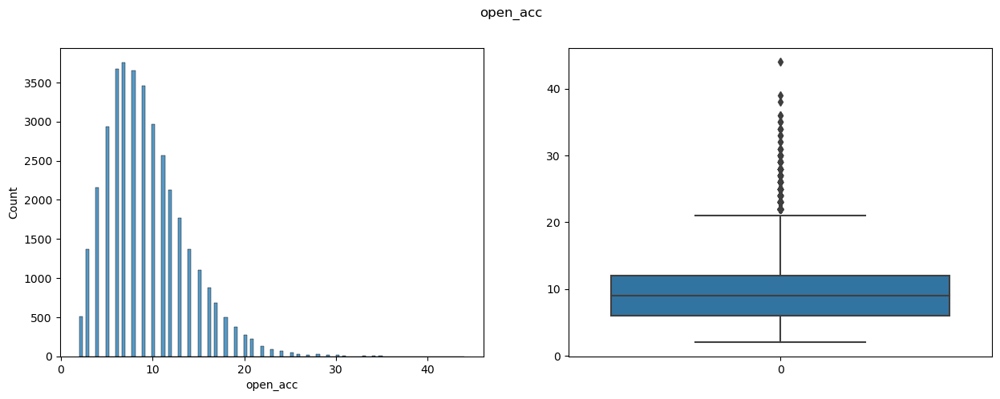

count    36788.000000
mean         0.054148
std          0.235495
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          4.000000
Name: pub_rec, dtype: float64


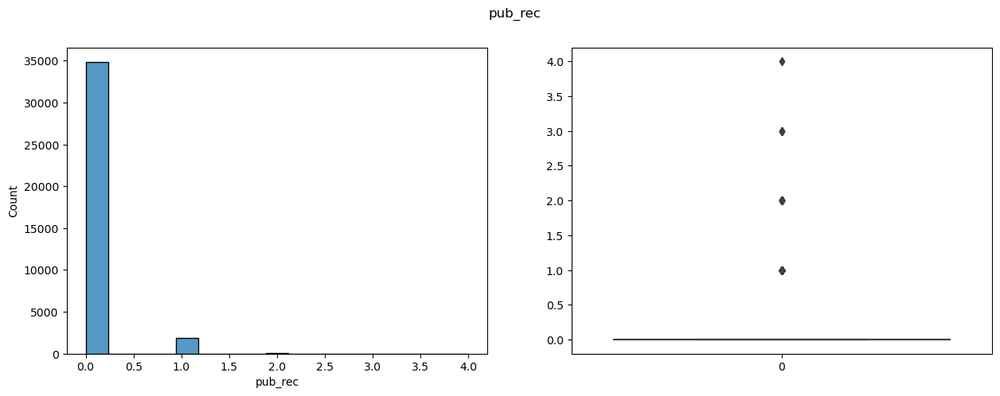

count     36788.000000
mean      13376.649043
std       15850.190608
min           0.000000
25%        3729.750000
50%        8869.500000
75%       17031.500000
max      149588.000000
Name: revol_bal, dtype: float64


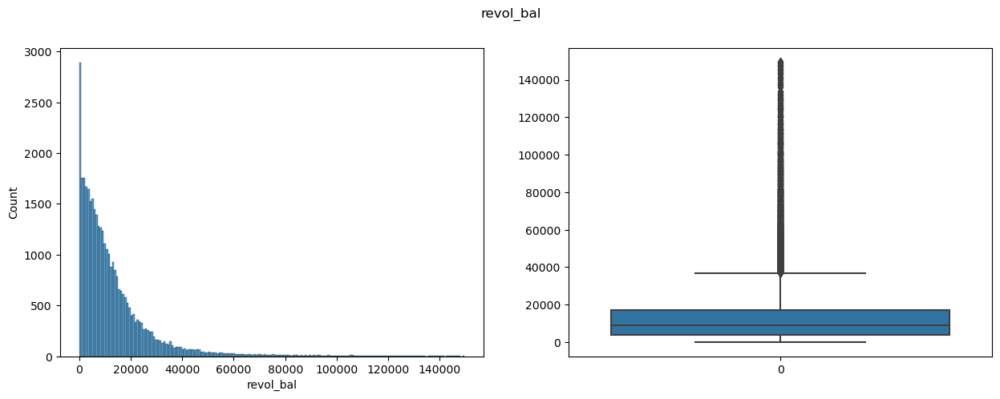

count    36788.000000
mean        48.993322
std         28.312148
min          0.000000
25%         25.600000
50%         49.500000
75%         72.500000
max         99.900000
Name: revol_util, dtype: float64


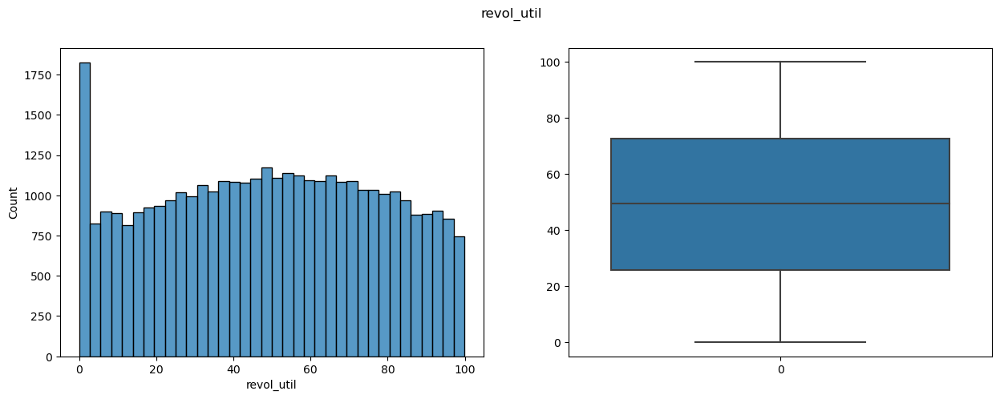

count    36788.000000
mean        22.153447
std         11.407936
min          2.000000
25%         14.000000
50%         20.000000
75%         29.000000
max         90.000000
Name: total_acc, dtype: float64


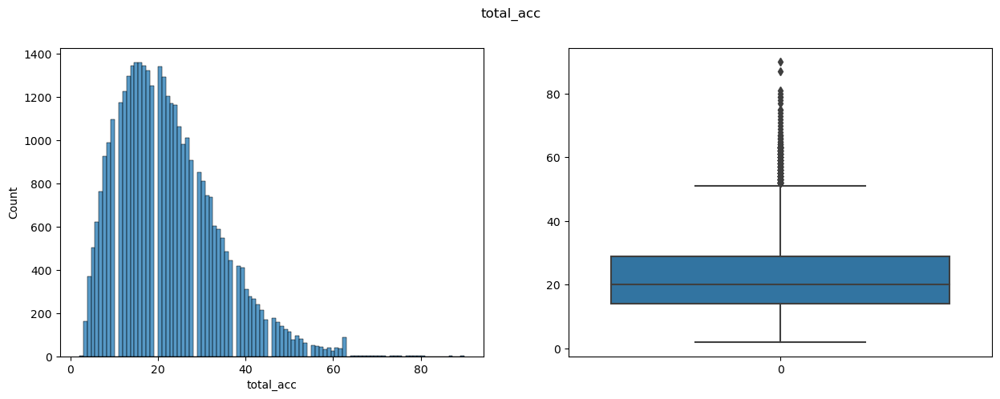

count    36788.000000
mean         0.041780
std          0.200767
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: pub_rec_bankruptcies, dtype: float64


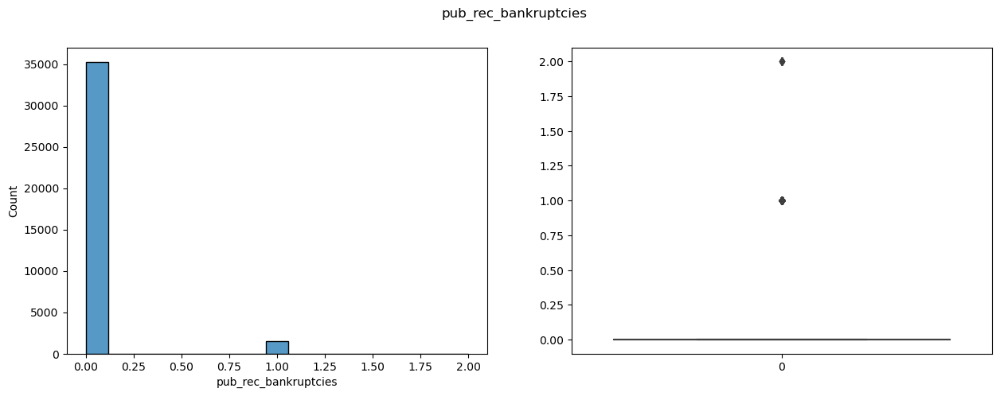

count    36788.000000
mean      2010.349924
std          0.815227
min       2007.000000
25%       2010.000000
50%       2011.000000
75%       2011.000000
max       2011.000000
Name: issue_d_year, dtype: float64


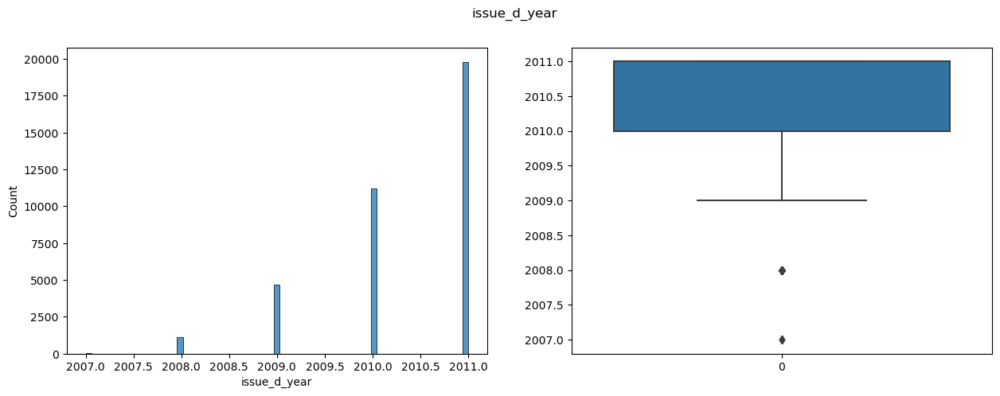

count    36788.000000
mean         7.157850
std          3.380543
min          1.000000
25%          4.000000
50%          7.000000
75%         10.000000
max         12.000000
Name: issue_d_month, dtype: float64


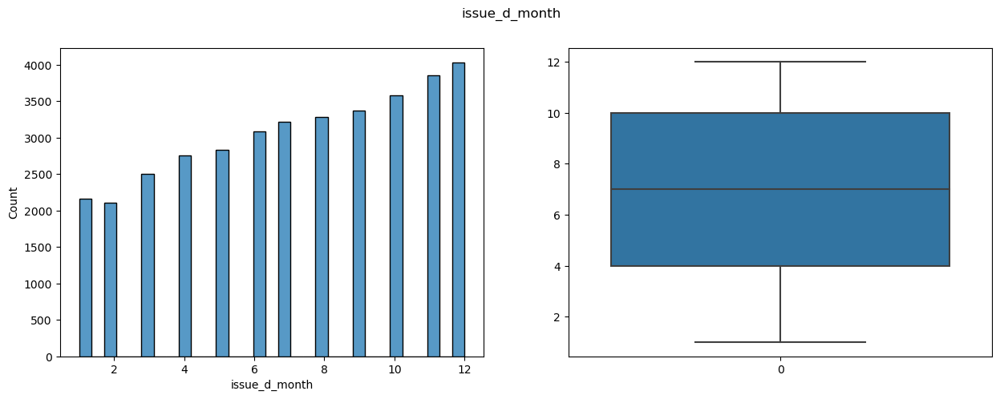

count    36788.000000
mean      1996.761988
std          6.625947
min       1946.000000
25%       1994.000000
50%       1998.000000
75%       2001.000000
max       2008.000000
Name: earliest_cr_line_year, dtype: float64


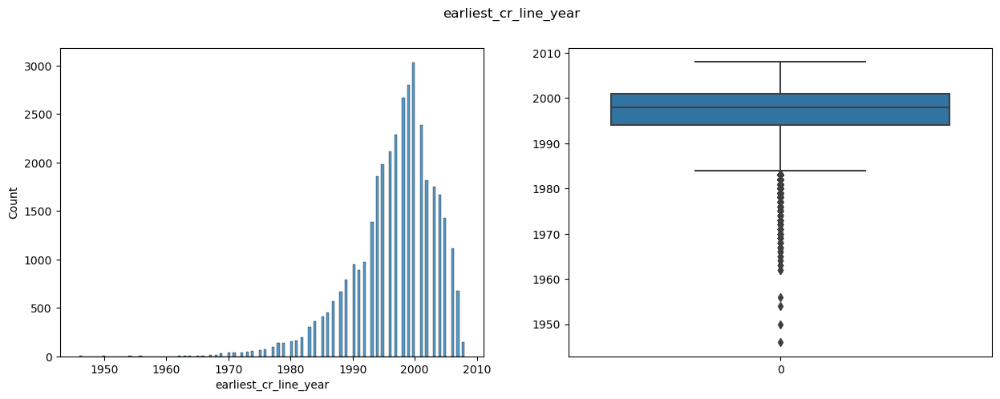

count    36788.000000
mean         6.894395
std          3.539527
min          1.000000
25%          4.000000
50%          7.000000
75%         10.000000
max         12.000000
Name: earliest_cr_line_month, dtype: float64


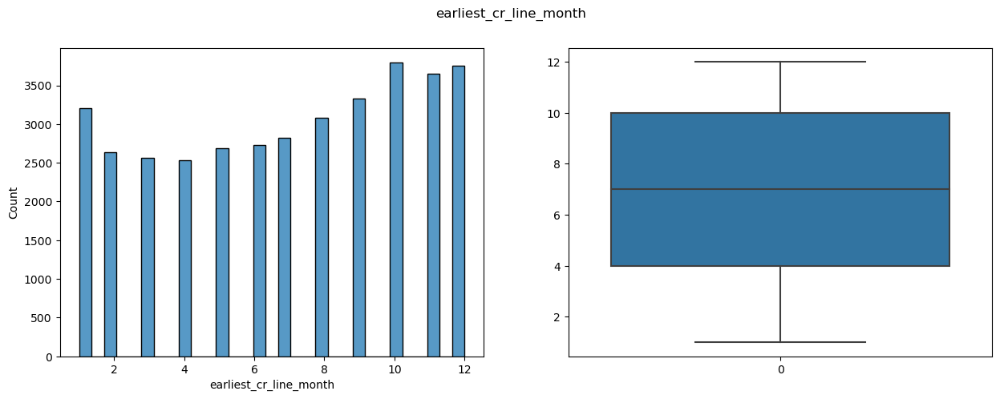

count    36788.000000
mean        94.831260
std         14.999525
min          0.000000
25%         98.410000
50%         99.970000
75%        100.000000
max        100.000000
Name: approved_loan_amt, dtype: float64


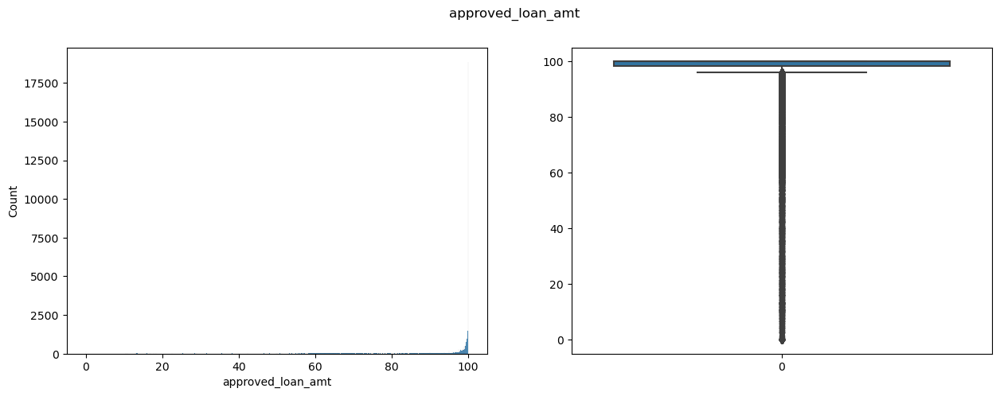

In [60]:
# We can use the below block to plot the integer and float type columns with
# histogram and box plot in one shot.
for col_name in loan_data.columns:
    if loan_data[col_name].dtype in ['int64','float64']:
        plt_hist_box(data=loan_data[col_name], title=col_name)
        
# But we will go through one by one which makes it easy to understand the plot and analysis of the same.

--- 
#### 1) id : 

*Description :* A unique LC assigned ID for the loan listing.

**Inference**

This column is 100% unique as we saw already, hence we skip analysing this column

---
#### 2) loan_amount :

*Description :* The listed amount of the loan applied for by the borrower. If at some point in time, the credit department reduces the loan amount, then it will be reflected in this value.

**Plot**

count    36788.000000
mean     11150.067957
std       7369.932662
min        500.000000
25%       5500.000000
50%      10000.000000
75%      15000.000000
max      35000.000000
Name: loan_amnt, dtype: float64


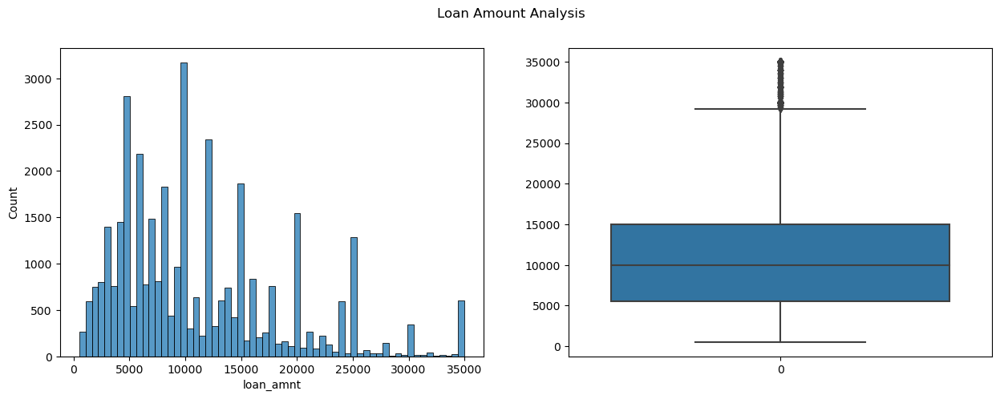

In [61]:
plt_hist_box(data=loan_data.loan_amnt, title="Loan Amount Analysis")

**Inference**

- We can see from hist plot, many have requested a loan amount of **10000** and it is also evident from box plot showing the median(50%) is **10000**.

- We can see from box plot, the upper fence is around **30000** and very few have taken loans *greater than 30000*.
- It is also clear from the distribution that **75% of borrowers** have requested for *smaller loan values of 15000 and below*.

---

#### 3) funded_amnt :

*Description :* The total amount committed to that loan at that point in time.

**Plot**

count    36788.000000
mean     10881.473578
std       7109.462401
min        500.000000
25%       5400.000000
50%       9600.000000
75%      15000.000000
max      35000.000000
Name: funded_amnt, dtype: float64


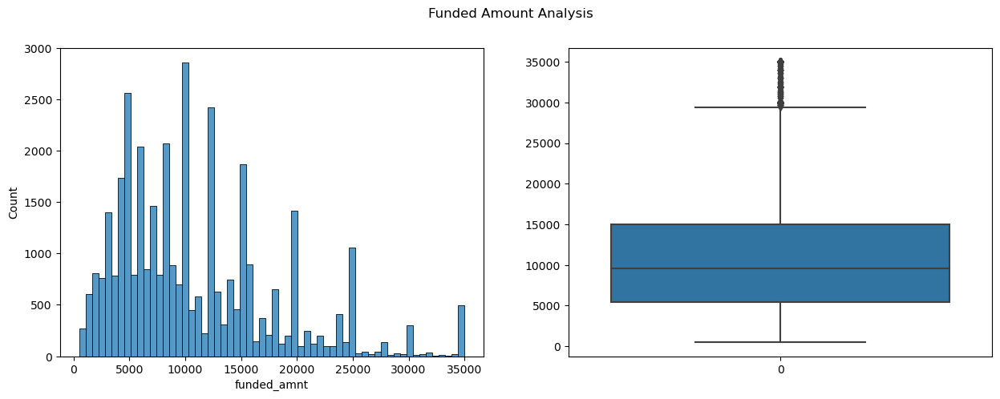

In [62]:
plt_hist_box(data=loan_data.funded_amnt, title="Funded Amount Analysis")

**Inference**

- We can see that funded_amnt is very similar to loan_amnt column. It is evident from the distribution where mean and std have a slight deviation whereas percentiles are similar.

- We can see from hist plot, many have funded loan amount of **10000** and it is also evident from box plot showing the median(50%) is **9600**.

- We can see from box plot, the upper fence is around **30000** and very few have funded loans *greater than 30000*.

- It is also clear from the distribution that **75% of borrowers** have funded for *smaller loan values of 15000 and below*.

---

#### 4) funded_amnt_inv :

*Description :* The total amount committed by investors for that loan at that point in time.

**Plot**

count    36788.00000
mean     10440.39945
std       7008.53588
min          0.00000
25%       5000.00000
50%       9000.00000
75%      14350.00000
max      35000.00000
Name: funded_amnt_inv, dtype: float64


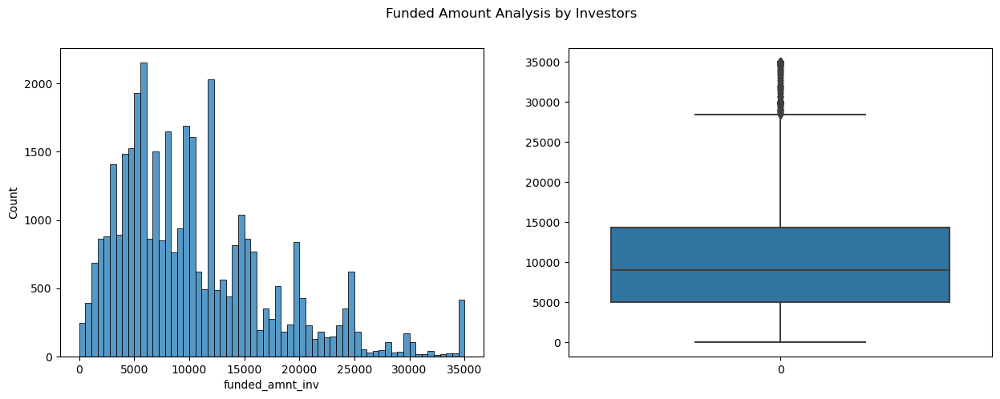

In [63]:
plt_hist_box(data=loan_data.funded_amnt_inv, title="Funded Amount Analysis by Investors")

**Inference**

- We can see that funded_amnt_inv is very similar to loan_amnt, funded_amnt column. It is evident from the distribution where mean, std and percentiles have a slight deviation.

- We can see from hist plot, LC have funded loan amount of around **9000** as it is evident from box plot showing the median(50%) is **9000**.

- We can see from box plot, the upper fence is around **30000** and very few have funded loans *greater than 30000*.

- It is also clear from the distribution that **75% of borrowers** have funded for *smaller loan values of 14350 and below*.

---

We saw that loan_amnt, funded_amnt and funded_amnt_inv have very similar behaviour. Let us plot side by side for reference.

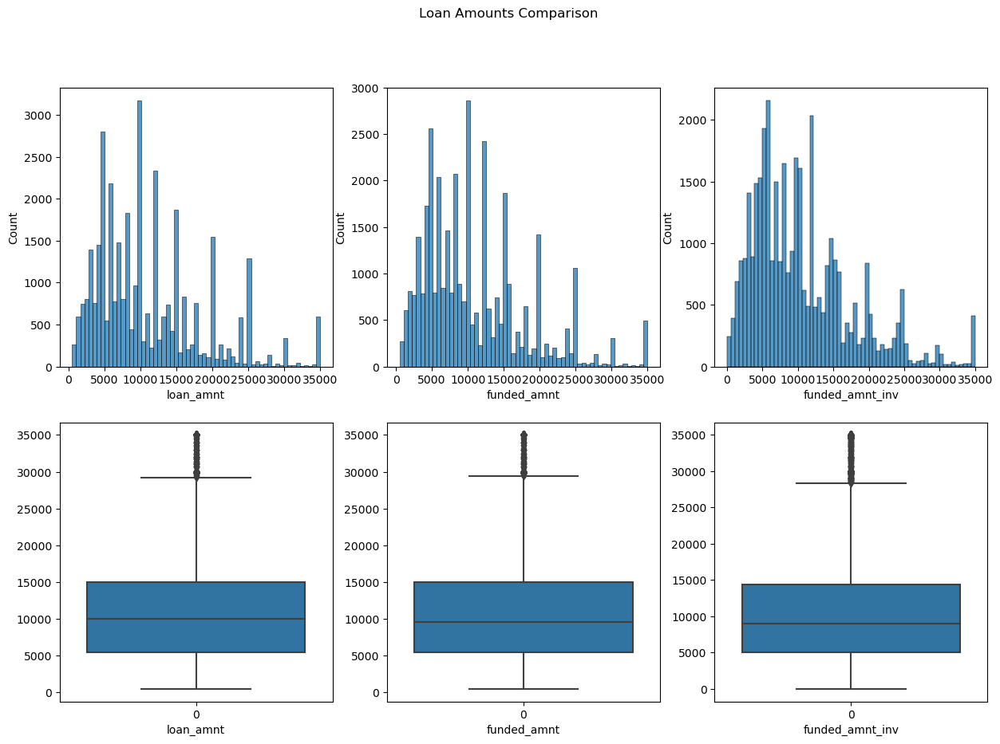

In [64]:
# Set the figure size to a standard so that it will be easy for viewing
plt.figure(figsize=(15,10))
# Set the subplot index
plt.subplot(2,3,1)
# Calling histogram plot
sns.histplot(loan_data.loan_amnt)
# Set the subplot index
plt.subplot(2,3,2)
# Calling histogram plot
sns.histplot(loan_data.funded_amnt)
# Set the subplot index
plt.subplot(2,3,3)
# Calling histogram plot
sns.histplot(loan_data.funded_amnt_inv)
# Set the subplot index
plt.subplot(2,3,4)
# Calling histogram plot
plt.xlabel('loan_amnt')
sns.boxplot(loan_data.loan_amnt)
# Set the subplot index
plt.subplot(2,3,5)
# Calling box plot
plt.xlabel('funded_amnt')
sns.boxplot(loan_data.funded_amnt)
# Set the subplot index
plt.subplot(2,3,6)
# Calling box plot
plt.xlabel('funded_amnt_inv')
sns.boxplot(loan_data.funded_amnt_inv)
# Set the title for the overall plot
plt.suptitle("Loan Amounts Comparison")
# Display the plot
plt.show()

---

#### 5) approved_loan_amt :

*Description :* The percentage of loan amount which was funded by investors.

**Plot**

count    36788.000000
mean        94.831260
std         14.999525
min          0.000000
25%         98.410000
50%         99.970000
75%        100.000000
max        100.000000
Name: approved_loan_amt, dtype: float64


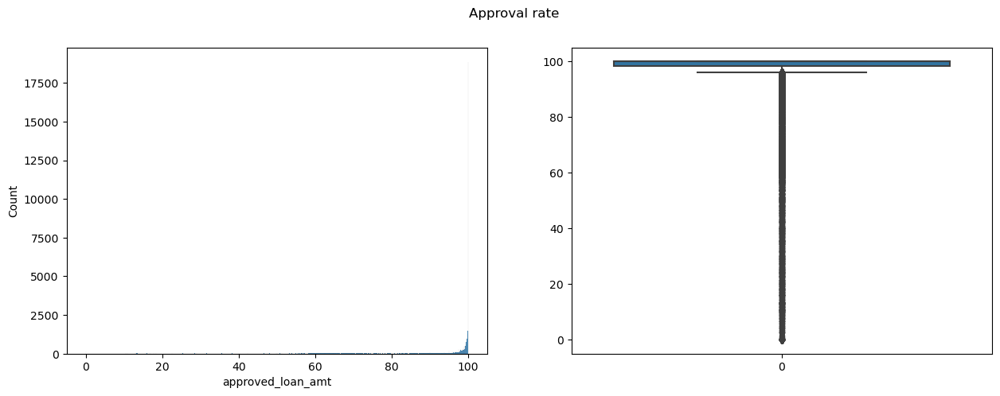

In [65]:
plt_hist_box(data=loan_data.approved_loan_amt, title="Approval rate")

**Inference**

- We can see that the loan approval rate is almost **100%**
- This is also inline and evident from the previous analysis between loan_amnt and funded_amnt_inv which is very similar, meaning the loan amount is funded by investors as requested.

---

#### 6) term:

*Description :* The number of payments on the loan. Values are in months and can be either 36 or 60.

**Plot**

       index      term
0  36 months  0.748532
1  60 months  0.251468


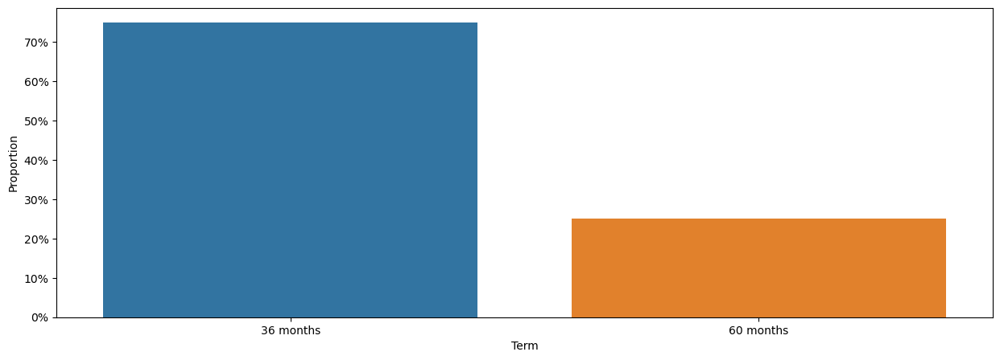

In [66]:
plt_bar_prop(loan_data,'term')

**Inference**

- We can see that more number of borrowers around **75%** opt for shorter loan term of 36 months

---

#### 7) int_rate:

*Description :* Interest Rate on the loan.

**Plot**

count    36788.000000
mean        11.983248
std          3.701190
min          5.420000
25%          8.940000
50%         11.830000
75%         14.460000
max         24.400000
Name: int_rate, dtype: float64


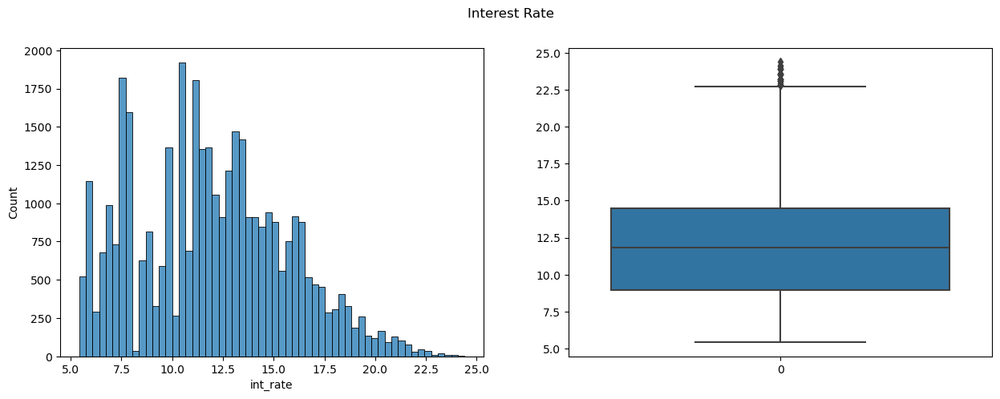

In [67]:
plt_hist_box(data=loan_data.int_rate, title="Interest Rate")

**Inference**

- We can see that most of the loans have an interest rates from **8.9% - 14.5%** with an average of around *12%*.
- We can see that from the box plot, there are few interest rates above **22.5%**.

---

#### 8) installment:

*Description :* The monthly payment owed by the borrower if the loan originates.

**Plot**

count    36788.000000
mean       324.928507
std        208.905795
min         16.080000
25%        167.730000
50%        280.175000
75%        429.420000
max       1305.190000
Name: installment, dtype: float64


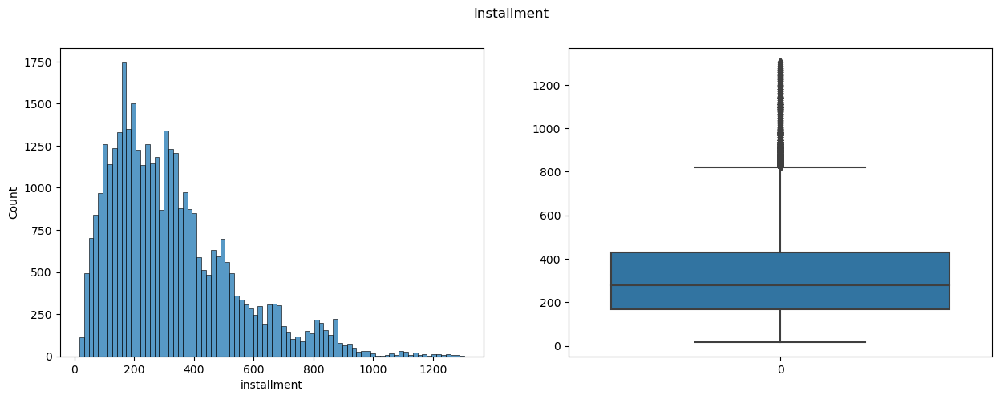

In [68]:
plt_hist_box(data=loan_data.installment, title="Installment")

**Inference**

- We can see that 75% of the installemnt are **less than 430**

---

#### 9) grade:

*Description :* LC assigned loan grade.

**Plot**

  index     grade
0     B  0.302979
1     A  0.258698
2     C  0.203110
3     D  0.131782
4     E  0.069941
5     F  0.025497
6     G  0.007992


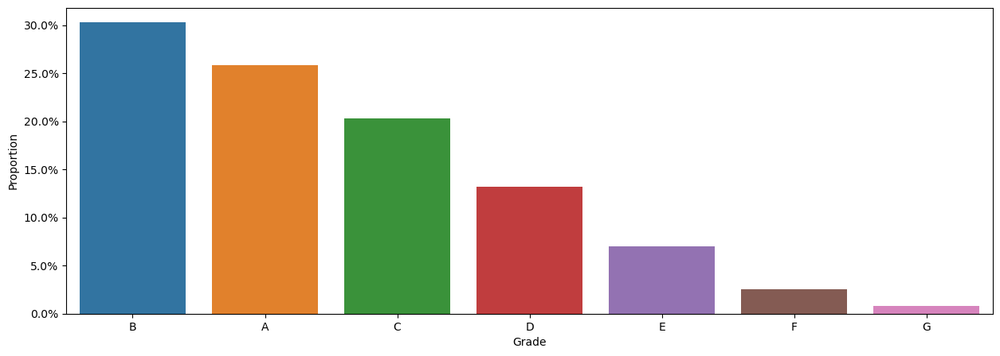

In [69]:
plt_bar_prop(loan_data, 'grade')

**Inference**

- We can see around **majority** of borrowers belong to grade **B (30%)** and **A (25%)**.
- This implies that grade A and B are *in need* of a loan compared to other categories.
---

#### 10) sub_grade:

*Description :* LC assigned loan subgrade.

**Plot**

   index  sub_grade
0     A4   0.075079
1     B3   0.073665
2     A5   0.070730
3     B5   0.068392
4     B4   0.063716
5     C1   0.053305
6     B2   0.051593
7     C2   0.050587
8     A3   0.046238
9     B1   0.045613
10    C3   0.038627
11    A2   0.038355
12    D2   0.033353
13    C4   0.030961
14    C5   0.029629
15    D3   0.028950
16    A1   0.028297
17    D1   0.023948
18    D4   0.023921
19    D5   0.021610
20    E1   0.019082
21    E2   0.016119
22    E3   0.013510
23    E4   0.011145
24    E5   0.010085
25    F1   0.008073
26    F2   0.006007
27    F3   0.004594
28    F4   0.003887
29    F5   0.002936
30    G1   0.002474
31    G2   0.002066
32    G4   0.001468
33    G3   0.001223
34    G5   0.000761


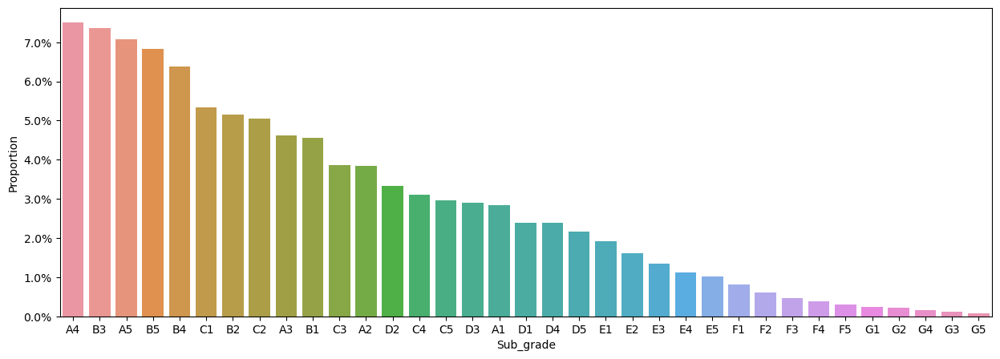

In [70]:
plt_bar_prop(loan_data, 'sub_grade')

**Inference**

- We can see again that **majority** of borrowers belong to subgrade **B** and **A**. 
- *7 out of top 10* belong to grade B and A
- This is again inline with the grade analysis.
---

#### 11) emp_length:

*Description :* Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years.

**Plot**

        index  emp_length
0   10+ years    0.227438
1    < 1 year    0.117647
2     2 years    0.114168
3     3 years    0.107290
4     4 years    0.089377
5     5 years    0.085762
6      1 year    0.083451
7     6 years    0.057954
8     7 years    0.045803
9     8 years    0.038273
10    9 years    0.032837


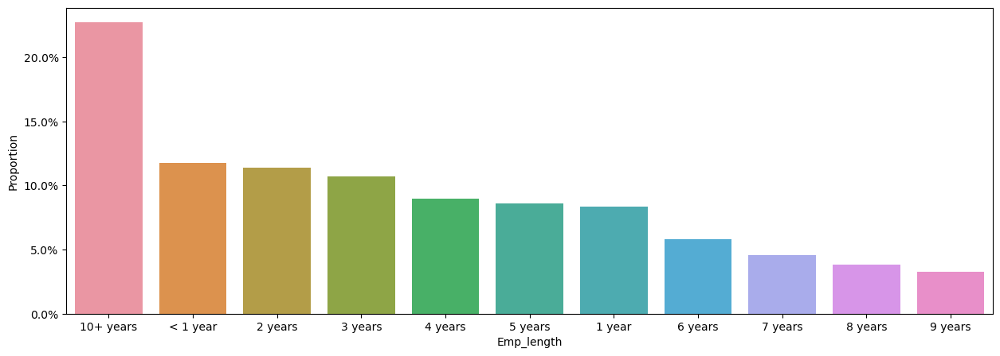

In [71]:
plt_bar_prop(loan_data, 'emp_length')

**Inference**

- We can see that borrowers with **more experience 10+ years and less experience < 4 years** contribute to _50%_ of the total borrowers.
- This behaviour may be because more experienced people need loan for meeting their bigger responsibilities like education, marriage of kids etc and less experienced people earn less which makes them to take loan for buying their needs like a vehicle, mobile phones, education loan etc.

---

#### 12) home_ownership:

*Description :* The home ownership status provided by the borrower during registration. Our values are: RENT, OWN, MORTGAGE, OTHER.

**Plot**

      index  home_ownership
0      RENT        0.480129
1  MORTGAGE        0.443868
2       OWN        0.073393
3     OTHER        0.002610


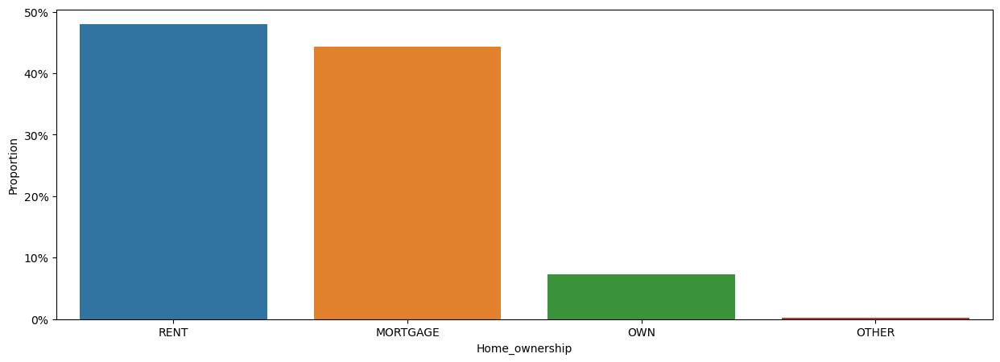

In [72]:
plt_bar_prop(loan_data, 'home_ownership')

**Inference**

- We can see that borrowers who are in **RENT and MORTGAGE** contribute to **90%** of the borrowers.

---

#### 13) annual_inc:

*Description :* The self-reported annual income provided by the borrower during registration.

**Plot**

count    3.678800e+04
mean     6.944088e+04
std      6.402996e+04
min      4.000000e+03
25%      4.119600e+04
50%      6.000000e+04
75%      8.300000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64


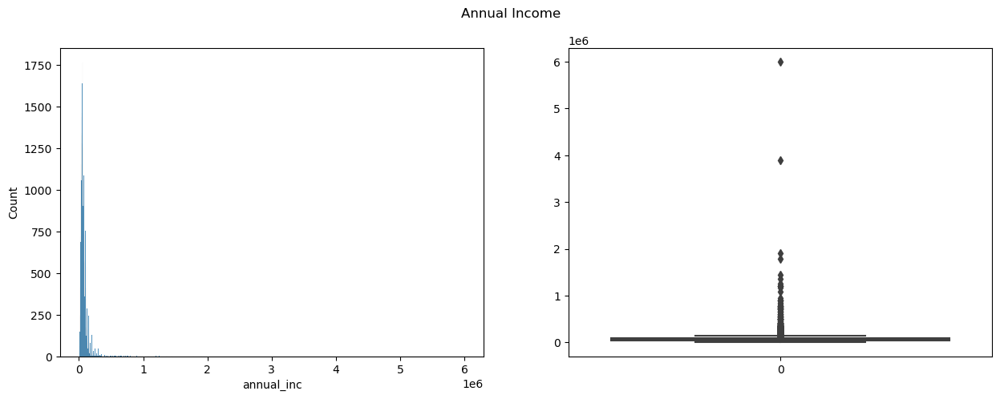

In [73]:
plt_hist_box(loan_data.annual_inc, "Annual Income")

It looks like there are few outliers which are very high causing the data range to be huge. Let's categorize these values.

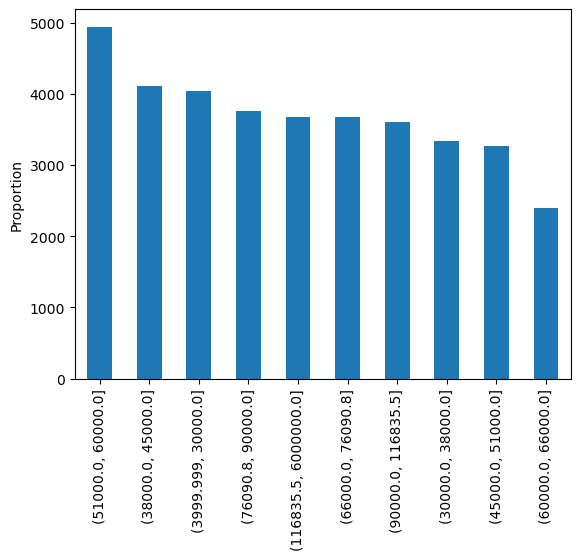

In [74]:
# Use qcut() method to create 10 buckets based on quantile
b_ann_inc = pd.qcut(loan_data.annual_inc,10).value_counts()
# Plot bar chart
b_ann_inc.plot.bar()
plt.ylabel('Proportion')
plt.show()

In [75]:
loan_data[loan_data.annual_inc >= 120000].annual_inc.value_counts().sum()

3535

**Inference**

- We can see that borrowers with annual income greater than 120000 are **very few** around 3535 borrowers.
- Majority(75%) of them earn annually **less than or equal to 83000**

---

#### 14) verification_status:

*Description :* Indicates if income was verified by LC, not verified, or if the income source was verified.

**Plot**

             index  verification_status
0     Not Verified             0.422638
1         Verified             0.319697
2  Source Verified             0.257666


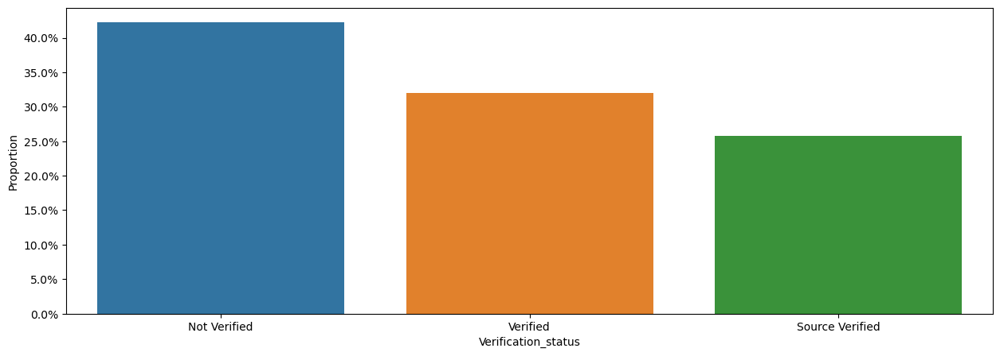

In [76]:
plt_bar_prop(loan_data, 'verification_status')

**Inference**

- LC has verified only **25%** of the income source, rest all are not verified.

---

#### 15) Loan Issued Date:

*Description :* The year which the loan was funded

**Plot**

   index  issue_d_year
0   2011      0.538056
1   2010      0.304094
2   2009      0.127705
3   2008      0.030010
4   2007      0.000136


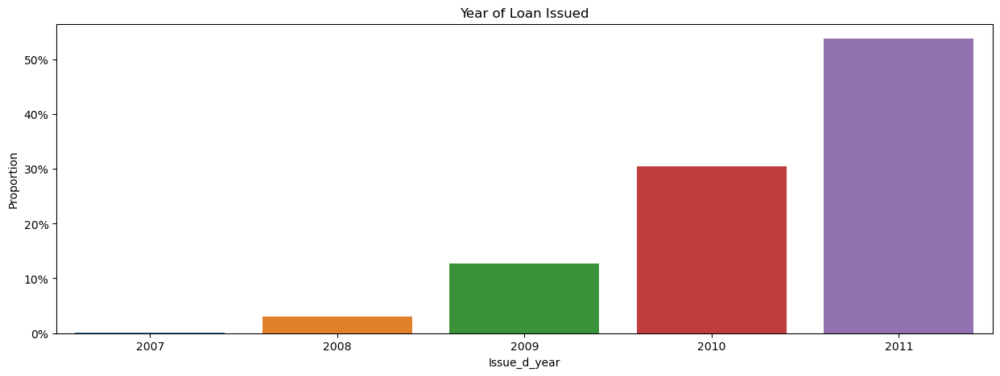

In [77]:
plt_bar_prop(loan_data, 'issue_d_year', 'Year of Loan Issued')

**Inference**

- There is steep increase in the number of loans issued by LC every year.

    index  issue_d_month
0      12       0.109628
1      11       0.104708
2      10       0.097477
3       9       0.091660
4       8       0.089214
5       7       0.087420
6       6       0.083750
7       5       0.077063
8       4       0.074861
9       3       0.068174
10      1       0.058715
11      2       0.057328


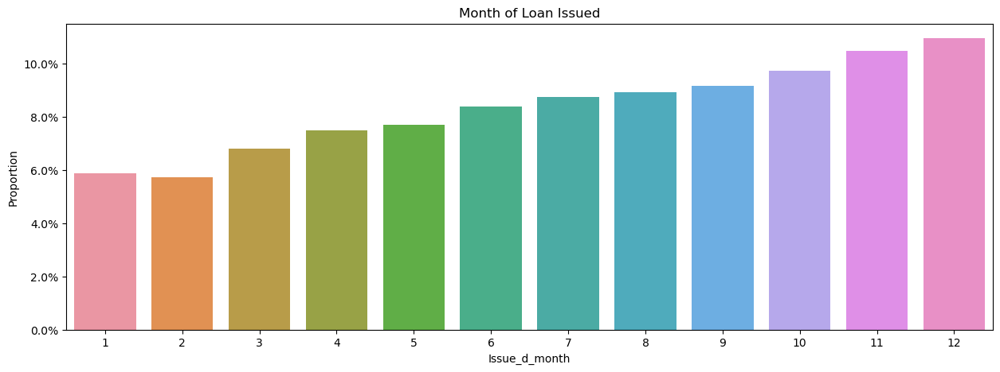

In [78]:
plt_bar_prop(loan_data, 'issue_d_month', 'Month of Loan Issued')

**Inference**

- Borrowers tend to take loans as the year ends.
---

#### 16) loan_status:

*Description :* Indicates if income was verified by LC, not verified, or if the income source was verified.

**Plot**

         index  loan_status
0   Fully Paid      0.85691
1  Charged Off      0.14309


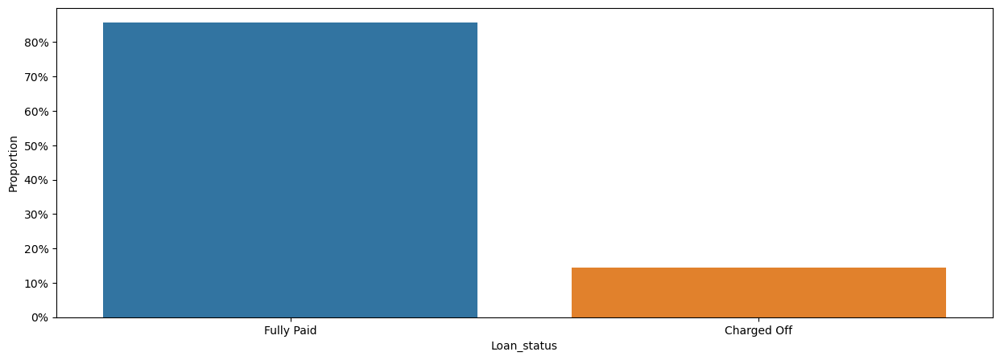

In [79]:
plt_bar_prop(loan_data, 'loan_status')

**Inference**

- Most of them around **85%** of borrowers have paid the loan.

---

#### 17) purpose:

*Description :* Indicates if income was verified by LC, not verified, or if the income source was verified.

**Plot**

                 index   purpose
0   debt_consolidation  0.472110
1          credit_card  0.130423
2                other  0.097668
3     home_improvement  0.074318
4       major_purchase  0.055833
5       small_business  0.044987
6                  car  0.038844
7              wedding  0.024274
8              medical  0.017533
9               moving  0.014706
10               house  0.009487
11            vacation  0.009269
12         educational  0.007992
13    renewable_energy  0.002555


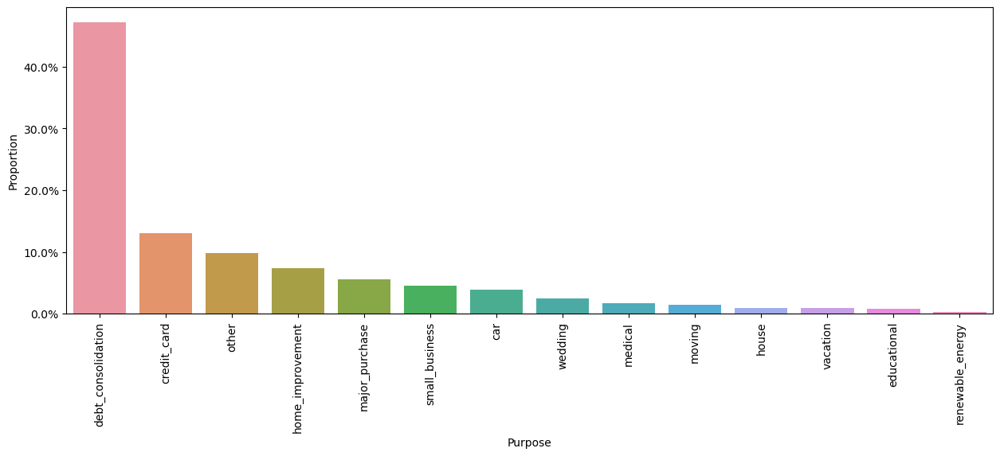

In [80]:
plt_bar_prop(loan_data, 'purpose', xrotate=90)

**Inference**

- **Debt consolidation and credit card** contribute to the majority(60%) purpose of the loan taken.

---

#### 18) title:

*Description :* The loan title provided by the borrower.

**Inference**

- title and purpuse looks to be similar column, let us skip analyzing this column.

---


#### 19) zip_code:

*Description :* Indicates if income was verified by LC, not verified, or if the income source was verified.

In [81]:
loan_data.zip_code.value_counts(normalize=True)

100xx    0.014951
945xx    0.013945
112xx    0.013156
606xx    0.013075
070xx    0.011879
           ...   
736xx    0.000027
007xx    0.000027
332xx    0.000027
461xx    0.000027
834xx    0.000027
Name: zip_code, Length: 807, dtype: float64

**Inference**

- There are borrowers from **807** different locations.
- Let us plot the first 20 zip codes for visual understanding.

**Plot**

    index  zip_code
0   100xx  0.014951
1   945xx  0.013945
2   112xx  0.013156
3   606xx  0.013075
4   070xx  0.011879
5   900xx  0.011689
6   300xx  0.010003
7   021xx  0.009840
8   926xx  0.009677
9   750xx  0.009487
10  941xx  0.009460
11  921xx  0.008916
12  917xx  0.008889
13  331xx  0.008862
14  770xx  0.008291
15  117xx  0.007557
16  113xx  0.007231
17  913xx  0.006986
18  852xx  0.006796
19  330xx  0.006442


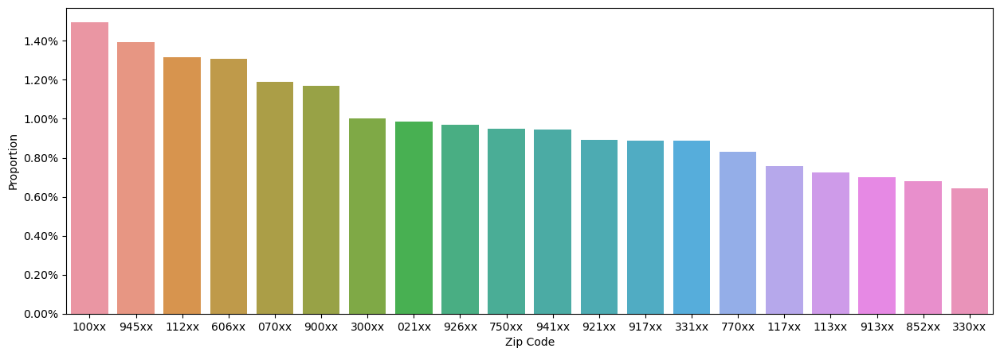

In [82]:
# Set the figure size to a standard so that it will be easy for viewing
plt.figure(figsize=(15,5))

# We will understand the distribution with respect to proportions than frequencies
data_p = loan_data.zip_code.value_counts(normalize=True)[:20].reset_index()

# Print the proportions
print(data_p)

# Bar plot the terms
ax = sns.barplot(x='index', y='zip_code', data=data_p)
# Set X Label
plt.xlabel('Zip Code')
# Set Y Label
plt.ylabel("Proportion")
# Set the proportions in y axis from 0.xx -> xx.yy% format
ax.yaxis.set_major_formatter(mtick.PercentFormatter(xmax=1, decimals=None, symbol='%', is_latex=False))
plt.show()

---

#### 20) addr_state:

*Description :* The state provided by the borrower in the loan application.

**Plot**

   index  addr_state
0     CA    0.181499
1     NY    0.095412
2     FL    0.071735
3     TX    0.069425
4     NJ    0.047026
5     IL    0.038844
6     PA    0.038708
7     VA    0.035474
8     GA    0.035175
9     MA    0.033408
10    OH    0.030608
11    MD    0.026585
12    AZ    0.021474
13    WA    0.020659
14    CO    0.019572
15    CT    0.018946
16    NC    0.018865
17    MI    0.017995
18    MO    0.017343
19    MN    0.015576
20    NV    0.012504
21    SC    0.012042
22    OR    0.011254
23    AL    0.011145
24    WI    0.011091
25    LA    0.011091
26    KY    0.008291
27    OK    0.007611
28    KS    0.006551
29    UT    0.006551
30    AR    0.006062
31    DC    0.005600
32    RI    0.005165
33    NM    0.004703
34    WV    0.004458
35    HI    0.004349
36    NH    0.004186
37    DE    0.002909
38    MT    0.002093
39    AK    0.002039
40    WY    0.002039
41    SD    0.001604
42    VT    0.001386
43    MS    0.000516
44    TN    0.000272
45    ID    0.000109
46    IA    0

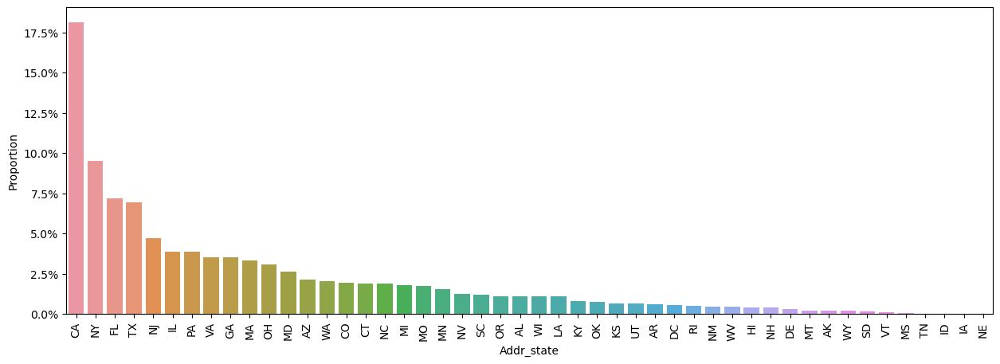

In [83]:
plt_bar_prop(loan_data, 'addr_state', xrotate=90)

**Inference**

- Most of the borrowers are from **California and New York** city.

---

#### 21) dti:

*Description :* A ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LC loan, divided by the borrower’s self-reported monthly income.

**Plot**

count    36788.000000
mean        13.335330
std          6.650077
min          0.000000
25%          8.220000
50%         13.430000
75%         18.590000
max         29.990000
Name: dti, dtype: float64


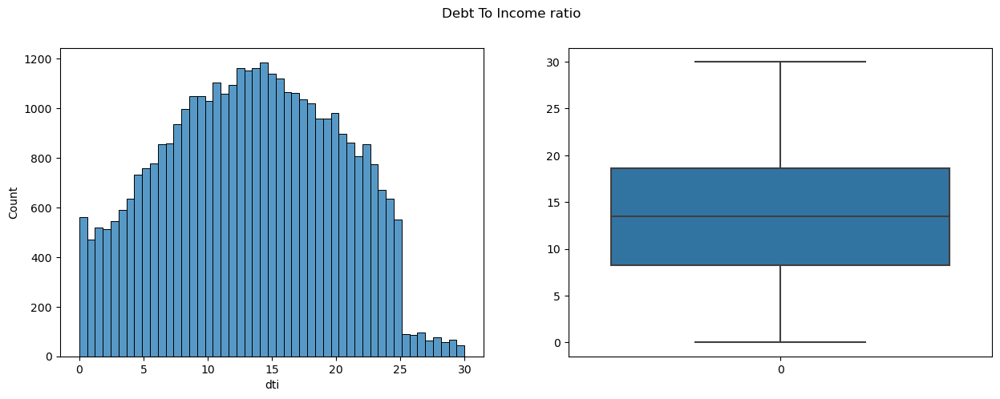

In [84]:
plt_hist_box(loan_data.dti, "Debt To Income ratio")

**Inference**

- Most representative value of dti is **13.43**

---

#### 22) delinq_2yrs:

*Description :* The number of 30+ days past-due incidences of delinquency in the borrower's credit file for the past 2 years.

**Plot**

count    36788.000000
mean         0.146135
std          0.491878
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         11.000000
Name: delinq_2yrs, dtype: float64


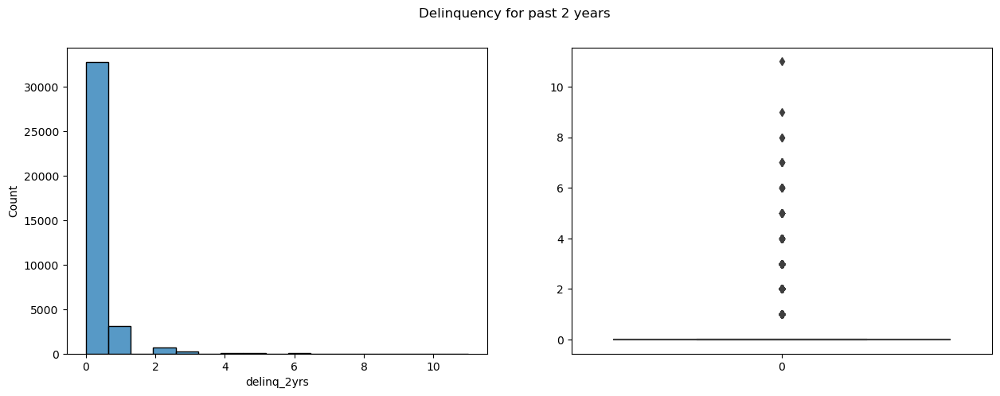

In [85]:
plt_hist_box(loan_data.delinq_2yrs, "Delinquency for past 2 years")

**Inference**

- Majority of the values are 0. We can ignore this column as it does not provide any insight.

---

#### 23) earliest_cr_line:

*Description :* The month the borrower's earliest reported credit line was opened

**Plot**

    index  earliest_cr_line_year
0    2000               0.082473
1    1999               0.076248
2    1998               0.072469
3    2001               0.064831
4    1997               0.062303
5    1996               0.057437
6    1995               0.053931
7    1994               0.050587
8    2002               0.049282
9    2003               0.047543
10   2004               0.045341
11   2005               0.038735
12   1993               0.037703
13   2006               0.030282
14   1992               0.026503
15   1990               0.025742
16   1991               0.024301
17   1989               0.021393
18   2007               0.018376
19   1988               0.018212
20   1987               0.015358
21   1986               0.012178
22   1985               0.011063
23   1984               0.009895
24   1983               0.008236
25   1982               0.005273
26   1981               0.004349
27   1980               0.004268
28   2008               0.003914
29   1979 

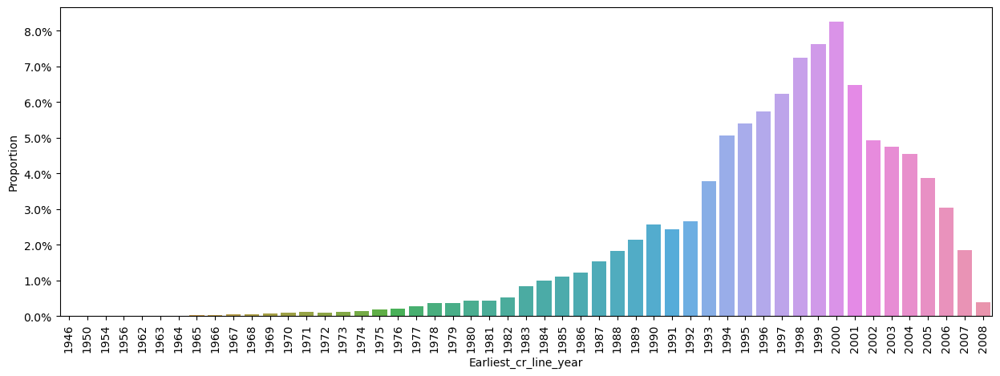

In [86]:
plt_bar_prop(loan_data, 'earliest_cr_line_year', xrotate=90)

**Inference**

- There was a significant increase in earliest credit line opened till 2000 and then started dropping.

    index  earliest_cr_line_month
0      10                0.103186
1      12                0.102017
2      11                0.099108
3       9                0.090573
4       1                0.087039
5       8                0.083723
6       7                0.076819
7       6                0.074236
8       5                0.073040
9       2                0.071763
10      3                0.069697
11      4                0.068800


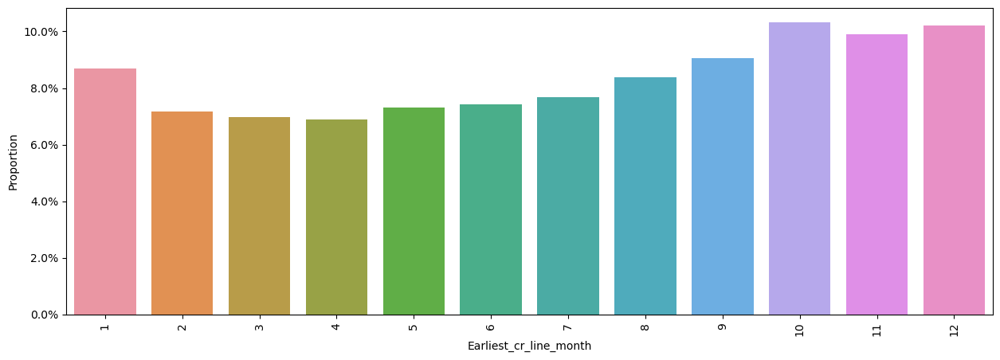

In [87]:
plt_bar_prop(loan_data, 'earliest_cr_line_month', xrotate=90)

**Inference**

- The distribution seems to be uniform and hence we can ignore this column
---

#### 24) inq_last_6mths:

*Description :* The number of inquiries in past 6 months (excluding auto and mortgage inquiries)

**Plot**

count    36788.000000
mean         0.869577
std          1.068078
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          8.000000
Name: inq_last_6mths, dtype: float64


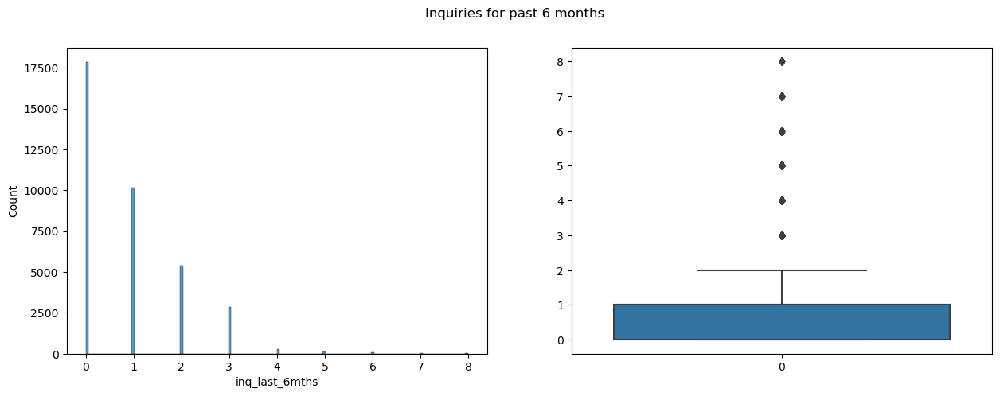

In [88]:
plt_hist_box(loan_data.inq_last_6mths, "Inquiries for past 6 months")

**Inference**

- Majority of them have **1 inquiry.**

---

#### 25) open_acc:

*Description :* The number of open credit lines in the borrower's credit file.

**Plot**

count    36788.000000
mean         9.302680
std          4.375511
min          2.000000
25%          6.000000
50%          9.000000
75%         12.000000
max         44.000000
Name: open_acc, dtype: float64


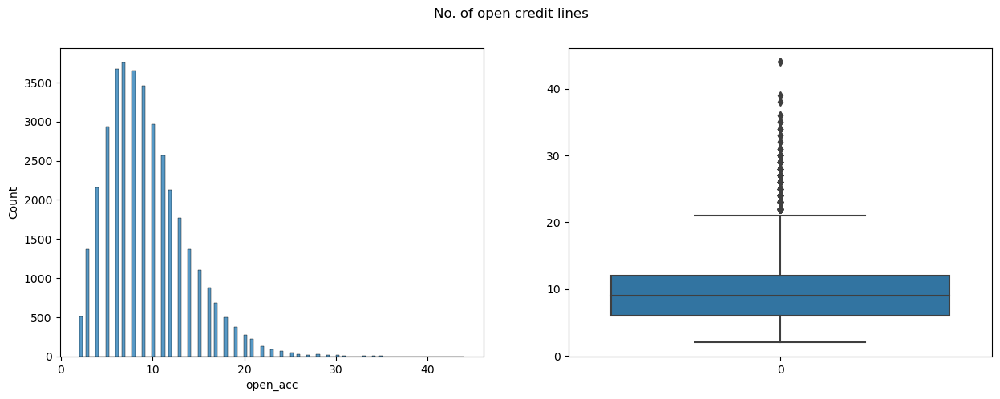

In [89]:
plt_hist_box(loan_data.open_acc, "No. of open credit lines")

**Inference**

- Majority of them have **less than 12** open credit lines.
- Values greater than 20 seems to be outliers as their frequency is less and far from trend.

---

#### 26) pub_rec:

*Description :* Number of derogatory public records

**Plot**

count    36788.000000
mean         0.054148
std          0.235495
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          4.000000
Name: pub_rec, dtype: float64


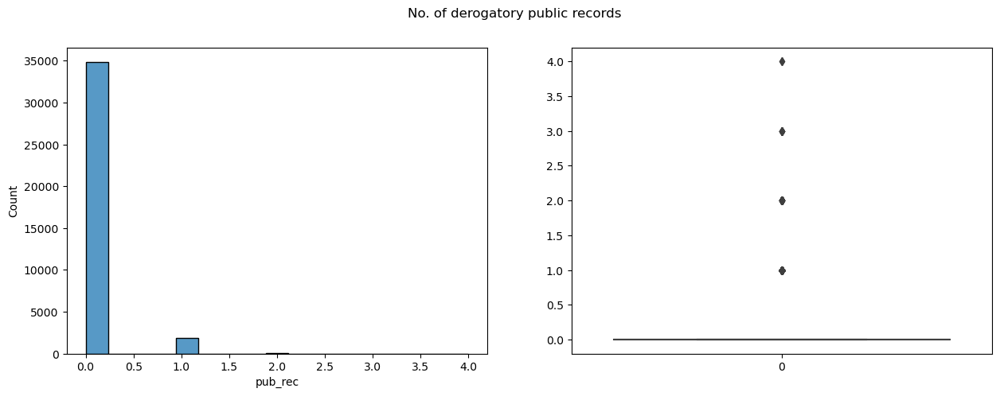

In [90]:
plt_hist_box(loan_data.pub_rec, "No. of derogatory public records")

In [91]:
loan_data.pub_rec.value_counts()

0    34861
1     1873
2       45
3        7
4        2
Name: pub_rec, dtype: int64

**Inference**

- Majority of them have no derogatory.
- Only 54 of them have 1 or more derogatories.

---

#### 27) pub_rec_bankruptcies:

*Description :* Number of public record bankruptcies.

**Plot**

count    36788.000000
mean         0.041780
std          0.200767
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: pub_rec_bankruptcies, dtype: float64


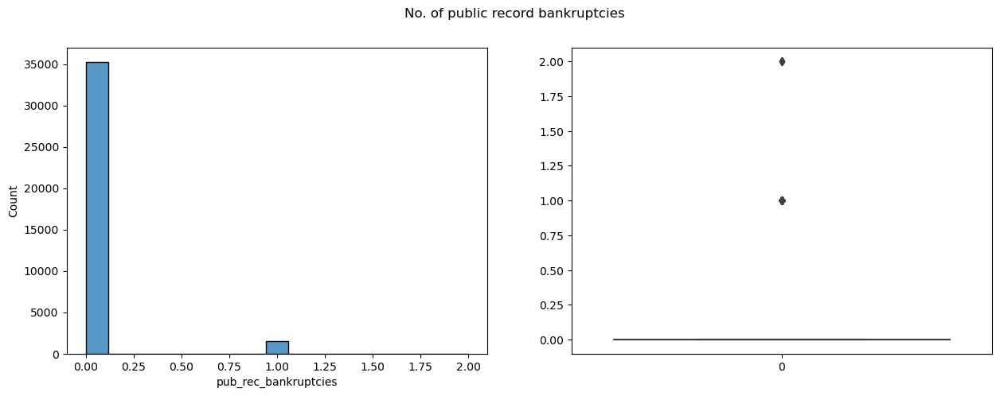

In [92]:
plt_hist_box(loan_data.pub_rec_bankruptcies, "No. of public record bankruptcies")

In [93]:
loan_data.pub_rec_bankruptcies.value_counts()

0.0    35256
1.0     1527
2.0        5
Name: pub_rec_bankruptcies, dtype: int64

**Inference**

- Majority of them have no public record bankruptcies which is a good sign.
---

#### 28) revol_bal:

*Description :* Total credit revolving balance.

**Plot**

count     36788.000000
mean      13376.649043
std       15850.190608
min           0.000000
25%        3729.750000
50%        8869.500000
75%       17031.500000
max      149588.000000
Name: revol_bal, dtype: float64


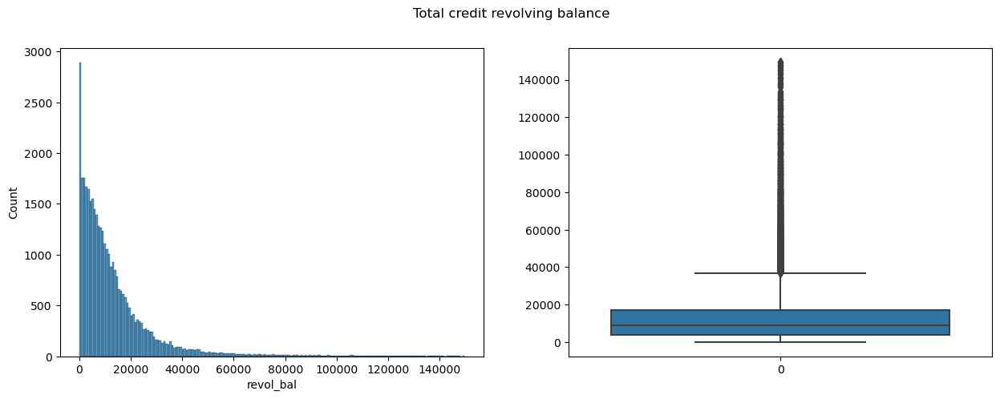

In [94]:
plt_hist_box(loan_data.revol_bal, "Total credit revolving balance")

**Inference**

- Most representative value of total credit revolving balance is **8870**.
- Most of the borrowers have **very low** revolving balance which is a good sign.
---

#### 29) revol_util:

*Description :* Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.

**Plot**

count    36788.000000
mean        48.993322
std         28.312148
min          0.000000
25%         25.600000
50%         49.500000
75%         72.500000
max         99.900000
Name: revol_util, dtype: float64


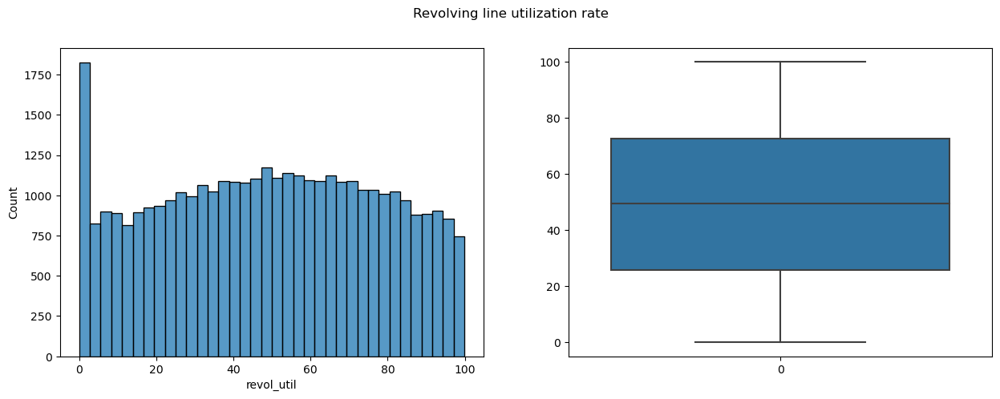

In [95]:
plt_hist_box(loan_data.revol_util, "Revolving line utilization rate")

**Inference**

- The spread is almost uniform expect at 0.
- It is evident from percentiles as well, 25 percentile people have 25 as rate.
---

#### 30) total_acc:

*Description :* The total number of credit lines currently in the borrower's credit file.

**Plot**

count    36788.000000
mean        22.153447
std         11.407936
min          2.000000
25%         14.000000
50%         20.000000
75%         29.000000
max         90.000000
Name: total_acc, dtype: float64


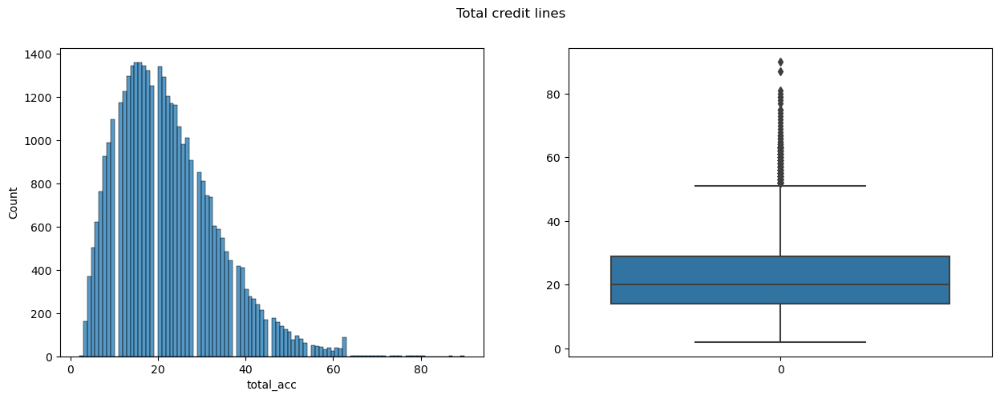

In [96]:
plt_hist_box(loan_data.total_acc, "Total credit lines")

**Inference**

- Majority of them have **less than 30** total credit lines.
- Values greater than 50 are very less and they tend to be the outliers.
---

We have performend univariate analysis on each and every column we have chosen and found the trend of the same. We have found outliers in few of the columns, let us remove those before moving to the next step.

**Outlier Treatment:**

**Annual Income**

In [97]:
# We saw in univariate analysis that this column has significant outliers. Let us find those.
print(loan_data.annual_inc.describe())
print("99th percentile : ", loan_data.annual_inc.quantile(0.99))

count    3.678800e+04
mean     6.944088e+04
std      6.402996e+04
min      4.000000e+03
25%      4.119600e+04
50%      6.000000e+04
75%      8.300000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64
99th percentile :  235000.0


We can see that 99th percentile is 235000 whereas maximum value is 6000000 which is very large difference. We will remove these outliers just here for our analysis.

In [98]:
# Filtering outliers more than 99th percentile
loan_data = loan_data[loan_data.annual_inc <= loan_data.annual_inc.quantile(0.99)]

**Open credit lines**

In [99]:
# We saw in univariate analysis that this column has significant outliers. Let us find those.
print(loan_data.open_acc.describe())
print("99th percentile : ", loan_data.open_acc.quantile(0.99))

count    36427.000000
mean         9.284597
std          4.366358
min          2.000000
25%          6.000000
50%          9.000000
75%         12.000000
max         44.000000
Name: open_acc, dtype: float64
99th percentile :  22.0


We can see that 99th percentile is 22 whereas maximum value is 44 which is large difference for a short range of values. We will remove these outliers just here for our analysis.

In [100]:
# Filtering outliers more than 99th percentile
loan_data = loan_data[loan_data.open_acc <= loan_data.open_acc.quantile(0.99)]

**Total credit lines**

In [101]:
# We saw in univariate analysis that this column has significant outliers. Let us find those.
print(loan_data.total_acc.describe())
print("99th percentile : ", loan_data.total_acc.quantile(0.99))

count    36111.000000
mean        21.852704
std         11.122967
min          2.000000
25%         13.000000
50%         20.000000
75%         29.000000
max         90.000000
Name: total_acc, dtype: float64
99th percentile :  54.0


We can see that 99th percentile is 56 whereas maximum value is 90 which is very large difference for a small range of values. We will remove these outliers just here for our analysis.

In [102]:
# Filtering outliers more than 99th percentile
loan_data = loan_data[loan_data.total_acc <= loan_data.total_acc.quantile(0.99)]

In [103]:
print("Clean loan data after outlier treatment : ", loan_data.shape)

Clean loan data after outlier treatment :  (35780, 34)


- Next we will start with segmented univariate analysis.

---
---

## Segmented Univariate analysis

**Plot function**

In [104]:
# As we are doing segmented univariate analysis in all columns, let us define common plot functions.

# The below function creates one/two box plots of data in a single plot object
# data   - Input - Dataset which has the values
# title1 - Input - Title of the first plot
# x1     - Input - x value of first plot
# y1     - Input - y value of first plot
# x1rotate - Input - rotate xticks of first plot
# title2 - Input - Title of the second plot
# x2     - Input - x value of second plot
# y2     - Input - y value of second plot
# x2rotate - Input - rotate xticks of second plot
# Note : If we set x2 as empty, the function will not plot second plot
def plt_seg_boxes(data="", title1="", x1="", y1="", x1rotate=0, title2="", x2="", y2="",x2rotate=0):    
    # If second plot data is empty, then do a single plot
    if x2 == "":
        # Set the figure size to a standard so that it will be easy for viewing
        plt.figure(figsize=(15,5))
        # Set title
        plt.title(title1)
        # Rotate x ticks
        plt.xticks(rotation=x1rotate)
        # Calling box plot with sorting the xticks in asecding order
        sns.boxplot(x=x1, y=y1, data=data, order=sorted(data[x1].unique()))
    else:
        # Set the figure size to a standard so that it will be easy for viewing
        plt.figure(figsize=(15,5))
        # Set the subplot index
        plt.subplot(1,2,1)
        # Set title
        plt.title(title1)
        # Rotate x ticks
        plt.xticks(rotation=x1rotate)
        # Calling box plot with sorting the xticks in asecding order
        sns.boxplot(x=x1, y=y1, data=data, order=sorted(data[x1].unique()))
        # Set the subplot index
        plt.subplot(1,2,2)
        # Set title
        plt.title(title2)
        # Rotate x ticks
        plt.xticks(rotation=x2rotate)
        # Calling box plot with sorting the xticks in asecding order
        sns.boxplot(x=x2, y=y2, data=data, order=sorted(data[x2].unique()))
    plt.show()

**Segmented Univariate analysis** in simple words, grouping continuous values based on certain categorical values and analysing such categories.

Hence, we define the below template which plots the graph taking one column as input and analyze against all the columns of interest.

Here, we are skipping the below columns:
| Skip Column  | Alternate column | Reason |
|:----------------|:-----------------|:-------|
|sub_grade | grade| Both gives *grade* information |
|zip_code  |state | Both gives *location* information |
|title   |purpose | Both gives *loan reason* information|

Another common reason to skip sub_grade, zip_code and title columns is that they all have wide range of categories and analyzing that many categories will not provide much insight.

**Template Function**

In [105]:
# data  - Input - Dataframe which holds the data to analyze
# col   - Input - Column to be segment analyzed
# title - Input - Title of the plot
def plt_seg_analysis(data='', col='', title=''):
    plt_seg_boxes(data, 
                  title1 = "Term vs "+ title,
                  x1     = 'term',
                  y1     =  col,
                  title2 = "Grade vs "+ title,
                  x2     = 'grade',
                  y2     =  col)

    plt_seg_boxes(data, 
                  title1 = "Employee Length vs "+ title,
                  x1     = 'emp_length',
                  y1     =  col,
                  x1rotate = 90,
                  title2 = "Home Ownership vs "+ title,
                  x2     = 'home_ownership',
                  y2     =  col)

    plt_seg_boxes(data, 
                  title1 = "Verification Status vs "+ title,
                  x1     = 'verification_status',
                  y1     =  col,
                  title2 = "Loan Status vs "+ title,
                  x2     = 'loan_status',
                  y2     =  col)

    plt_seg_boxes(data, 
                  title1 = "Issued Year vs "+ title,
                  x1     = 'issue_d_year', 
                  y1     =  col,
                  title2 = "Issued Month vs "+ title,
                  x2     = 'issue_d_month',
                  y2     =  col)

    plt_seg_boxes(data, 
                  title1 = "Purpose vs "+ title,
                  x1     = 'purpose', 
                  y1     =  col,
                  x1rotate = 90)

    plt_seg_boxes(data,
                  title1 = "State vs "+ title,
                  x1     = 'addr_state',
                  y1     =  col,
                  x1rotate = 90)

    plt_seg_boxes(data, 
                  title1 = "earliest_cr_line_year vs "+ title,
                  x1     = 'earliest_cr_line_year', 
                  y1     =  col,
                  x1rotate = 90)

    plt_seg_boxes(data, 
                  title1 = "earliest_cr_line_month vs "+ title,
                  x1     = 'earliest_cr_line_month', 
                  y1     =  col,
                  x1rotate = 90)

---

#### 1) Loan amount

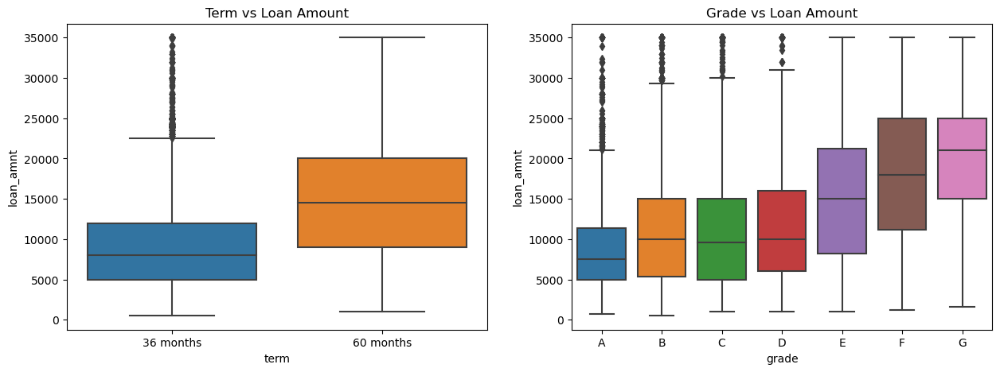

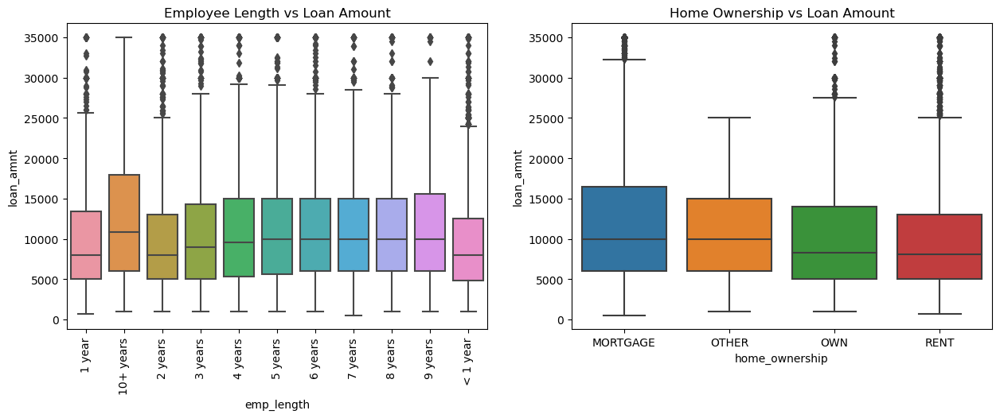

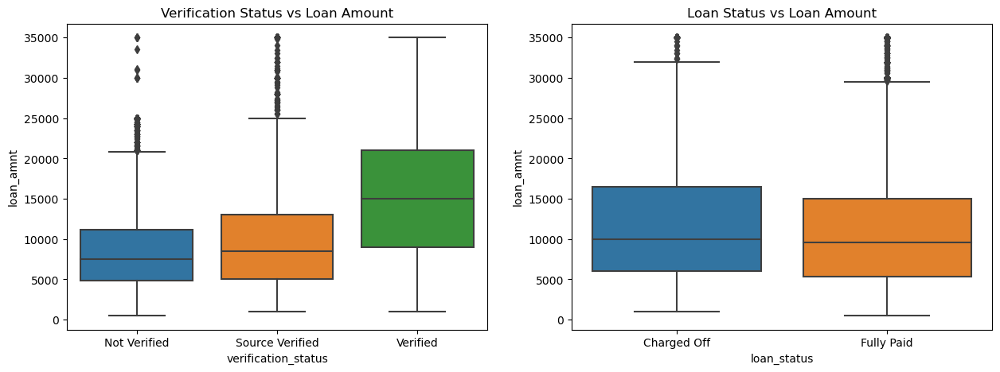

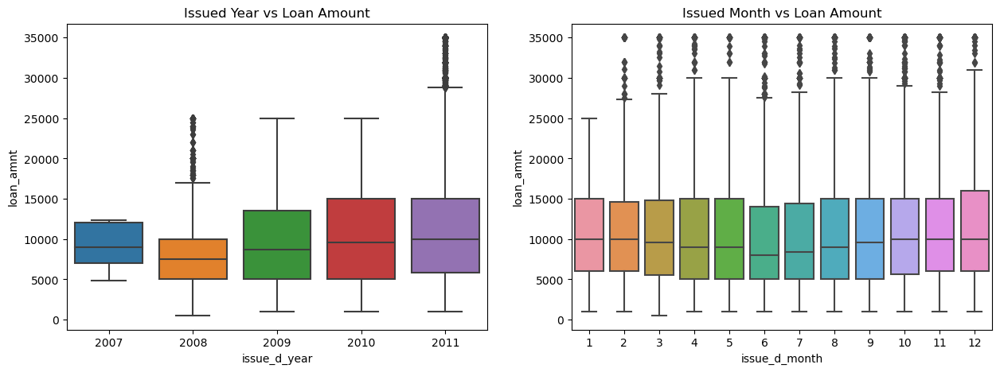

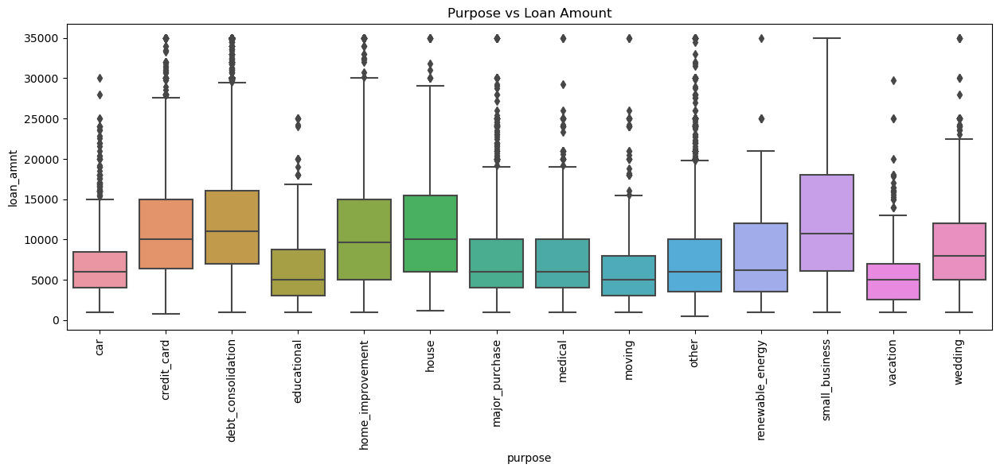

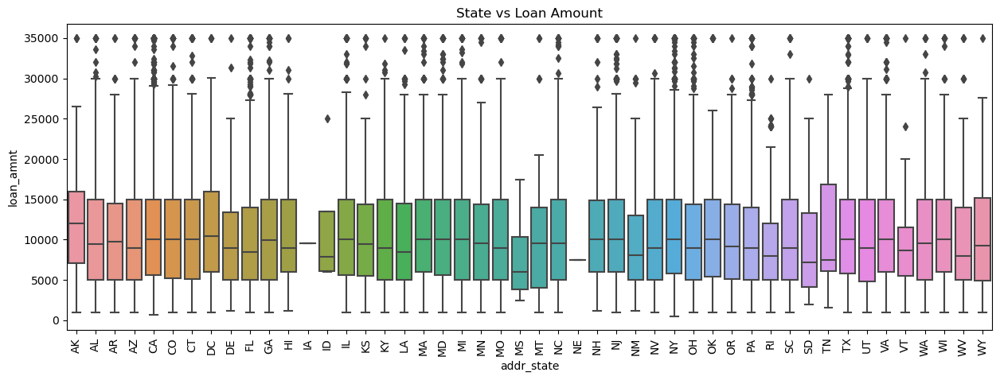

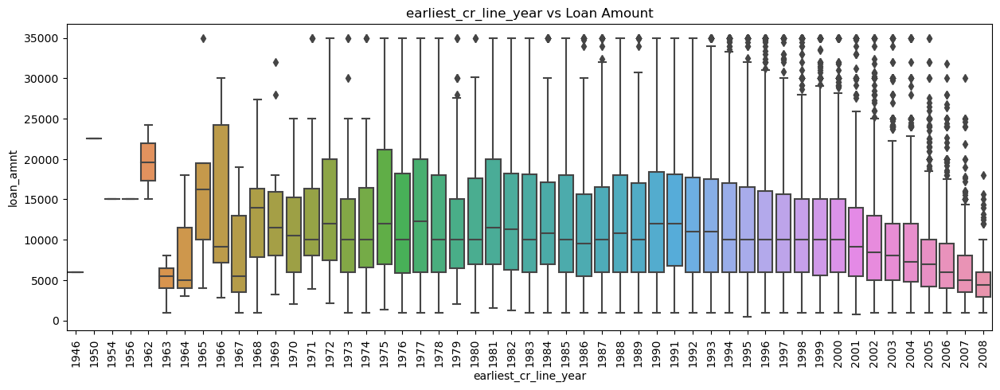

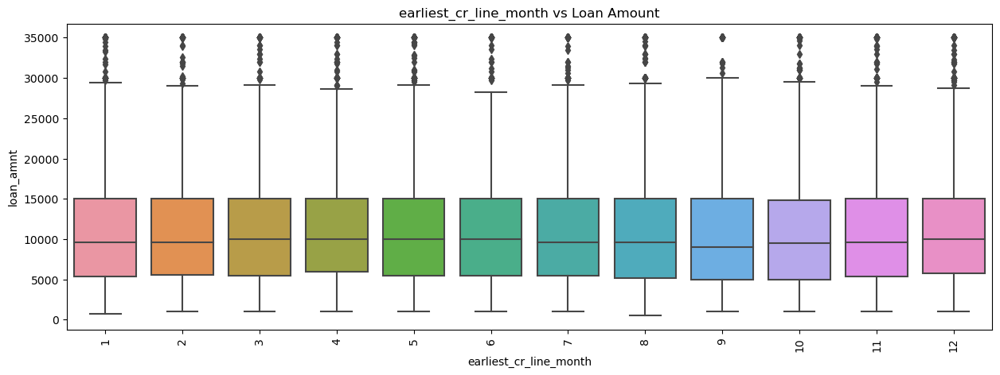

In [106]:
plt_seg_analysis(data=loan_data, col='loan_amnt', title='Loan Amount')

**Inference**

Below table provides segmented univariate analysis of **'loan_amnt'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Amount requested for long term is more than short term |
| Grade  | As the grade decreases, the requested amount increases. Borrowers in lower grades tend to request for bigger loans|
| Employee Length | In general, amount greater than 25000 tend to be outliers. Ignoring them, 10+ years tend to request more than other categories and <1 year tend to request less than the other categories.  |
| Home Ownership  | Borrowers in OTHER category request only for loans less thant 25000. Borrowers in RENT tend to ask loans more than 25000. The median remains to be in a small range around 7000-10000 for all categories. |
| Verification Status | Verified borrowers tend to request for bigger loans and also they have a wide spread from around 8000-20000. Not verified borrowers tend to request less than 13000 except few who have requested for more than 20000. |
| Loan Status  | The spread of amount is wide for defaulters ranging from around 6000-17000. Higher amount have more defaulters. |
| Issued Year  | The spread of requested amount increases every year |
| Issued Month | No significant obsevation |
| Purpose | Small business borrowers have requested for wide range of loan from 6000-18000. Borrowers for vacation and education have requested for amount less than 10000. |
| State   | Except IA and NE, other states seem to almost have similar spread. |
| earliest_cr_line_year  | The values seem to reduce from 1966 to 2008 |
| earliest_cr_line_month | No significant obsevation |

---

#### 2) Funded Amount

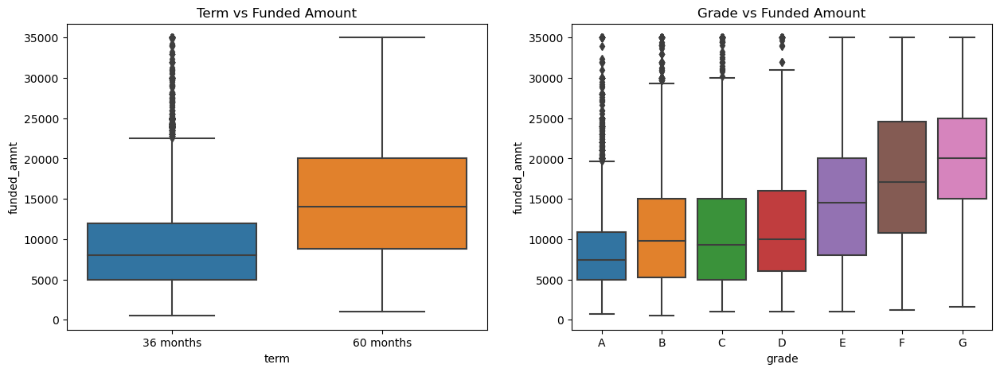

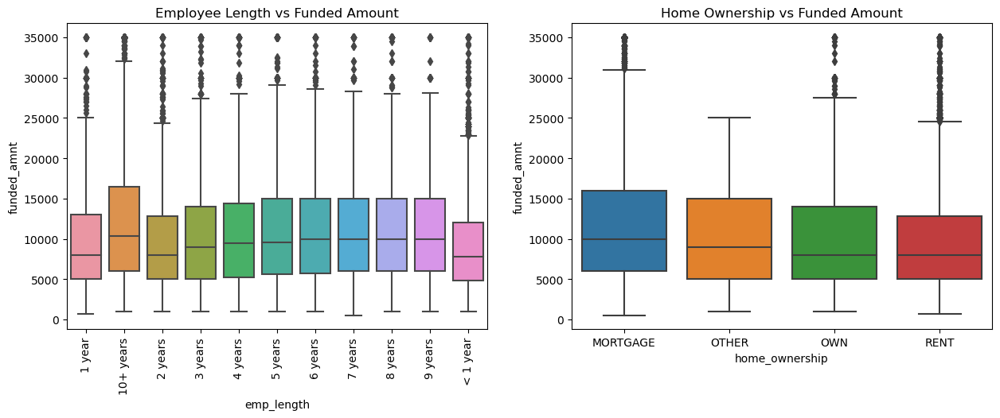

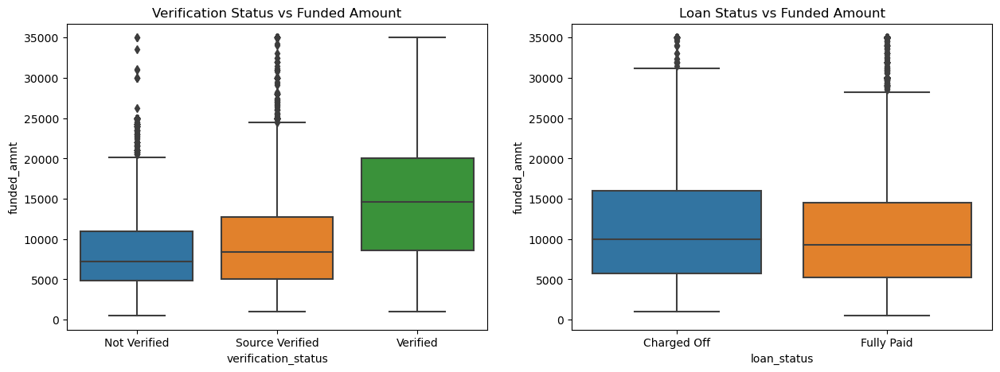

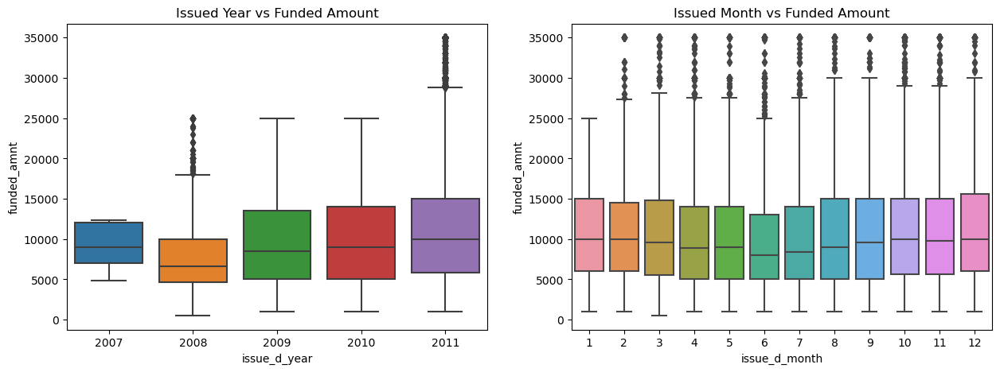

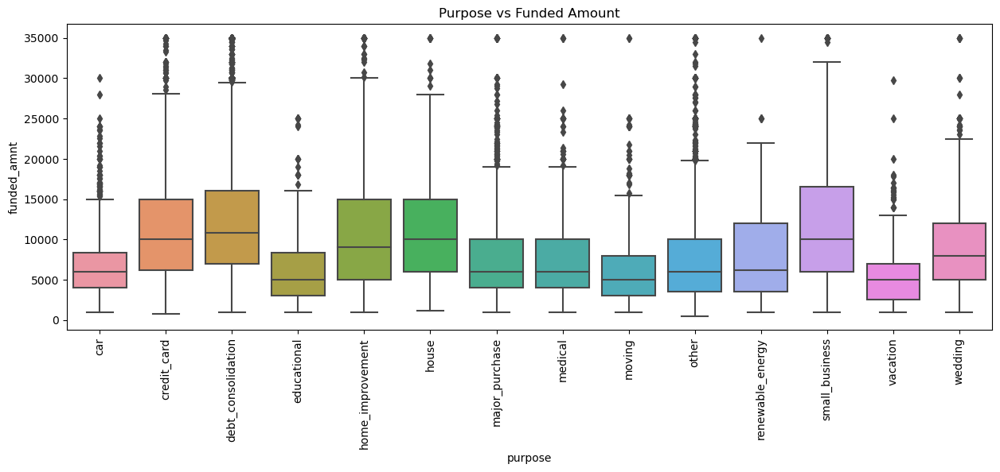

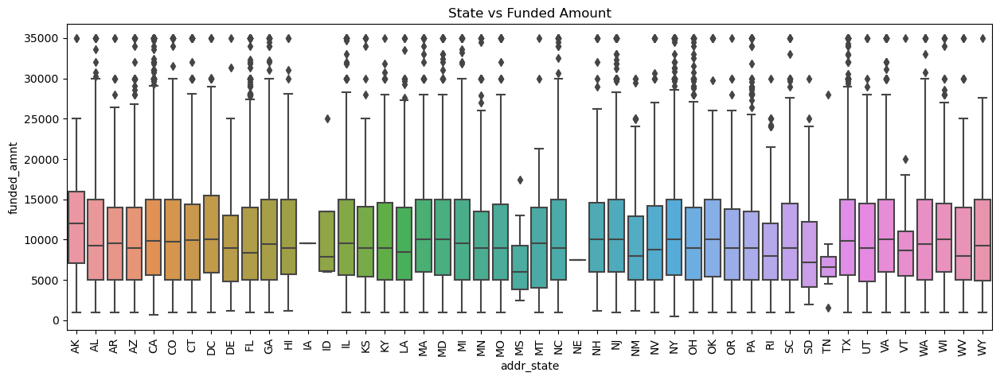

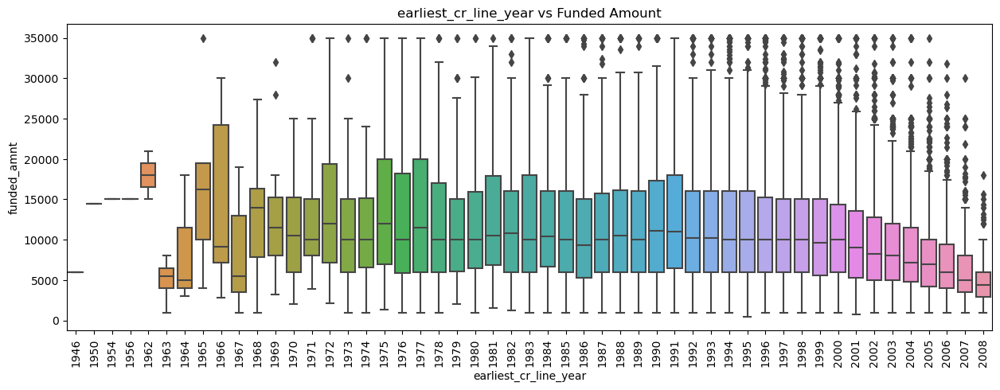

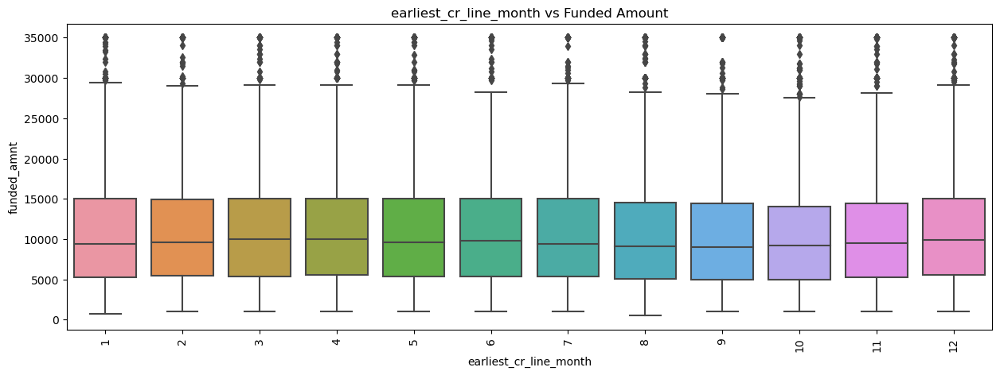

In [107]:
plt_seg_analysis(data=loan_data, col='funded_amnt', title='Funded Amount')

**Inference**

Below table provides segmented univariate analysis of **'funded_amnt'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Amount funded for long term is more than short term |
| Grade  | As the grade decreases, the funded amount increases. Borrowers in lower grades tend to be funded for bigger loans|
| Employee Length | In general, amount greater than 25000 tend to be outliers. Ignoring them, 10+ years tend to be funded more than other categories and <1 year tend to be funded less than the other categories.  |
| Home Ownership  | Borrowers in OTHER category have been funded for loans less thant 25000. Borrowers in RENT have been funded loans more than 25000. The median remains to be in a small range around 7000-10000 for all categories. |
| Verification Status | Verified borrowers have been funded for bigger loans and also they have a wide spread from around 8000-20000. Not verified borrowers tend to be funded for less than 13000 except few who have been funded for more than 20000. |
| Loan Status  | The spread of amount is wide for defaulters ranging from around 6000-17000. Higher amount have more defaulters. |
| Issued Year  | The spread of requested amount increases every year |
| Issued Month | No significant obsevation |
| Purpose | Small business borrowers have been funded for wide range of loan from 6000-18000. Borrowers for vacation and education have been funded for amount less than 10000. |
| State   | Except IA, NE and TN, other states seem to almost have similar spread. |
| earliest_cr_line_year  | The values seem to reduce from 1966 to 2008 |
| earliest_cr_line_month | No significant obsevation |

---

#### 3) Funded Amount by Investors

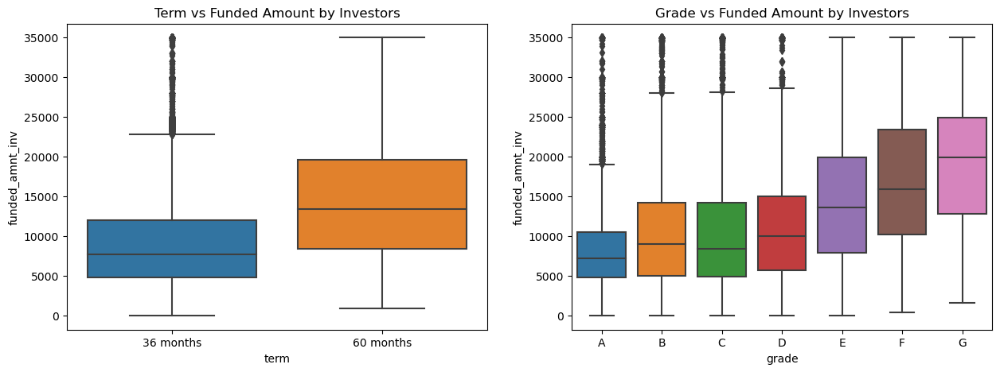

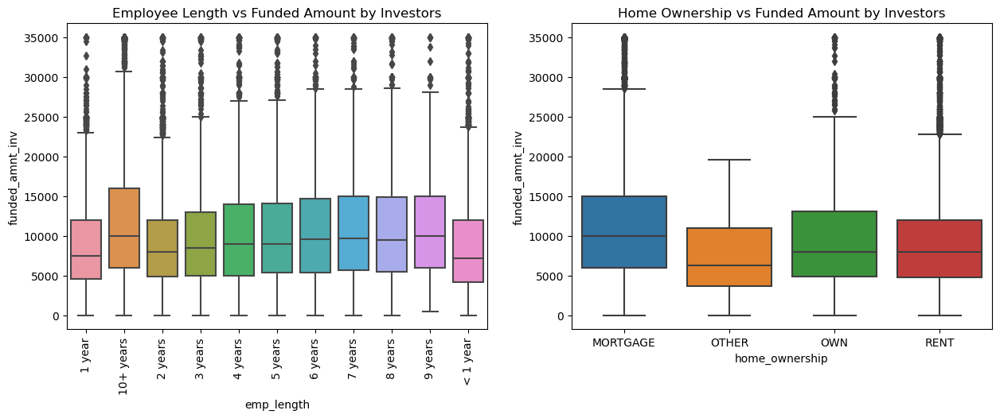

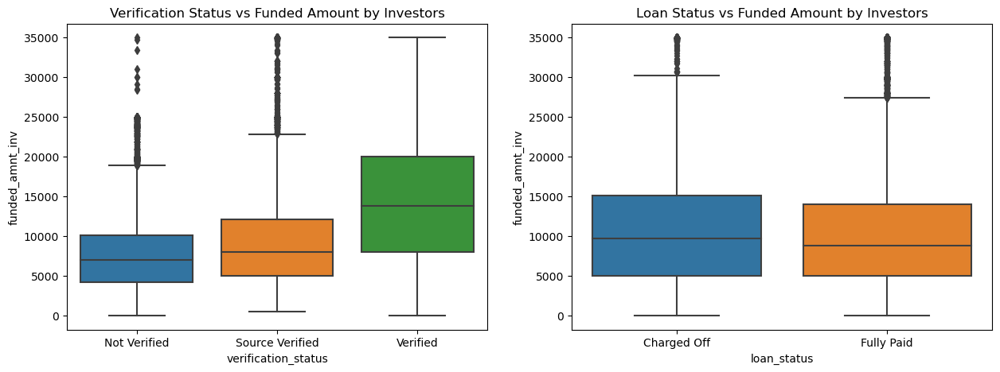

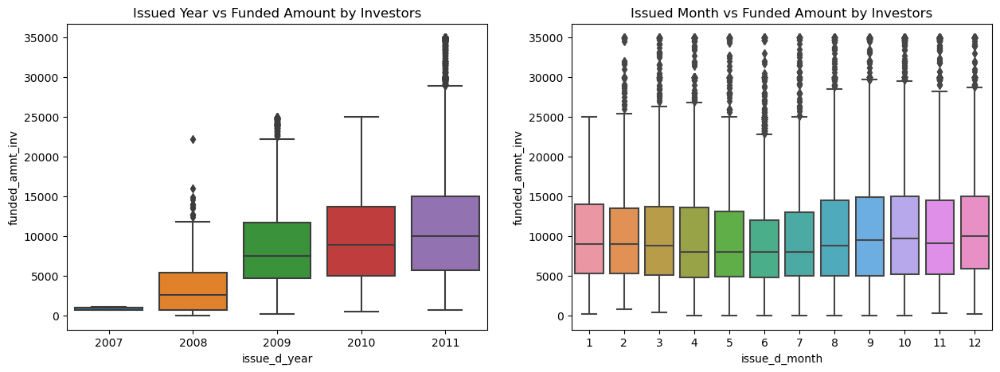

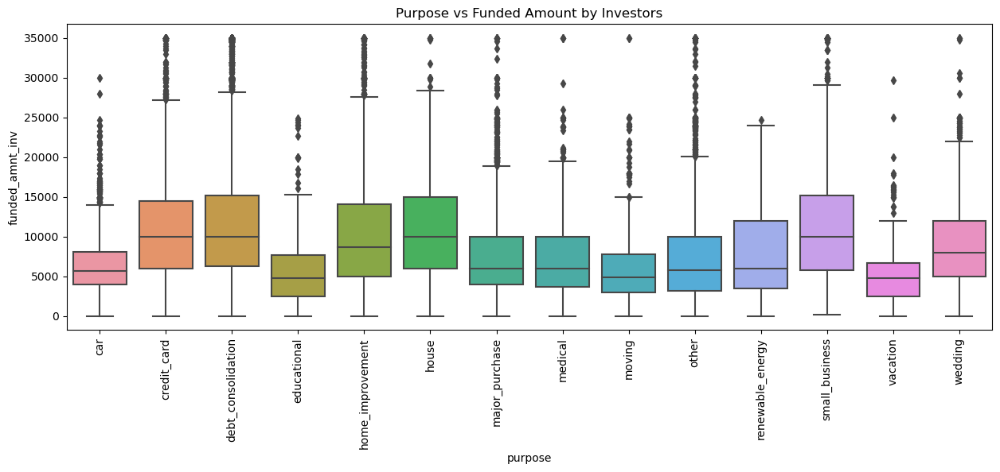

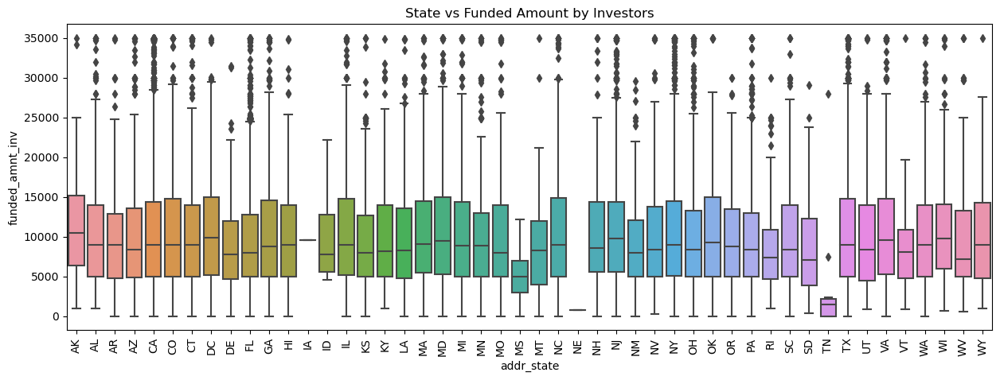

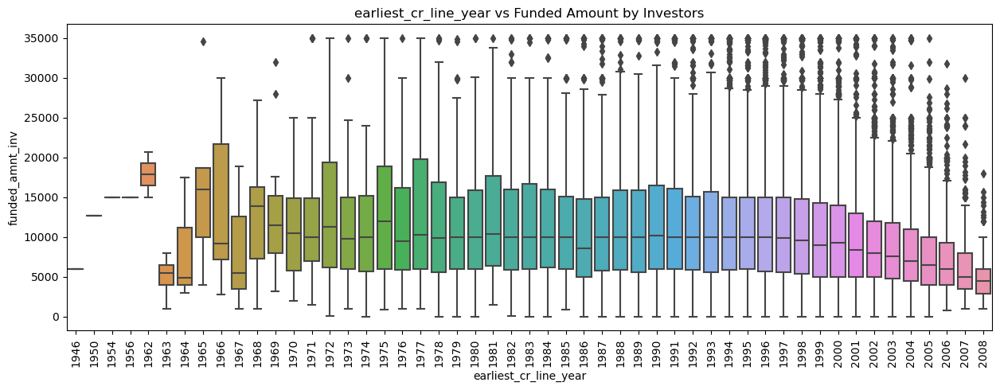

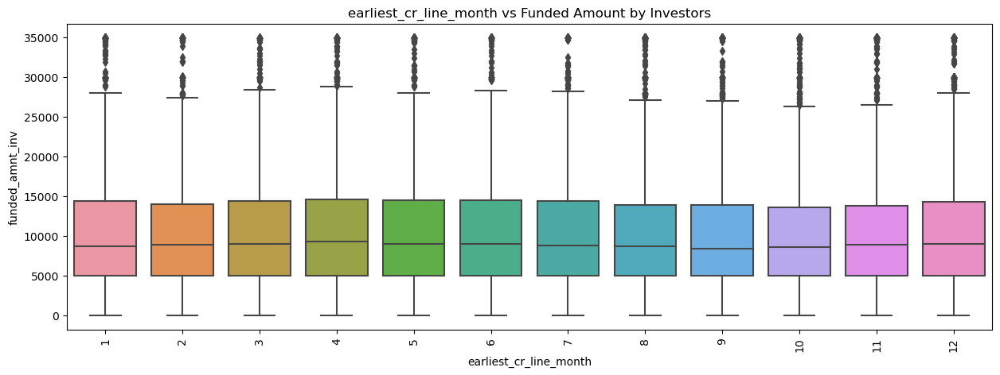

In [108]:
plt_seg_analysis(data=loan_data, col='funded_amnt_inv', title='Funded Amount by Investors')

**Inference**

Below table provides segmented univariate analysis of **'funded_amnt_inv'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Amount funded by investors for long term is more than short term |
| Grade  | As the grade decreases, the funded amount by investors increases. Borrowers in lower grades tend to be funded for bigger loans|
| Employee Length | In general, amount greater than 25000 tend to be outliers. Ignoring them, 10+ years tend to be funded by investors more than other categories and <1 year tend to be funded by investors less than the other categories.  |
| Home Ownership  | Borrowers in OTHER category have been funded by investors for loans less thant 25000. Borrowers in RENT have been funded by investors loans more than 25000. The median remains to be in a small range around 7000-10000 for all categories. |
| Verification Status | Verified borrowers have been funded by investors for bigger loans and also they have a wide spread from around 8000-20000. Not verified borrowers tend to be funded by investors for less than 13000 except few who have been funded for more than 20000. |
| Loan Status  | The spread of amount is wide for defaulters ranging from around 6000-15000. Higher amount have more defaulters. |
| Issued Year  | The spread of requested amount increases every year. The amount funded by investors seem to be very less for 2007|
| Issued Month | No significant obsevation |
| Purpose | Small business borrowers have been funded for wide range of loan from 6000-15000. Borrowers for vacation have been funded for lesser amount than others except few. |
| State   | Except IA, NE and TN, other states seem to almost have similar spread. |
| earliest_cr_line_year  | The values seem to reduce from 1966 to 2008 |
| earliest_cr_line_month | No significant obsevation |

---

#### 4) Approved Loan Amount

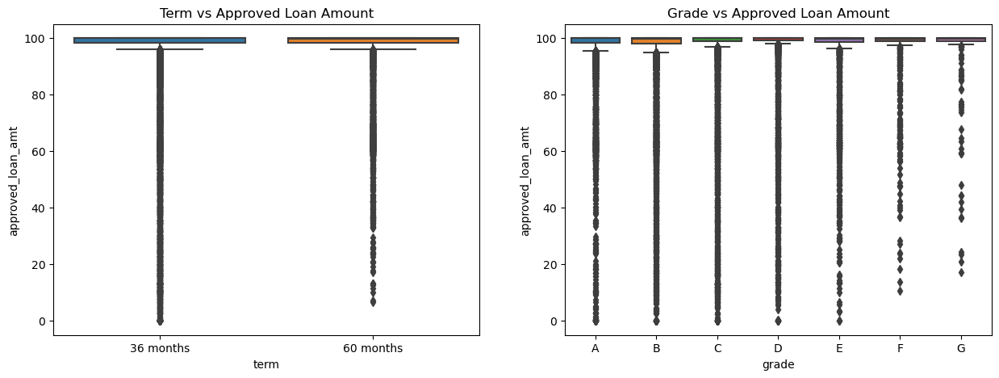

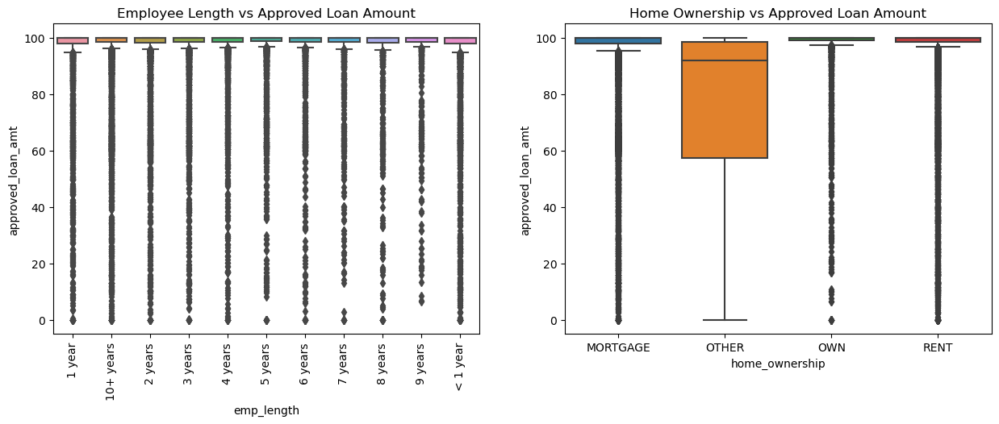

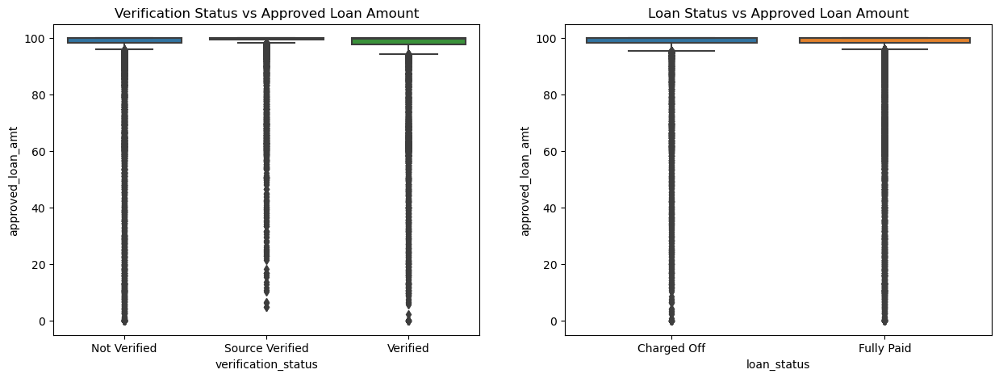

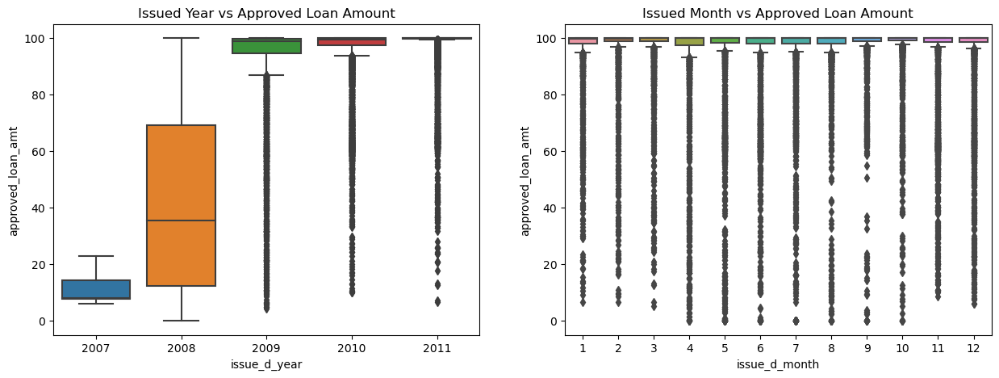

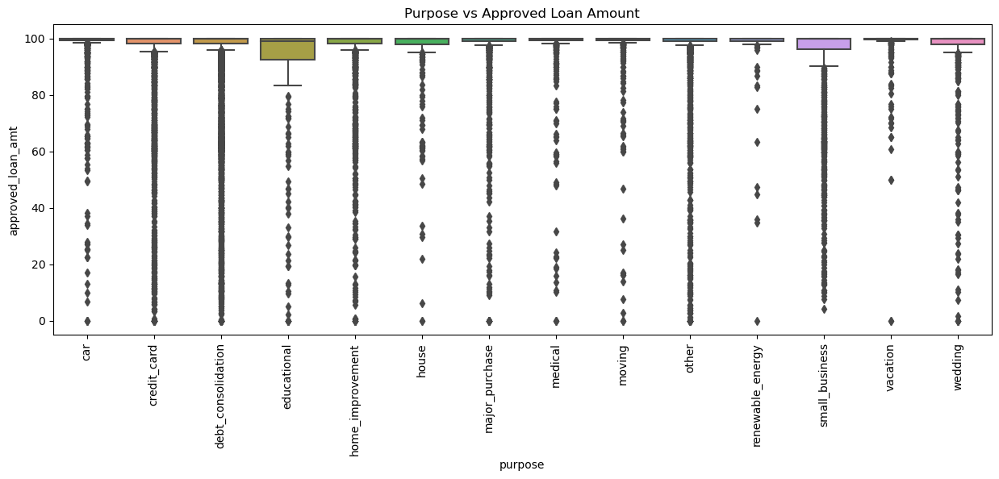

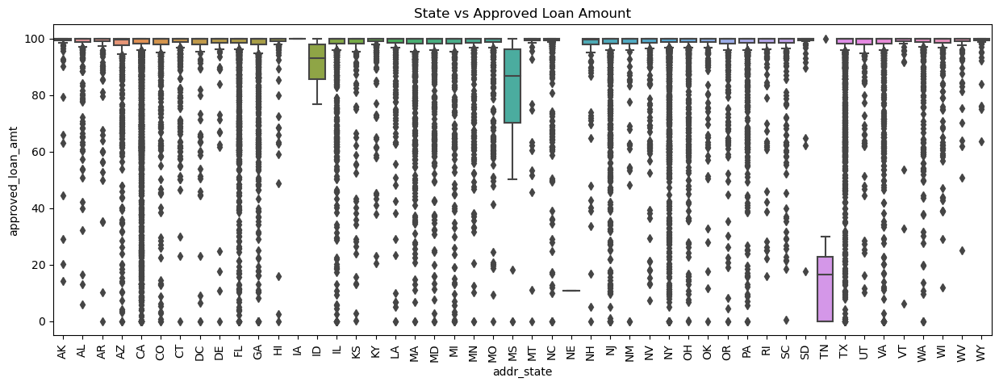

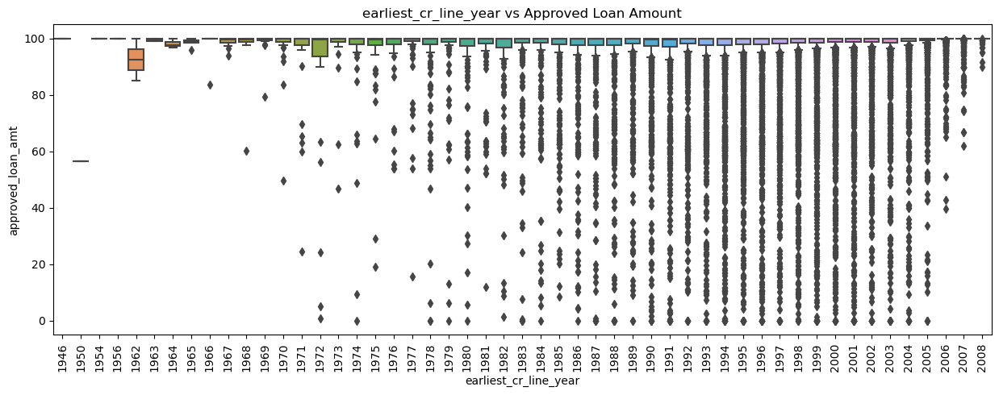

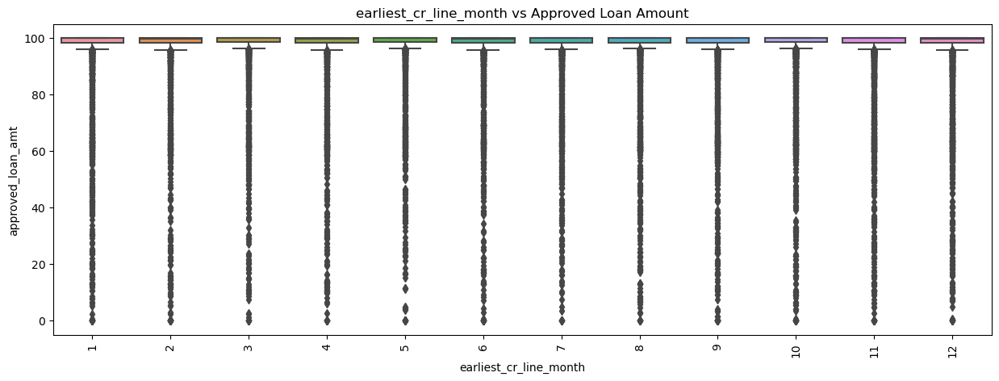

In [109]:
plt_seg_analysis(data=loan_data, col='approved_loan_amt', title='Approved Loan Amount')

**Inference**

We can saw from before that loan_amnt, funded_amnt and funded_amnt_inv all seem to have a very similar behaviour. This gives us insight that most of the borrowers have been funded the amount they have requested. This statement could be proved from this column which contains the percentage of approval.


Below table provides segmented univariate analysis of **'approved_loan_amt'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Majority of them have been approved |
| Grade  | Majority of them have been approved |
| Employee Length | Majority of them have been approved |
| Home Ownership  | Borrowers in OTHER category have a spread from 55-100 meaning lesser approval rate. Hence they would have got amount less than they requested. In remaining categories, majority of them have been approved |
| Verification Status | Majority of them have been approved |
| Loan Status  | No significant observation |
| Issued Year  | 2007 have lesser approval rate, 2008 have a wide spread of approval rate from 10-70, rest have majority of them approved. |
| Issued Month | No significant observation |
| Purpose | Except for education and small busines, majority of them have been approved|
| State   | Except from IA, ID, MS, NE and TN, majority of them have been approved |
| earliest_cr_line_year  | No significant observation |
| earliest_cr_line_month | No significant observation |

---

#### 5) Interest Rate

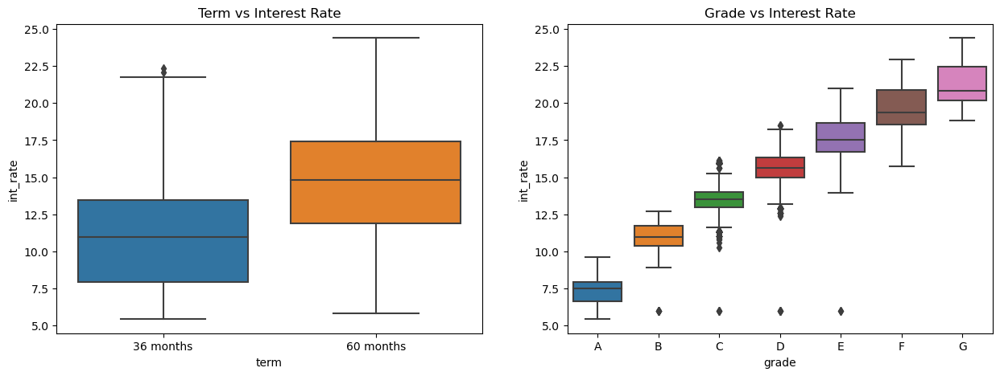

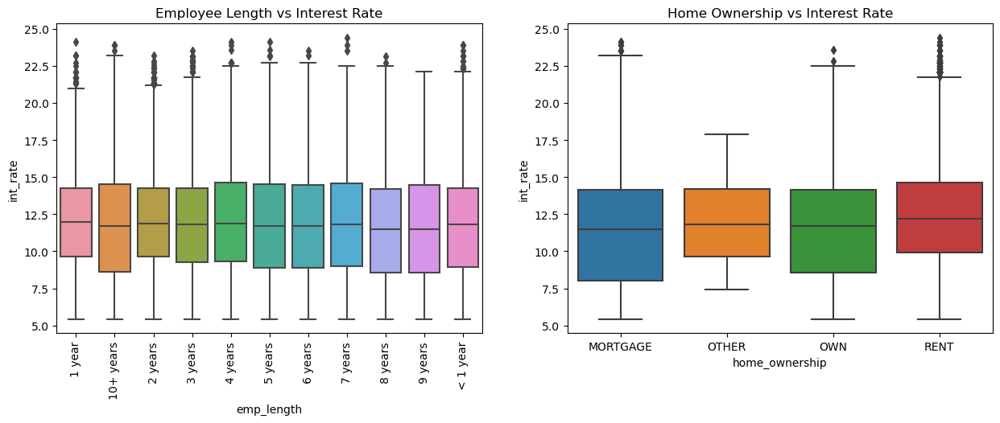

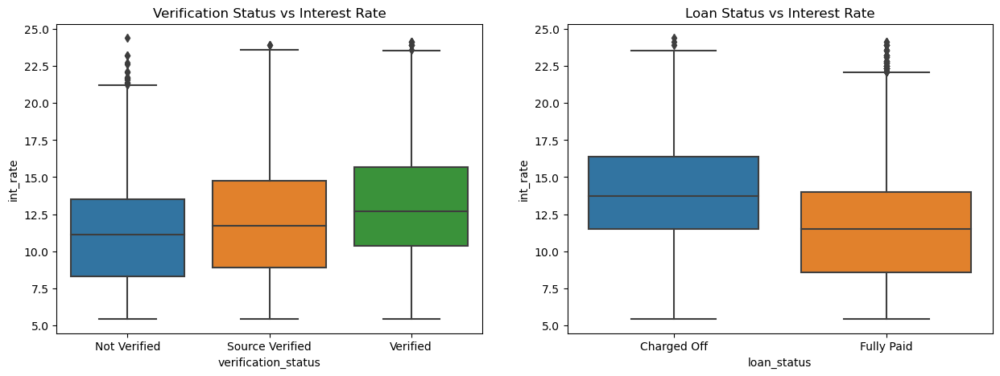

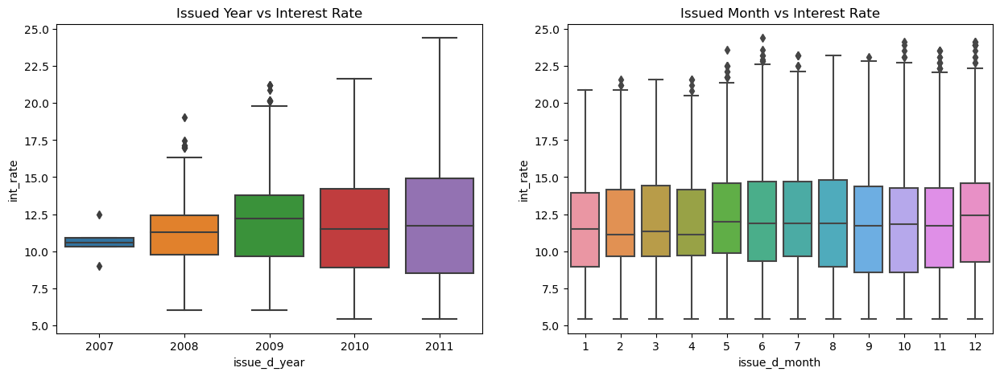

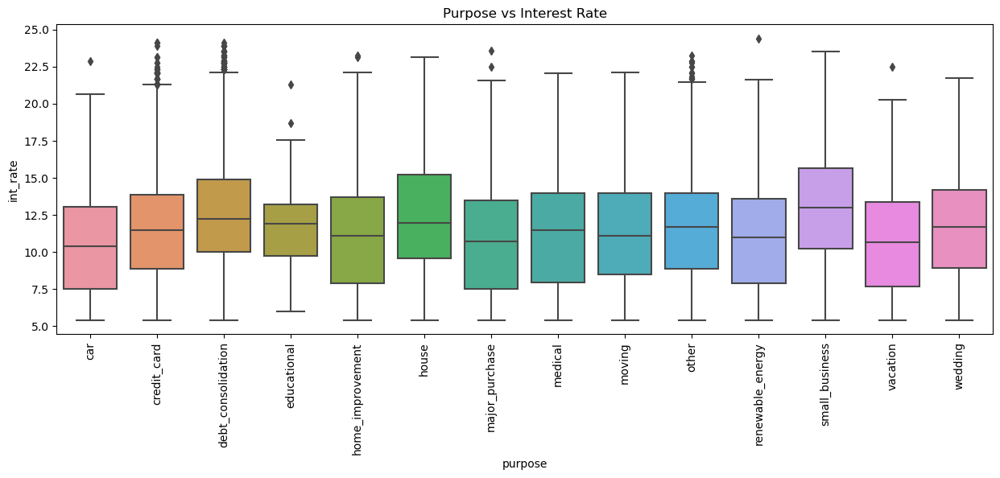

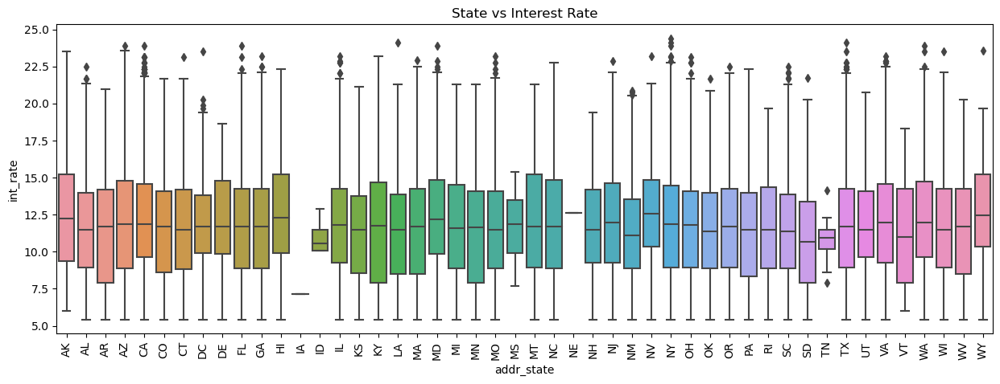

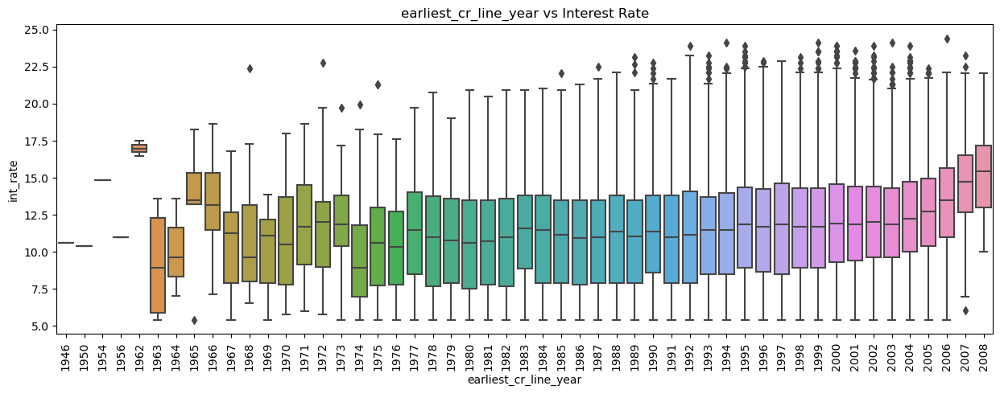

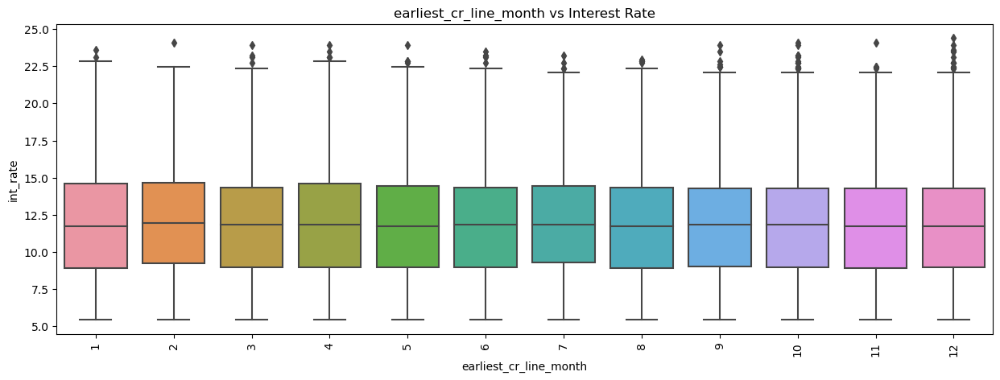

In [110]:
plt_seg_analysis(data=loan_data, col='int_rate', title='Interest Rate')

**Inference**

Below table provides segmented univariate analysis of **'int_rate'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Long term have higher interest rates |
| Grade  | It is very clear as the grade decreases, the interest rates increases significantly. We see few lower interest (around 6%) in B,C,D,E might be few exceptions|
| Employee Length | No significant observation |
| Home Ownership  | The median almost remains same around 11%. Interest rate starts from 7.5% for OTHER categories. Borrowers in MORTGAGE and OWN have lesser interest rate, this could be because of the security.|
| Verification Status | The verified borrowers tend to have higher interest rates. |
| Loan Status  | Higher interest rates have more defaulters|
| Issued Year  | The spread of interest rate increase every year though maintaining the median in the same range from 10-12.5 |
| Issued Month | No significant observation |
| Purpose | Small business, debt consolidation and house borrowers tend to get higher interest rates. |
| State   | Except from IA, ID, NE and TN, spread is very similar with lowest from AR state. |
| earliest_cr_line_year  | Have a similar spread from 1974-2000 and then have a slight increase|
| earliest_cr_line_month | No significant observation |

---

#### 6) Installment

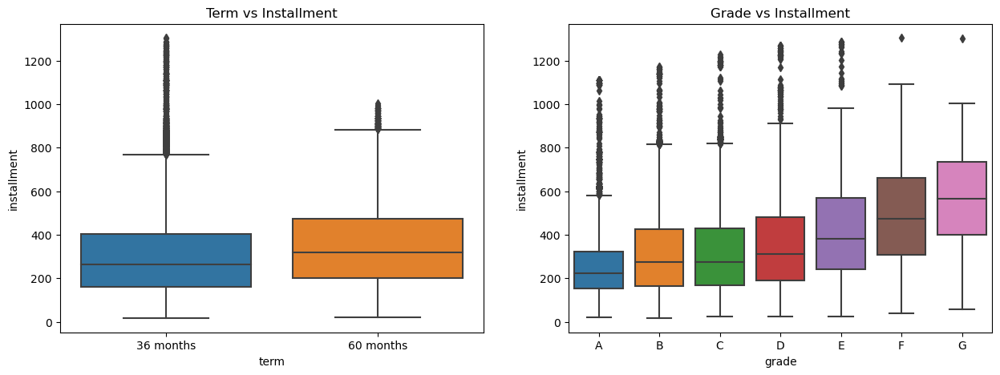

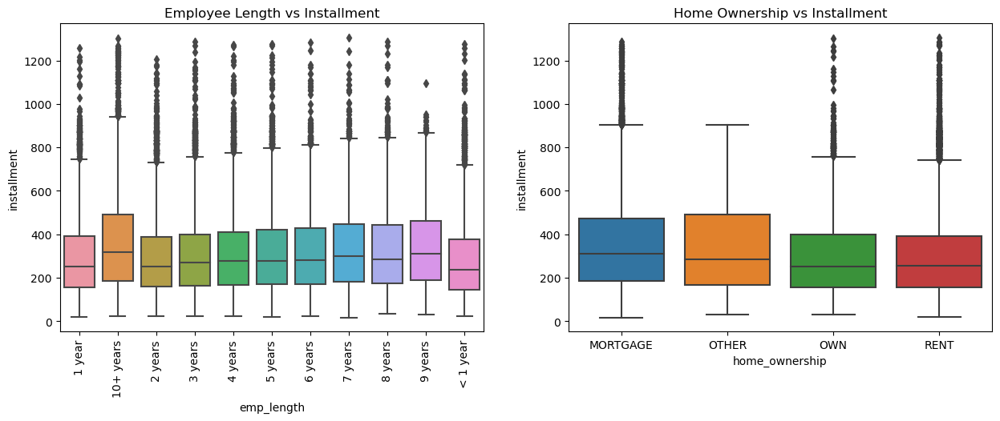

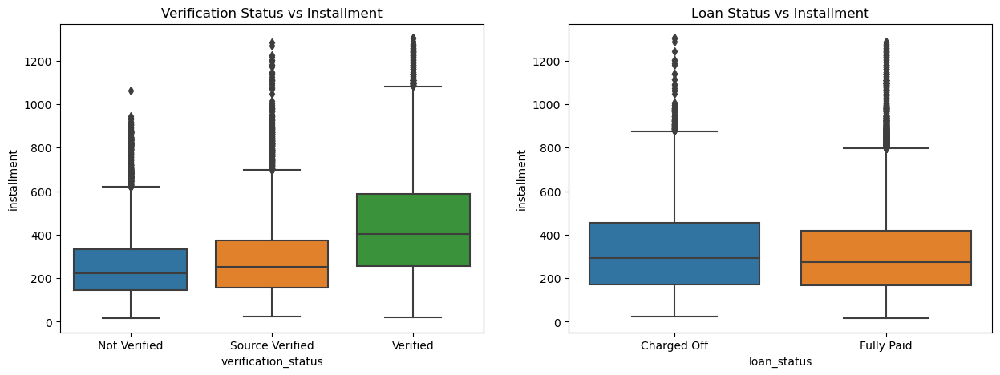

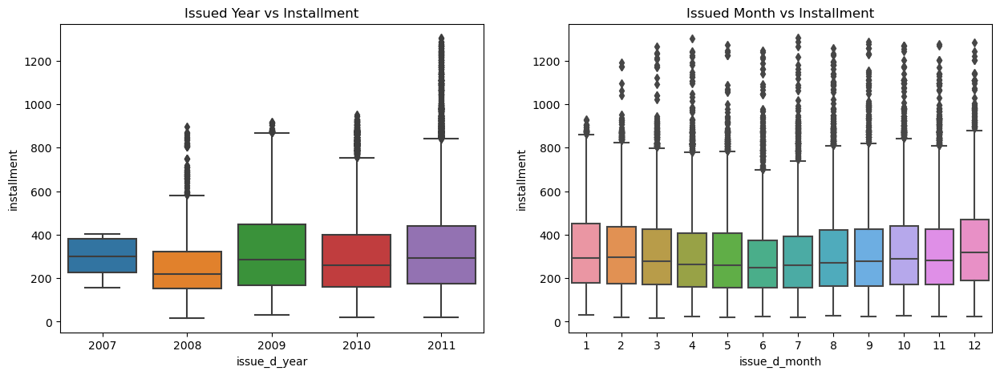

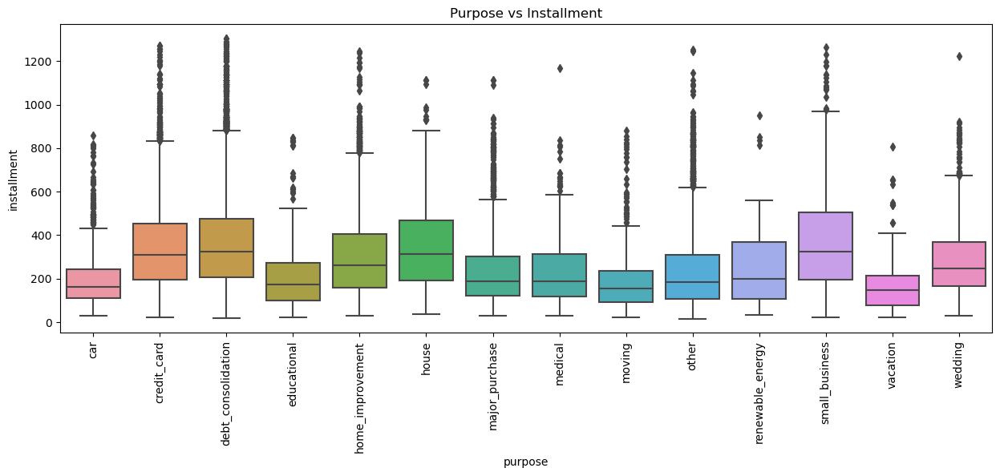

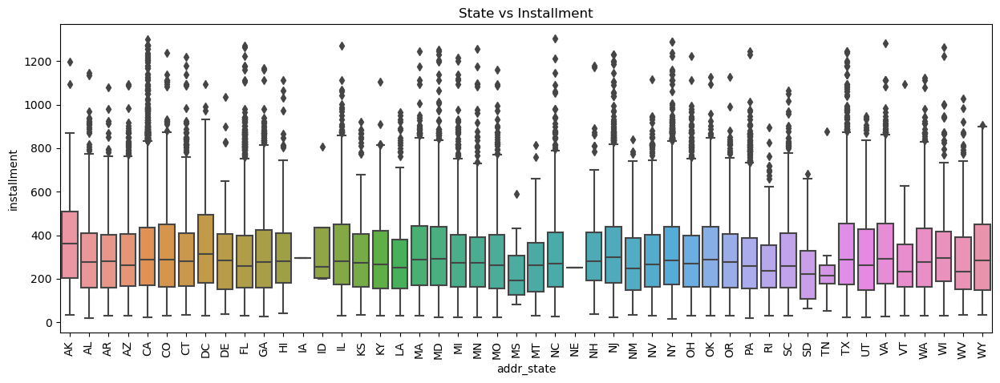

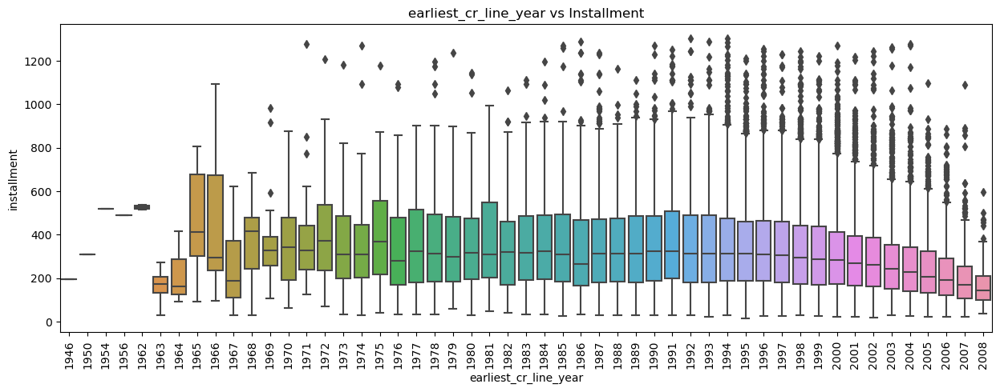

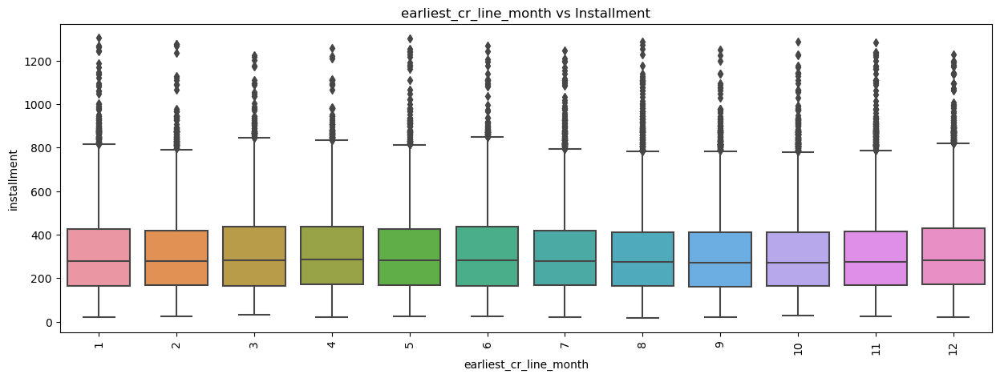

In [111]:
plt_seg_analysis(data=loan_data, col='installment', title='Installment')

**Inference**

Below table provides segmented univariate analysis of **'installment'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Short term have the highest installment of around 1200+ |
| Grade  | As the grade decreases, the installment increases. This implies that people with more installment tend to belong to lower grades. |
| Employee Length | 10+ years have higher installment might be due to their commitments and people with around 1 year have less installments might be they have just started earning.  |
| Home Ownership  | OTHER category have a wider spread from 200-500 and have the max of around 900. |
| Verification Status | Verified borrowers have higher installments. |
| Loan Status  | Defaulters have wide spread of installments. |
| Issued Year  | 2009 and 2011 have a higer spread. |
| Issued Month | No significant observation. |
| Purpose | Small business, debt consolidation and house borrowers have higher installments. |
| State   | Except IA, NE and TN, others have similar spread with AK having majority of the borrowers around 500. |
| earliest_cr_line_year  | Have a similar spread from 1975-2000 and then have a decrease. |
| earliest_cr_line_month | No significant observation. |

---

#### 7) Annual Income

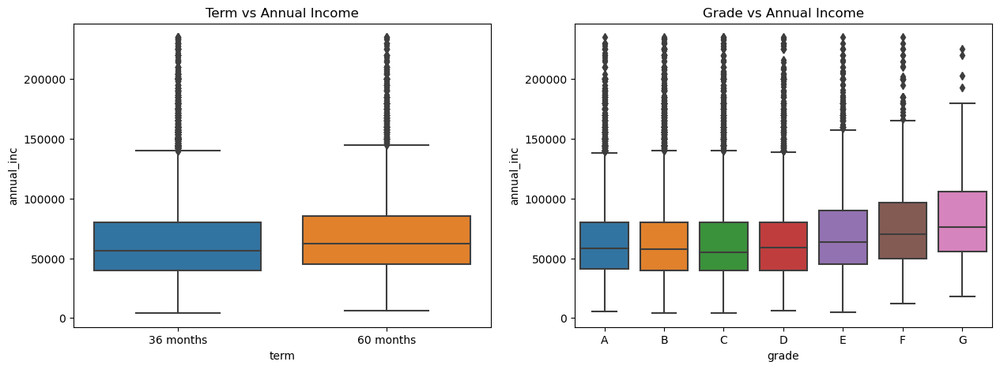

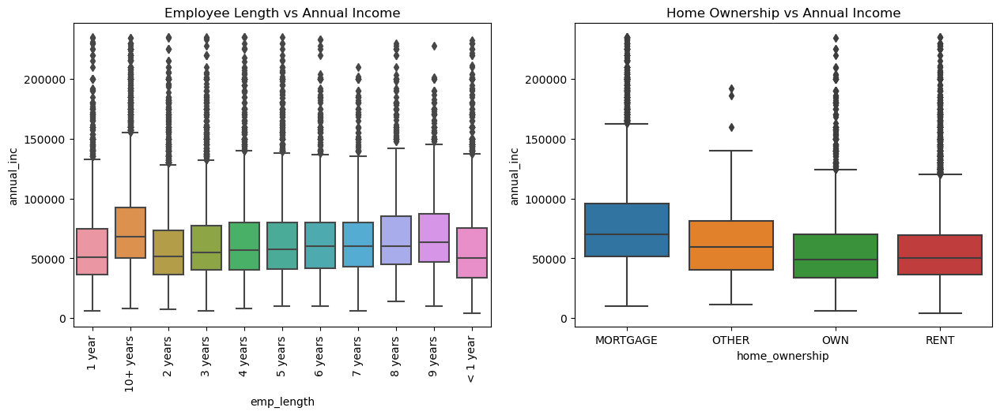

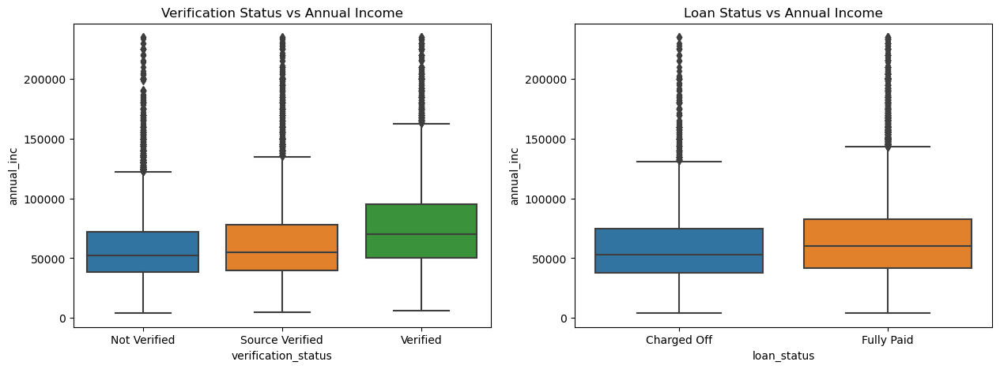

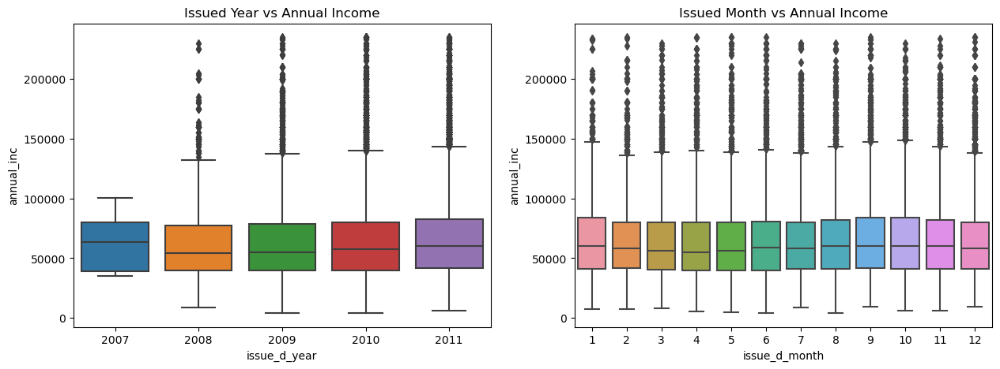

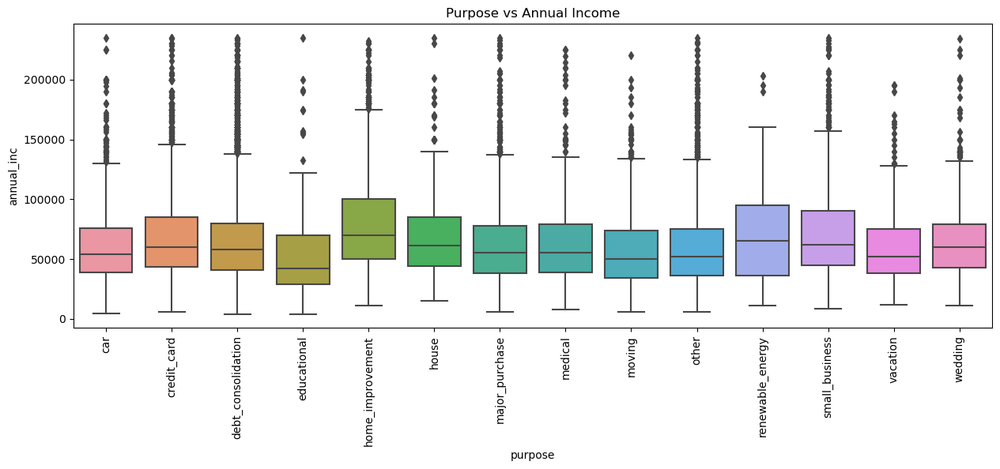

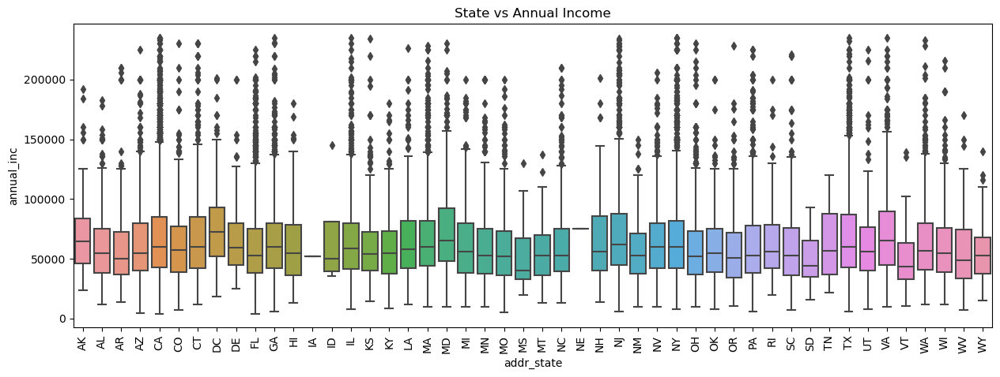

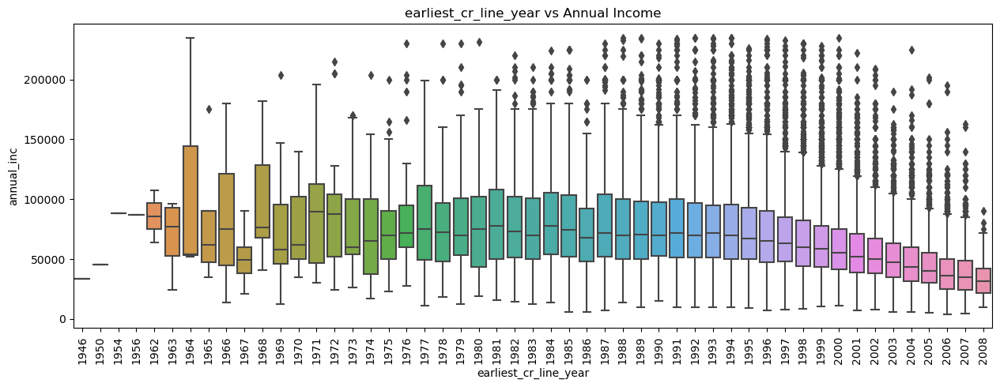

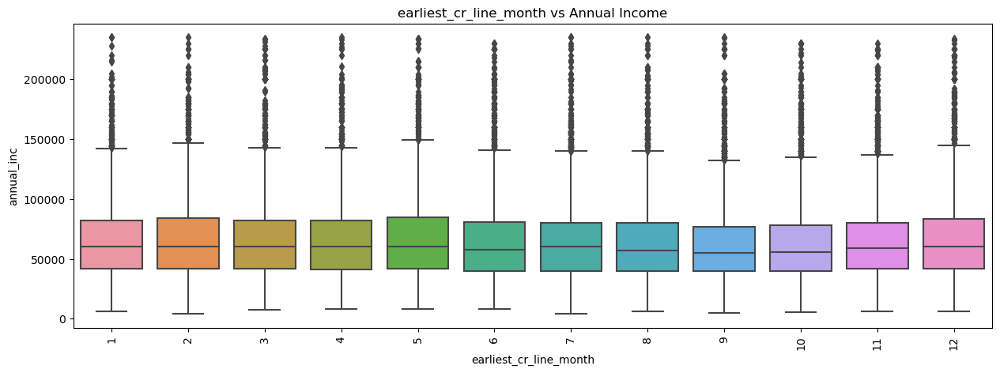

In [112]:
plt_seg_analysis(data=loan_data, col='annual_inc', title='Annual Income')

**Inference**

Below table provides segmented univariate analysis of **'annual_inc'** column:

| Column | Inference |
|:-------|:----------|
| Term   | High salaried people take long term, it might be because they are taking bigger loan amounts. |
| Grade  | People from lower grade tend to earn more. |
| Employee Length | As the experience increases, salary also increases. This is in line with the regular industry standard. |
| Home Ownership  | High salaried people tend to take MORTGAGE |
| Verification Status | Verified borrowers belong to high salary. |
| Loan Status  | Defaulters earn low salary and thay might be reason why they could not pay their loans. |
| Issued Year  | No significant observation. |
| Issued Month | No significant observation. |
| Purpose | High salary people tend to take loans for home improvement, small business and renewable energy. |
| State   | Except IA and NE, spread is similar |
| earliest_cr_line_year  | The values seem to reduce from 1970 to 2008 |
| earliest_cr_line_month | No significant observation. |

---

#### 8) Debt To Income Ratio

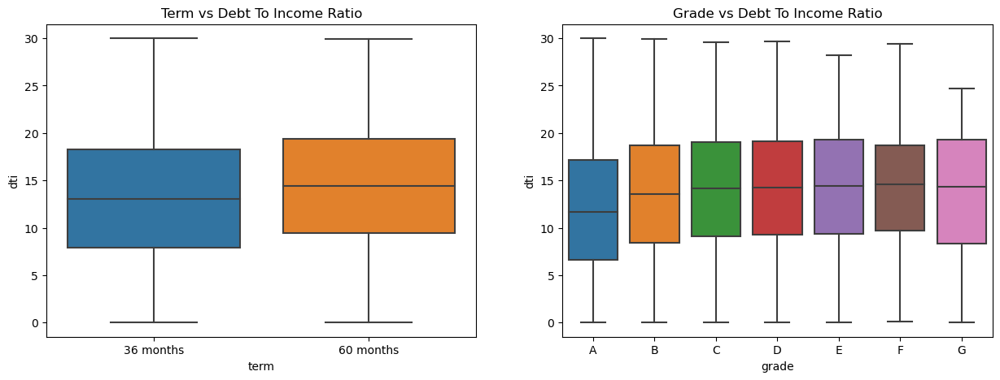

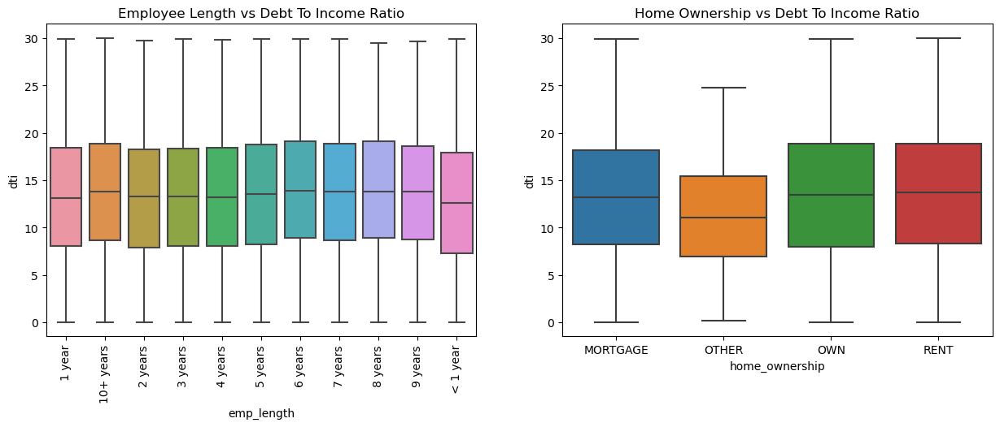

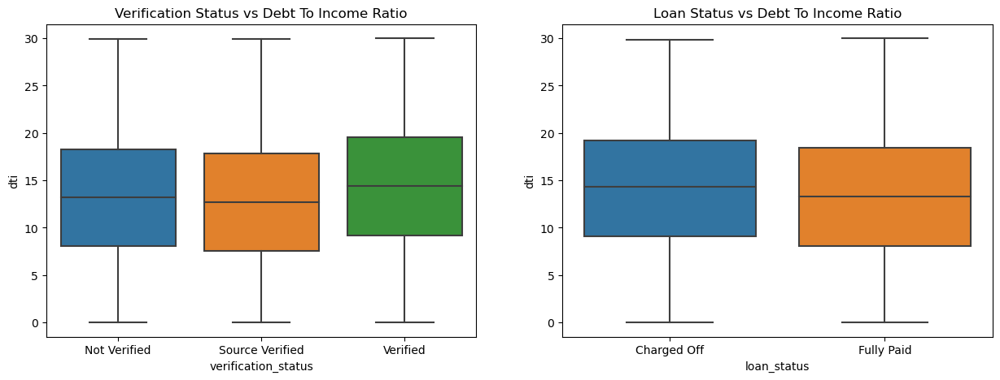

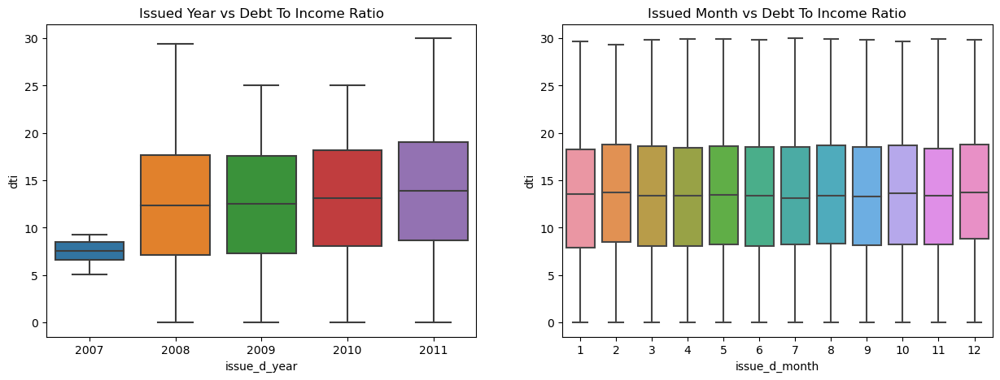

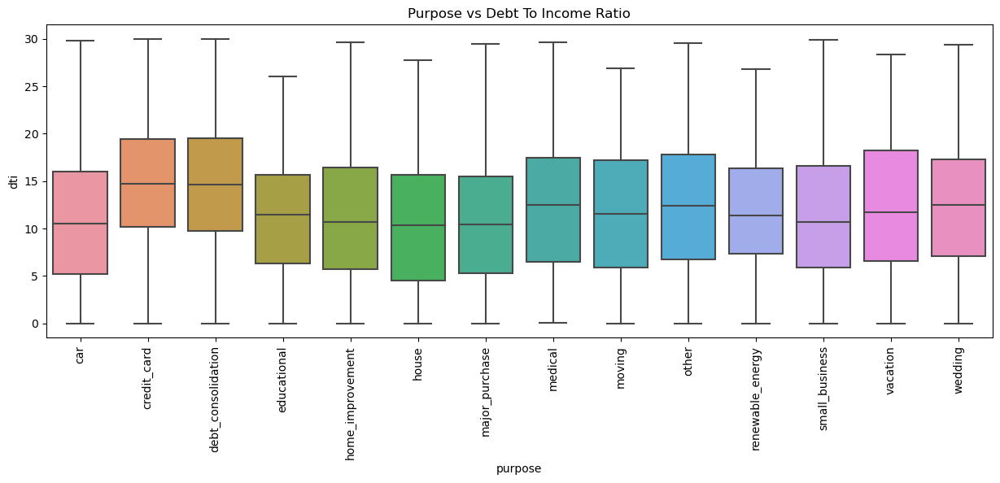

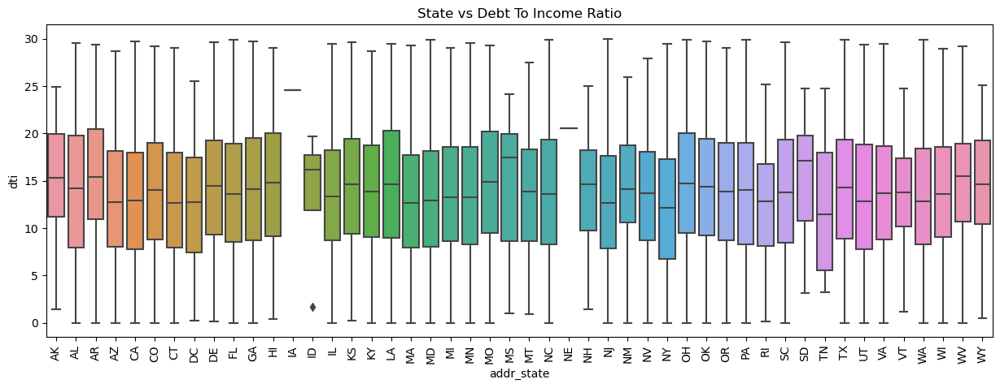

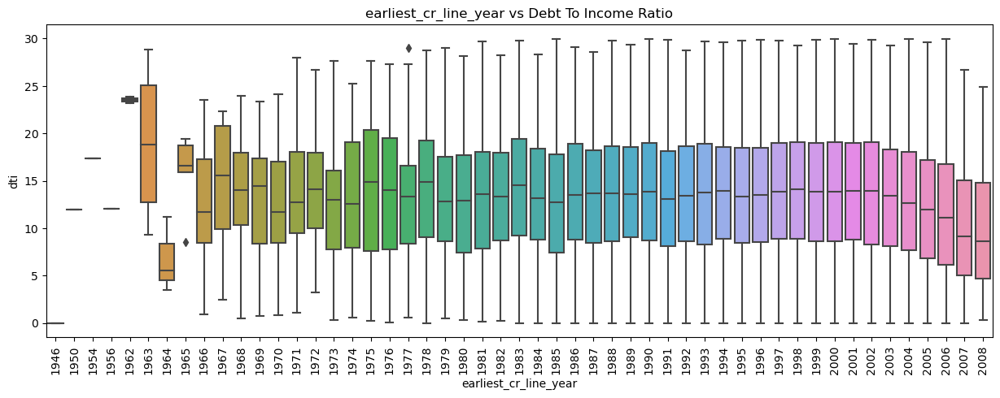

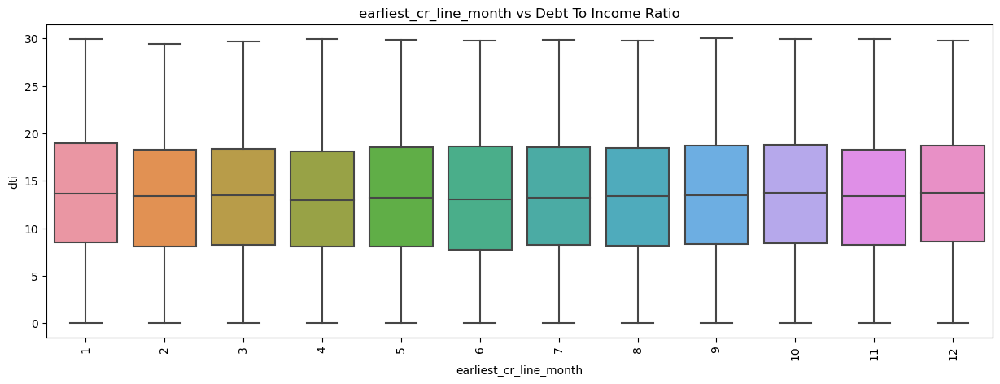

In [113]:
plt_seg_analysis(data=loan_data, col='dti', title='Debt To Income Ratio')

**Inference**

Below table provides segmented univariate analysis of **'dti'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Higher for long term. |
| Grade  | A have majority of them less than 17.5 and G have majority of them less than 20. B-F have a similar spread.|
| Employee Length | No significant observation. |
| Home Ownership  | OTHER category have lesser dti compared to others. |
| Verification Status | Spread is almost similar with Verified borrowers having around majority of them less than 20 .|
| Loan Status  | As the dti is more, the borrowers find it difficult to pay the loan and become defaulters.|
| Issued Year  | 2007 have narrow spread and other years have similar spread.|
| Issued Month | No significant observation. |
| Purpose | credit_card, debt_consolidation and vacation have higher dti. |
| State   | IA and NE have very narrow spread. |
| earliest_cr_line_year  | Spread reamins similar from 1974 till 2000 and the spread shifting towards lesser values till 2008. |
| earliest_cr_line_month | No significant observation. |

---

#### 9) Delinquency since 2 years

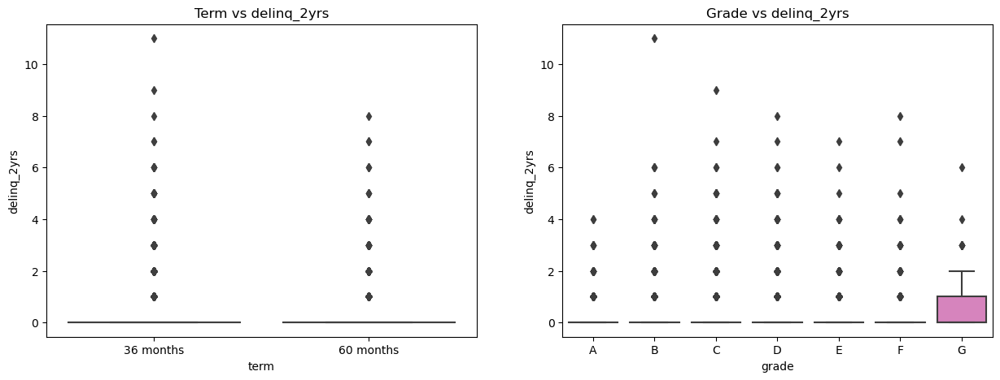

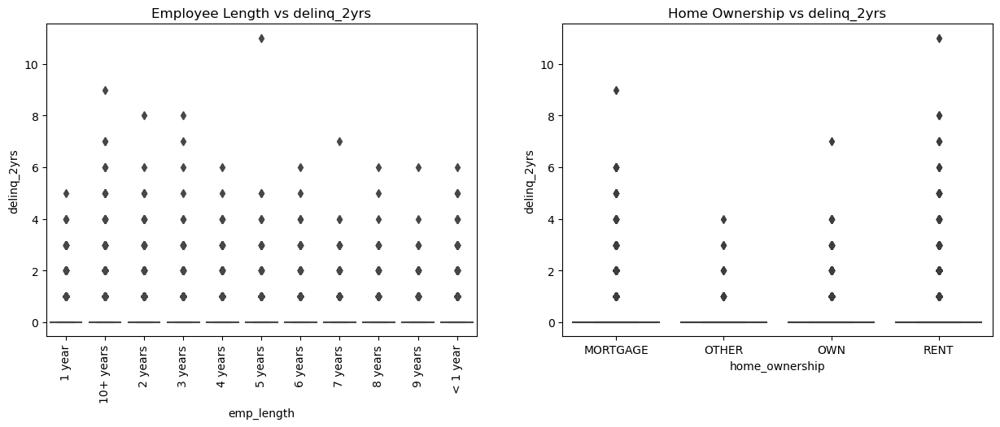

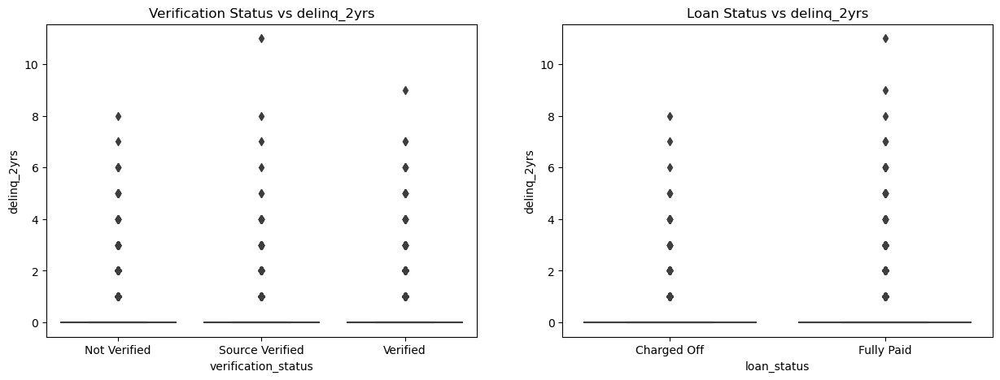

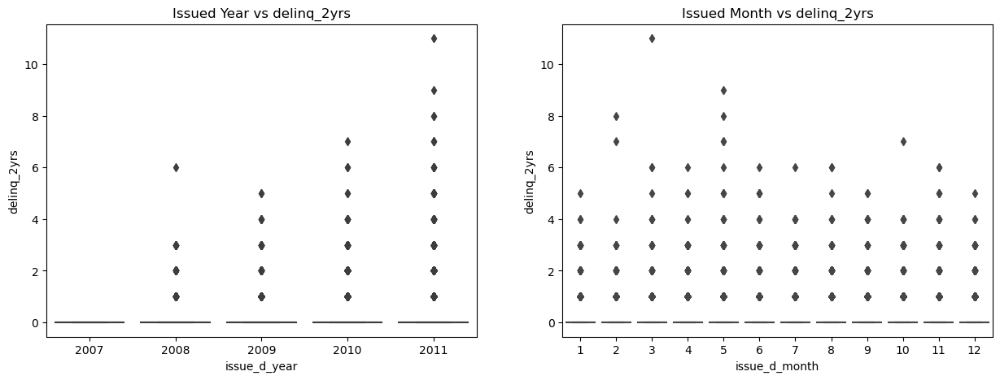

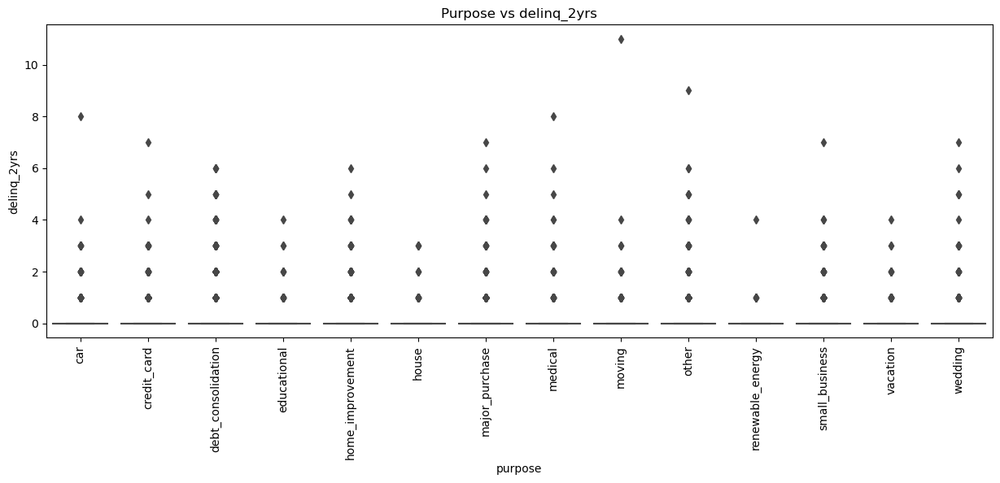

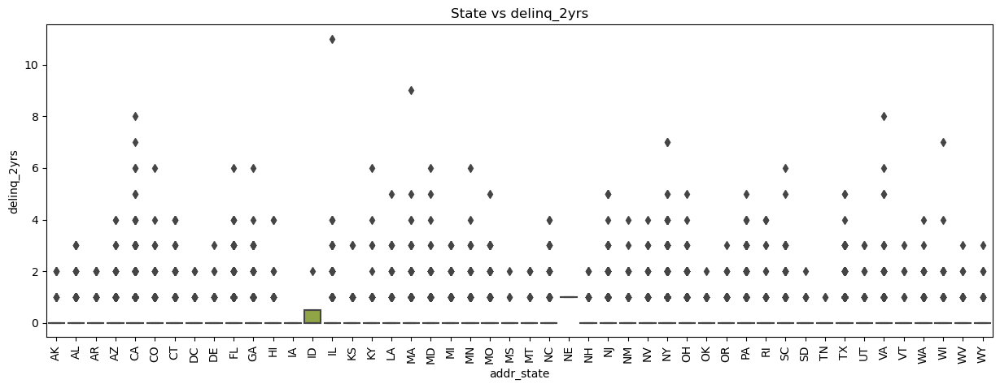

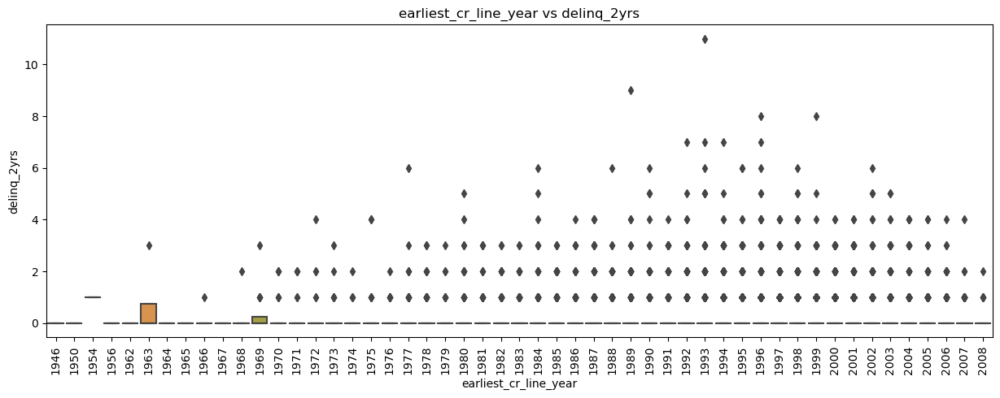

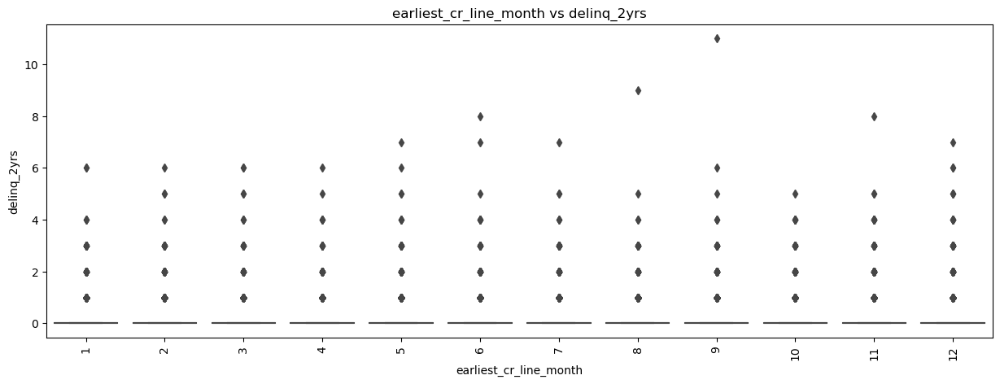

In [114]:
plt_seg_analysis(data=loan_data, col='delinq_2yrs', title='delinq_2yrs')

Here, we see the spread is very sparse and the values are from *0 to 11*. Hence, we could not deduce any information from these plots. So, we can deduce another way to plot this information. But we limit ourself to replot for now against **'loan_status'** as it is our area interest.

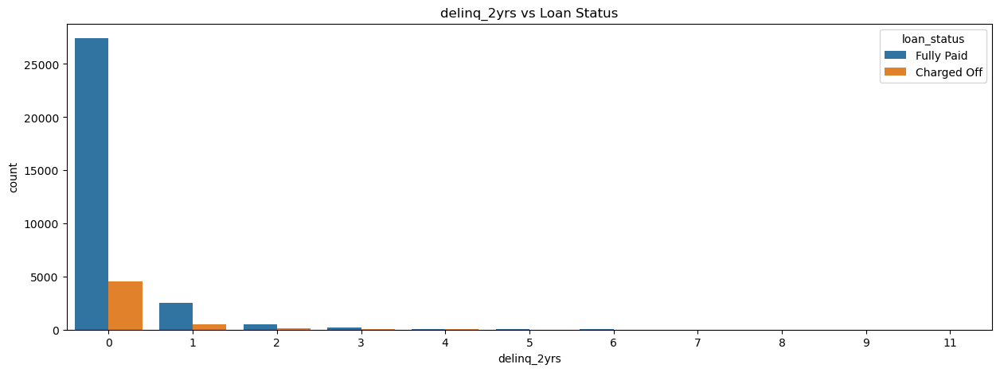

In [115]:
# Set the figure size
plt.figure(figsize=(15,5))
# Calling count plot
sns.countplot(x='delinq_2yrs', hue='loan_status', data=loan_data)
# Set the title
plt.title('delinq_2yrs vs Loan Status')
plt.show()

**Inference**

Below table provides segmented univariate analysis of **'delinq_2yrs'** column:

| Column | Inference |
|:-------|:----------|
| Term   | No significant observation. |
| Grade  | No significant observation. |
| Employee Length | No significant observation. |
| Home Ownership  | No significant observation. |
| Verification Status | No significant observation. |
| Loan Status  | We could see most of them have 0 value. No significant observation. |
| Issued Year  | No significant observation. |
| Issued Month | No significant observation. |
| Purpose | No significant observation. |
| State   | No significant observation. |
| earliest_cr_line_year  | No significant observation. |
| earliest_cr_line_month | No significant observation. |

---

#### 10) Inquiries in past 6 months

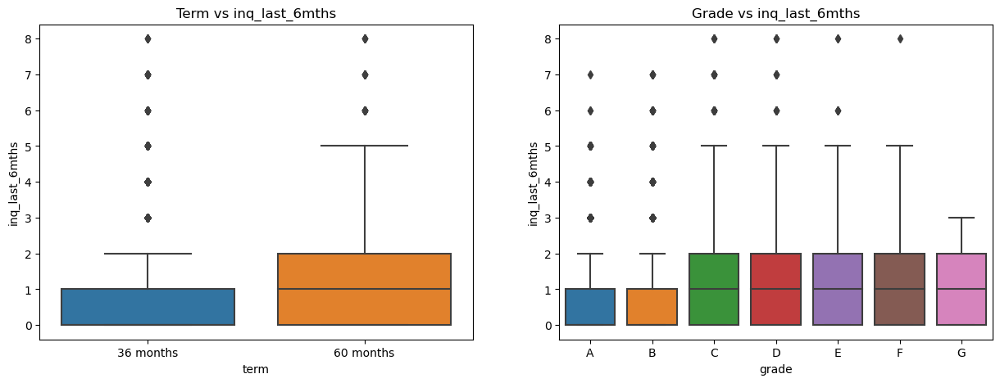

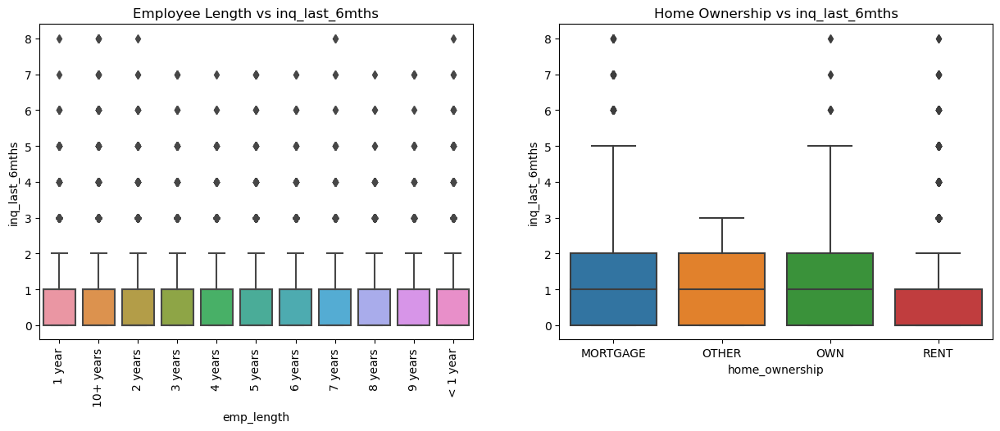

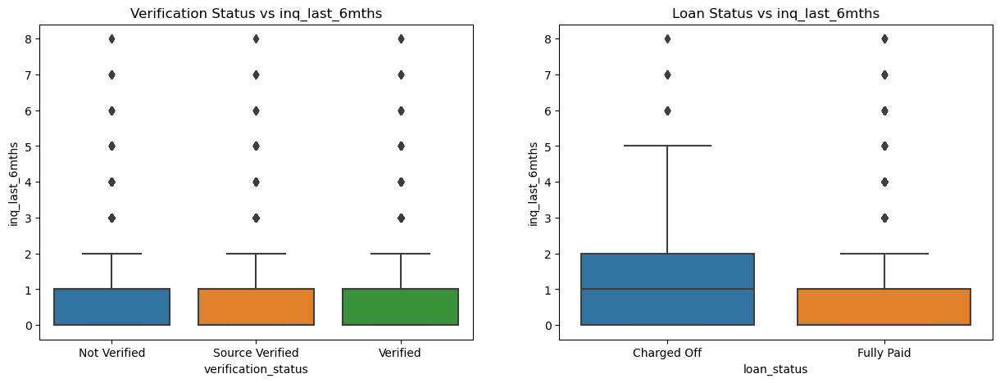

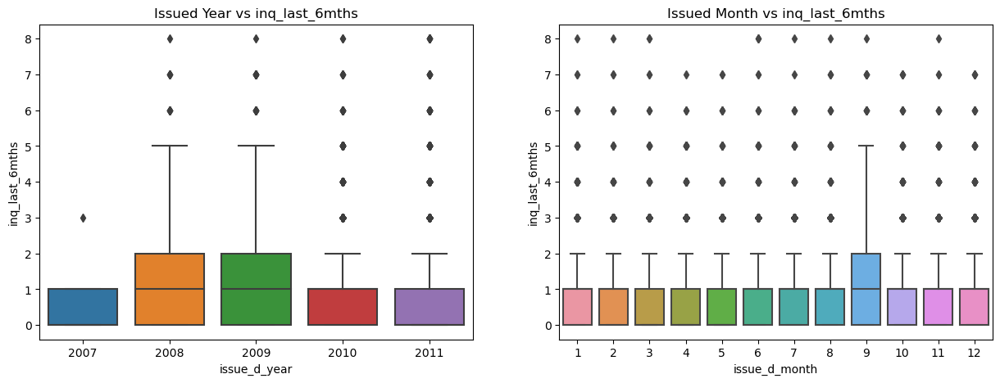

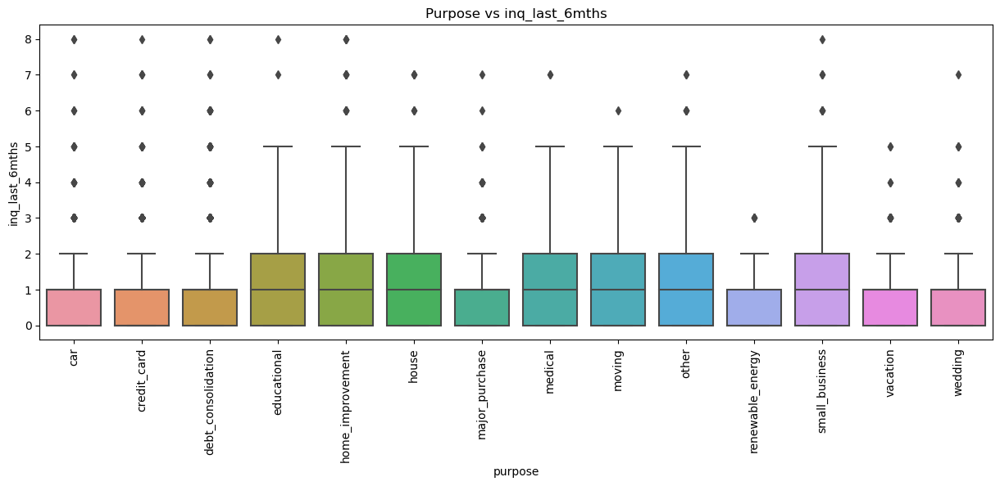

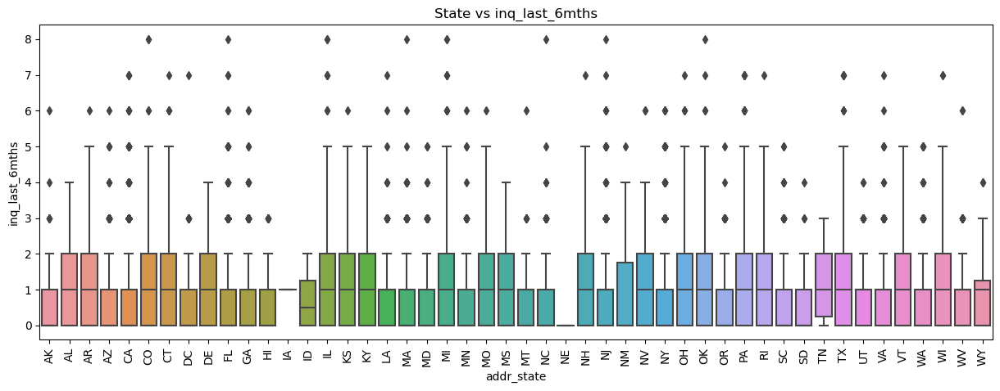

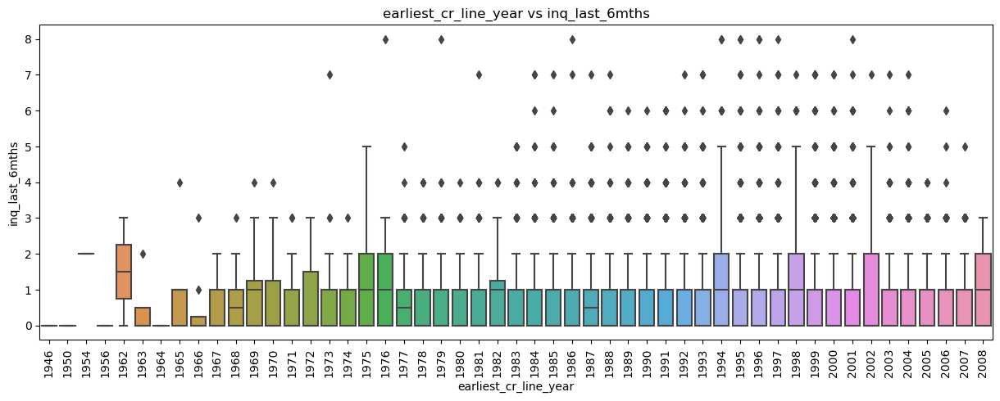

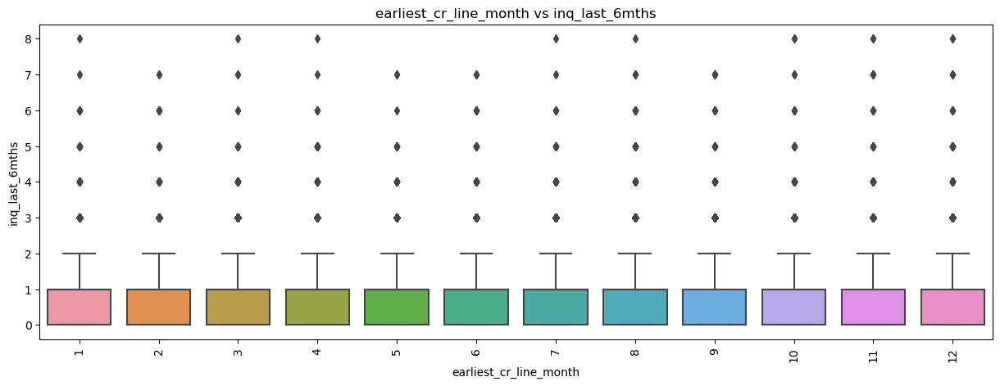

In [116]:
plt_seg_analysis(data=loan_data, col='inq_last_6mths', title='inq_last_6mths')

Here, we see the spread is very sparse and the values are from *0 to 8*. Hence, we could not deduce any information from these plots. So, we can deduce another way to plot this information. But we limit ourself to replot for now against **'loan_status'** as it is our area interest.

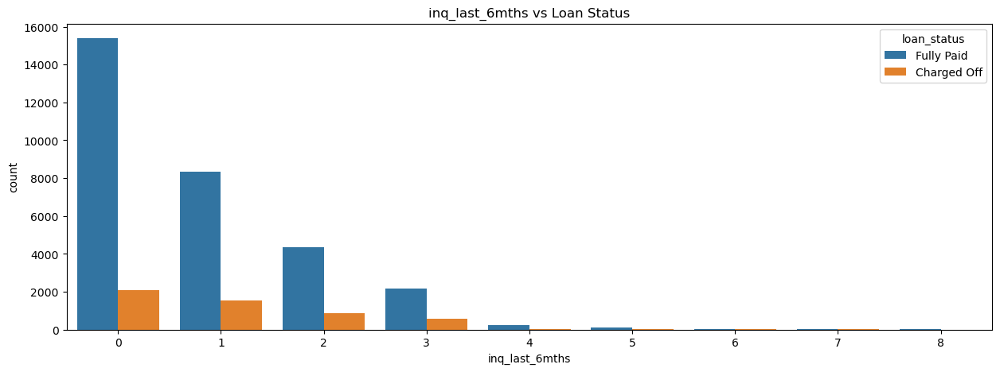

In [117]:
# Set the figure size
plt.figure(figsize=(15,5))
# Calling count plot
sns.countplot(x='inq_last_6mths', hue='loan_status', data=loan_data)
# Set the title
plt.title('inq_last_6mths vs Loan Status')
plt.show()

**Inference**

Below table provides segmented univariate analysis of **'inq_last_6mths'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Majority of people with long term have 2 inquiries. This is needed since the term is long. |
| Grade  | Grade A and B have majority of them 1 inquiry. This is sufficient since they have higher grades. |
| Employee Length | No significant observation. |
| Home Ownership  | OTHER category have maximum of only 3 inquiries. |
| Verification Status | No significant observation. |
| Loan Status  | Defaulters have been inquired more number of times. But cannot conclude any observation. |
| Issued Year  | More inquiries done in the year 2008 and 2009. |
| Issued Month | No significant observation. |
| Purpose | No significant observation. |
| State   | No significant observation. |
| earliest_cr_line_year  | No significant observation. |
| earliest_cr_line_month | No significant observation. |

---

#### 11) Open credit lines

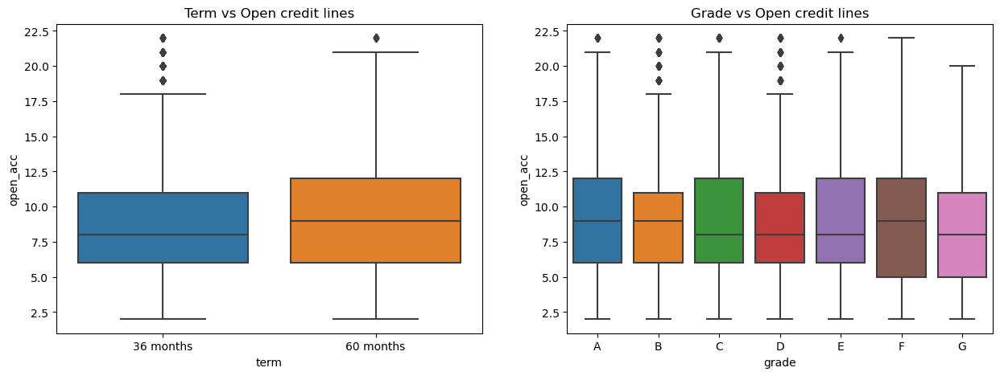

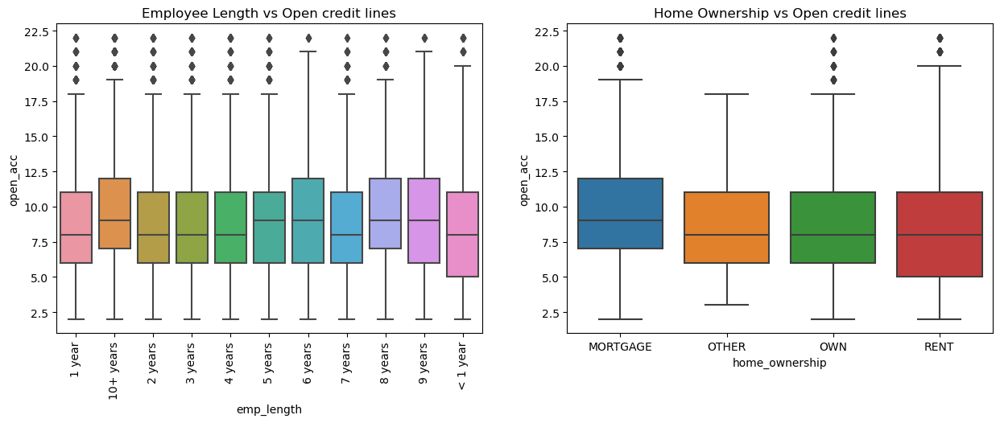

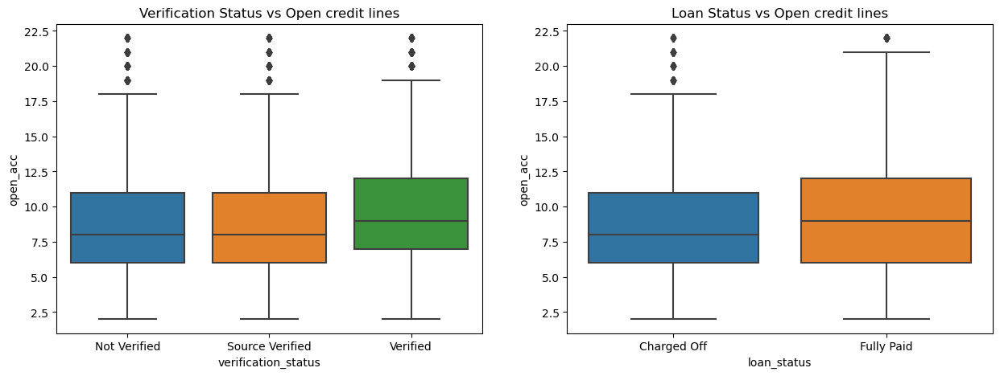

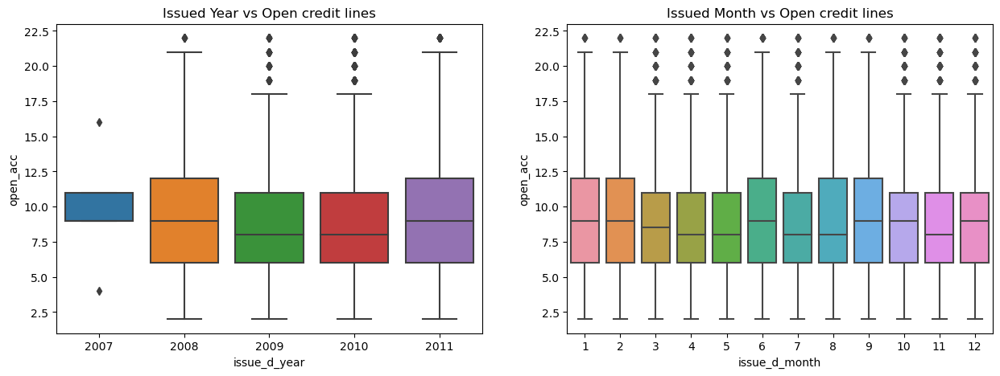

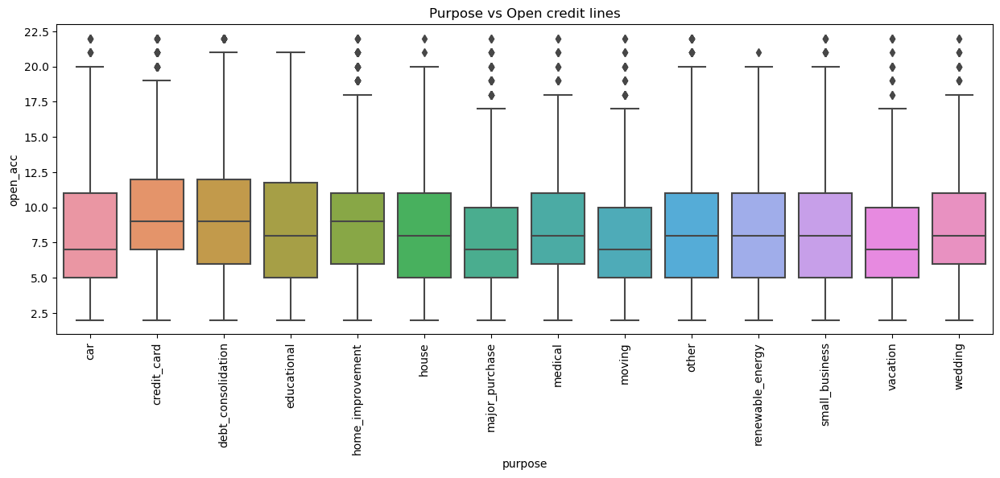

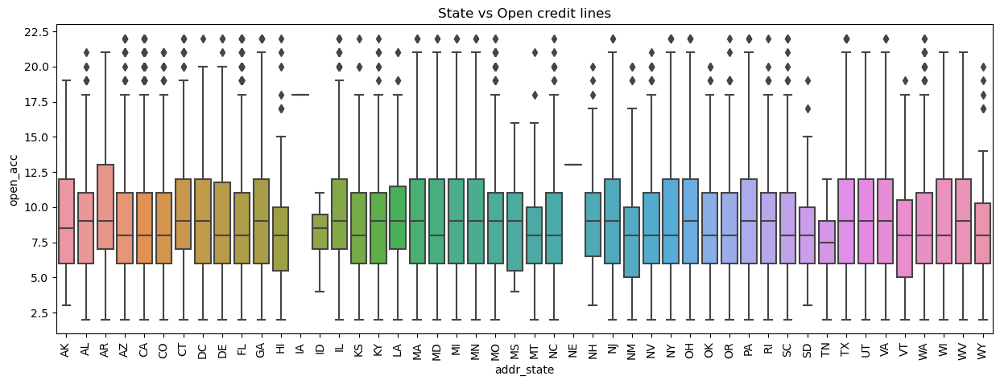

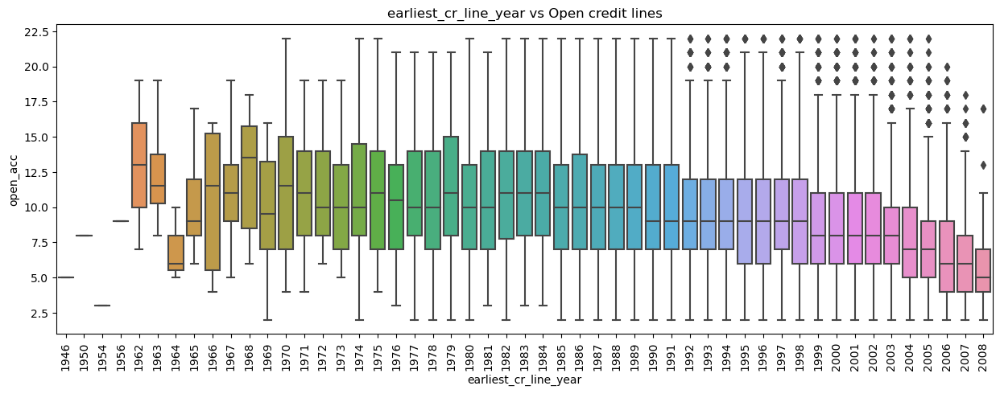

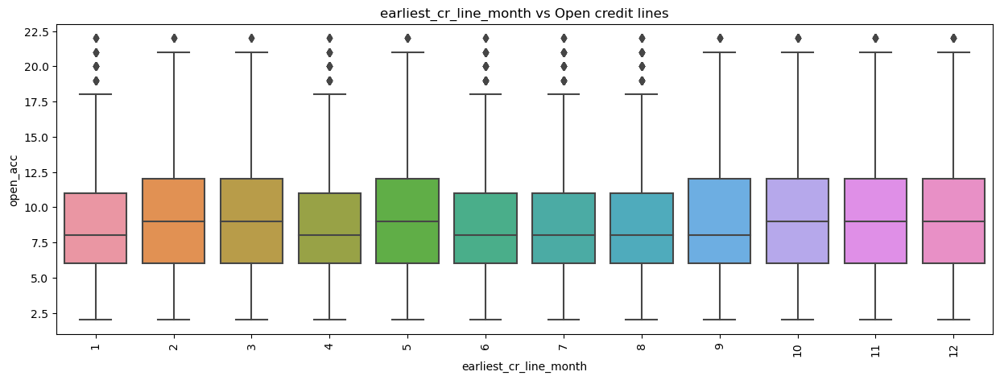

In [118]:
plt_seg_analysis(data=loan_data, col='open_acc', title='Open credit lines')

**Inference**

Below table provides segmented univariate analysis of **'open_acc'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Long term borrowers have more open credit lines. |
| Grade  | G have lesser open credit lines. |
| Employee Length | 10+ years have more open credit lines. As the experience increases, there is a slight increase in the open credit lines. |
| Home Ownership  | MORTGAGE have 10 as the most representative line while others are less than that. |
| Verification Status | Verified borrowers have more credit lines. |
| Loan Status  | No significant observation. |
| Issued Year  | Loans approved in 2007 have most of the borrowers with 10 open credit lines. |
| Issued Month | No significant observation. |
| Purpose | Educational purpose have a good spread of the open credit lines. |
| State   | Except IA, NE and TN, others have similar spread. |
| earliest_cr_line_year  | Have a similar spread from 1974-2000 and then slight decrease. |
| earliest_cr_line_month | No significant observation. |

---

#### 12) Public deragatory

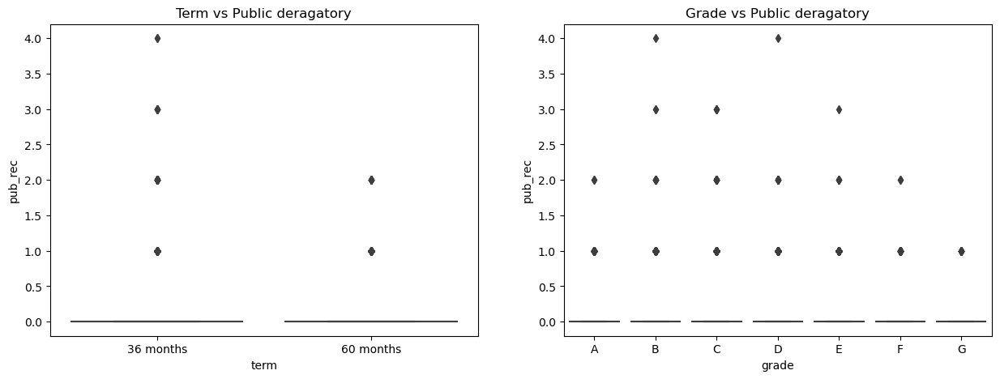

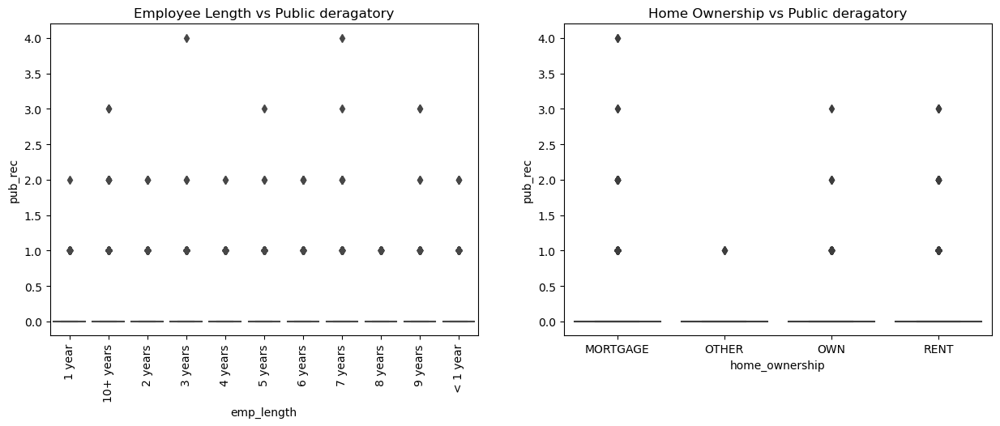

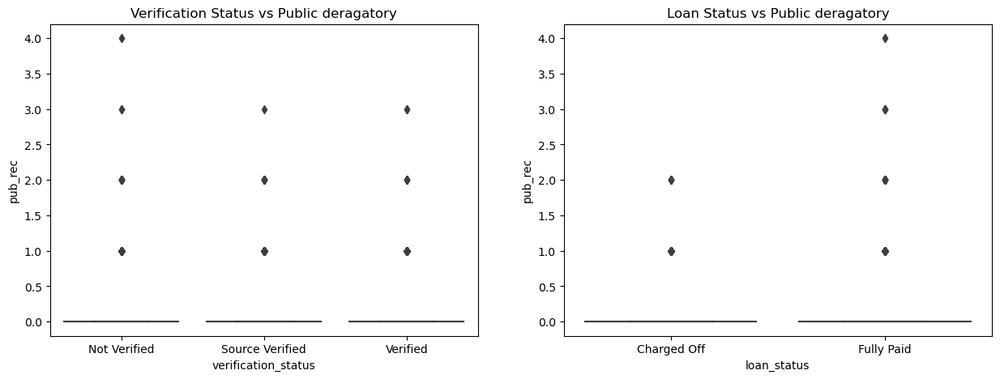

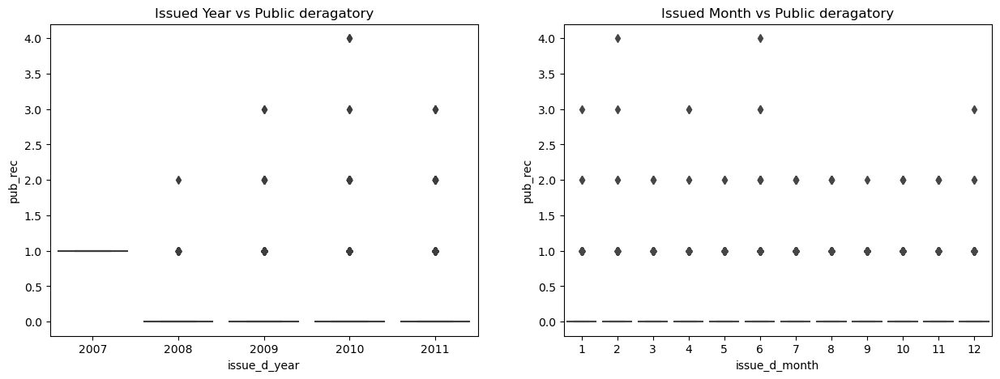

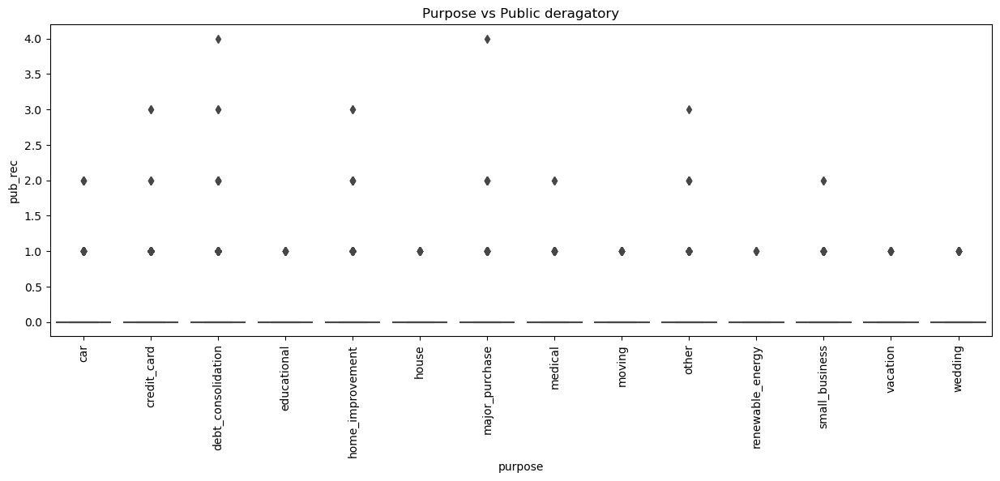

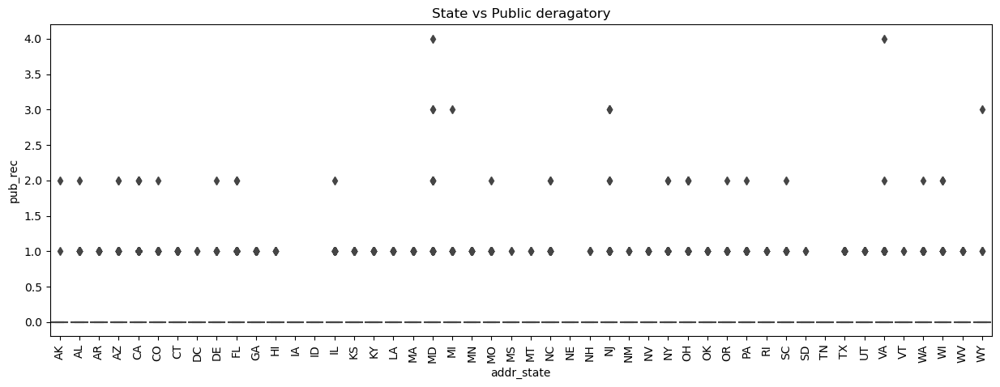

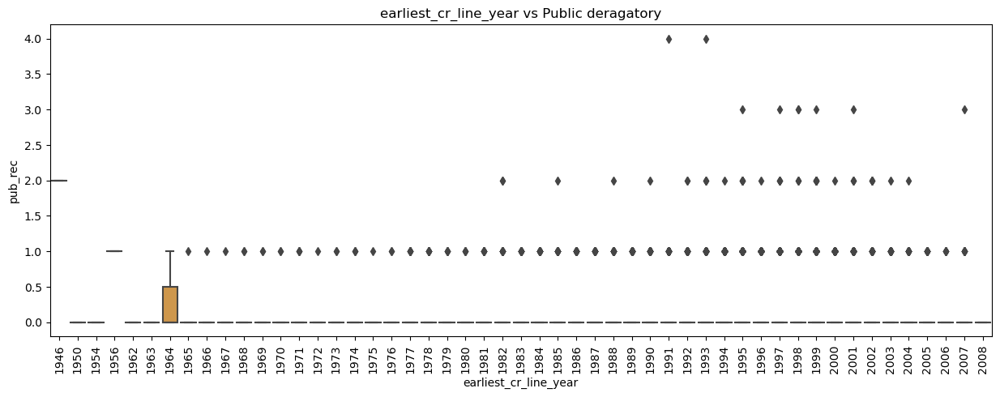

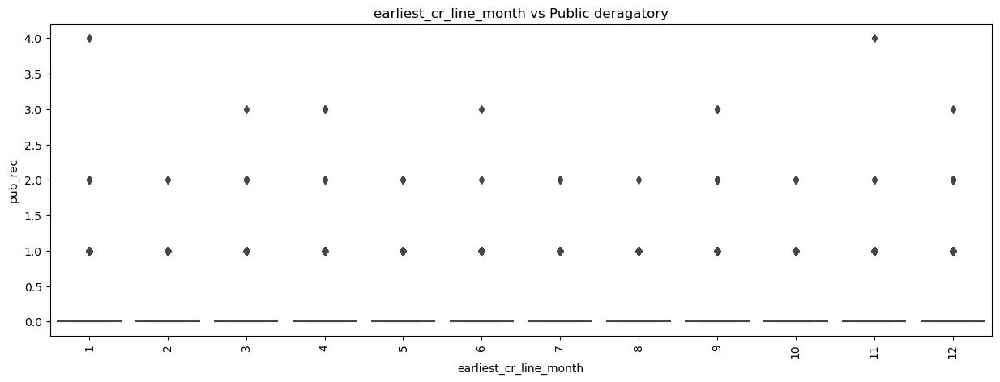

In [119]:
plt_seg_analysis(data=loan_data, col='pub_rec', title='Public deragatory')

Here, we see the spread is very sparse and the values are from *0 to 4*. Hence, we could not deduce any information from these plots. So, we can deduce another way to plot this information. But we limit ourself to replot for now against **'loan_status'** as it is our area interest.

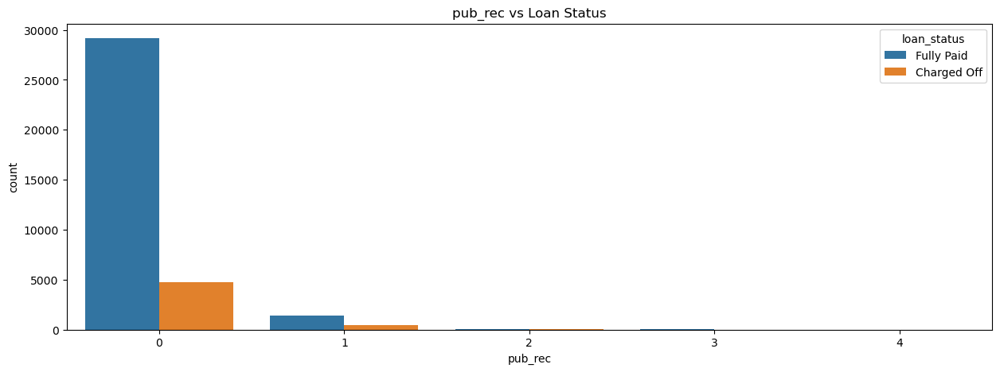

In [120]:
# Set the figure size
plt.figure(figsize=(15,5))
# Calling count plot
sns.countplot(x='pub_rec', hue='loan_status', data=loan_data)
# Set the title
plt.title('pub_rec vs Loan Status')
plt.show()

**Inference**

Below table provides segmented univariate analysis of **'pub_rec'** column:

| Column | Inference |
|:-------|:----------|
| Term   | No significant observation. |
| Grade  | No significant observation. |
| Employee Length | No significant observation. |
| Home Ownership  | No significant observation. |
| Verification Status | No significant observation. |
| Loan Status  | We could see most of them have 0 value. No significant observation. |
| Issued Year  | No significant observation. |
| Issued Month | No significant observation. |
| Purpose | No significant observation. |
| State   | No significant observation. |
| earliest_cr_line_year  | No significant observation. |
| earliest_cr_line_month | No significant observation. |

---

#### 13) Public recrord bankruptcies

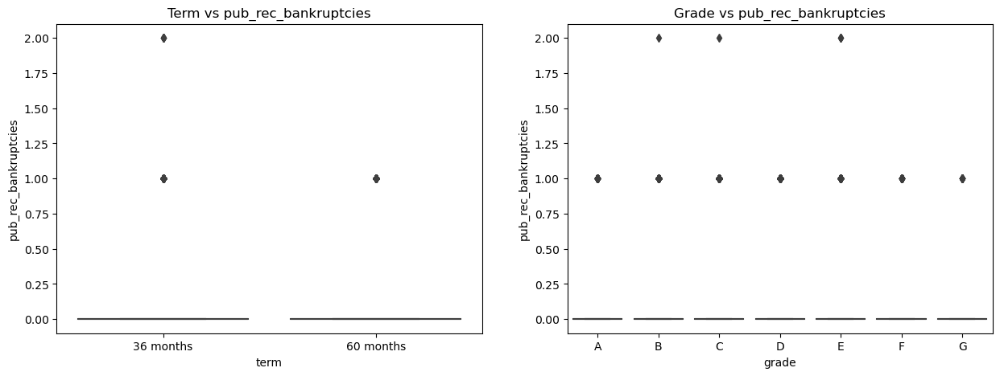

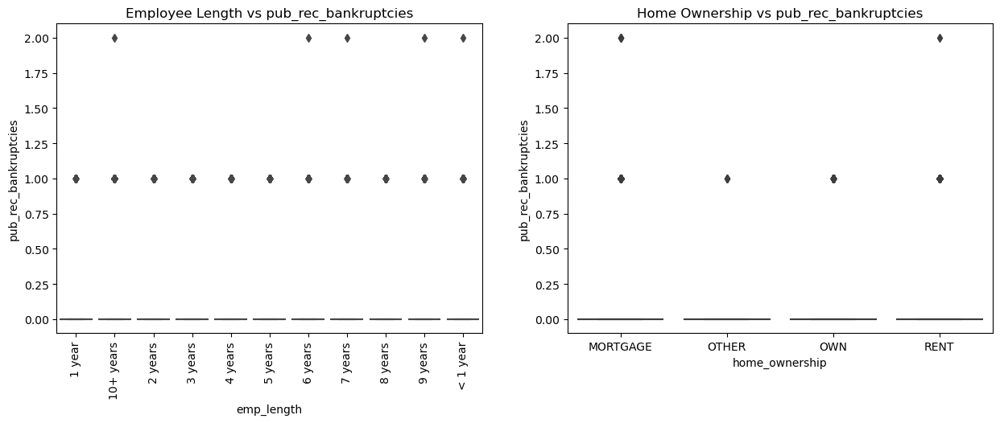

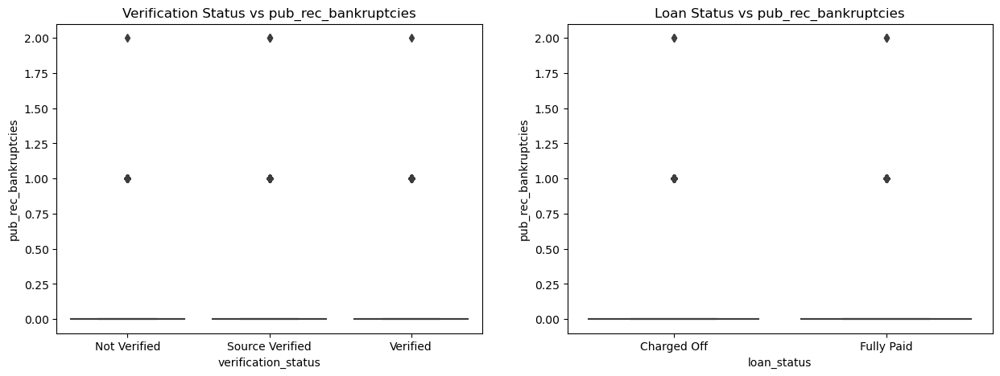

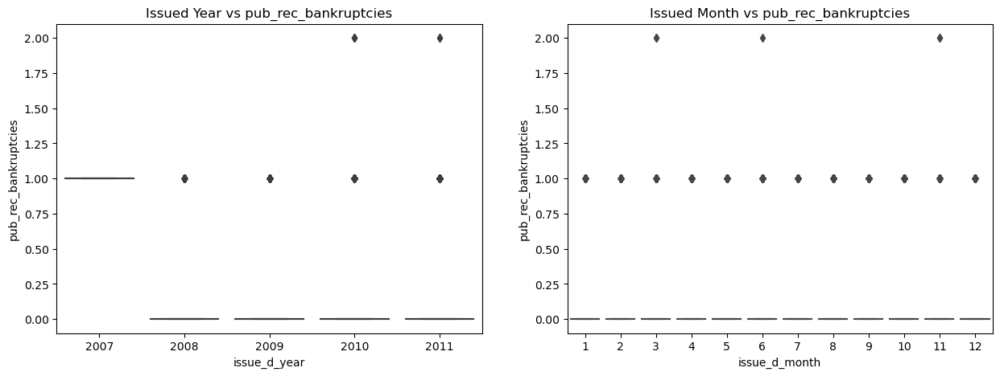

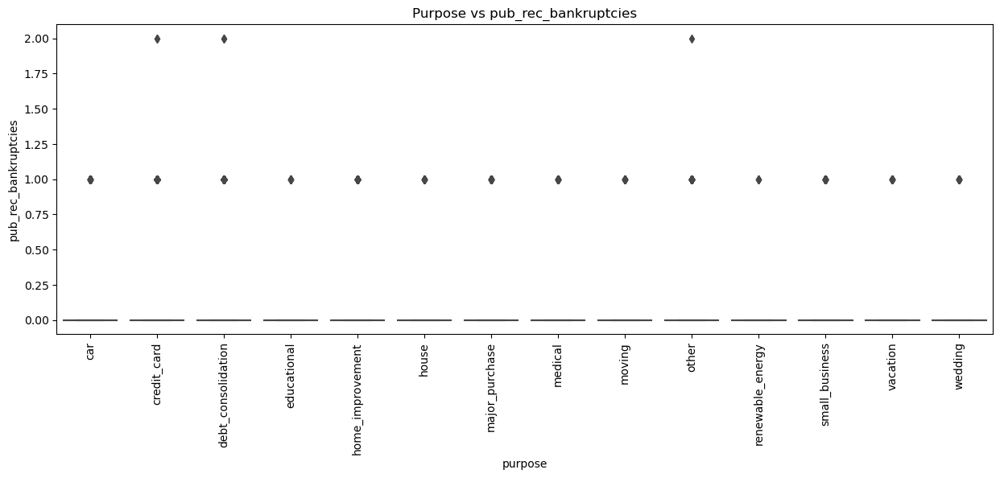

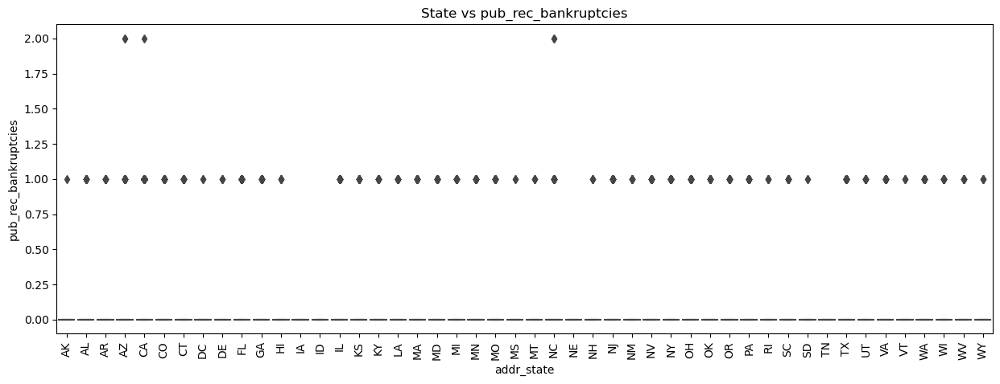

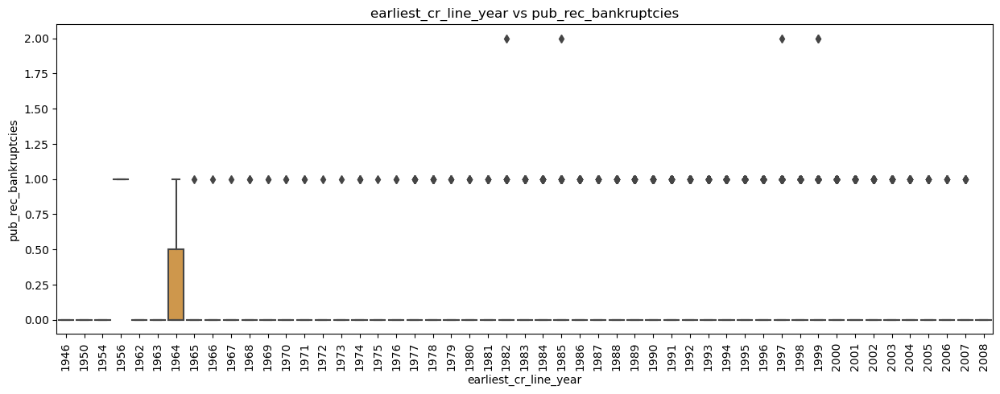

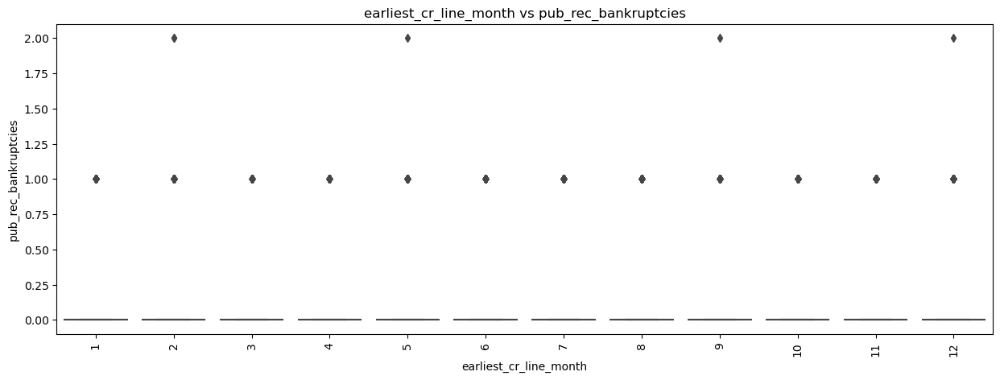

In [121]:
plt_seg_analysis(data=loan_data, col='pub_rec_bankruptcies', title='pub_rec_bankruptcies')

Here, we see the spread is very sparse and the values are from *0 to 2*. Hence, we could not deduce any information from these plots. So, we can deduce another way to plot this information. But we limit ourself to replot for now against **'loan_status'** as it is our area interest.

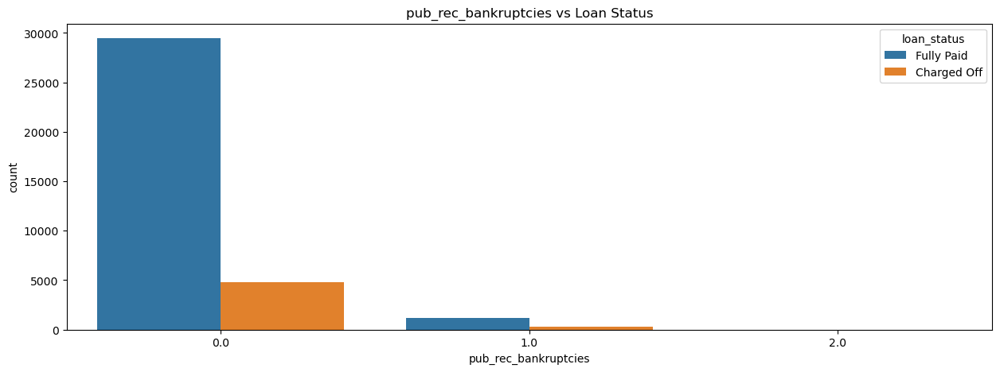

In [122]:
# Set the figure size
plt.figure(figsize=(15,5))
# Calling count plot
sns.countplot(x='pub_rec_bankruptcies', hue='loan_status', data=loan_data)
# Set the title
plt.title('pub_rec_bankruptcies vs Loan Status')
plt.show()

**Inference**

Below table provides segmented univariate analysis of **'pub_rec_bankruptcies'** column:

| Column | Inference |
|:-------|:----------|
| Term   | No significant observation. |
| Grade  | No significant observation. |
| Employee Length | No significant observation. |
| Home Ownership  | No significant observation. |
| Verification Status | No significant observation. |
| Loan Status  | We could see most of them have 0 value. No significant observation. |
| Issued Year  | No significant observation. |
| Issued Month | No significant observation. |
| Purpose | No significant observation. |
| State   | No significant observation. |
| earliest_cr_line_year  | No significant observation. |
| earliest_cr_line_month | No significant observation. |

---

#### 14) Revolving Balance

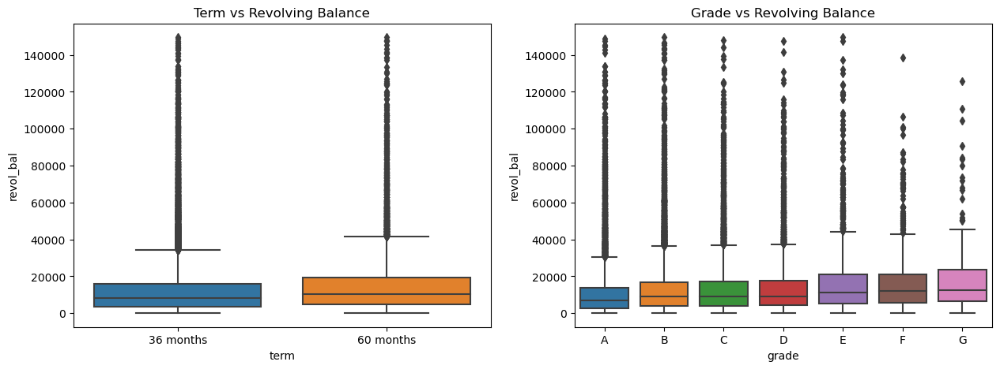

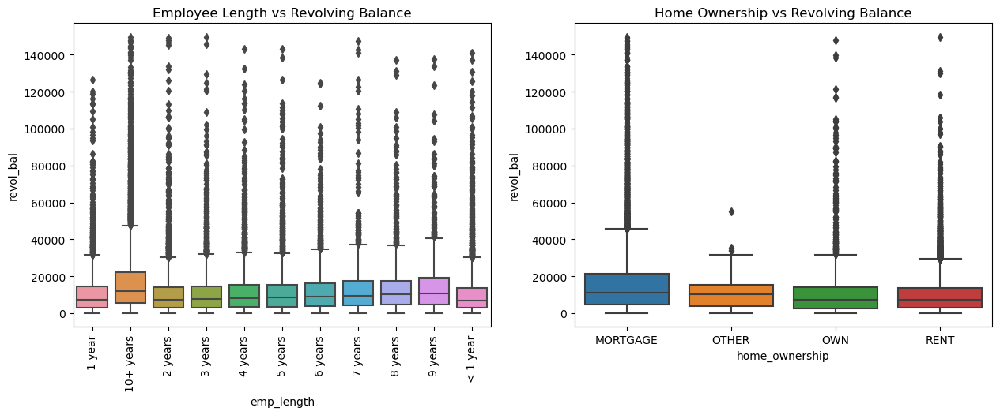

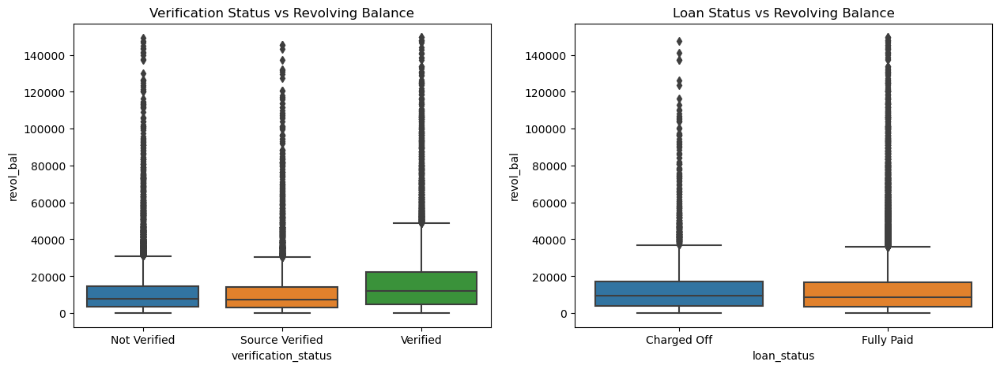

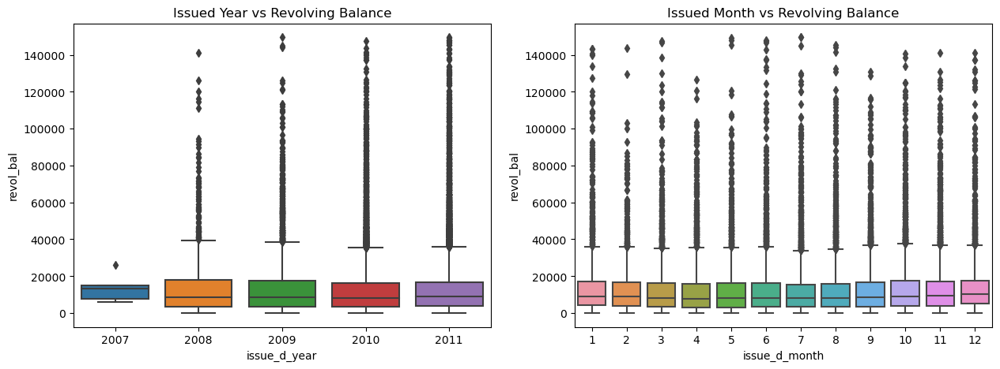

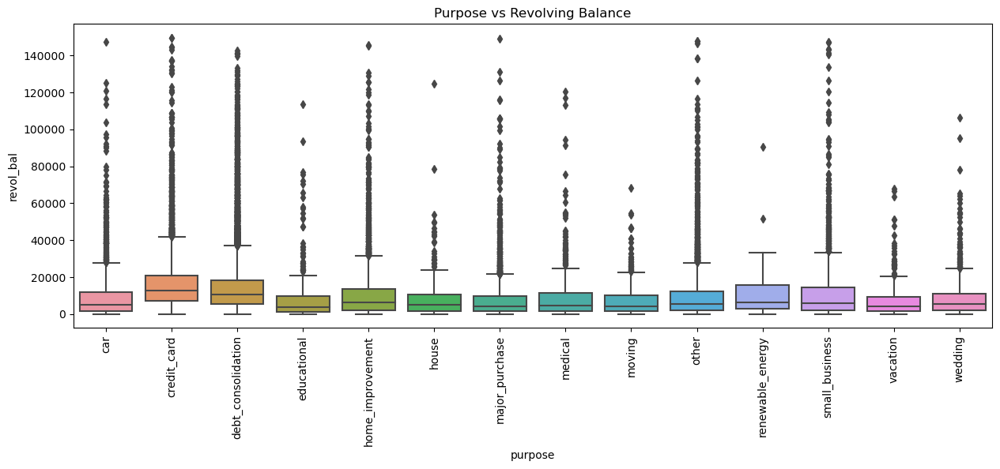

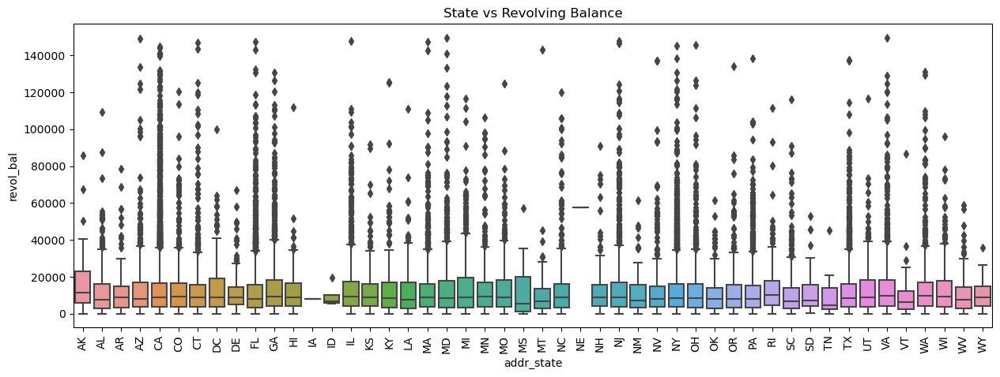

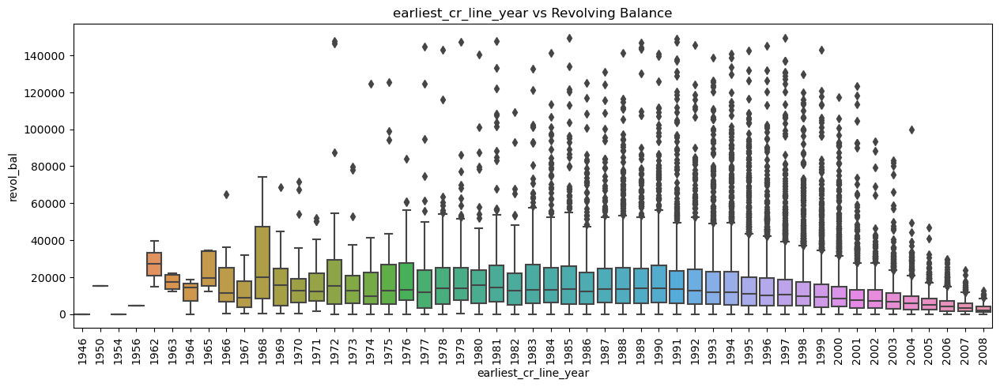

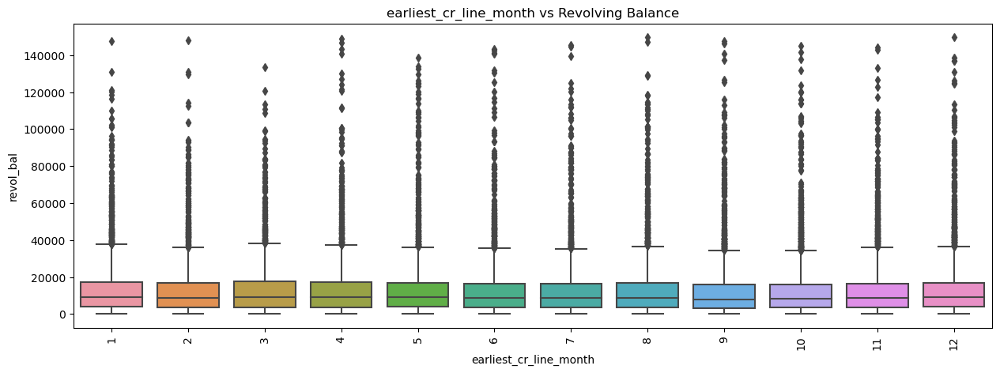

In [123]:
plt_seg_analysis(data=loan_data, col='revol_bal', title='Revolving Balance')

**Inference**

Below table provides segmented univariate analysis of **'revol_bal'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Outliers are values greater than 40000 |
| Grade  | People with higher revolving balance belongs to lower grades. |
| Employee Length | People with 10+ years experience have more revolving balance. |
| Home Ownership  | People with MORTGAGE have higher revolving balance. |
| Verification Status | Verified borrowers have more revolving balance. |
| Loan Status  | In any case, the revolving balance is mostly less than 20000 |
| Issued Year  | No significant observation. |
| Issued Month | No significant observation. |
| Purpose | The reason for people with credit_card and debt_consolidation to take loan might be to settle the higher revolving balance.|
| State   | Except borrowers from IA and NE, others have a similar spread. |
| earliest_cr_line_year  | Spread is becoming smaller from 1974-2008 |
| earliest_cr_line_month | No significant observation. |

---

#### 15) Revolving Utilization Rate

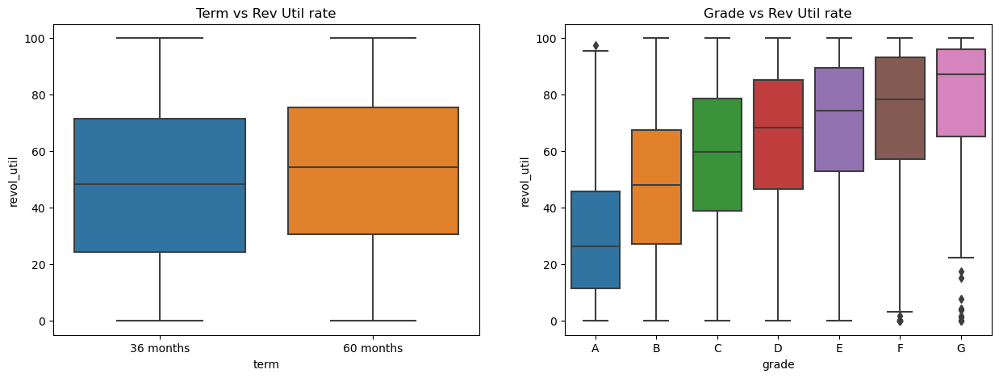

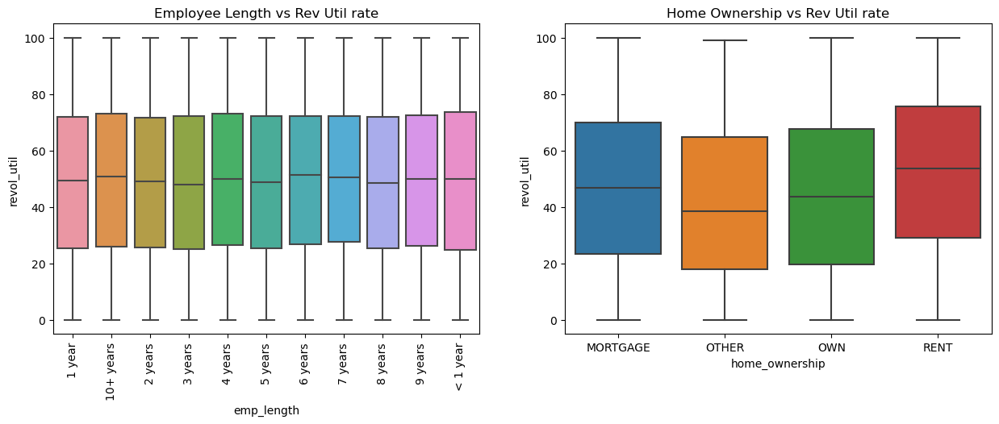

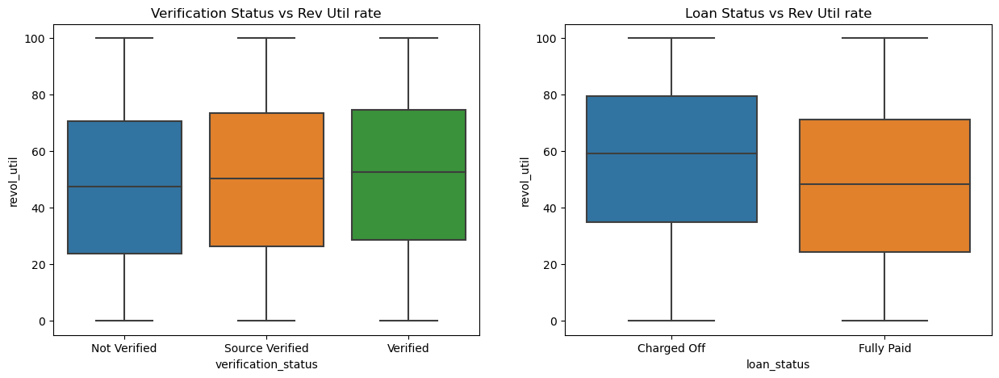

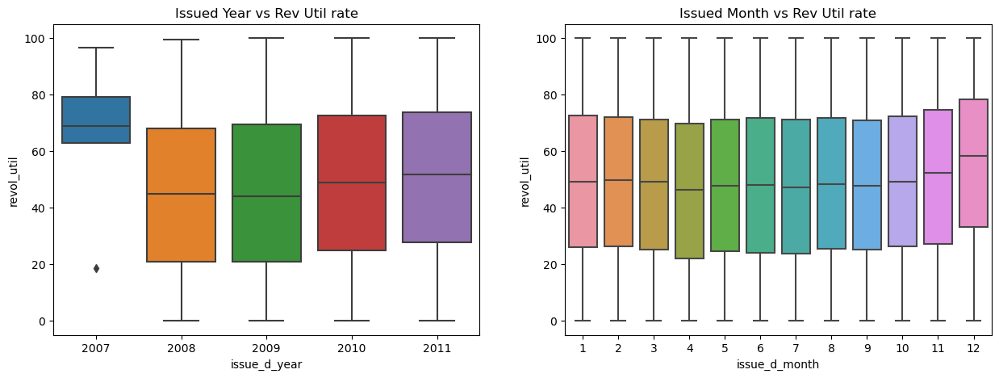

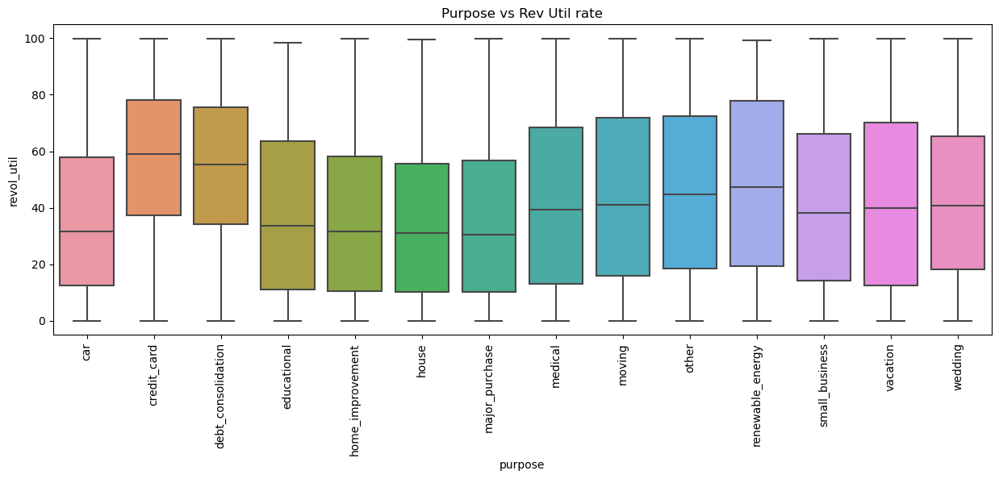

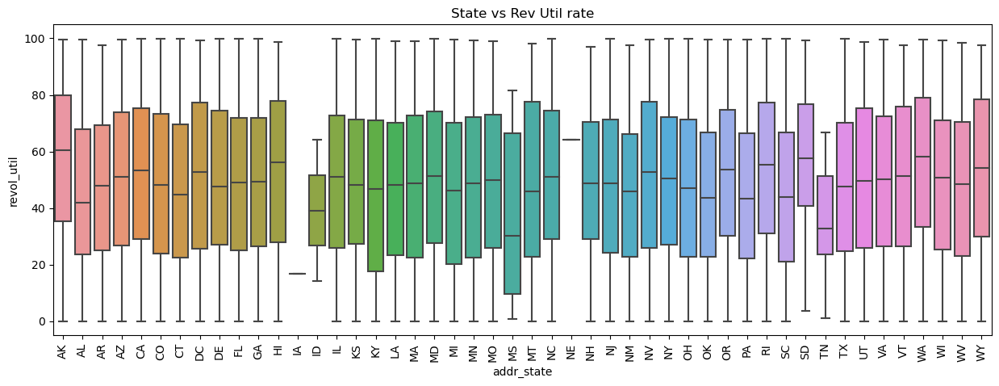

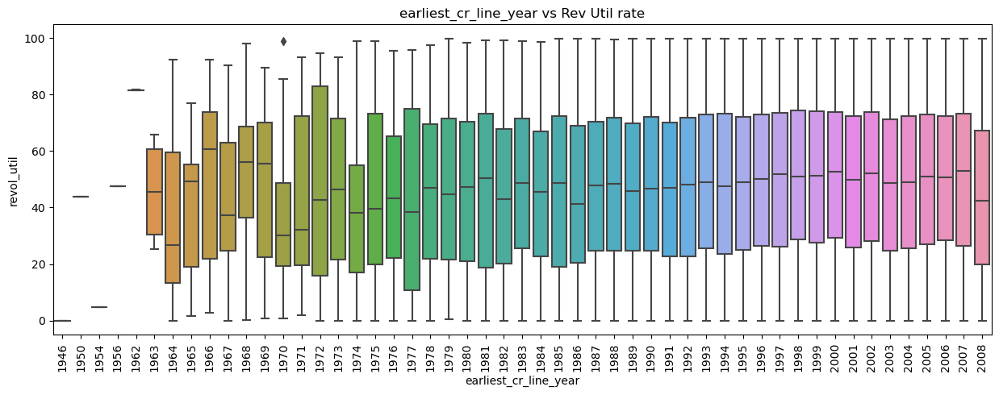

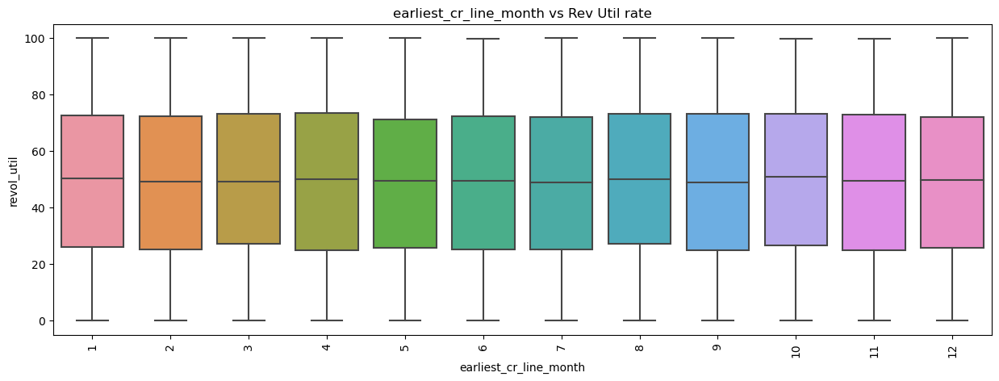

In [124]:
plt_seg_analysis(data=loan_data, col='revol_util', title='Rev Util rate')

**Inference**

Below table provides segmented univariate analysis of **'revol_util'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Long term borrowers have higher rate. |
| Grade  | People with higher rate belong to lower grades. |
| Employee Length | No significant observation. |
| Home Ownership  | OTHER category have lesser utilization rate. |
| Verification Status | No significant observation. |
| Loan Status  | People who have higher utilization rate tend to be defaulters. |
| Issued Year  | 2007 had people with narrow rate and other years tend to be having similar spread. |
| Issued Month | No significant observation. |
| Purpose | People taken loan for credit card and debt consolidation have higher utilization rate. |
| State   | Except IA and NE, spread remains similar. |
| earliest_cr_line_year  | No significant observation. |
| earliest_cr_line_month | No significant observation. |

---

#### 16) Total credit lines

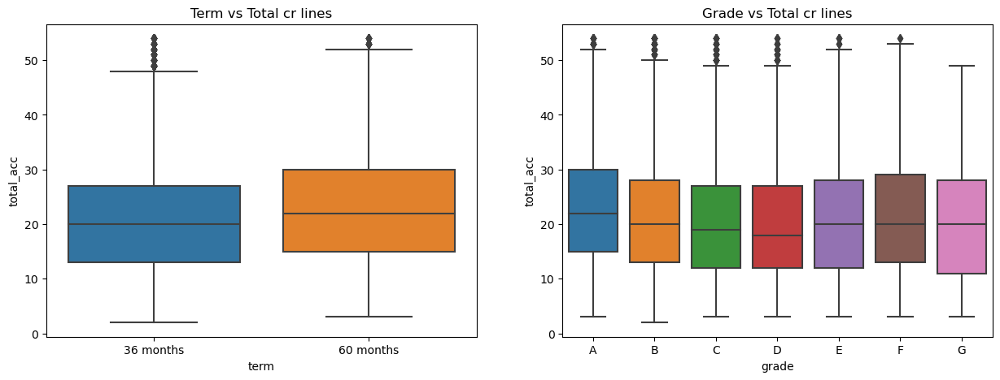

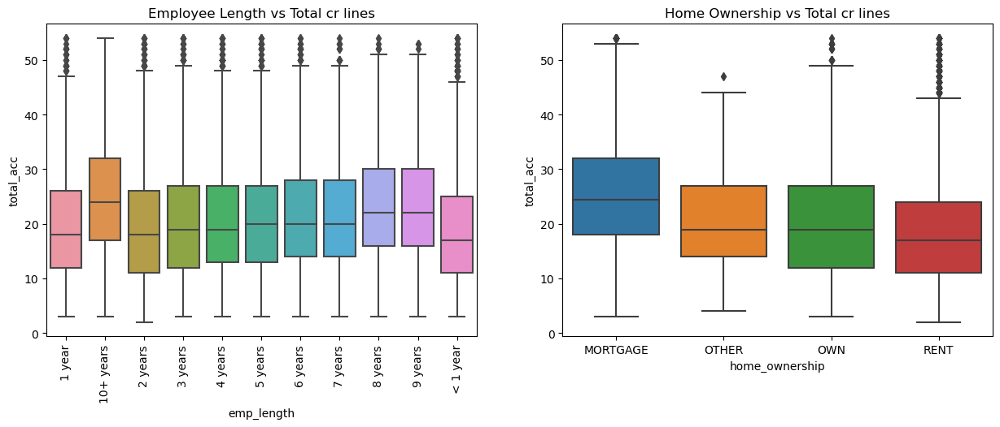

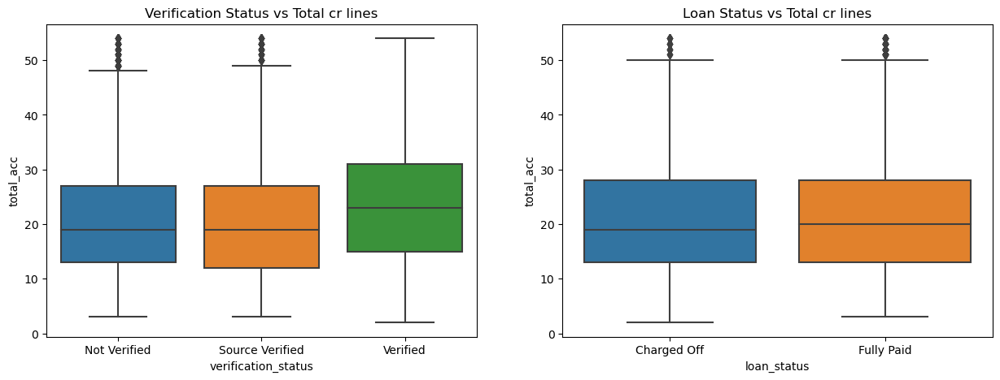

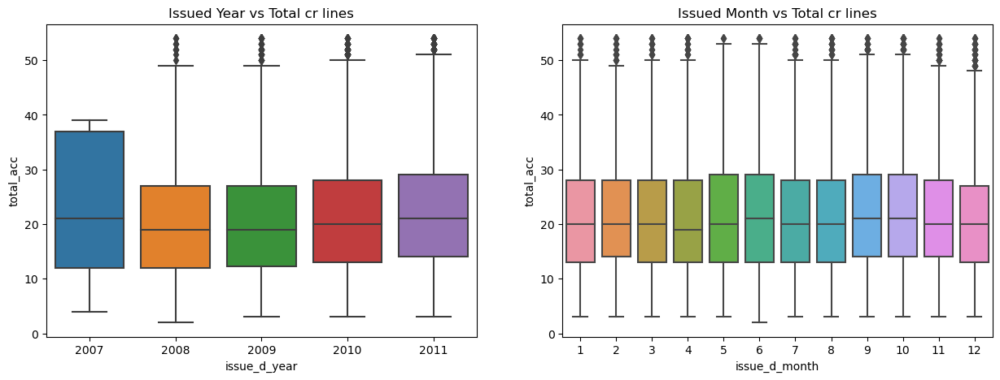

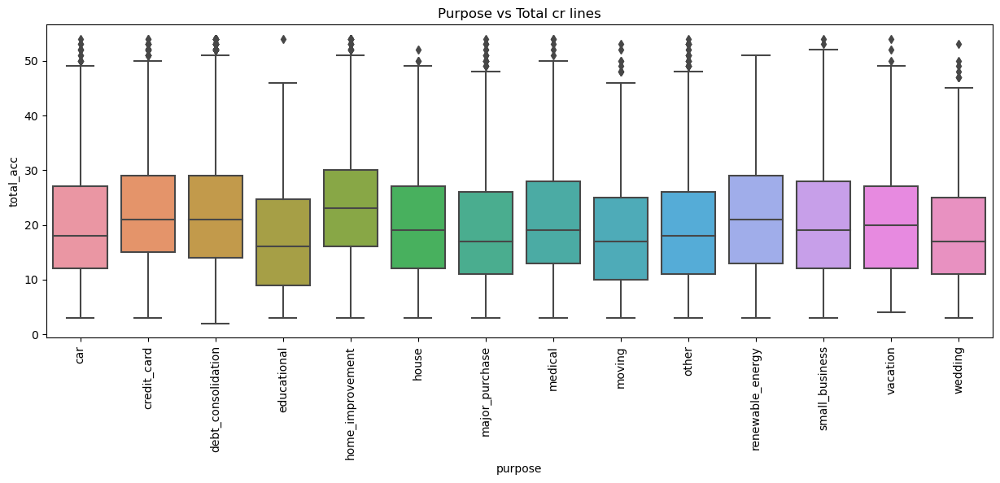

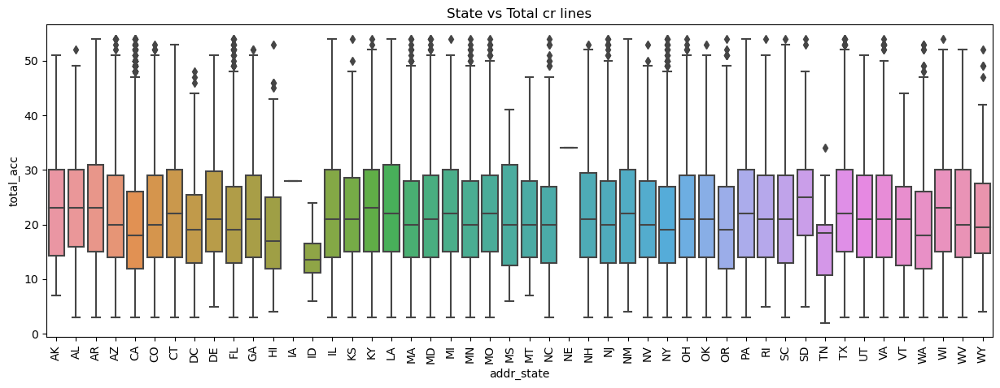

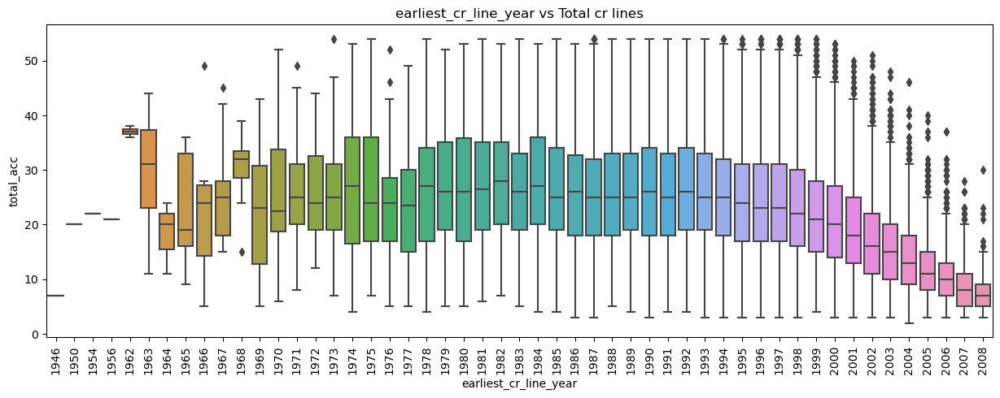

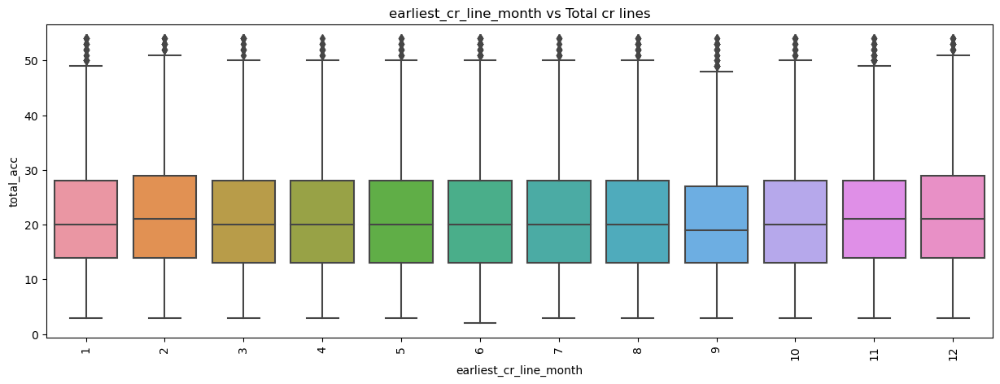

In [125]:
plt_seg_analysis(data=loan_data, col='total_acc', title='Total cr lines')

**Inference**

Below table provides segmented univariate analysis of **'total_acc'** column:

| Column | Inference |
|:-------|:----------|
| Term   | Long term borrowers have more total credits. |
| Grade  | No significant observation. |
| Employee Length | People with 10+ years have more total credits. |
| Home Ownership  | People with MORTGAGE have more total credits. |
| Verification Status | Verified borrowers have more total credits. |
| Loan Status  | No significant observation. Very little difference. |
| Issued Year  | Borrowers from 2007 have more total credits. |
| Issued Month | No significant observation. |
| Purpose | People taken loan for home improvement, credit card, debt consolidation have more total credits.  |
| State   | Except IA, NE and TN, spread remains similar. |
| earliest_cr_line_year  | Spread is becoming smaller from 1974-2008. |
| earliest_cr_line_month | No significant observation. |

---

### Summary of segmented univariate analysis:

In this section, we have showcased the segmented analysis of most of the combinations of columns. But for this assignment, the focus is on analysing the **pattern for defaulters**. So going forward, we will focus just on identifying the pattern for defaulters *(using 'loan_status' column)*.

Here is a quick snapshot of segmented univariate analysis of **'loan_status'** against all the other columns:
| Column | Inference | Impacts defaulters (Yes/No/Maybe) |
|:-------|:----------|:----------------------------|
| Loan amount | The spread of amount is wide for defaulters ranging from around 6000-17000. Higher amount have more defaulters. | Maybe |
| Funded amount | The spread of amount is wide for defaulters ranging from around 6000-17000. Higher amount have more defaulters. | Maybe |
| Funded amount by investors | The spread of amount is wide for defaulters ranging from around 6000-15000. Higher amount have more defaulters. | Maybe |
| Approved loan amount | No significant observation. | No |
| Interest rate | Higher interest rates have more defaulters. | Yes |
| Installment | Defaulters have wide spread of installments. | Maybe |
| Annual Income | Defaulters earn low salary and thay might be reason why they could not pay their loans. | Maybe |
| Debt to Income | As the dti is more, the borrowers find it difficult to pay the loan and become defaulters. | Maybe |
| Delinquency since 2 years | We could see most of them have 0 value. No significant observation. | No |
| Inquiries in past 6 months | Defaulters have been inquired more number of times. But cannot conclude any observation. | No |
| Open credit lines | No significant observation. | No |
| Public deragatory | We could see most of them have 0 value. No significant observation. | No |
| Public record bankruptcies | We could see most of them have 0 value. No significant observation. | No |
| Revolving Balance | In any case, the revolving balance is mostly less than 20000 | No |
| Revolving Utilization rate | People who have higher utilization rate tend to be defaulters. | Yes |
| Total credit line | No significant observation. Very little difference. | Maybe |

Below table gives the meaning of the options.
| Impacts defaulters | Comments |
|:-------------------|:---------|
| Yes | Driver variable. There is a clear difference in the plot. |
| No | Does not have any impact on the defaulters. |
| Maybe | Has the potential to be a driver variable. |

> - **We could clearly see that "interest rate" and "revolving utilization rate" to have a clear impact on the defaulters**

---
---

Before the next step, let's review the columns once again.

- After univariate analysis, we found these columns ('sub_grade', 'zip_code' and 'title') are redundant.
- After segmented univariate analysis, we found these columns ('approved_loan_amt', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec', 'pub_rec_bankruptcies','revol_bal') do not have any impact on analysing defaulter pattern.
- We can also see that 'loan_amnt', 'funded_amnt' and 'funded_amnt_inv' are all redundant. It is worth to just analyse any one of these columns, and let us choose 'funded_amnt_inv' as it is the real value funded by investors.
- We can also see that 'issue_d_month' and 'earliest_cr_line_month' do not have any pattern with any column.

Based on the above conclusions, let's remove the redundant and no impact columns to create important loan data subset _which can also be used when needed._

In [126]:
# Remove the columns and term a new variable 'imp_loan_data' which contains the important loan data
imp_loan_data = loan_data.drop(columns=['sub_grade', 'zip_code', 'title','approved_loan_amt', 'delinq_2yrs', 'inq_last_6mths', 
                                        'open_acc', 'pub_rec', 'pub_rec_bankruptcies','revol_bal','loan_amnt','funded_amnt',
                                        'issue_d_month','earliest_cr_line_month'])

# Sample the dataset
imp_loan_data.head()

,id,funded_amnt_inv,term,int_rate,installment,grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,addr_state,dti,earliest_cr_line,revol_util,total_acc,issue_d_year,earliest_cr_line_year
0,1077501,4975.0,36 months,10.65,162.87,B,10+ years,RENT,24000.0,Verified,2011-12-01,Fully Paid,credit_card,AZ,27.65,1985-01-01,83.7,9,2011,1985
1,1077430,2500.0,60 months,15.27,59.83,C,< 1 year,RENT,30000.0,Source Verified,2011-12-01,Charged Off,car,GA,1.00,1999-04-01,9.4,4,2011,1999
2,1077175,2400.0,36 months,15.96,84.33,C,10+ years,RENT,12252.0,Not Verified,2011-12-01,Fully Paid,small_business,IL,8.72,2001-11-01,98.5,10,2011,2001
3,1076863,10000.0,36 months,13.49,339.31,C,10+ years,RENT,49200.0,Source Verified,2011-12-01,Fully Paid,other,CA,20.00,1996-02-01,21.0,37,2011,1996
5,1075269,5000.0,36 months,7.90,156.46,A,3 years,RENT,36000.0,Source Verified,2011-12-01,Fully Paid,wedding,AZ,11.20,2004-11-01,28.3,12,2011,2004


In [127]:
print("Clean loan data : ", loan_data.shape)
print("Important loan data : ", imp_loan_data.shape)

Clean loan data :  (35780, 34)
Important loan data :  (35780, 20)


> We can see using univariate and segmented univariate analysis, we have removed **14 columns**.

---
---

## Bivariate analysis

Unlike segmented univariate analysis, here we will focus on analysing the defaulters.

We have three different ways to do this:
1) Continuous variable vs Continous variable
2) Categorical variable vs Categorical variable
3) Categorical variable vs Continuous variable (which is same as segmented univariate analysis)
---

#### 1) Continuous variable vs Continous variable

- We will use heatmap on clean loan data , where each continuous variable will be correlated with each other continuous variable in the dataset.

C:\Users\sea\AppData\Local\Temp\ipykernel_8664\929210779.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_data = loan_data.corr()


<Axes: >

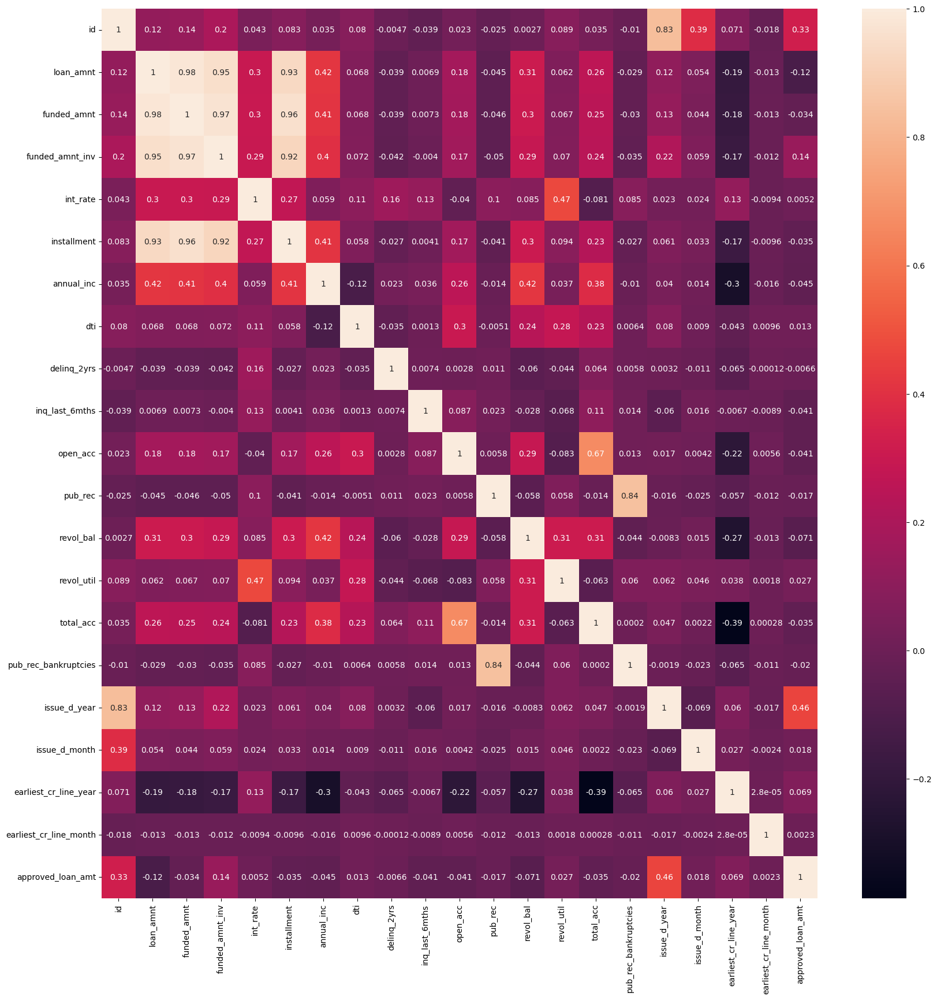

In [128]:
# Compute the correlation matrix
corr_data = loan_data.corr()
# Set the figure size
plt.figure(figsize=(20,20))
# Use heatmap plot to visualize the matrix
sns.heatmap(corr_data, annot=True)

- We will use clustermap on important loan data to have focused understanding.

C:\Users\sea\AppData\Local\Temp\ipykernel_8664\3133222289.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_data = imp_loan_data.corr()


<Figure size 2000x2000 with 0 Axes>

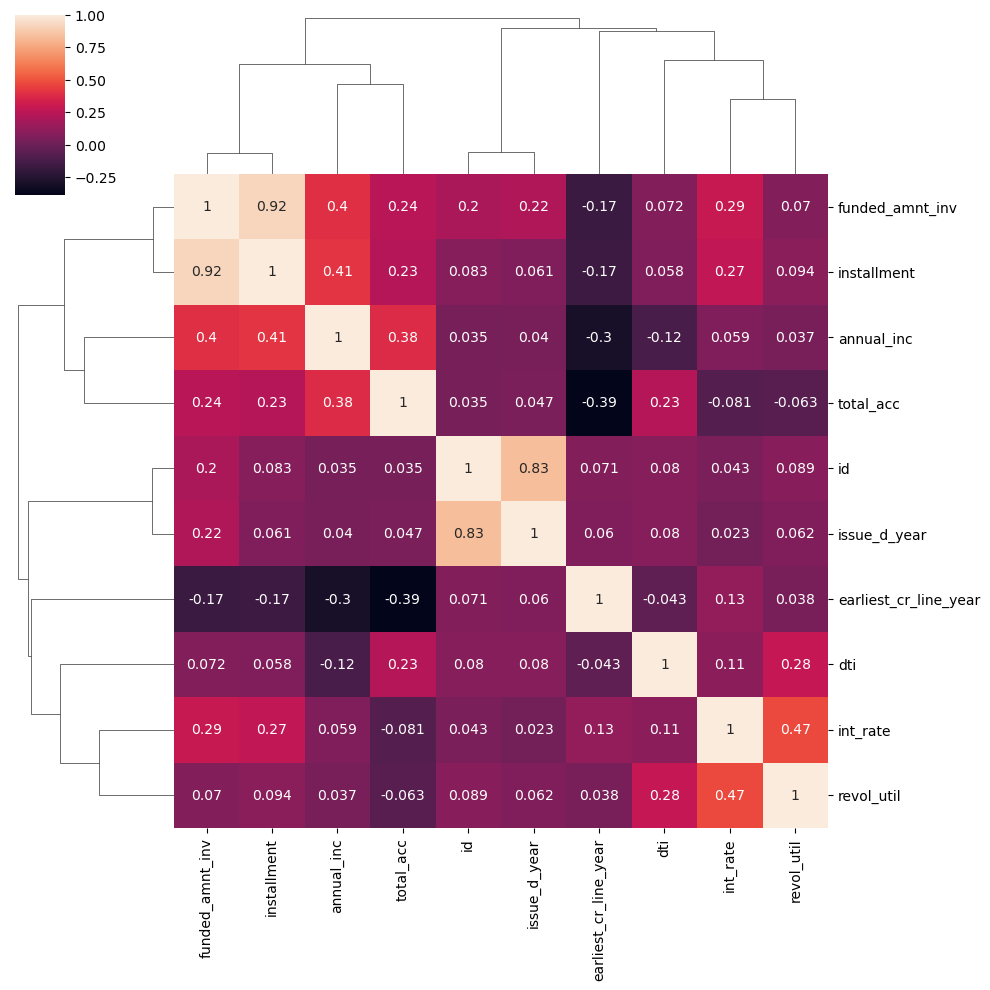

In [129]:
# Compute the correlation matrix
corr_data = imp_loan_data.corr()
# Set the figure size
plt.figure(figsize=(20,20))
# Use heatmap plot to visualize the matrix
sns.clustermap(corr_data, annot=True)

### Summary of bivariate analysis on continuous vs continuous variable :

*Ignoring id column and looking at major correlation both from Heatmap and Clustermap*

- 'loan_amnt','funded_amnt' and 'funded_amnt_inv' are all highly and positively correlated which we have found in earlier analysis.
- 'loan_amnt','funded_amnt' and 'funded_amnt_inv' are highly and positively correlated with 'installment'.
- Public derogatory and public recorded bankruptcies have high positive correlation.
- Total credit lines and open credit lines have high positive correlation.
- Interest rate and revolving utilization rate have good positive correlation.
- Total credit lines and earliest credit line have good negative correlation.
- Annual income and earliest credit line have good negative correlation.

---
---

#### 2) Categorical variable vs Categorical variable

**Plot function**

In [130]:
# As we are doing bivariate analysis between one categorical variables against 'loan_status', 
# let us define common plot functions.

# The below function creates one/two barchart of data in a single plot object
# data   - Input - Dataset which has the values
# title1 - Input - Title of the first plot
# x1     - Input - x value of first plot
# x1rotate - Input - rotate xticks of first plot
# title2 - Input - Title of the second plot
# x2     - Input - x value of second plot
# x2rotate - Input - rotate xticks of second plot
# annotate1 - Input - When true, annotate first plot
# annotate2 - Input - When true, annotate second plot
# Note : If we set x2 as empty, the function will not plot second plot
def plt_cat_bar(data="", title1="", x1="", x1rotate=0, title2="", x2="",x2rotate=0, annotate1=False, annotate2=False):    
    # If second plot data is empty, then do a single plot
    if x2 == "":
        # Set the figure size to a standard so that it will be easy for viewing
        plt.figure(figsize=(15,5))
        # Set title
        plt.title('Loan status vs ' + title1)
        # Rotate x ticks
        plt.xticks(rotation=x1rotate)
        # Group the columns by the input categorical column and loan status
        temp_df = imp_loan_data.groupby([x1, 'loan_status'], as_index=False)['id'].count()
        # Group the temp_df by the input categorical column and find proportions of each category
        temp_df['proportion'] = temp_df.groupby(x1)['id'].transform(lambda x: x/x.sum())
        # Calling bar plot
        ax = sns.barplot(x=x1, y='proportion', hue='loan_status', data=temp_df)
        if annotate1 == True:
            # Iterating over the bars one-by-one
            for bar in ax.patches:
              # Using Matplotlib's annotate function
              # x-position: bar.get_x() + bar.get_width() / 2
              # y-position: bar.get_height()
              # free space to be left to make graph pleasing: (0, 8)
              # ha and va stand for the horizontal and vertical alignment
                ax.annotate(format(bar.get_height(), '.2f'),
                               (bar.get_x() + bar.get_width() / 2,
                                bar.get_height()), ha='center', va='center',
                                size=15, xytext=(0, 8),
                                textcoords='offset points')
    else:
        # Set the figure size to a standard so that it will be easy for viewing
        plt.figure(figsize=(15,5))
        # Set the subplot index
        plt.subplot(1,2,1)
        # Set title
        plt.title('Loan status vs ' + title1)
        # Rotate x ticks
        plt.xticks(rotation=x1rotate)
        # Group the columns by the input categorical column and loan status
        temp_df = imp_loan_data.groupby([x1, 'loan_status'], as_index=False)['id'].count()
        # Group the temp_df by the input categorical column and find proportions of each category
        temp_df['proportion'] = temp_df.groupby(x1)['id'].transform(lambda x: x/x.sum())
        # Calling bar plot
        ax = sns.barplot(x=x1, y='proportion', hue='loan_status', data=temp_df)
        if annotate1 == True:
            # Iterating over the bars one-by-one
            for bar in ax.patches:
              # Using Matplotlib's annotate function
              # x-position: bar.get_x() + bar.get_width() / 2
              # y-position: bar.get_height()
              # free space to be left to make graph pleasing: (0, 8)
              # ha and va stand for the horizontal and vertical alignment
                ax.annotate(format(bar.get_height(), '.2f'),
                               (bar.get_x() + bar.get_width() / 2,
                                bar.get_height()), ha='center', va='center',
                                size=15, xytext=(0, 8),
                                textcoords='offset points')
        # Set the subplot index
        plt.subplot(1,2,2)
        # Set title
        plt.title('Loan status vs ' + title2)
        # Rotate x ticks
        plt.xticks(rotation=x2rotate)
        # Group the columns by the input categorical column and loan status
        temp_df = imp_loan_data.groupby([x2, 'loan_status'], as_index=False)['id'].count()
        # Group the temp_df by the input categorical column and find proportions of each category
        temp_df['proportion'] = temp_df.groupby(x2)['id'].transform(lambda x: x/x.sum())
        # Calling bar plot
        ax = sns.barplot(x=x2, y='proportion', hue='loan_status', data=temp_df)
        if annotate2 == True:
            # Iterating over the bars one-by-one
            for bar in ax.patches:
              # Using Matplotlib's annotate function
              # x-position: bar.get_x() + bar.get_width() / 2
              # y-position: bar.get_height()
              # free space to be left to make graph pleasing: (0, 8)
              # ha and va stand for the horizontal and vertical alignment
                ax.annotate(format(bar.get_height(), '.2f'),
                               (bar.get_x() + bar.get_width() / 2,
                                bar.get_height()), ha='center', va='center',
                                size=15, xytext=(0, 8),
                                textcoords='offset points')
    plt.show()

---

**Loan status vs Term / Grade**

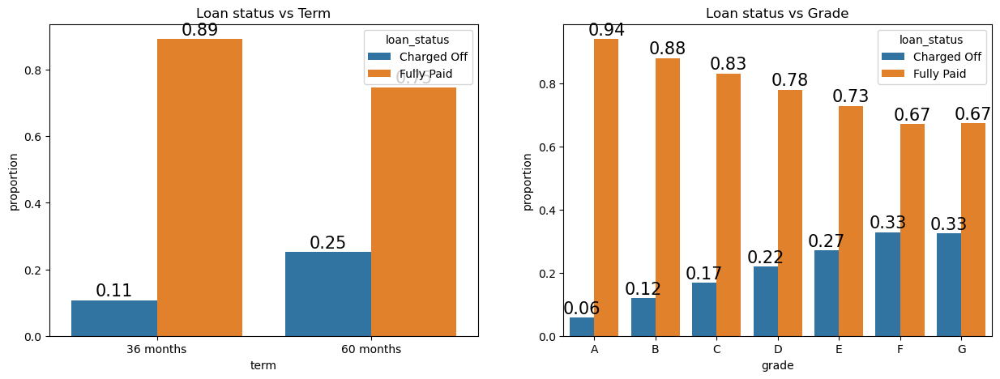

In [131]:
plt_cat_bar(data = imp_loan_data, x1 = 'term' , title1 = 'Term', annotate1=True,
                                  x2 = 'grade', title2 = 'Grade', annotate2=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Term   | Long term loan have more defaulters. |
| Grade  | As the grade decreases, the proportion of defaulters increases. |

---

**Loan status vs Employment length / Home ownership**

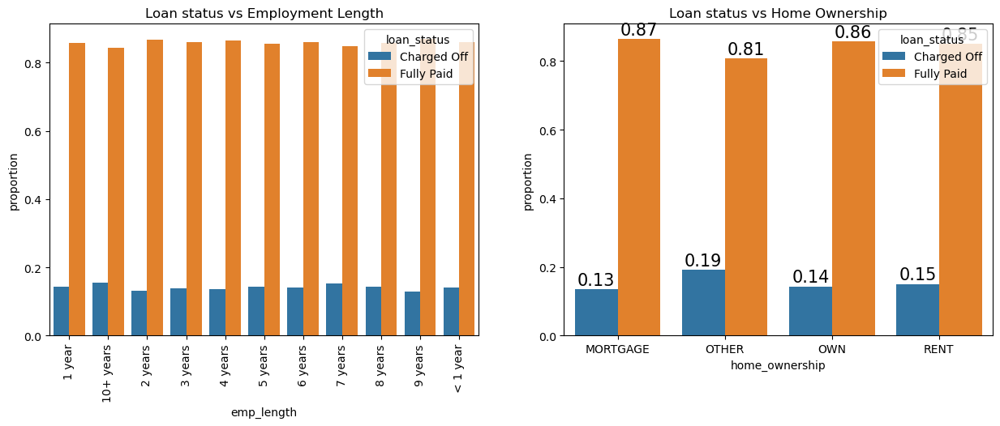

In [132]:
plt_cat_bar(data = imp_loan_data, x1 = 'emp_length' , title1 = 'Employment Length', x1rotate=90,
                                  x2 = 'home_ownership', title2 = 'Home Ownership', annotate2=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Employment Length   | Though there is a slight variation, it is not significant to make any comment. |
| Home Ownership  | OTHER category has more defaulters, and there is a pattern observed. |

---

**Loan status vs Verification status / Purpose**

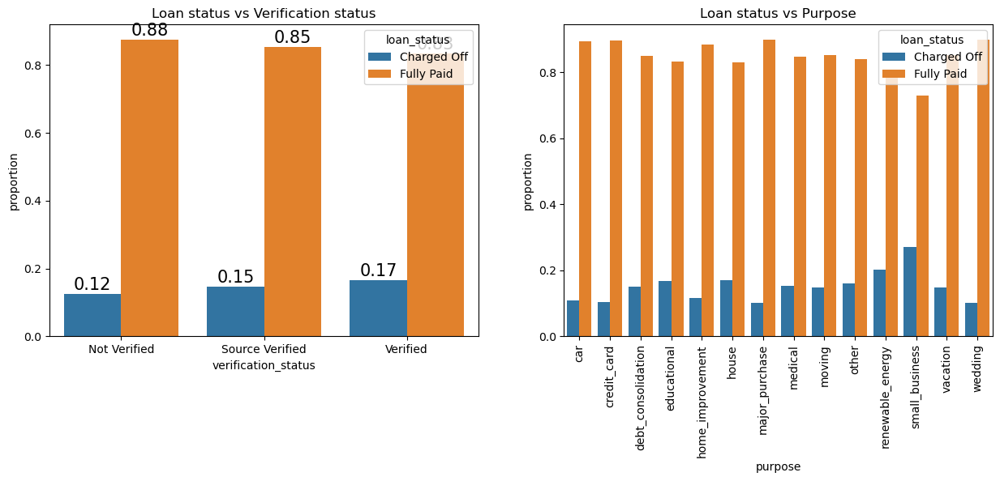

In [133]:
plt_cat_bar(data = imp_loan_data, x1 = 'verification_status' , title1 = 'Verification status', annotate1=True,
                                  x2 = 'purpose', title2 = 'Purpose', x2rotate=90)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Verification status   | We can see more defaulters from verified borrowers than not verified borrowers. But this does not imply that we should stop verification to avoid defaulters. |
| Purpose  | There is a clear difference in the proportion of defaulters. Loan taken for small business have the most defaulters, loan taken for wedding have the least defaulters. |

---

**Loan status vs State**

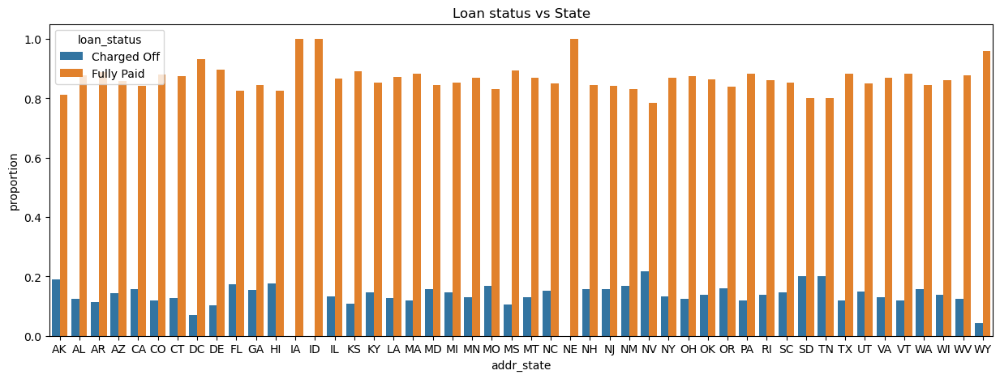

In [134]:
plt_cat_bar(data = imp_loan_data, x1 = 'addr_state' , title1 = 'State')

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| State   | People from NV have more defaulters whereas those from IA,ID and NE have no defaulters. Though there is not a definitive pattern to comment, we can see that the demography has some influence on defaulters. |

---

From segmented univariate analysis, we found the below columns as 'Maybe' impacting defaulters.

| Column | Inference | Impacts defaulters (Yes/No/Maybe) |
|:-------|:----------|:----------------------------|
| Funded amount by investors | The spread of amount is wide for defaulters ranging from around 6000-15000. Higher amount have more defaulters. | Maybe |
| Installment | Defaulters have wide spread of installments. | Maybe |
| Annual Income | Defaulters earn low salary and thay might be reason why they could not pay their loans. | Maybe |
| Debt to Income | As the dti is more, the borrowers find it difficult to pay the loan and become defaulters. | Maybe |
| Total credit line | No significant observation. Very little difference. | Maybe |

Let us take these columnns in categorical perspective and see if it adds any value.

---

#### Funded amount by investors

In [135]:
imp_loan_data.funded_amnt_inv.describe()

count    35780.000000
mean     10334.937754
std       6920.073658
min          0.000000
25%       5000.000000
50%       8975.000000
75%      14075.000000
max      35000.000000
Name: funded_amnt_inv, dtype: float64

In [136]:
# Create bins for funded_amnt_inv
bins = [0, 10000, 15000, 20000, 25000, 36000]
# Create bin labels for funded_amnt_inv
bucket_label = ['0-10000', '10000-15000', '15000-20000', '20000-25000','25000+']
# Derive a new column based on this binning
imp_loan_data['funded_amnt_inv_bins'] = pd.cut(imp_loan_data['funded_amnt_inv'], bins, labels=bucket_label)

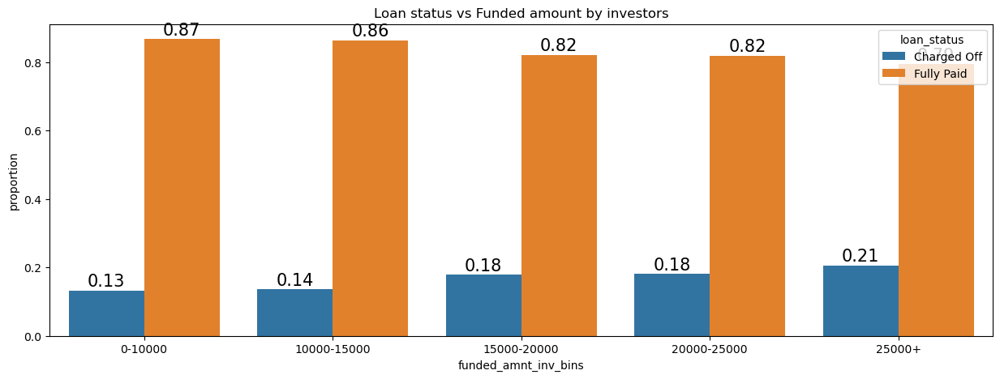

In [137]:
plt_cat_bar(data = imp_loan_data, x1 = 'funded_amnt_inv_bins' , title1 = 'Funded amount by investors', annotate1=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | We can clearly see that as the amount increases, the proportion of defaulters increases. |

---

#### Installment

In [138]:
imp_loan_data.installment.describe()

count    35780.000000
mean       321.277191
std        205.643438
min         16.080000
25%        166.797500
50%        277.935000
75%        423.460000
max       1305.190000
Name: installment, dtype: float64

In [139]:
# Create bins for installment
bins = [0, 300, 600, 900, 1400]
# Create bin labels for installment
bucket_label = ['0-300', '300-600', '600-900', '900+']
# Derive a new column based on this binning
imp_loan_data['installment_bins'] = pd.cut(imp_loan_data['installment'], bins, labels=bucket_label)

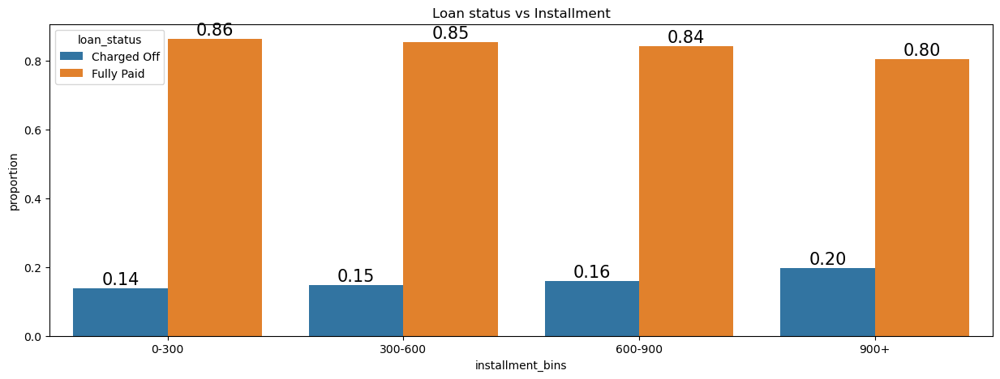

In [140]:
plt_cat_bar(data = imp_loan_data, x1 = 'installment_bins' , title1 = 'Installment', annotate1=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Installment | We can clearly see that as the installment increases, the proportion of defaulters increases. |

---

#### Annual Income

In [141]:
imp_loan_data.annual_inc.describe()

count     35780.000000
mean      65664.085616
std       35004.650944
min        4000.000000
25%       40800.000000
50%       58702.000000
75%       80588.420000
max      235000.000000
Name: annual_inc, dtype: float64

In [142]:
# Create bins for annual income
bins = [0, 25000, 50000, 75000, 100000, 7000000]
# Create bin labels for annual income
bucket_label = ['0-25000', '25000-50000', '50000-75000', '75000-100000', '100000+']
# Derive a new column based on this binning
imp_loan_data['annual_inc_bins'] = pd.cut(imp_loan_data['annual_inc'], bins, labels=bucket_label)

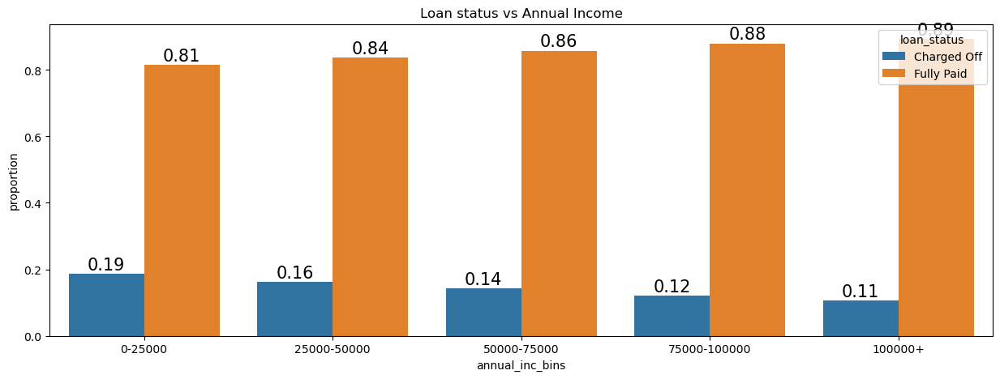

In [143]:
plt_cat_bar(data = imp_loan_data, x1 = 'annual_inc_bins' , title1 = 'Annual Income', annotate1=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Annual Income | We can clearly see that borrowers earning low salary find it difficult to pay the loan and become defaulters. As the income increases, the proportion of defaulters decreases. |

---

#### Debt to Income ratio

In [144]:
imp_loan_data.dti.describe()

count    35780.000000
mean        13.338684
std          6.637025
min          0.000000
25%          8.240000
50%         13.430000
75%         18.570000
max         29.990000
Name: dti, dtype: float64

In [145]:
# Create bins for dti
bins = [-1, 5.00, 10.00, 15.00, 20.00, 25.00, 50.00]
# Create bin labels for dti
bucket_label = ['0-5', '5-10', '10-15', '15-20', '20-25', '25+']
# Derive a new column based on this binning
imp_loan_data['dti_bins'] = pd.cut(imp_loan_data['dti'], bins, labels=bucket_label)

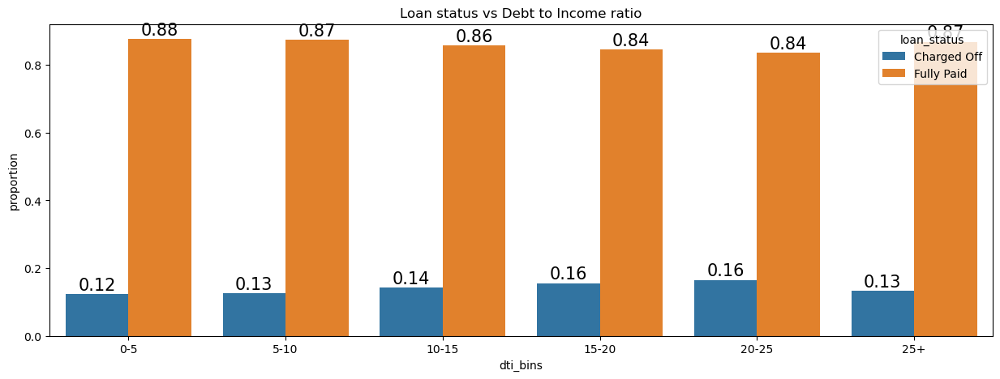

In [146]:
plt_cat_bar(data = imp_loan_data, x1 = 'dti_bins' , title1 = 'Debt to Income ratio', annotate1=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Debt to Income ratio | We can see deviations, but there is no significant pattern to comment as the value dips at higher ratios 25+. Let us keep this column as 'Maybe' as we found already.|

---

#### Total credit lines

In [147]:
imp_loan_data.total_acc.describe()

count    35780.000000
mean        21.500727
std         10.544063
min          2.000000
25%         13.000000
50%         20.000000
75%         28.000000
max         54.000000
Name: total_acc, dtype: float64

In [148]:
# Create bins for total credit lines
bins = [0, 20.00, 40.00, 60.00]
# Create bin labels for total credit lines
bucket_label = ['0-20', '20-40', '40-60']
# Derive a new column based on this binning
imp_loan_data['total_acc_bins'] = pd.cut(imp_loan_data['total_acc'], bins, labels=bucket_label)

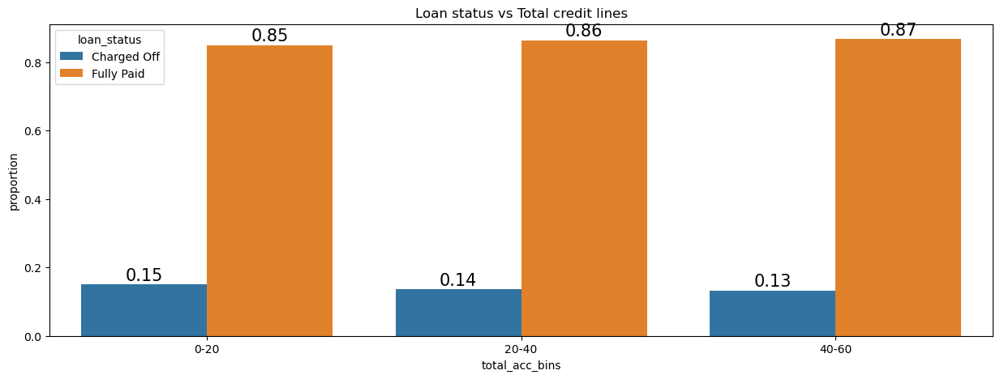

In [149]:
plt_cat_bar(data = imp_loan_data, x1 = 'total_acc_bins' , title1 = 'Total credit lines', annotate1=True)

**Inference**

Below table provides bivariate analysis of **'loan_status'** column against:

| Column | Inference |
|:-------|:----------|
| Total credit lines | From 0-60, the deviation is very little. There is no significant observation.|

---

### Summary of bivariate analysis on categorical vs categorical variable :

Here is a quick snapshot of bivariate of **'loan_status'** against the other columns of interest:
| Column | Inference | Impacts defaulters (Yes/No/Maybe) |
|:-------|:----------|:----------------------------|
| Term   | We can clearly see that long term loan have more defaulters. | Yes |
| Grade  | We can clearly see taht as the grade decreases, the proportion of defaulters increases. | Yes |
| Employment Length   | Though there is a slight variation, it is not significant to make any comment. | No |
| Home Ownership  |  OTHER category has more defaulters, and there is a pattern obserrved. | Yes |
| Verification status   | We can see more defaulters from verified borrowers than not verified borrowers. But this does not imply that we should stop verification to avoid defaulters. | No |
| Purpose  | There is a clear difference in the proportion of defaulters. Loan taken for small business have the most defaulters, loan taken for wedding have the least defaulters. | Yes |
| State   | People from NV have more defaulters whereas those from IA,ID and NE have no defaulters. Though there is not a definitive pattern to comment, we can see that the demography has some influence on defaulters. | Maybe |
| Funded amount by investors | We can clearly see that as the amount increases, the proportion of defaulters increases. | Yes (from Maybe) |
| Installment | We can clearly see that as the installment increases, the proportion of defaulters increases. | Yes (from Maybe) |
| Annual Income | We can clearly see that borrowers earning low salary find it difficult to pay the loan and become defaulters. As the income increases, the proportion of defaulters decreases. | Yes (from Maybe) |
| Debt to Income ratio | We can see deviations, but there is no significant pattern to comment as the value dips at higher ratios 25+. Let us keep this column as 'Maybe' as we found already.| Maybe |
| Total credit lines | From 0-60, the deviation is very little. There is no significant observation.| No (from Maybe) |

Below table gives the meaning of the options.
| Impacts defaulters | Comments |
|:-------------------|:---------|
| Yes | Driver variable. There is a clear difference in the plot. |
| No | Does not have any impact on the defaulters. |
| Maybe | Has the potential to be a driver variable. |

> - **We could clearly see that "term", "grade", "home ownership", "purpose", "funded amount by investors", "installment", "annual income", to have a clear impact on the defaulters**

---
---

## Multivariate analysis

Here we analyse the date with more than 2 axes (2 columns). Since we are interested in understanding defaulters, we will take 'loan_status' as one column and find two other combinations which impact the defaulters.

Based on the above understanding, we will consider the following combinations:
1) 'loan_status' and 2 continuous variable
2) 'loan_status', 1 categorical variable, 1 continuous variable

---

### 'loan_status' and 2 continuous variable

There will be many combinations of continuous variable. But let us focus on those continuous variables which have a good correlation.

Using pairplot, let us have a quick snapshot of the important continuous variable on how it is correlated for defaulters.

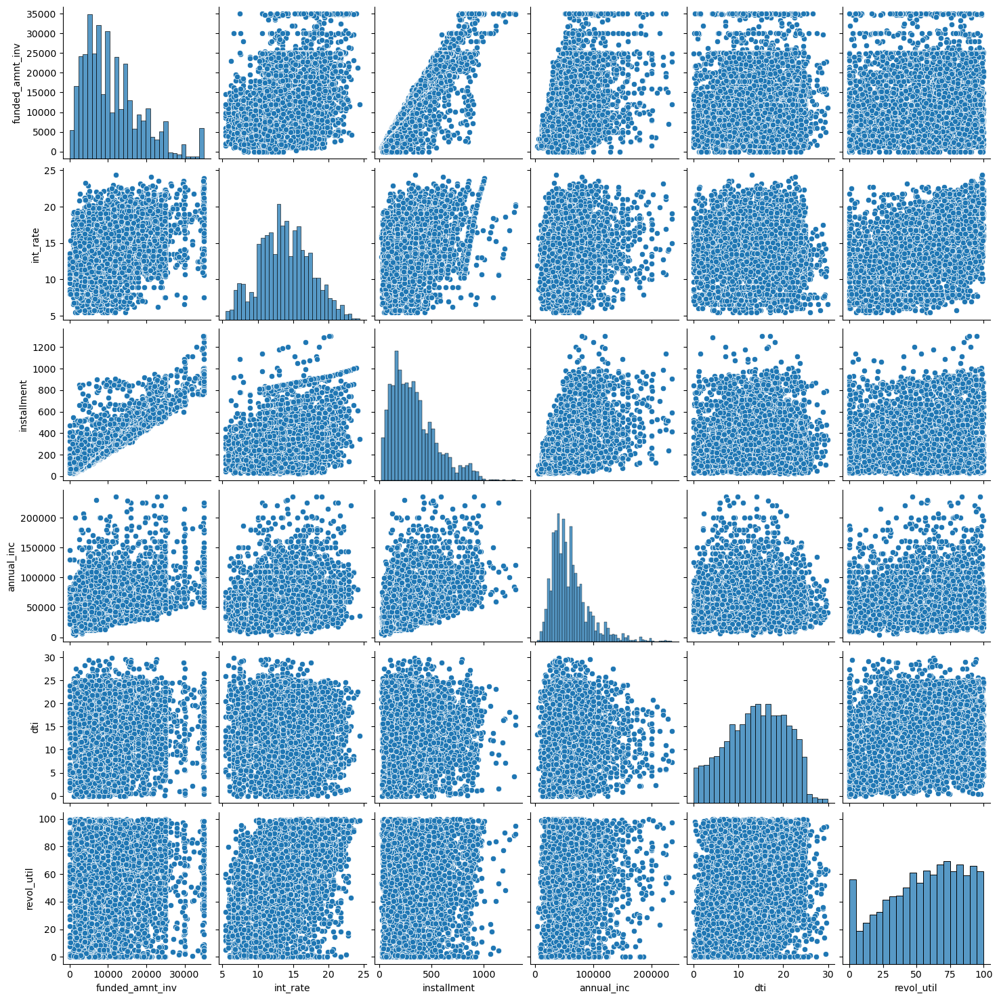

In [150]:
# Listing columns of interest
temp_df = imp_loan_data[['funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti', 'revol_util','loan_status']]
# Calling pairplot which takes does scatter plot between continuous variables for defaulters
sns.pairplot(data=temp_df[temp_df.loan_status == 'Charged Off'])

From the above snapshot, we could see the below pairs have somewhat correlation (spread is less) :
- Funded amount by investors and Installment.
- Funded amount by investors and Interest rate.
- Funded amount by investors and Annual income.
- Interest rate and Revolving utilization rate.
- Interest rate and Annual income.
- Interest rate and Installment.
- Installment and Annual income.
- Debt to Income ratio and Revolving utilization rate.

From bivariate analysis, we found also the below columns to have correlation:
- Total credit lines and Open credit lines.
- Total credit lines and Earliest credit line.
- Public deragatory and Public recorded bankruptcies.

Let us analyse these pairs for better understanding of defaulter pattern.

---

**Plot function**

In [151]:
# As we are doing multivariate analysis between two continuous variables against 'loan_status', 
# let us define common plot functions.

# The below function creates one scatterplot of data in a single plot object
# data   - Input - Dataset which has the values
# x      - Input - x value of first plot
# y      - Input - y value of first plot
def plt_mlt_cont(data='' , x='', y=''):
    # Compute the correlation between the input two columns
    print('Correlation value between \'{0}\' and \'{1}\' is {2}'.format(x,y, data[x].corr(data[y])))
    # Set the plot figure size
    plt.figure(figsize=(15,5))
    # Calling scatter plot with the input columns against 'loan_status'
    sns.scatterplot(x=x, y=y, data=data, hue='loan_status')
    plt.show()

---

#### 1) Funded amount by investors vs Installment

Correlation value between 'funded_amnt_inv' and 'installment' is 0.9238395690055324


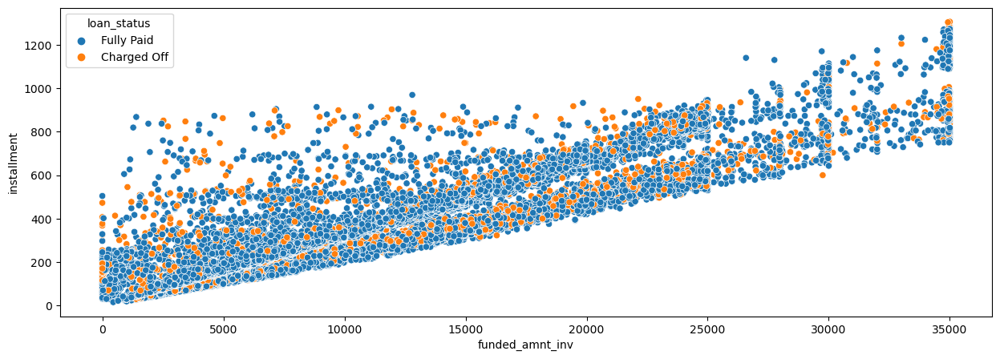

In [152]:
plt_mlt_cont(data=imp_loan_data, x='funded_amnt_inv', y='installment')

**Inference**

- We could see a beautiful pattern emerging here between funded amount by investors and installment.
- At higher loan amounts funded by investors, people have high installments.
- We can see that defaulters are more when installment is more and funded amount is more.
---

#### 2) Funded amount by investors vs Interest rate

Correlation value between 'funded_amnt_inv' and 'int_rate' is 0.2914507341397242


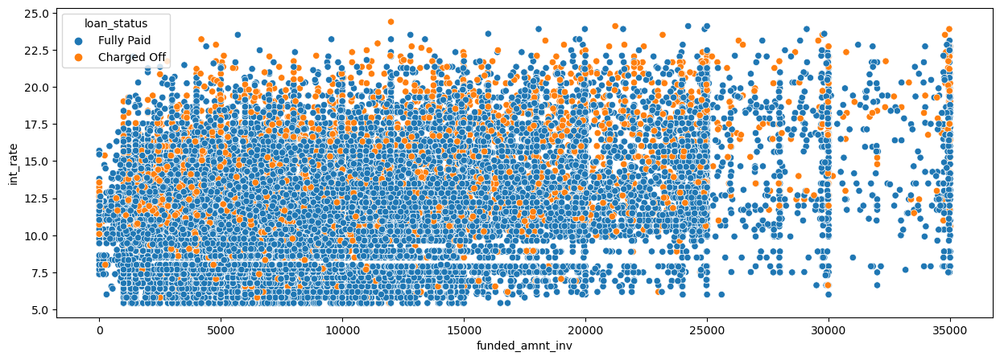

In [153]:
plt_mlt_cont(data=imp_loan_data, x='funded_amnt_inv', y='int_rate')

**Inference**

- No specific pattern observed, values are spread across.

---

#### 3) Funded amount by investors vs Annual income

Correlation value between 'funded_amnt_inv' and 'annual_inc' is 0.3983129912349407


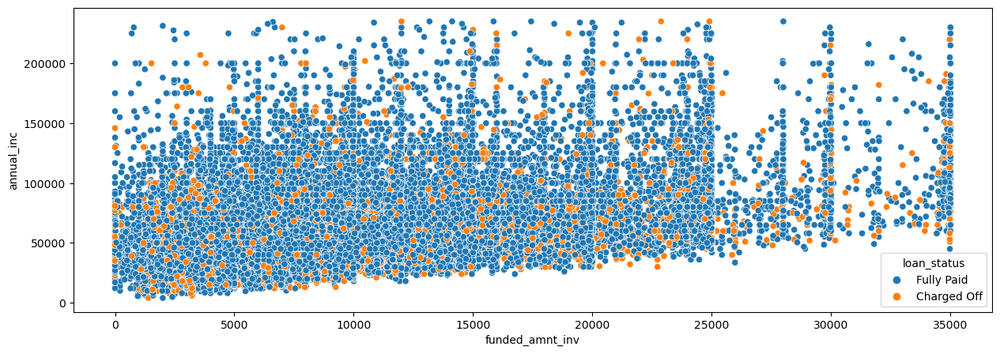

In [154]:
plt_mlt_cont(data=imp_loan_data, x='funded_amnt_inv', y='annual_inc')

**Inference**

- When the annual income is less, irrespective of the amount, there seems to be defaulters.
- When annual income is more, the requested loan amount is more.


---

#### 4) Interest rate vs Revolving Utilization rate

Correlation value between 'int_rate' and 'revol_util' is 0.47140825671625436


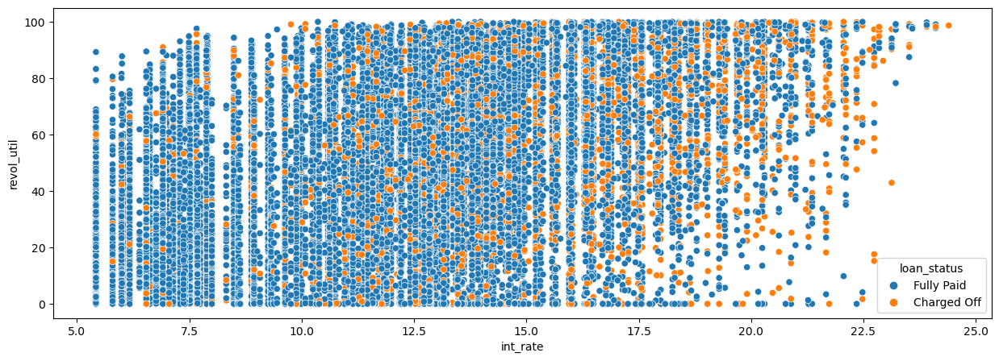

In [155]:
plt_mlt_cont(data=imp_loan_data, x='int_rate', y='revol_util')

**Inference**

- At higher interest rate, borrowers with high revolving utilization rate tend to be defaulters.

---

#### 5) Interest rate vs Annual income

Correlation value between 'int_rate' and 'annual_inc' is 0.05860660631293877


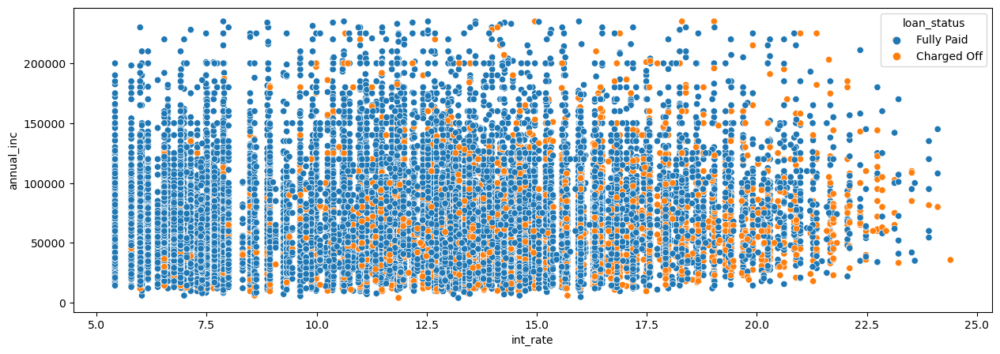

In [156]:
plt_mlt_cont(data=imp_loan_data, x='int_rate', y='annual_inc')

**Inference**

- We can see that when income is less than 100000 and interest rate is more than 15, there seems to be more defaulters.
- When interest rate is more for low salaried people, they tend to default.
---

#### 6) Interest rate vs Installment

Correlation value between 'int_rate' and 'installment' is 0.2716020244606599


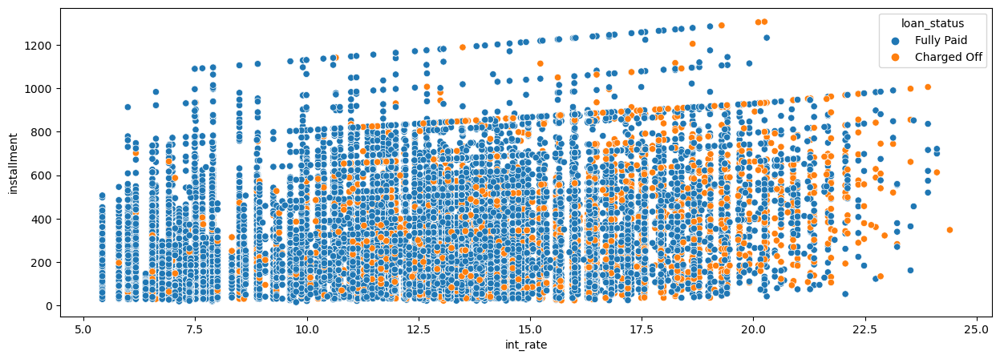

In [157]:
plt_mlt_cont(data=imp_loan_data, x='int_rate', y='installment')

**Inference**

- Irrespective of installment, there are more defaulters at higher interest rate.
---

#### 7) Installment vs Annual income

Correlation value between 'annual_inc' and 'installment' is 0.4125046415194964


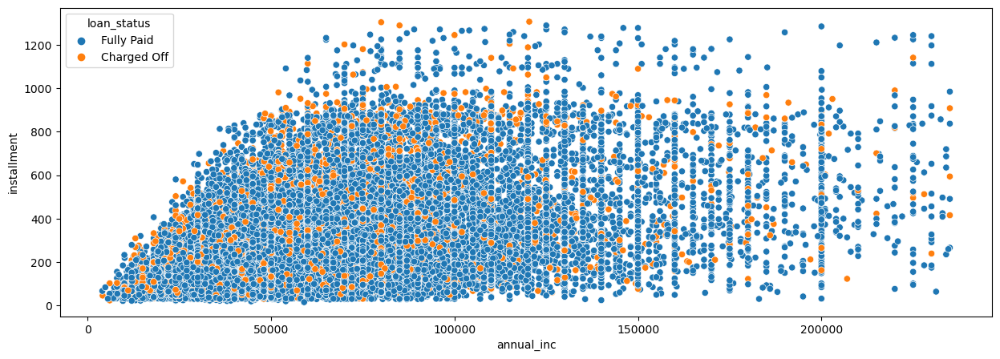

In [158]:
plt_mlt_cont(data=imp_loan_data, x='annual_inc', y='installment')

**Inference**

- Till 100000 annual income, the installment is linearly dependent and so as the defaulters.
---

#### 8) Debt to income ratio vs Revolving utilization rate

Correlation value between 'dti' and 'revol_util' is 0.28066068364682456


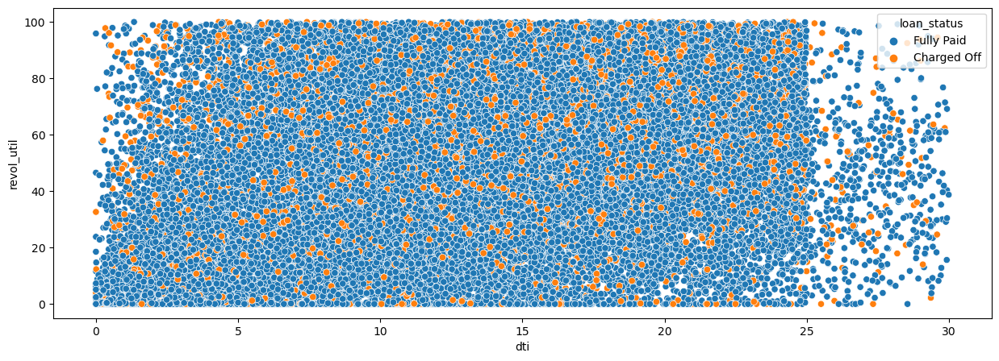

In [159]:
plt_mlt_cont(data=imp_loan_data, x='dti', y='revol_util')

**Inference**

- No specific pattern observed, values are spread across.
---

#### 9) Total credit lines vs Open credit lines

Correlation value between 'total_acc' and 'open_acc' is 0.6622417975698172


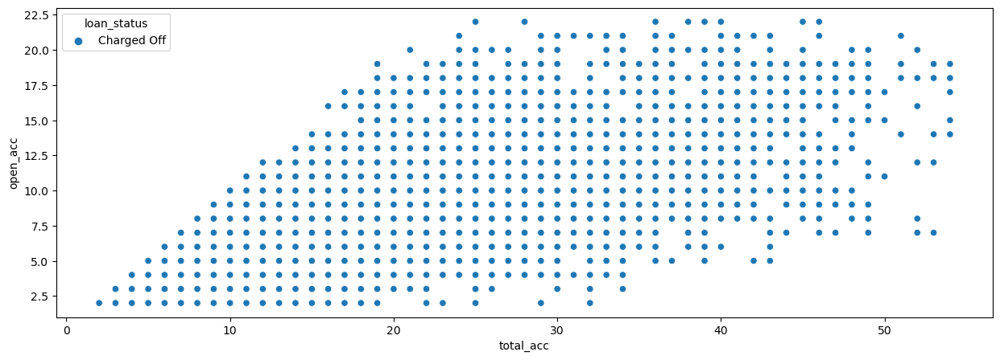

In [160]:
# Let us look only into defaulters pattern
plt_mlt_cont(data=loan_data[loan_data.loan_status =='Charged Off'], x='total_acc', y='open_acc')

**Inference**

- Though these values individually do not impact the defaulters, it looks like these two are positively correlated on defaulters.
- As the open credit lines and total credit lines are high, they tend to default.
---

#### 10) Total credit lines vs Earliest credit line year

Correlation value between 'total_acc' and 'earliest_cr_line_year' is -0.37982970306765096


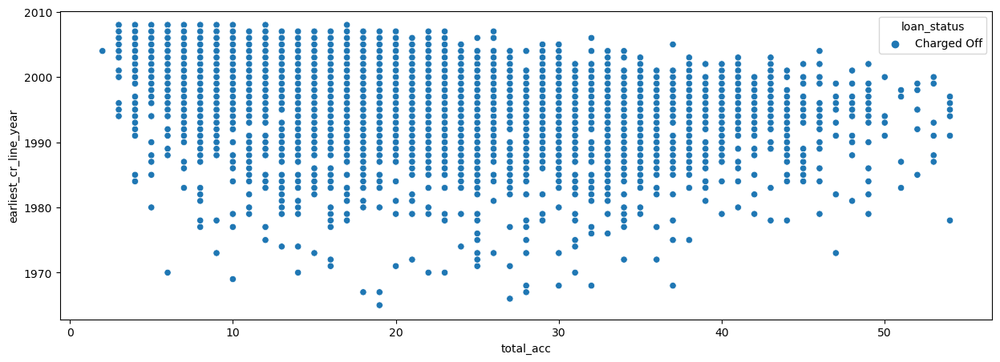

In [161]:
# Let us look only into defaulters pattern
plt_mlt_cont(data=loan_data[loan_data.loan_status =='Charged Off'], x='total_acc', y='earliest_cr_line_year')

**Inference**

- Though these values individually do not impact the defaulters, it looks like these two are negatively correlated on defaulters.
- People having less total credit lines in recent years from 2000 tend to be defaulters.
---

#### 11) Public deragatory vs Public record bankruptcies

Correlation value between 'pub_rec' and 'pub_rec_bankruptcies' is 0.8541472931633239


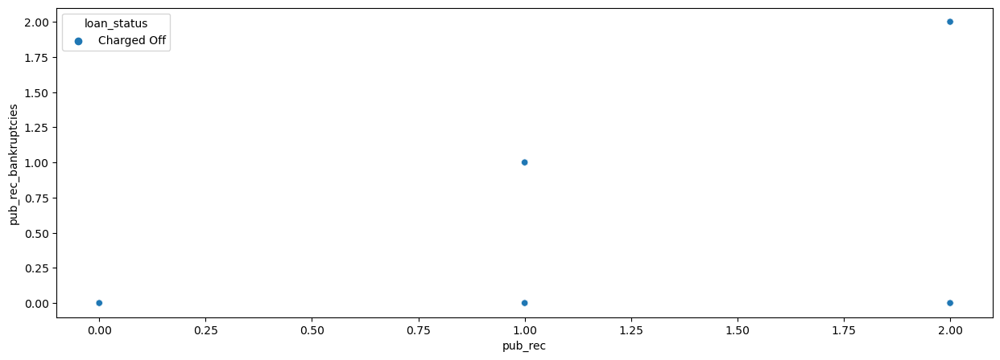

In [162]:
# Let us look only into defaulters pattern
plt_mlt_cont(data=loan_data[loan_data.loan_status =='Charged Off'], x='pub_rec', y='pub_rec_bankruptcies')

**Inference**

- Though these values individually do not impact the defaulters, it looks like these two are positively correlated on defaulters.
- Borrowers with more derogatory tend to bankrupt who in turn tend to be defaulters.
---
---

### 'loan_status', 1 categorical variable, 1 continuous variable

**Plot function**

In [163]:
# As we are doing multivariate analysis, let us define common plot functions.

# The below function creates one/two box plots of data in a single plot object
# data   - Input - Dataset which has the values
# title1 - Input - Title of the first plot
# x1     - Input - x value of first plot
# y1     - Input - y value of first plot
# hue1   - Input - hue value of first plot, default loan_status
# x1rotate - Input - rotate xticks of first plot
# title2 - Input - Title of the second plot
# x2     - Input - x value of second plot
# y2     - Input - y value of second plot
# hue2   - Input - hue value of second plot, default loan_status
# x2rotate - Input - rotate xticks of second plot
# Note : If we set x2 as empty, the function will not plot second plot
def plt_mlt_cat_cont(data="", title1="", x1="", y1="", hue1='loan_status', x1rotate=0, 
                              title2="", x2="", y2="", hue2='loan_status', x2rotate=0):    
    # If second plot data is empty, then do a single plot
    if x2 == "":
        # Set the figure size to a standard so that it will be easy for viewing
        plt.figure(figsize=(15,5))
        # Set title
        plt.title(title1)
        # Rotate x ticks
        plt.xticks(rotation=x1rotate)
        # Calling box plot with sorting the xticks in asecding order
        sns.boxplot(x=x1, y=y1, data=data, order=sorted(data[x1].unique()), hue=hue1)
    else:
        # Set the figure size to a standard so that it will be easy for viewing
        plt.figure(figsize=(15,5))
        # Set the subplot index
        plt.subplot(1,2,1)
        # Set title
        plt.title(title1)
        # Rotate x ticks
        plt.xticks(rotation=x1rotate)
        # Calling box plot with sorting the xticks in asecding order
        sns.boxplot(x=x1, y=y1, data=data, order=sorted(data[x1].unique()), hue=hue1)
        # Set the subplot index
        plt.subplot(1,2,2)
        # Set title
        plt.title(title2)
        # Rotate x ticks
        plt.xticks(rotation=x2rotate)
        # Calling box plot with sorting the xticks in asecding order
        sns.boxplot(x=x2, y=y2, data=data, order=sorted(data[x2].unique()), hue=hue2)
    plt.show()

**Template function**

In [164]:
# Plots graphs two in a row
# data  - Input - Dataframe which holds the data to analyze
# col   - Input - Column to be bivariate analyzed
# title - Input - Title of the plot
# xrotate - Input - x ticks rotation angle
def plt_biv_cat_cont(data='', col='', title='', xrotate=0):
    plt_mlt_cat_cont(data, 
                     title1 = "Funded amount by investors vs "+title,
                     x1     =  col,
                     y1     = 'funded_amnt_inv',
                     x1rotate = xrotate,
                     title2 = "Interest rate vs "+title,
                     x2     =  col,
                     y2     = 'int_rate',
                     x2rotate = xrotate)
    plt_mlt_cat_cont(data, 
                     title1 = "Installment vs "+title,
                     x1     =  col,
                     y1     = 'installment',
                     x1rotate = xrotate,
                     title2 = "Annual income vs "+title,
                     x2     =  col,
                     y2     = 'annual_inc',
                     x2rotate = xrotate)
    plt_mlt_cat_cont(data, 
                     title1 = "Debt to Income ratio vs "+title,
                     x1     =  col,
                     y1     = 'dti',
                     x1rotate = xrotate,
                     title2 = "Revolving util rate vs "+title,
                     x2     =  col,
                     y2     = 'revol_util',
                     x2rotate = xrotate)

# Plots graphs one in a row
# data  - Input - Dataframe which holds the data to analyze
# col   - Input - Column to be bivariate analyzed
# title - Input - Title of the plot
# xrotate - Input - x ticks rotation angle
def plt_biv_cat_cont_onebyone(data='', col='', title='', xrotate=0):
    plt_mlt_cat_cont(data, 
                     title1 = "Funded amount by investors vs "+title,
                     x1     =  col,
                     y1     = 'funded_amnt_inv',
                     x1rotate = xrotate)
    plt_mlt_cat_cont(data,
                     title1 = "Interest rate vs "+title,
                     x1     =  col,
                     y1     = 'int_rate',
                     x1rotate = xrotate)
    plt_mlt_cat_cont(data, 
                     title1 = "Installment vs "+title,
                     x1     =  col,
                     y1     = 'installment',
                     x1rotate = xrotate)
    plt_mlt_cat_cont(data,                 
                     title1 = "Annual income vs "+title,
                     x1     =  col,
                     y1     = 'annual_inc',
                     x1rotate = xrotate)
    plt_mlt_cat_cont(data, 
                     title1 = "Debt to Income ratio vs "+title,
                     x1     =  col,
                     y1     = 'dti',
                     x1rotate = xrotate)
    plt_mlt_cat_cont(data,
                     title1 = "Revolving util rate vs "+title,
                     x1     =  col,
                     y1     = 'revol_util',
                     x1rotate = xrotate)

---

#### 1) Term

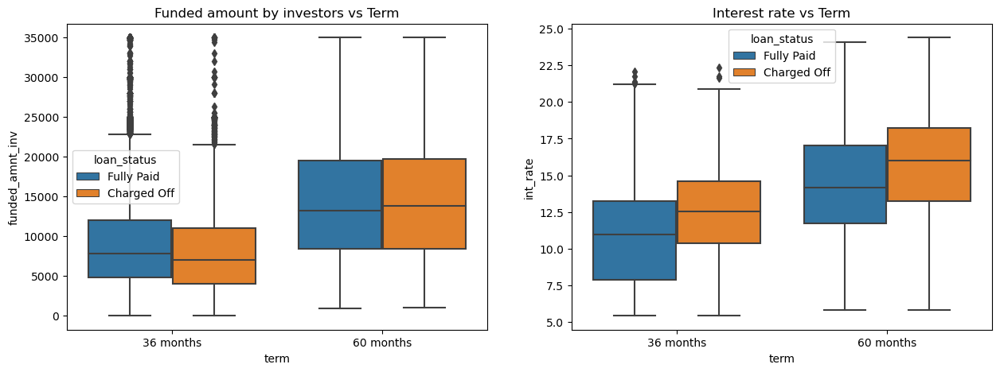

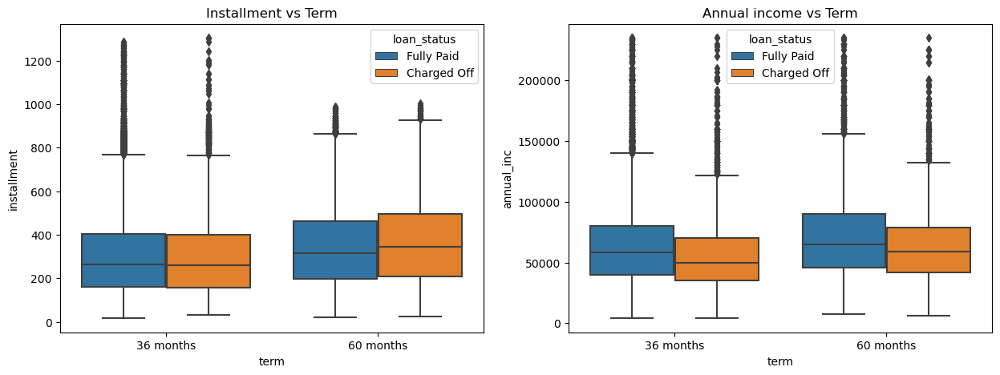

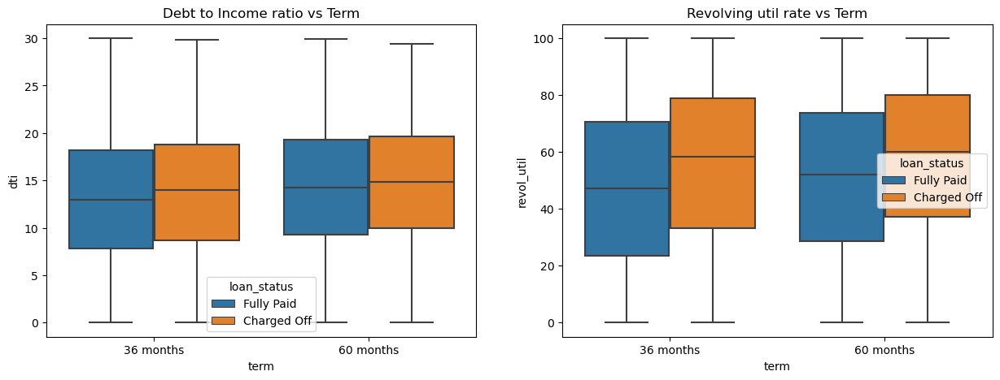

In [165]:
plt_biv_cat_cont(data= imp_loan_data, col= 'term', title= 'Term')

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**term**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | No specific observation. |
| Interest rate | Irrespective of term, whenever the interest rate is high, the defaulters are more. |
| Installment | In 60 months loan term, there is a little more defaulters at higher installments.|
| Annual income | Irrespective of term, people with less salary tend to be defaulters. |
| Debt to Income ratio | Irrespective of term, there is a little more defaulters at higher dti. |
| Revolving utilization rate | Irrespective of term, people with higher revolving utilization rate tend to be defaulters. |

---

#### 2) Grade

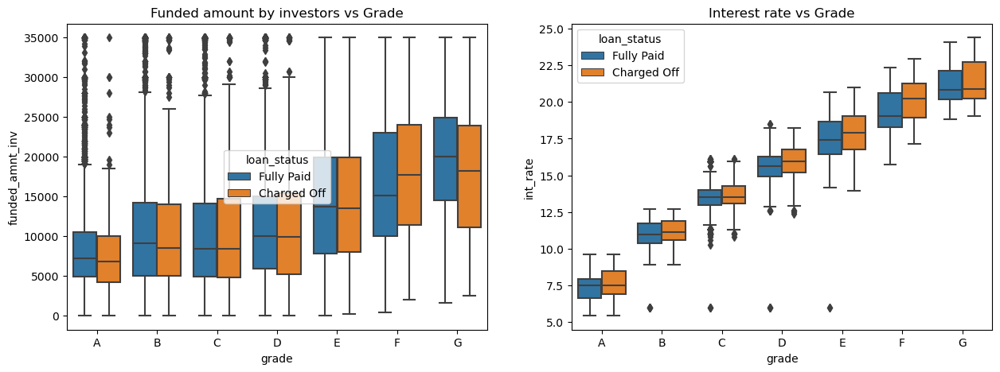

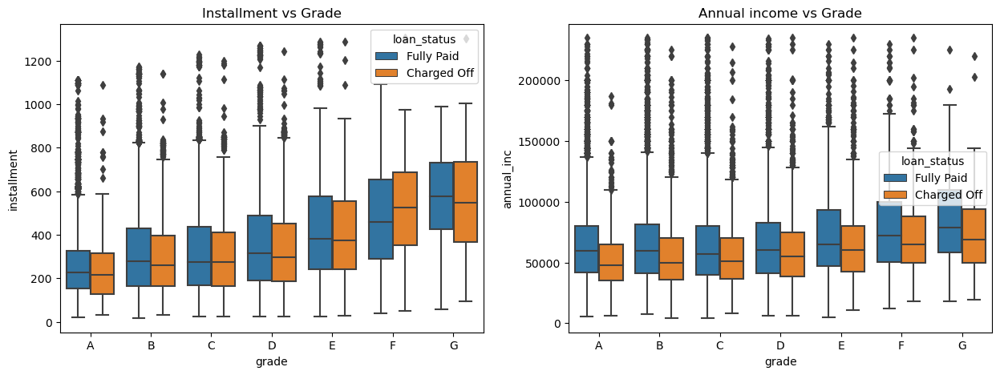

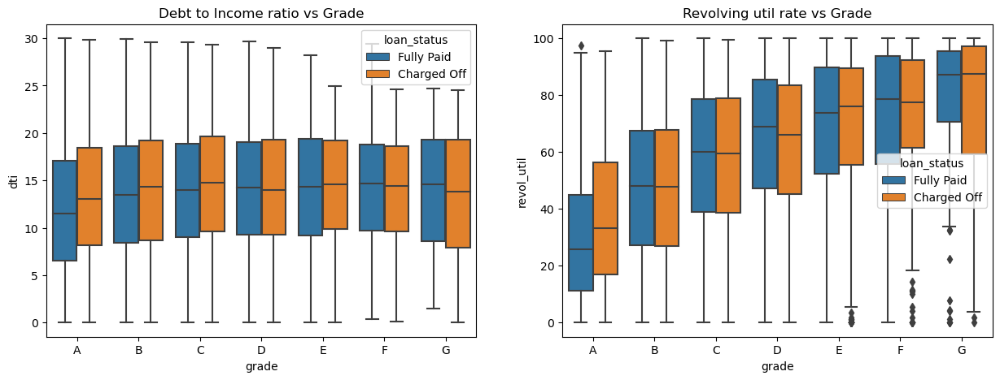

In [166]:
plt_biv_cat_cont(data= imp_loan_data, col= 'grade', title= 'Grade')

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**grade**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | For lowest grade G, people taking higher loan amounts tend to be defaulters. |
| Interest rate | Irrespective of grades, when interest rate is high, defaulters are more. |
| Installment | Except F, all the other grades tend to have less defaulters at lower installments. |
| Annual income | Irrespective of grades, people with less salary tend to be defaulters. |
| Debt to Income ratio | No significant observation. |
| Revolving utilization rate | For lowest grade G, there are more defaulters when utilization rate is around 60+. For highest grade, there are more defaulters when utilization rate is around 20+. |

---

#### 3) Home ownership

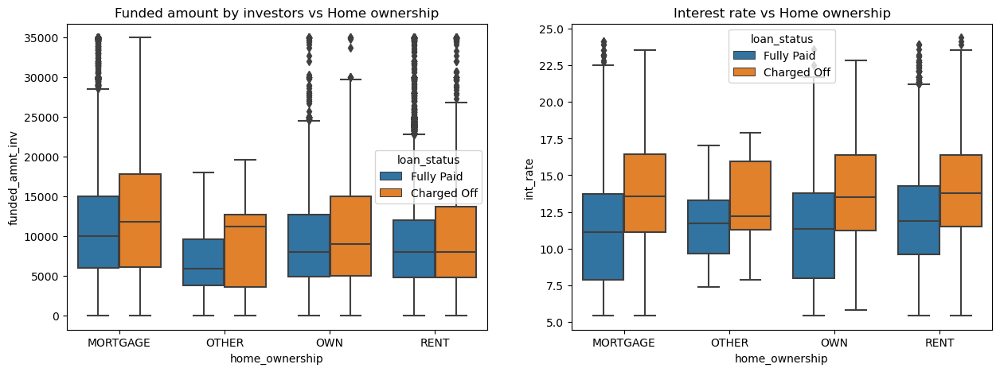

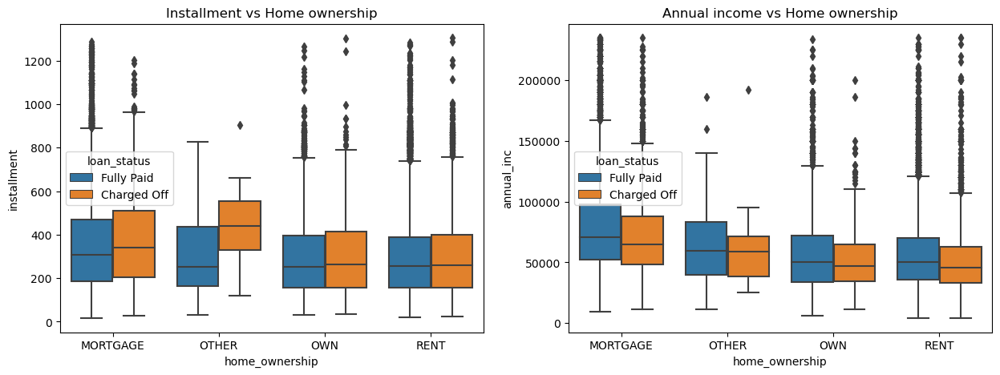

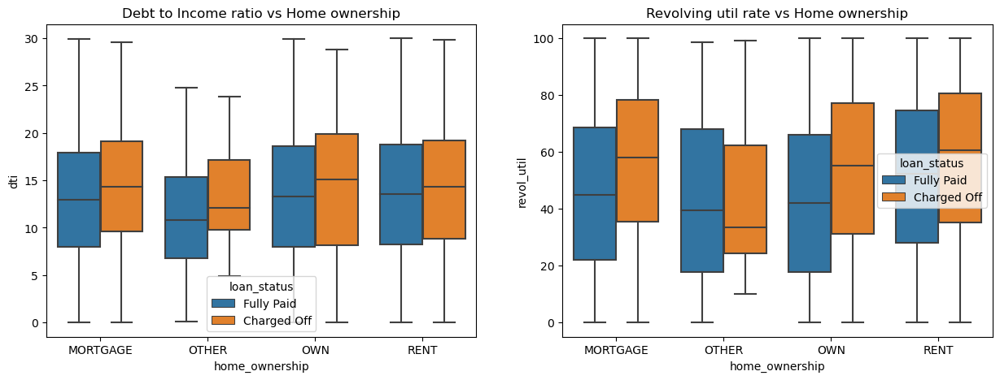

In [167]:
plt_biv_cat_cont(data= imp_loan_data, col= 'home_ownership', title= 'Home ownership')

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**home_ownership**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | Irrespective of ownership, at higher loan amounts, there is a little more defaulters. |
| Interest rate | Irrespective of ownership, at higher interest rates, there are more defaulters. |
| Installment | People with OTHER ownership, at higher installments, there are more defaulters. |
| Annual income | Irrespective of ownership, people with less salary tend to be defaulters. |
| Debt to Income ratio | People with MORTGAGE and OTHER ownership, at higher dti, there is a little more defaulters. |
| Revolving utilization rate | Irrespective of ownership, at higher revolving utilization rates, there are more defaulters. |

---

#### 4) Employment length

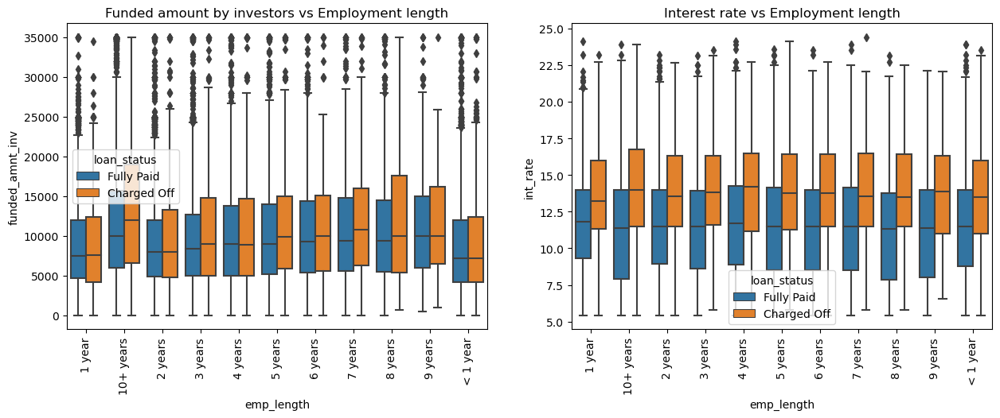

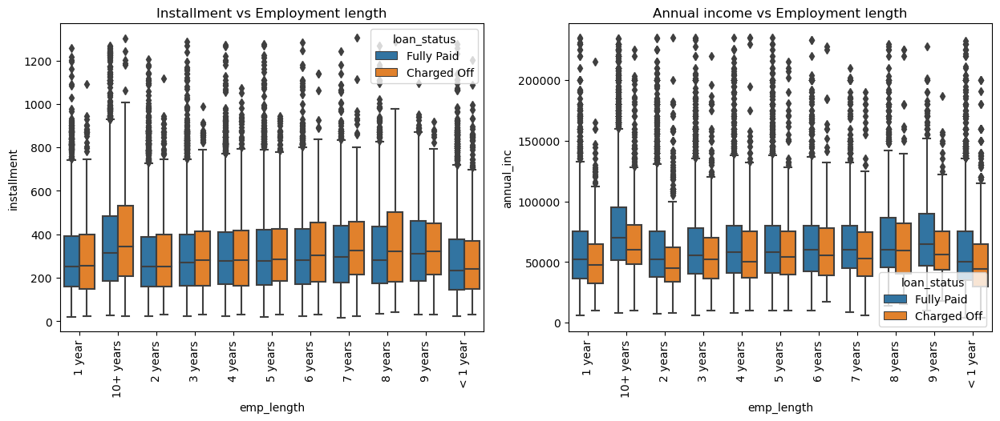

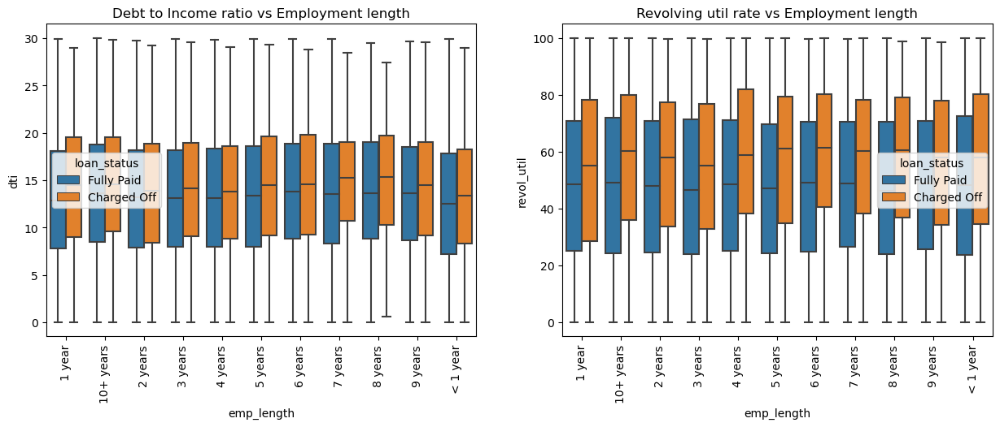

In [168]:
plt_biv_cat_cont(data= imp_loan_data, col= 'emp_length', title= 'Employment length', xrotate=90)

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**emp_length**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | As the experience increases, as the loan amount increases, there is a little increase in defaulters. |
| Interest rate | Irrespective of experience, at higher interest rates, there are more defaulters. |
| Installment | No significant observation. |
| Annual income | Irrespective of experience, people with less salary tend to be defaulters. |
| Debt to Income ratio | No significant observation. |
| Revolving utilization rate | Irrespective of experience, at higher revolving utilization rates, there are more defaulters. |

---

#### 5) Verification status

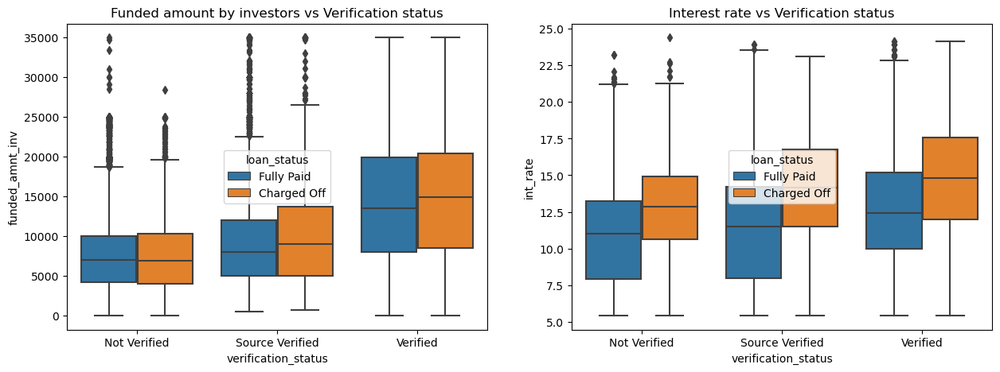

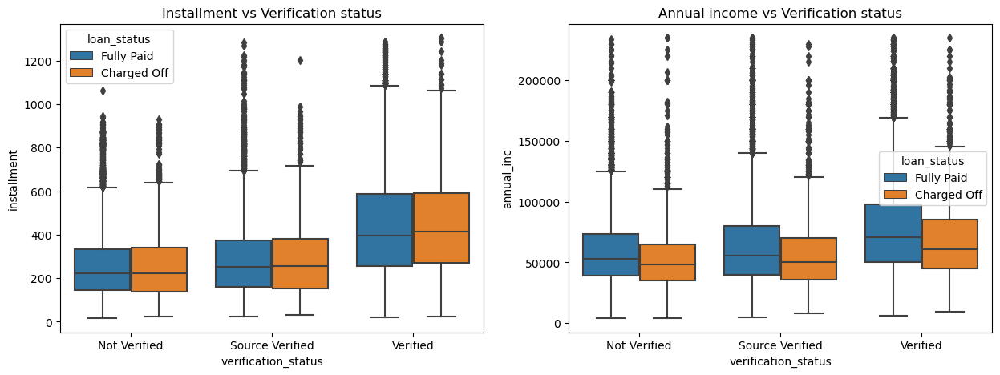

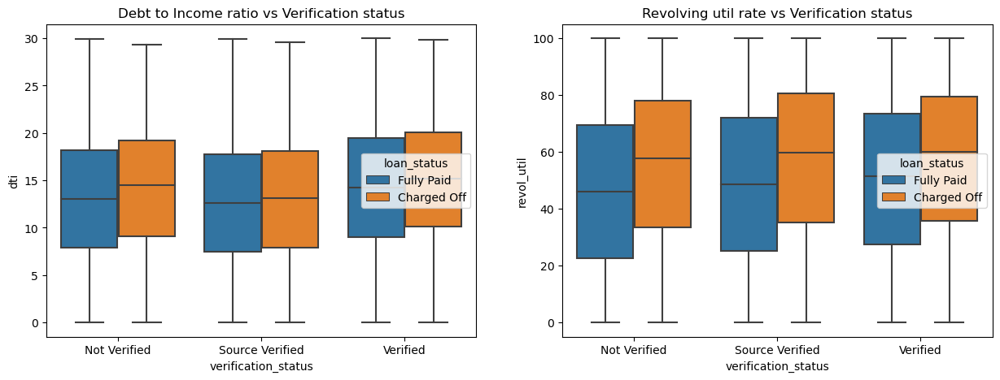

In [169]:
plt_biv_cat_cont(data= imp_loan_data, col= 'verification_status', title= 'Verification status')

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**verification_status**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | No significant observation. |
| Interest rate | Irrespective of verification status, at higher interest rates, there are more defaulters. |
| Installment | No significant observation. |
| Annual income | Irrespective of verification status, people with less salary tend to be defaulters. |
| Debt to Income ratio | No significant observation. |
| Revolving utilization rate | Irrespective of verification status, at higher revolving utilization rates, there are more defaulters. |

---

#### 6) Purpose

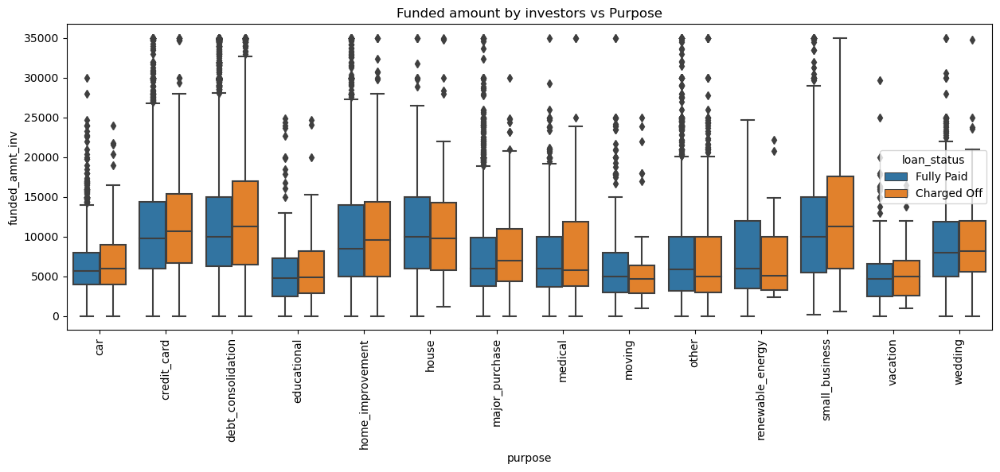

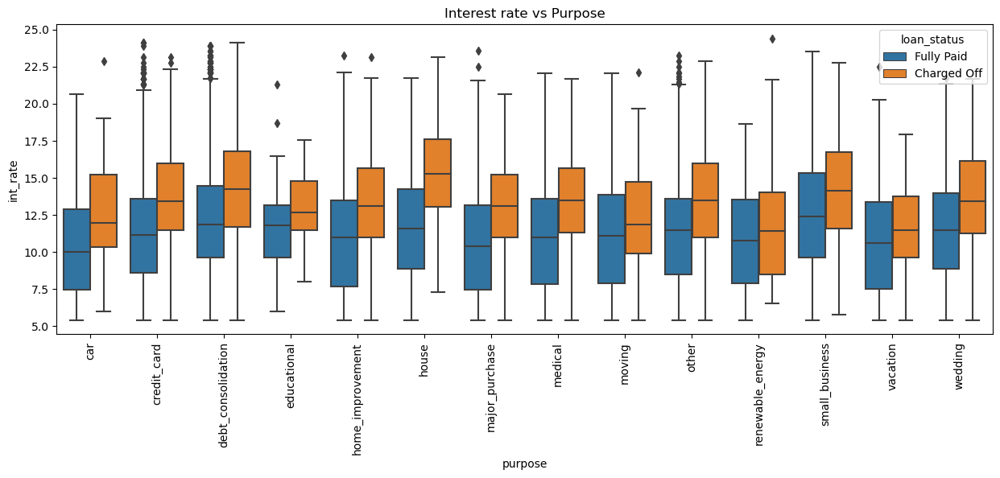

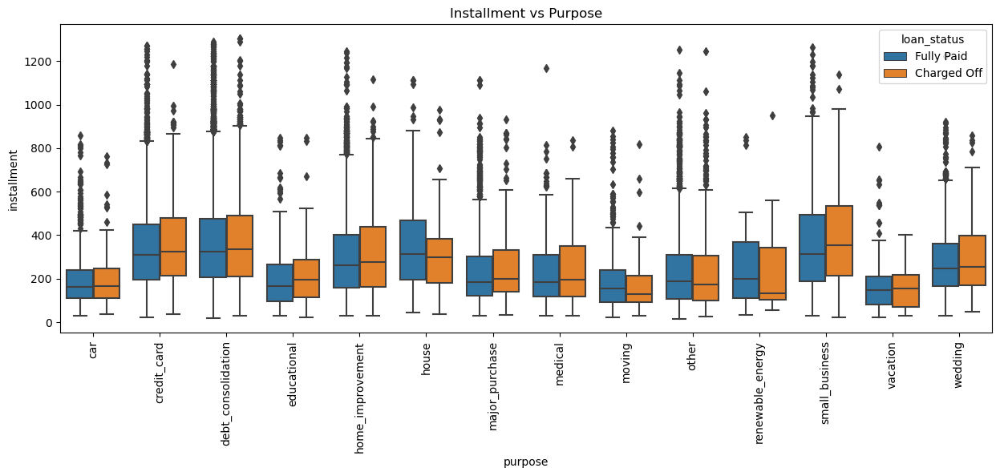

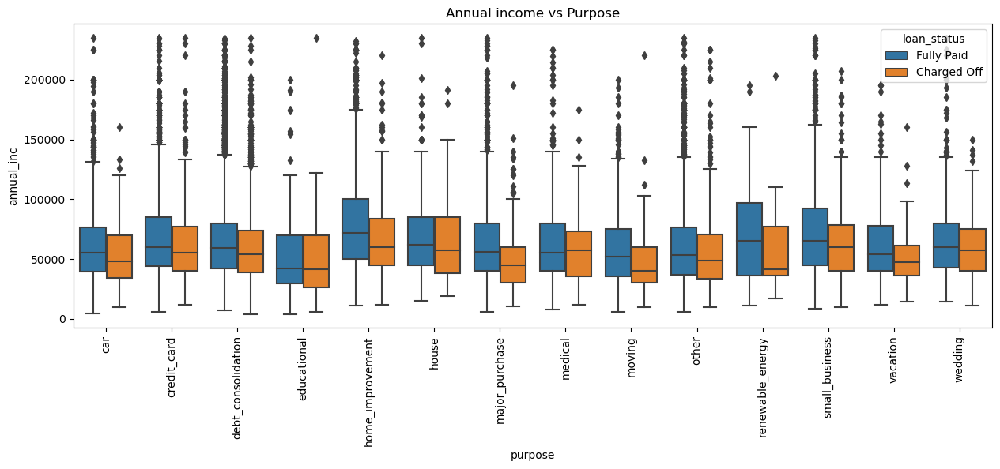

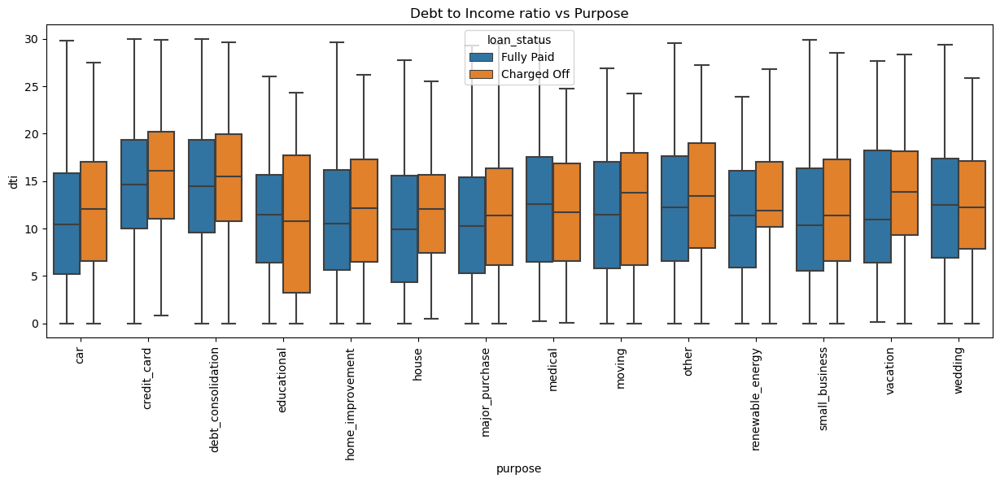

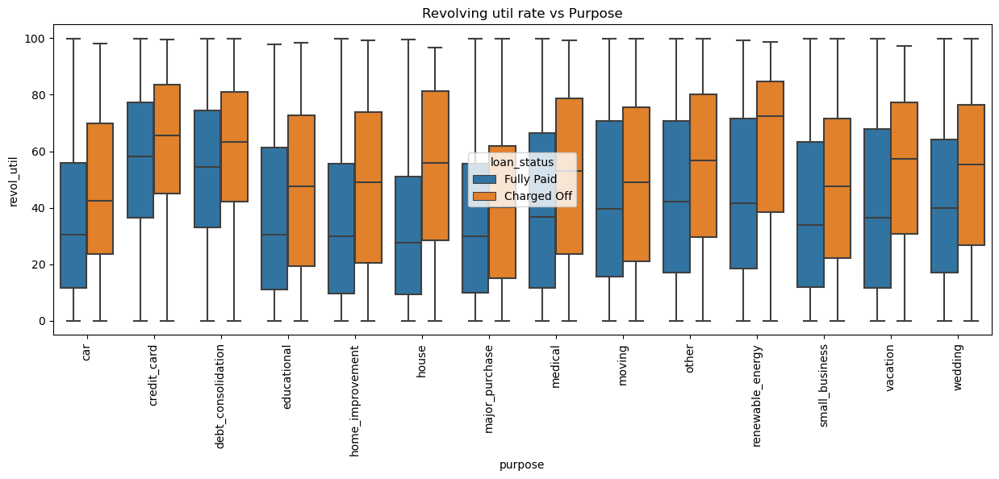

In [170]:
plt_biv_cat_cont_onebyone(data= imp_loan_data, col= 'purpose', title= 'Purpose', xrotate=90)

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**purpose**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | When high loan amount is funded for credit_card, debt_consolidation and small_business purpose, there tend to be defaulters. |
| Interest rate | Irrespective of purpose, at higher interest rates, there are more defaulters. |
| Installment | No significant observation. |
| Annual income | Irrespective of purpose, people with less salary tend to be defaulters. |
| Debt to Income ratio | No significant observation. |
| Revolving utilization rate | Irrespective of purpose, at higher revolving utilization rates, there are more defaulters. |

---

#### 7) Address state

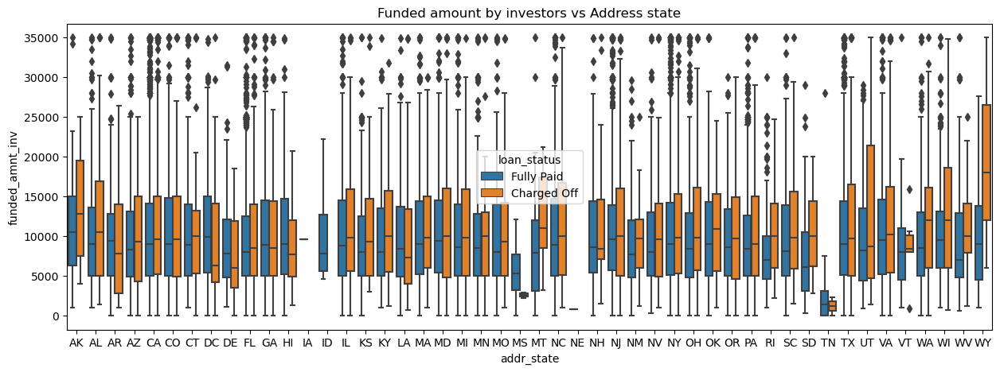

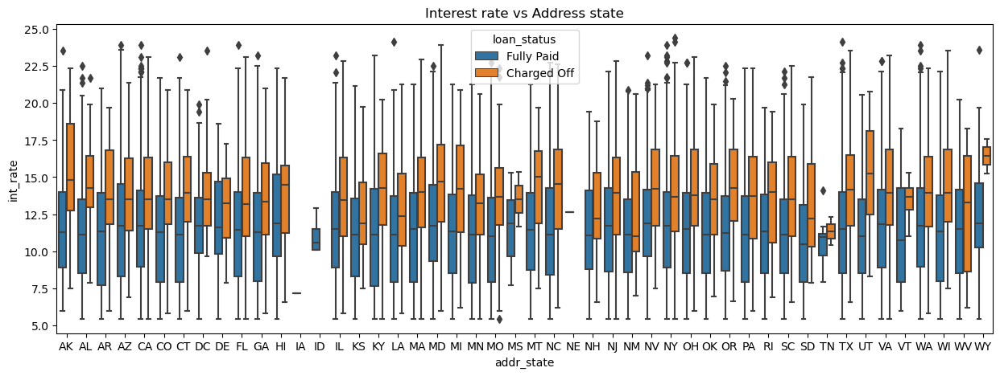

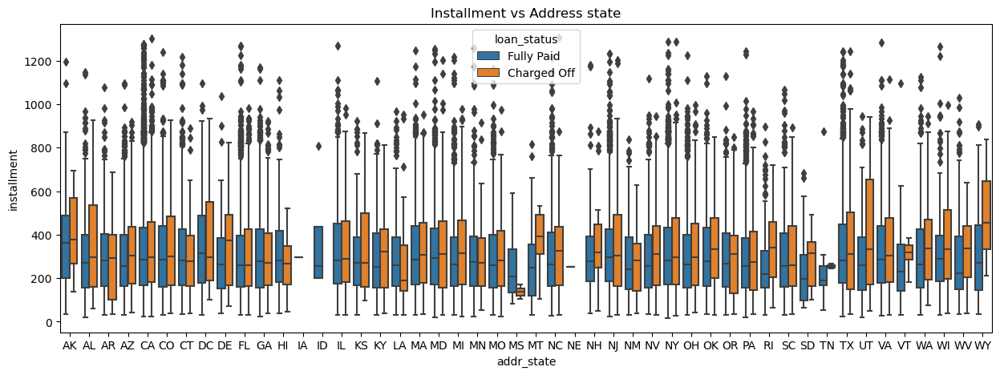

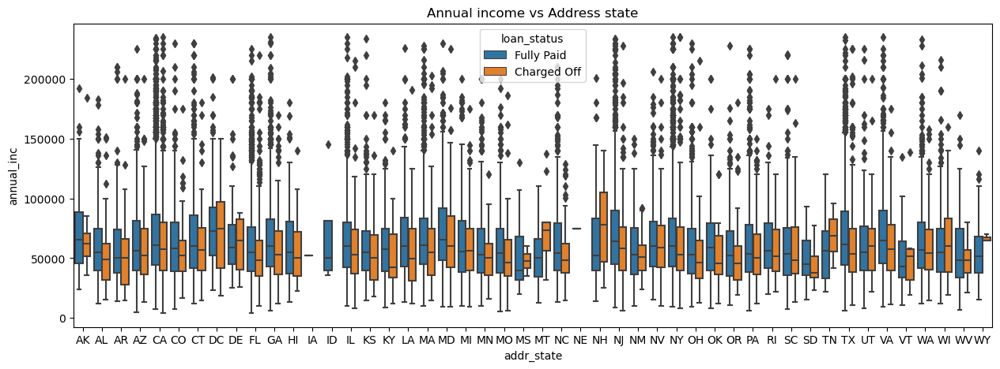

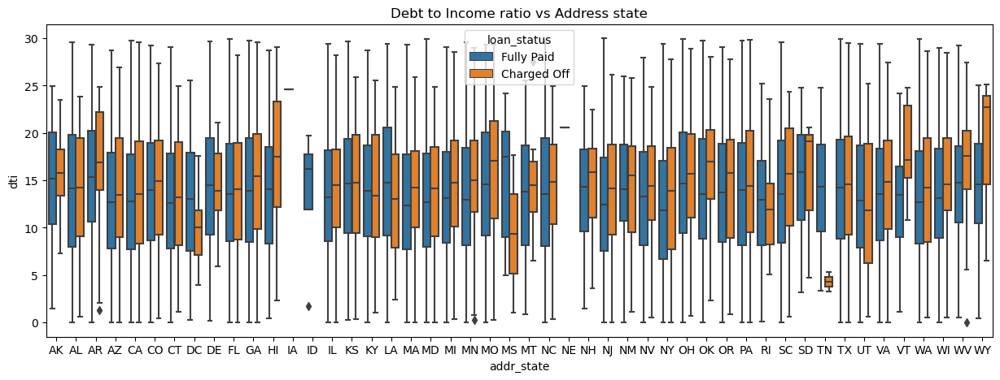

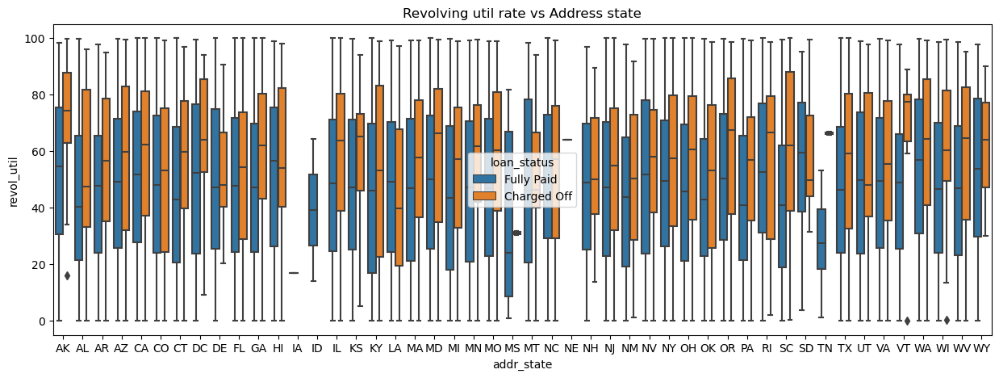

In [171]:
plt_biv_cat_cont_onebyone(data= imp_loan_data, col= 'addr_state', title= 'Address state')

**Inference**

Below table provides multivariate analysis of **'loan_status'** and '**addr_state**' columns against:

| Column | Inference |
|:-------|:----------|
| Funded amount by investors | No significant observation. |
| Interest rate | Irrespective of state, at higher interest rates, there are more defaulters. |
| Installment | No siginificant observation. |
| Annual income | Irrespective of state, people with less salary tend to be defaulters. |
| Debt to Income ratio | No significant observation. |
| Revolving utilization rate | Irrespective of state, at higher revolving utilization rates, there are more defaulters. |

---

### Summary of multivariate analysis :

Here is a quick snapshot of multivariate analysis of **'loan_status'** against the other columns of interest:

We can see that few columns are showing **strong** impact (though we have found few before itself) of defaulters irrespective of other columns:
- Interest rate. (High rate, more defaulters)
- Annual Income. (Low income, more defaulters)
- Revolving Utilization rate. (High rate, more defaulters)

_Below are few more observations:_
| Column | Inference | Impacts defaulters (Yes/No/Maybe) |
|:-------|:----------|:----------------------------|
| Funded amount by investors vs Installment | At higher loan amounts funded by investors, people have high installments. | No |
| Interest rate vs Annual income | We can see that when income is less than 100000 and interest rate is more than 15, there seems to be more defaulters. | Yes |
| Installment vs Annual income | Till 100000 annual income, the installment is linearly dependent and so as the defaulters. | Maybe |
| Total credit lines vs Open credit lines | Though these values individually do not impact the defaulters, it looks like these two are positively correlated on defaulters. | Maybe |
| Total credit lines vs Earliest credit line year | People having less total credit lines in recent years tend to be defaulters. | Yes |
| Public deragatory vs Public record bankruptcies | Though these values individually do not impact the defaulters, it looks like these two are positively correlated on defaulters.| Yes |
| Term vs Installment | In 60 months loan term, there is a little more defaulters at higher installments.| Maybe |
| Term vs Debt to Income ratio | Irrespective of term, there is a little more defaulters at higher dti.| Maybe |
| Grade vs Funded amount by investors | For lowest grade G, people taking higher loan amounts tend to be defaulters. | Yes |
| Grade vs Installment | Except F, all the other grades tend to have less defaulters at lower installments. | No |
| Grade vs Revolving utilization rate | For lowest grade G, there are more defaulters when utilization rate is around 60+. For highest grade, there are more defaulters when utilization rate is around 20+. | Yes |
| Home Ownership vs Installment | People with OTHER ownership, at higher installments, there are more defaulters. | Yes |
| Home Ownership vs Debt to Income ratio | People with MORTGAGE and OTHER ownership, at higher dti, there is a little more defaulters. | Yes |
| Employment length vs Funded amount by investors | As the experience increases, as the loan amount increases, there is a little increase in defaulters. | Maybe |
| Purpose vs Funded amount by investors | When high loan amount is funded for credit_card, debt_consolidation and small_business purpose, there tend to be defaulters. | Yes |

---
---

## Conclusion:

- The summary of this analysis can be found in the [ppt].
- The important loan dataset is stored in ['imp_loan_data.csv'] for quick reference.

In [172]:
# Write important loan data into csv
imp_loan_data.to_csv('imp_loan_data.csv', index=False)

---
---

### Rough work:

Ignore below cells, it is just for rough work.

In [173]:
imp_loan_data.dtypes

id                                int64
funded_amnt_inv                 float64
term                             object
int_rate                        float64
installment                     float64
grade                            object
emp_length                       object
home_ownership                   object
annual_inc                      float64
verification_status              object
issue_d                  datetime64[ns]
loan_status                      object
purpose                          object
addr_state                       object
dti                             float64
earliest_cr_line         datetime64[ns]
revol_util                      float64
total_acc                         int64
issue_d_year                      int64
earliest_cr_line_year             int64
funded_amnt_inv_bins           category
installment_bins               category
annual_inc_bins                category
dti_bins                       category
total_acc_bins                 category


In [174]:
loan_data.dtypes

id                                 int64
loan_amnt                          int64
funded_amnt                        int64
funded_amnt_inv                  float64
term                              object
int_rate                         float64
installment                      float64
grade                             object
sub_grade                         object
emp_length                        object
home_ownership                    object
annual_inc                       float64
verification_status               object
issue_d                   datetime64[ns]
loan_status                       object
purpose                           object
title                             object
zip_code                          object
addr_state                        object
dti                              float64
delinq_2yrs                        int64
earliest_cr_line          datetime64[ns]
inq_last_6mths                     int64
open_acc                           int64
pub_rec         

C:\Users\sea\AppData\Local\Temp\ipykernel_8664\932405236.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = temp_df[temp_df.loan_status == 'Charged Off'].corr()
C:\Users\sea\AppData\Local\Temp\ipykernel_8664\932405236.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(temp_df.corr(), annot=True)


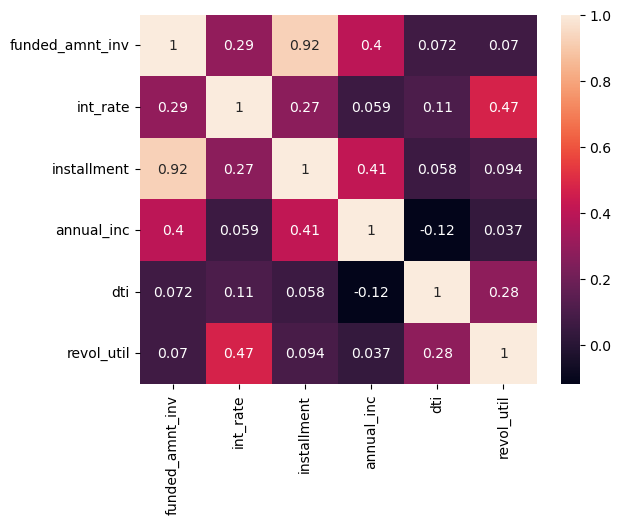

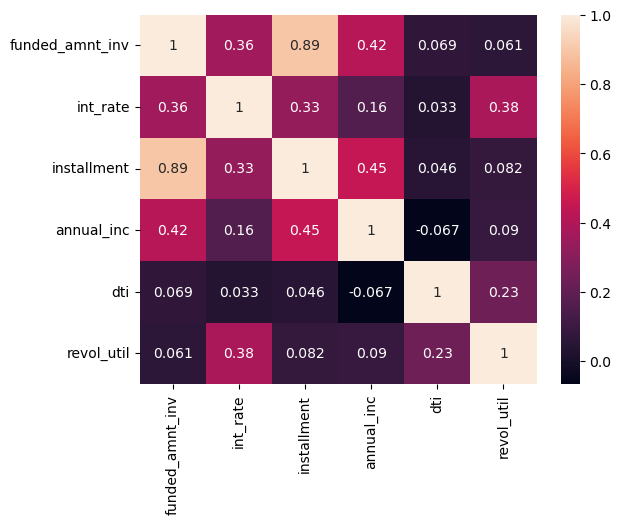

In [175]:
data = temp_df[temp_df.loan_status == 'Charged Off'].corr()
sns.heatmap(temp_df.corr(), annot=True)
plt.show()
sns.heatmap(data, annot=True)
plt.show()

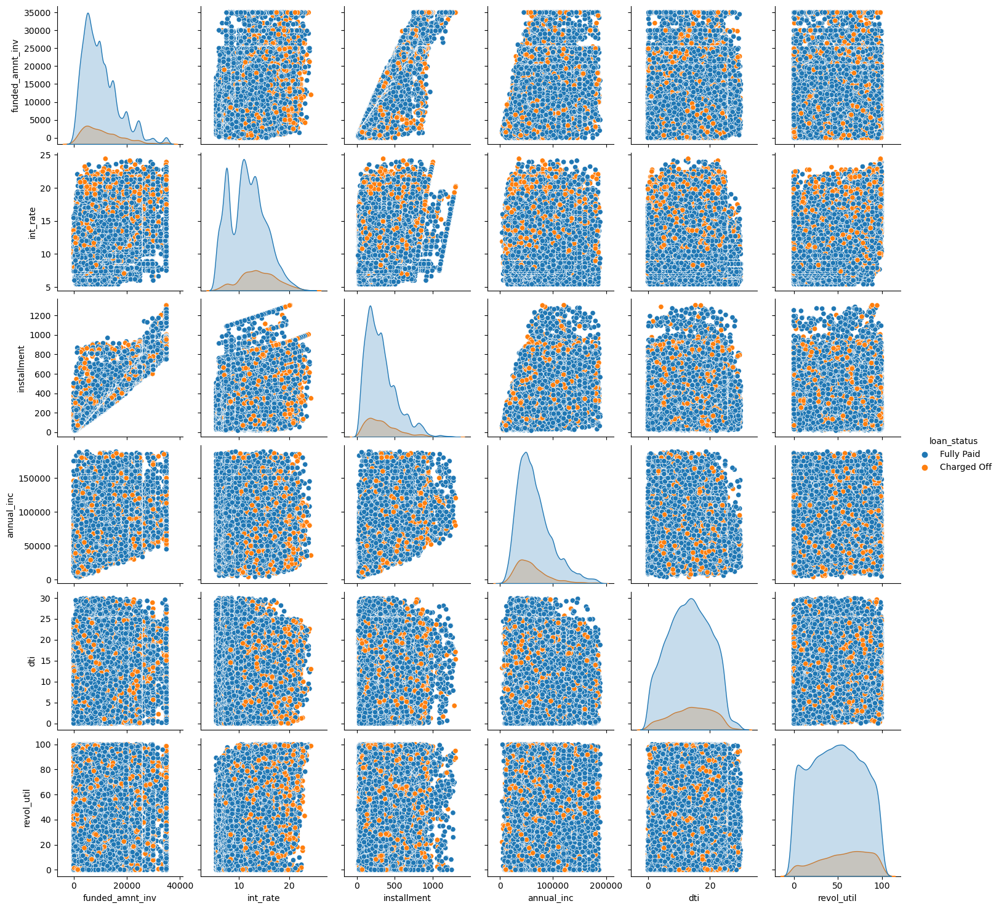

In [176]:
# Removing the outliers from annual income
temp_df = imp_loan_data[imp_loan_data.annual_inc <= imp_loan_data.annual_inc.quantile(0.99)]
# Listing columns of interest
cols = ['funded_amnt_inv', 'int_rate', 'installment', 'annual_inc', 'dti', 'revol_util','loan_status']
# Calling pairplot which takes does scatter plot between continuous variables and hue as loan_status in one shot
sns.pairplot(data=temp_df[cols], hue='loan_status')

C:\Users\sea\AppData\Local\Temp\ipykernel_8664\2156513845.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(tdf.corr(), annot=True)


<Axes: >

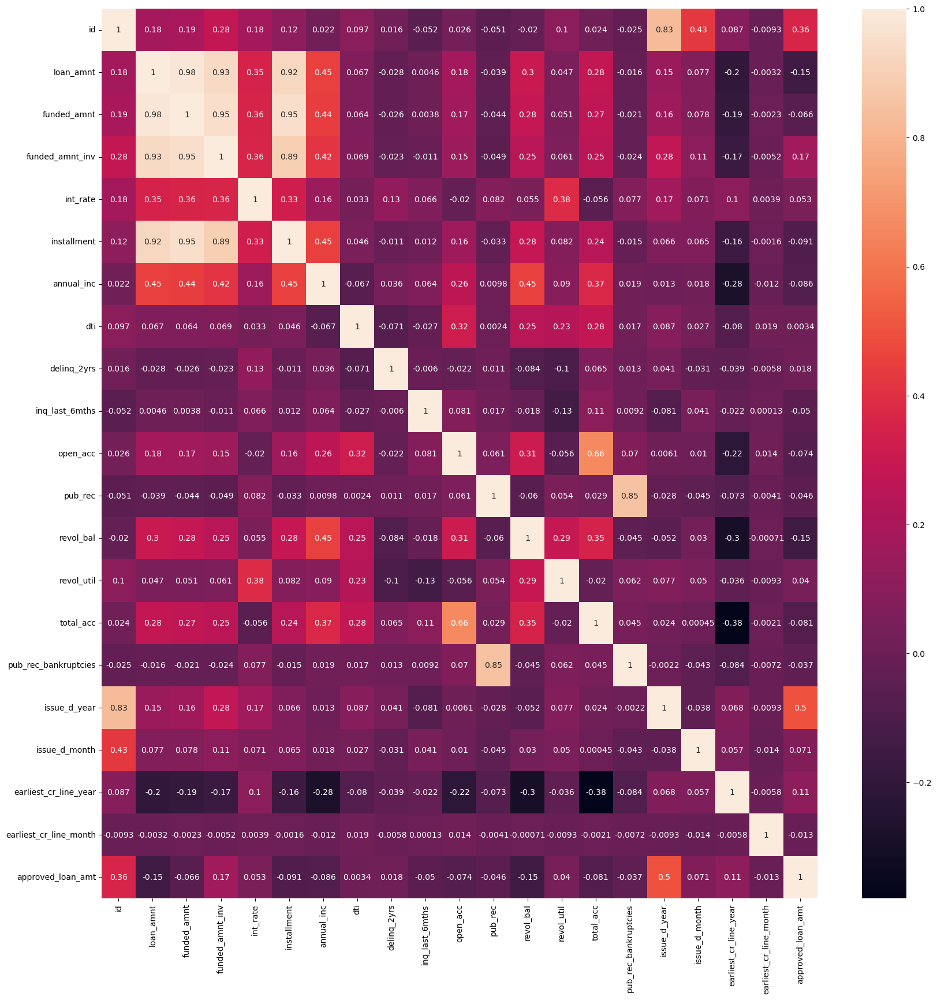

In [177]:
tdf = loan_data[loan_data.loan_status =='Charged Off']
plt.figure(figsize=(20,20))
sns.heatmap(tdf.corr(), annot=True)

<Figure size 2000x2000 with 0 Axes>

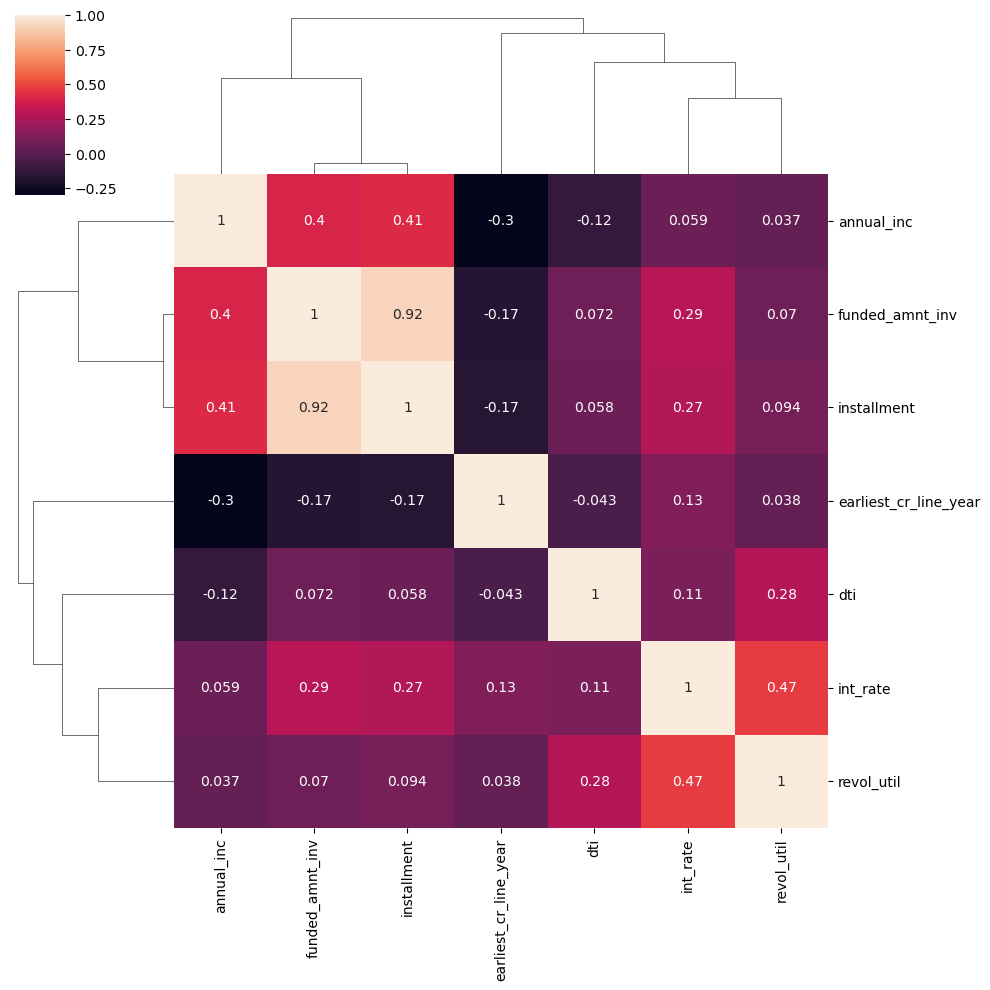

In [178]:
plt.figure(figsize=(20,20))
sns.clustermap(imp_loan_data[['annual_inc','funded_amnt_inv','installment','dti','int_rate','revol_util','earliest_cr_line_year']].corr(), annot=True)

<Figure size 2000x2000 with 0 Axes>

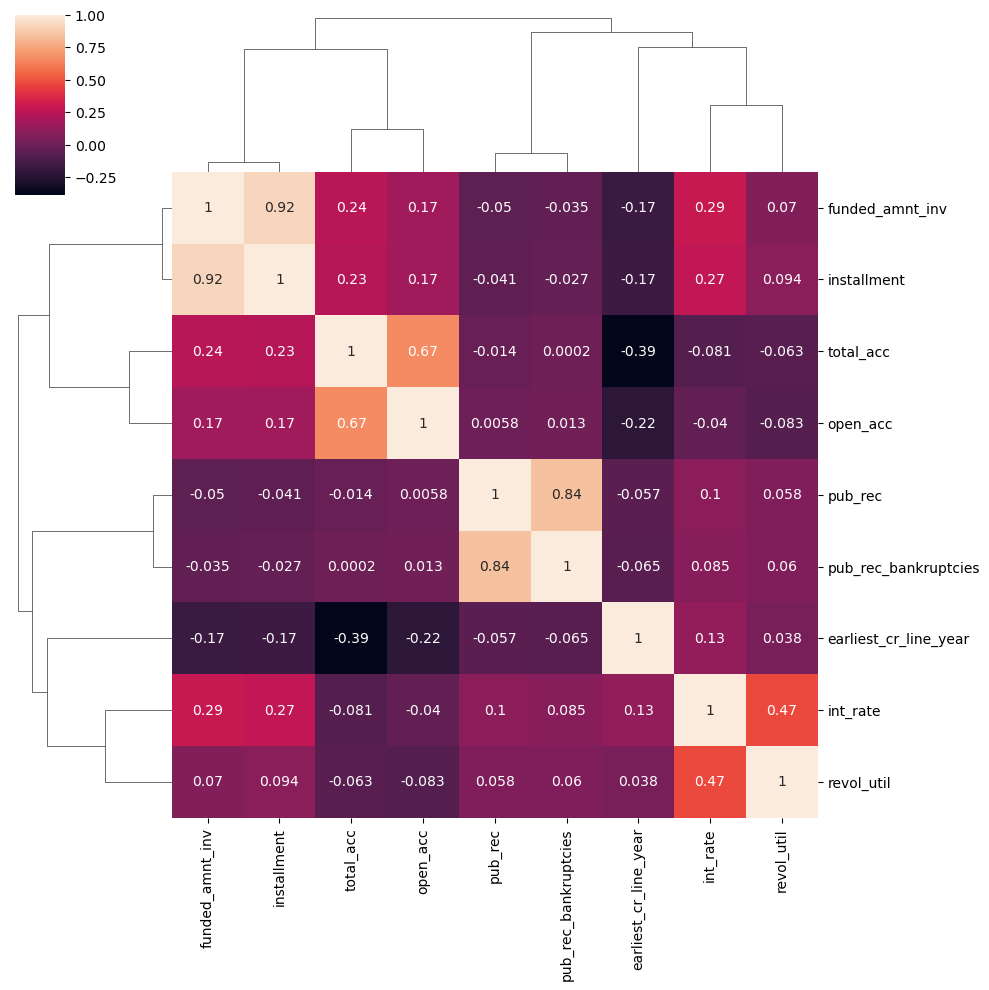

In [179]:
plt.figure(figsize=(20,20))
sns.clustermap(loan_data[['funded_amnt_inv','installment','pub_rec','pub_rec_bankruptcies','total_acc','open_acc','int_rate','revol_util','earliest_cr_line_year']].corr(), annot=True)

---
---